In [25]:
import pandas as pd
from pyspark.sql import SparkSession
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.recommendation import ALS

from sklearn.metrics import mean_squared_error

import pickle
from collections import defaultdict
import json

from tqdm import tqdm 
import concurrent.futures

from sklearn.linear_model import Ridge, RidgeCV

import pandas as pd, numpy as np, matplotlib.pyplot as plt

import sys 
sys.path.insert(1, "../")
from workloads.util import use_results, use_dataset, read_config, log_dataset

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [46]:
import seaborn as sns
sns.set_theme(style="whitegrid")

In [19]:
d=50

In [302]:
dataset_dir = use_dataset("ml-1m")
#dataset_dir = use_dataset("ml-latest-small")

/data/wooders/ralf-vldb//datasets/ml-1m


Make sure to run `workloads/recsys/train_als.py` beforehand to have a trained model. 

In [16]:
def initialize_features(n, m, d):
    #user_features = np.random.randn(n, d+1)
    #movie_features = np.random.randn(m, d+1)
    user_features = np.random.normal(loc=0., scale=0.01, size=(n, d+1))
    movie_features = np.random.normal(loc=0., scale=0.01, size=(m, d+1))
    user_features[:, -1] = 0
    movie_features[:, -1] = 0
    return user_features, movie_features

In [27]:
#model = RidgeCV(alphas=[1e-3, 1e-2, 1e-1, 1], fit_intercept=True)


# ratings is an n by m sparse matrix
def update_user(user_id, user_data, movie_features, d=50):
    user_data = user_data.tocoo() # lookup all rating data for this user
    movie_ids = user_data.col
    values = user_data.data
    model = Ridge(alpha=0.001, fit_intercept=True)

    #user_data = ratings.getrow(user_id).tocoo() # lookup all rating data for this user
    #movie_ids = user_data.col
    #values = user_data.data
        #movie_ids and values are both k x 1 
    k = len(movie_ids)
    X = movie_features[movie_ids, :d] # k x d matrix 
    # The movie bias is the d+1 (last column) of the movie features
    movie_biases = movie_features[movie_ids, -1] # k x 1 matrix
    # Subtract off the movie biases
    Y = values - movie_biases
    model.fit(X, Y)
    return np.append(model.coef_, model.intercept_)

def update_movie(movie_id, movie_data, d=50):
    
    movie_data = movie_data.tocoo() # lookup all rating data for this user
    user_ids = movie_data.row
    values = movie_data.data
    model = Ridge(alpha=0.001, fit_intercept=True)

    #movie_data = ratings.getcol(movie_id).tocoo() # lookup all rating data for this user
    #user_ids = movie_data.row
    #values = movie_data.data
        #movie_ids and values are both k x 1 
    k = len(user_ids)
    X = user_features[user_ids, :d] # k x d matrix 
    # The movie bias is the d+1 (last column) of the movie features
    user_biases = user_features[user_ids, -1] # k x 1 matrix
    # Subtract off the movie biases
    Y = values - user_biases

    # Use Sklearn to solve l2 regularized regression problem
    #from sklearn.lienar_model import Ridge, RidgeCV # we could use the CV version ...
    #model = Ridge(alpha=alpha) #Maybe use RidgeCV() instead so we don't tune lambda
    #model = RidgeCV(alphas=[1e-3, 1e-2, 1e-1, 1])
    model.fit(X, Y)
    
    #movie_features[movie_id] = np.append(model.coef_, model.intercept_)

    return np.append(model.coef_, model.intercept_)

def loss(ratings): 
    #mf = movie_features[ratings.col, :d]
    #uf = user_features[ratings.row, :d]
    #y_true = ratings.data
    #y_pred = [predict_user_movie_rating(uf[i], mf[i]) for i in range(len(y_true))]
    y_pred = []
    y_true = []
    for item in ratings.items():
        y_pred.append(predict_user_movie_rating(user_features[item[0][0], :], movie_features[item[0][1], :]))
        y_true.append(item[1])
    print(np.array(y_pred))
    print(y_true[:10])
    return mean_squared_error(y_true, y_pred)
    

def predict_user_movie_rating(user_feature, movie_feature):
    return user_feature[:d] @ movie_feature[:d] + user_feature[-1] + movie_feature[-1] 

# Stream Additional Ratings 

In [76]:
experiment = "ml-1m"
dataset_dir = use_dataset(experiment)
result_dir = use_results(experiment)

/data/wooders/ralf-vldb//datasets/ml-1m


In [5]:
test_df = pd.read_csv(f'{dataset_dir}/stream.csv')
train_df = pd.read_csv(f'{dataset_dir}/train.csv')
start_ts = test_df.timestamp.min()
test_df.timestamp = test_df.timestamp.apply(lambda ts: int((ts - start_ts)/100))

<AxesSubplot:xlabel='timestamp'>

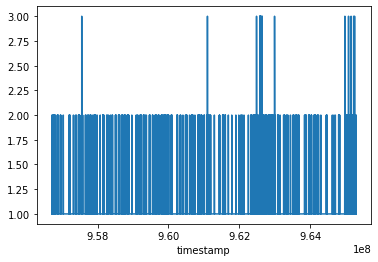

In [6]:
train_df.groupby(by="timestamp").user_id.nunique().plot()

<AxesSubplot:xlabel='timestamp'>

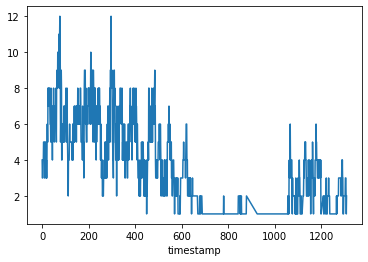

In [7]:
test_df.groupby(by="timestamp").user_id.nunique().iloc[:1000].plot()

<AxesSubplot:xlabel='timestamp'>

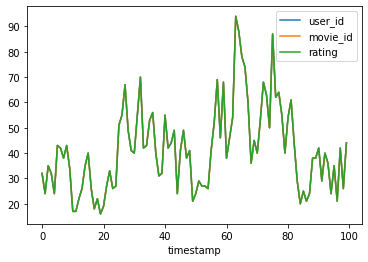

In [8]:
test_df.groupby(by="timestamp").count().iloc[:100].plot()

In [9]:
test_df[test_df["user_id"] == 1941].timestamp.value_counts()

95508     23
95484     21
95497     21
96458     20
95522     20
          ..
303695     1
656192     1
656189     1
656188     1
656142     1
Name: timestamp, Length: 312, dtype: int64

In [10]:
data = {}

for ts, group in tqdm(test_df.groupby("timestamp")):
    data[ts] = group.to_dict("records")

100%|███████████████████████████████████████████| 89396/89396 [00:21<00:00, 4154.59it/s]


In [31]:
class UserEventQueue: 
    
    """
    Event queue that selects group of user updates
    (note: we can have another implementation which triggers a bunch of updates together)
    """
    
    def __init__(self, num_keys, policy, past_updates): 
        self.policy = policy 
        self.num_keys = num_keys
        
        # metric tracking
        self.total_error = np.zeros((num_keys))
        self.past_updates = past_updates
        self.queue = defaultdict(list)
        self.staleness = defaultdict(lambda: 0)
        
    def push(self, uid, mid, rating, user_features, movie_features): 
        
        # calcualte error 
        pred = predict_user_movie_rating(user_features[uid], movie_features[mid])
        error = abs(pred - rating) #error*error # square 
        
        if uid not in self.past_updates and self.policy == "total_error_cold": # unseen keys start with high total error
            self.total_error[uid] = 1000000
        else:
            # update per key 
            self.total_error[uid] += error
        self.queue[uid].append((uid, mid, rating))
        
    def arg_max(self, data_dict): 
        max_key = None
        max_val = None
        valid_keys = 0
        for key in self.queue.keys():
            
            # cannot select empty queue 
            if len(self.queue[key]) <= 0: 
                continue 
                
            valid_keys += 1
            value = data_dict[key]
            if max_key is None or max_val <= value: 
                assert key is not None, f"Invalid key {data_dict}"
                max_key = key
                max_val = value
        return max_key, max_val
        
        
    def choose_key(self): 
        if self.policy == "total_error_cold" or self.policy == "total_error":
            key = self.arg_max(self.total_error)
        elif self.policy == "max_pending":
            key = self.arg_max({key: len(self.queue[key]) for key in self.queue.keys()})
        elif self.policy == "min_past": 
            key = self.arg_max({key: 1/(self.past_updates.setdefault(key, 0)+1) for key in self.queue.keys()})
        elif self.policy == "round_robin": 
            key = self.arg_max(self.staleness)
        else: 
            raise ValueError("Invalid policy")
       
        assert key is not None or sum([len(v) for v in self.queue.values()]) == 0, f"Key is none, {self.queue}"
        return key 
    
    def pop(self): 
        key, score = self.choose_key()
        #print(key, score, self.past_updates.setdefault(key, 0))
        if key is None:
            print("no updates", self.queue)
            return None 
        events = self.queue[key]
        self.queue[key] = []

        # update metrics 
        for k in self.queue.keys():
            self.staleness[k] += 1
        self.staleness[key] = 0
        self.total_error[key] = 0
        
        # TODO: this is wrong
        self.past_updates[key] = self.past_updates.setdefault(key, 0) + len(events)
            
        return key  

In [22]:
# total error - use prediction that is average rating for the movie 
# make sure train error is decreasing 
# set everything to zero for new user 
# return random prediction (try "bad model")

In [32]:
def experiment(policy, updates_per_ts, results_dir=".", limit=None): 

    ratings = pickle.load(open(f"{result_dir}/ratings.pkl", "rb"))

    user_features = pickle.load(open(f"{result_dir}/train_user_features.pkl", "rb"))
    movie_features = pickle.load(open(f"{result_dir}/train_movie_features.pkl", "rb"))

    train_user_features = pickle.load(open(f"{result_dir}/train_user_features.pkl", "rb"))
    train_movie_features = pickle.load(open(f"{result_dir}/train_movie_features.pkl", "rb"))

    past_updates = pickle.load(open(f"{result_dir}/past_updates.pkl", "rb"))
    
    print(user_features.shape[0], len(past_updates.keys()))
    for uid in range(user_features.shape[0]):
        if uid not in past_updates: 
            user_features[uid] = 0 #np.zeros(user_features[uid].shape)

    y_pred = [] 
    y_true = []
    users = []
    movies = []
    timestamps = []
    update_times = defaultdict(list)
    
    if limit is None: 
        limit = len(list(data.keys()))

    queue = UserEventQueue(user_features.shape[0], policy, past_updates) 
    for ts in tqdm(list(data.keys())[:limit]): 

        # process events
        updated_users = set([])
        for event in data[ts]:

            uid = event["user_id"]
            mid = event["movie_id"]
            rating = event["rating"]

            ratings[uid, mid] = rating 
            queue.push(uid, mid, rating, user_features, movie_features)
            #print("orig loss:", loss(ratings))
            y_pred.append(predict_user_movie_rating(user_features[uid], movie_features[mid]))
            y_true.append(rating)
            timestamps.append(ts)
            users.append(uid)
            movies.append(mid)
            
        for i in range(updates_per_ts): 
            uid = queue.pop()
            if uid is None: 
                print(f"{ts}: No updates in queue")
                break 
            user_features[uid] = update_user(uid, ratings, movie_features, d)
            update_times[uid].append(ts)
            #print("update", uid)
            
            # TODO: make sure overall loss is decreasing (training error)
        
            
         
    runtime = 1/updates_per_ts
    update_df = pd.DataFrame([
        [policy, runtime, k, i, update_times[k][i]]
        for k, v in update_times.items() for i in range(len(v))
    ], columns = ["policy", "runtime", "key", "i", "time"])
    results_df = pd.DataFrame({"y_true": y_true, "y_pred": y_pred, "user_id": users, "movie_id": movies, "timestamp": timestamps})
    

    update_df.to_csv(f"{results_dir}/{policy}_{updates_per_ts}_updates.csv")
    results_df.to_csv(f"{results_dir}/{policy}_{updates_per_ts}_results.csv")
    

In [33]:
experiment("total_error", 1, result_dir, 100)

6041 1772


100%|█████████████████████████████████████████████████| 100/100 [00:26<00:00,  3.80it/s]


In [77]:
updates_per_ts = [1, 2, 4, 8, 10, 100]
policies = ["total_error", "total_error_cold", "max_pending", "min_past", "round_robin"]

In [34]:
import concurrent.futures

policies = ["total_error", "total_error_cold", "max_pending", "min_past", "round_robin"]
#policies = ["min_past"]
updates_per_ts = [1, 2]

#experiments = [(p, u, ".") for p in policies for u in updates_per_ts]
futures = []
with concurrent.futures.ProcessPoolExecutor(20) as executor:
    for p in policies: 
        for u in updates_per_ts: 
            futures.append(executor.submit(experiment, p, u, result_dir, 5000))
     
    print("waiting")
    
    for f in futures: 
        try: 
            f.result()
        except Exception as e:
            print(e)
    res = concurrent.futures.wait(futures)
    print("done", res)
    executor.shutdown()

waiting
6041 1772
6041 1772
604160416041   177217721772


6041 1772


  0%|                                                          | 0/5000 [00:00<?, ?it/s]

6041 1772
6041 1772
6041 1772
6041 1772


 27%|████████████▊                                  | 1365/5000 [09:09<25:52,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1366/5000 [09:09<25:48,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  8%|███▌                                          | 394/5000 [09:10<1:51:28,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████▎                                        | 766/5000 [09:10<49:04,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  9%|████                                          | 443/5000 [09:10<1:46:30,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  8%|███▋                                          | 395/5000 [09:11<1:44:12,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████▎                                        | 764/5000 [09:11<52:08,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  8%|███▌                                          | 393/5000 [09:12<1:15:55,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  9%|████                                          | 444/5000 [09:12<1:49:35,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████▍                                        | 770/5000 [09:12<43:57,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  8%|███▋                                          | 400/5000 [09:13<1:48:53,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 20%|█████████▍                                     | 1004/5000 [09:13<45:47,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  9%|████                                          | 445/5000 [09:14<1:50:58,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▉                                  | 1374/5000 [09:14<27:28,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████                                  | 1387/5000 [09:14<30:03,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████▍                                        | 773/5000 [09:15<50:51,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  8%|███▋                                          | 397/5000 [09:15<1:09:05,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████                                  | 1390/5000 [09:15<25:01,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  8%|███▋                                          | 398/5000 [09:16<1:06:02,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 20%|█████████▍                                     | 1008/5000 [09:17<49:50,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████▍                                        | 772/5000 [09:17<50:43,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████                                  | 1383/5000 [09:17<23:29,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 20%|█████████▍                                     | 1010/5000 [09:18<45:53,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████                                  | 1385/5000 [09:18<23:45,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████                                  | 1386/5000 [09:18<24:08,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▏                                 | 1399/5000 [09:19<22:16,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▏                                 | 1403/5000 [09:20<22:01,  2.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 20%|█████████▌                                     | 1014/5000 [09:21<50:58,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▏                                 | 1405/5000 [09:21<23:09,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  8%|███▋                                          | 405/5000 [09:22<1:02:14,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████                                  | 1394/5000 [09:22<24:40,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████                                  | 1395/5000 [09:22<24:29,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████                                  | 1396/5000 [09:23<23:02,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▏                                 | 1397/5000 [09:23<21:56,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  8%|███▋                                          | 407/5000 [09:23<1:06:03,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1412/5000 [09:24<21:34,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1413/5000 [09:24<22:19,  2.68it/s]

no updates

  8%|███▊                                          | 408/5000 [09:24<1:06:30,  1.15it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

  8%|███▊                                          | 408/5000 [09:25<1:50:37,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1414/5000 [09:25<25:48,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1415/5000 [09:25<27:01,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▌                                        | 784/5000 [09:26<51:47,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▌                                        | 788/5000 [09:26<50:41,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  9%|████▏                                         | 454/5000 [09:27<1:49:34,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1419/5000 [09:27<24:55,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  8%|███▊                                          | 410/5000 [09:27<1:47:43,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1421/5000 [09:28<24:20,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1422/5000 [09:28<24:03,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1411/5000 [09:29<25:42,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▌                                        | 792/5000 [09:29<49:35,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1413/5000 [09:29<25:53,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  8%|███▊                                          | 413/5000 [09:36<1:50:24,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  8%|███▉                                          | 422/5000 [09:38<1:37:02,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 21%|█████████▋                                     | 1037/5000 [09:38<47:56,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▋                                        | 802/5000 [09:39<51:44,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▋                                 | 1450/5000 [09:40<24:53,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▋                                        | 803/5000 [09:40<52:54,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▊                                        | 810/5000 [09:41<46:24,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 21%|█████████▊                                     | 1042/5000 [09:42<46:04,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  8%|███▊                                          | 417/5000 [09:42<1:45:42,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▌                                 | 1445/5000 [09:42<21:58,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▌                                 | 1446/5000 [09:43<21:19,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▊                                        | 808/5000 [09:44<54:03,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  9%|███▉                                          | 428/5000 [09:46<1:43:36,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 21%|██████████                                     | 1074/5000 [10:06<50:34,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  9%|████                                          | 438/5000 [10:07<1:51:52,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████▎                                | 1522/5000 [10:09<24:26,  2.37it/s]

no updates 

  9%|████                                          | 444/5000 [10:09<1:45:52,  1.39s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 17%|████████▏                                       | 853/5000 [10:09<50:36,  1.37it/s]

 30%|██████████████▎                                | 1523/5000 [10:09<24:07,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

  9%|████                                          | 445/5000 [10:10<1:47:12,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████▏                                | 1512/5000 [10:11<24:49,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████▏                                | 1513/5000 [10:11<24:27,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 17%|████████▎                                       | 867/5000 [10:20<56:10,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 17%|████████▏                                       | 857/5000 [10:20<51:05,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 17%|████████▎                                       | 860/5000 [10:22<49:23,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████▎                                    | 1097/5000 [10:23<49:09,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 17%|████████▎                                       | 861/5000 [10:23<51:13,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████▎                                    | 1098/5000 [10:23<48:41,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▎                              | 1734/5000 [11:34<22:07,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 19%|█████████▏                                      | 959/5000 [11:34<49:36,  1.36it/s]

1223: No updates in queue


 35%|████████████████▎                              | 1735/5000 [11:34<22:19,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▏                                   | 1194/5000 [11:35<48:39,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▌                              | 1757/5000 [11:43<22:20,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▎                                   | 1205/5000 [11:44<50:21,  1.26it/s]


1236: No updates in queue


 20%|█████████▍                                      | 980/5000 [11:44<45:36,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▎                                   | 1206/5000 [11:44<51:01,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▋                               | 1665/5000 [11:45<24:36,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▋                               | 1666/5000 [11:45<24:24,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▋                               | 1667/5000 [11:45<23:58,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 10%|████▋                                         | 512/5000 [11:46<1:44:38,  1.40s/it]

no updates

 20%|█████████▎                                      | 976/5000 [11:46<41:12,  1.63it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 35%|████████████████▌                              | 1764/5000 [11:46<21:30,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 20%|█████████▍                                      | 984/5000 [11:47<48:12,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 11%|█████▏                                        | 562/5000 [11:47<1:44:36,  1.41s/it]

no updates

 24%|███████████▎                                   | 1210/5000 [11:47<46:20,  1.36it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 20%|█████████▍                                      | 978/5000 [11:47<45:59,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1211/5000 [11:48<45:47,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 10%|████▋                                         | 510/5000 [11:48<1:46:49,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 11%|█████▏                                        | 563/5000 [11:48<1:47:56,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 20%|█████████▍                                      | 987/5000 [11:49<50:13,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▋                               | 1674/5000 [11:49<32:17,  1.72it/s]

1255: No updates in queue


 24%|███████████▍                                   | 1213/5000 [11:49<48:00,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▋                               | 1675/5000 [11:50<31:34,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1214/5000 [11:50<48:21,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▊                               | 1677/5000 [11:50<27:32,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1215/5000 [11:51<48:32,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▊                               | 1679/5000 [11:51<24:42,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▊                               | 1680/5000 [11:52<24:35,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 36%|████████████████▋                              | 1779/5000 [11:52<22:16,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1217/5000 [11:53<48:01,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 10%|████▊                                         | 517/5000 [11:53<1:53:39,  1.52s/it]

no updates 

 34%|███████████████▊                               | 1685/5000 [11:54<21:45,  2.54it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 21%|█████████▊                                     | 1045/5000 [12:16<29:17,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▌                              | 1762/5000 [12:25<23:15,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 21%|█████████▊                                     | 1043/5000 [12:32<57:50,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████▌                                    | 1124/5000 [12:50<26:56,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 21%|█████████▉                                     | 1058/5000 [13:13<53:43,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▊                                        | 626/5000 [13:18<1:49:00,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▎                                   | 1205/5000 [13:24<25:19,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1218/5000 [13:30<26:17,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1221/5000 [13:31<23:24,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|███████████████████                            | 2024/5000 [13:36<21:42,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|██████████████████                             | 1924/5000 [13:36<23:29,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████▏                                    | 1089/5000 [13:36<50:37,  1.29it/s]


588: No updates in queue


 41%|███████████████████                            | 2026/5000 [13:36<21:47,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2027/5000 [13:37<21:40,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▋                                   | 1237/5000 [13:37<25:36,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▋                                   | 1238/5000 [13:38<25:00,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 12%|█████▎                                        | 579/5000 [13:38<1:50:49,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▋                                   | 1239/5000 [13:38<25:19,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▉                                        | 641/5000 [13:38<1:44:39,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████▎                                    | 1094/5000 [13:38<30:57,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 12%|█████▍                                        | 589/5000 [13:39<1:48:24,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▋                                  | 1355/5000 [13:39<51:29,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2036/5000 [13:41<22:13,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|██████▏                                       | 670/5000 [14:19<1:47:24,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2124/5000 [14:19<20:42,  2.31it/s]

 40%|██████████████████▉                            | 2021/5000 [14:20<20:50,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|███████████████████                            | 2022/5000 [14:20<21:37,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|███████████████████                            | 2023/5000 [14:20<21:48,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 12%|█████▋                                        | 618/5000 [14:21<1:47:14,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▏                                   | 1191/5000 [14:21<49:52,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▋                                  | 1348/5000 [14:22<24:48,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2031/5000 [14:24<19:56,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2032/5000 [14:24<19:25,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▋                                  | 1354/5000 [14:25<21:24,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 12%|█████▋                                        | 621/5000 [14:25<1:49:22,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2139/5000 [14:25<18:02,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▎                                   | 1197/5000 [14:26<49:33,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1359/5000 [14:26<22:03,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▎                                   | 1198/5000 [14:27<49:24,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2143/5000 [14:27<18:53,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2042/5000 [14:28<20:59,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2043/5000 [14:29<21:10,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|███████████                                    | 1172/5000 [14:35<51:10,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2058/5000 [14:35<20:31,  2.39it/s]

no updates

 29%|█████████████▍                                 | 1430/5000 [14:36<48:28,  1.23it/s]

 24%|███████████▍                                   | 1215/5000 [14:36<25:51,  2.44it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 23%|███████████                                    | 1173/5000 [14:36<50:54,  1.25it/s]

690: No updates in queue


 41%|███████████████████▎                           | 2060/5000 [14:36<20:23,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1218/5000 [14:37<25:08,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2165/5000 [14:37<23:52,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████                                    | 1176/5000 [14:38<47:14,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▍                          | 2168/5000 [14:38<23:31,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▊                                        | 630/5000 [14:39<1:46:39,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▍                          | 2171/5000 [14:40<21:37,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▊                                        | 631/5000 [14:40<1:47:10,  1.47s/it]

no updates

 41%|███████████████████▍                           | 2070/5000 [14:41<22:02,  2.22it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 28%|█████████████                                  | 1394/5000 [14:41<24:05,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2073/5000 [14:42<22:05,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2075/5000 [14:43<20:58,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1227/5000 [14:43<48:45,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2180/5000 [14:44<23:49,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2080/5000 [14:45<21:38,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▏                                   | 1186/5000 [14:46<49:53,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▊                                        | 628/5000 [14:47<1:42:53,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2187/5000 [14:47<20:43,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▏                                   | 1189/5000 [14:48<51:19,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▊                                        | 638/5000 [14:49<1:34:16,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2192/5000 [14:50<20:51,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1416/5000 [14:50<24:45,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2195/5000 [14:51<19:51,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2197/5000 [14:52<18:45,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▋                                   | 1238/5000 [14:52<48:50,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2198/5000 [14:52<19:57,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▉                                        | 640/5000 [14:52<1:25:35,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▏                                   | 1195/5000 [14:52<39:07,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▋                                   | 1239/5000 [14:53<50:39,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2098/5000 [14:53<21:33,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▍                                 | 1423/5000 [14:53<24:07,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2099/5000 [14:53<21:58,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▉                                        | 641/5000 [14:54<1:34:05,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▎                                   | 1199/5000 [14:54<28:22,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▎                                   | 1200/5000 [14:55<34:42,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▍                                 | 1429/5000 [14:55<23:27,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▎                                   | 1202/5000 [14:56<45:12,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▍                                 | 1433/5000 [14:57<23:48,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▍                                 | 1435/5000 [14:58<23:28,  2.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2213/5000 [14:59<19:08,  2.43it/s]

no updates

 29%|█████████████▌                                 | 1437/5000 [14:59<22:14,  2.67it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 25%|███████████▋                                   | 1246/5000 [14:59<50:55,  1.23it/s]


773: No updates in queue


 13%|█████▉                                        | 645/5000 [14:59<1:46:22,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▌                                 | 1440/5000 [15:00<25:04,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▉                                        | 646/5000 [15:01<1:45:49,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▊                                   | 1250/5000 [15:01<45:38,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▊                                 | 1465/5000 [15:02<44:37,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▊                                   | 1251/5000 [15:02<45:07,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▉                                         | 718/5000 [15:02<54:30,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▌                                 | 1447/5000 [15:03<23:39,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2122/5000 [15:03<20:21,  2.36it/s]

no updates 

 44%|████████████████████▉                          | 2222/5000 [15:03<20:21,  2.27it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 29%|█████████████▌                                 | 1448/5000 [15:03<23:38,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▉                                        | 648/5000 [15:03<1:43:59,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▊                                 | 1468/5000 [15:04<41:59,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▊                                   | 1254/5000 [15:04<44:52,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▊                                 | 1469/5000 [15:05<43:15,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▋                                 | 1453/5000 [15:05<23:38,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2227/5000 [15:05<19:48,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2228/5000 [15:05<19:35,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2128/5000 [15:06<21:48,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▉                                        | 641/5000 [15:06<1:42:39,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2230/5000 [15:06<19:32,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1220/5000 [15:06<26:34,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2231/5000 [15:07<19:30,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2131/5000 [15:07<21:30,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▊                                 | 1472/5000 [15:07<46:53,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2232/5000 [15:07<19:38,  2.35it/s]

 45%|████████████████████▉                          | 2233/5000 [15:08<19:30,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▉                                        | 651/5000 [15:08<1:42:54,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2234/5000 [15:08<19:25,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▋                                 | 1461/5000 [15:08<25:46,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▊                                 | 1474/5000 [15:09<44:58,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2135/5000 [15:09<20:31,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▉                                        | 643/5000 [15:09<1:47:12,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▊                                 | 1463/5000 [15:09<26:14,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2237/5000 [15:09<19:48,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▊                                 | 1464/5000 [15:10<25:41,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2138/5000 [15:10<20:08,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▊                                 | 1465/5000 [15:10<25:13,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▉                                        | 644/5000 [15:10<1:48:49,  1.50s/it]

no updates 

 29%|█████████████▊                                 | 1466/5000 [15:10<25:16,  2.33it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 25%|███████████▌                                   | 1230/5000 [15:11<25:58,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▊                                 | 1468/5000 [15:11<23:55,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1231/5000 [15:11<33:09,  1.89it/s]

no updates

 45%|█████████████████████                          | 2242/5000 [15:11<18:23,  2.50it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 13%|█████▉                                        | 645/5000 [15:12<1:50:12,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2244/5000 [15:12<18:23,  2.50it/s]

794: No updates in queue


 29%|█████████████▊                                 | 1471/5000 [15:12<21:23,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▉                                   | 1266/5000 [15:13<47:43,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|██████                                        | 654/5000 [15:13<1:47:15,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2247/5000 [15:13<19:01,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|██████                                        | 655/5000 [15:14<1:45:44,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▉                                   | 1268/5000 [15:14<47:38,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2149/5000 [15:14<18:47,  2.53it/s]

1566: No updates in queue


 25%|███████████▌                                   | 1235/5000 [15:14<42:35,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2150/5000 [15:15<18:12,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2151/5000 [15:15<19:37,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▉                                 | 1479/5000 [15:15<22:42,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                         | 736/5000 [15:15<56:08,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▉                                 | 1480/5000 [15:16<24:08,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2153/5000 [15:16<22:39,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2253/5000 [15:16<20:54,  2.19it/s]


799: No updates in queue


 15%|███████                                         | 737/5000 [15:16<56:45,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▉                                        | 648/5000 [15:17<1:50:26,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2154/5000 [15:17<25:29,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▉                                 | 1483/5000 [15:17<23:24,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2255/5000 [15:17<20:54,  2.19it/s]


1573: No updates in queue


 30%|█████████████▉                                 | 1484/5000 [15:17<23:14,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2256/5000 [15:18<20:04,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▉                                 | 1485/5000 [15:18<23:47,  2.46it/s]

no updates

 13%|██████                                        | 658/5000 [15:18<1:44:17,  1.44s/it]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 13%|█████▉                                        | 649/5000 [15:18<1:51:04,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2258/5000 [15:18<20:54,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▉                                 | 1487/5000 [15:19<46:23,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▉                                 | 1488/5000 [15:19<24:32,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2260/5000 [15:19<19:49,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▉                                 | 1489/5000 [15:20<24:20,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2160/5000 [15:20<21:35,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████                                 | 1490/5000 [15:20<25:13,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▉                                 | 1489/5000 [15:20<46:02,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1277/5000 [15:21<43:41,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|█████▉                                        | 651/5000 [15:21<1:49:54,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1278/5000 [15:22<45:07,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▊                                   | 1253/5000 [15:22<24:34,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████                                 | 1494/5000 [15:22<26:53,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████                                 | 1495/5000 [15:22<25:49,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2268/5000 [15:23<18:36,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████                                 | 1496/5000 [15:23<25:03,  2.33it/s]


1589: No updates in queue


 30%|██████████████                                 | 1497/5000 [15:23<24:19,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████                                 | 1498/5000 [15:23<24:06,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▍                          | 2169/5000 [15:24<21:09,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|██████                                        | 653/5000 [15:24<1:49:30,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|██████▊                                       | 747/5000 [15:25<1:03:14,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2175/5000 [15:27<22:17,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2176/5000 [15:27<22:15,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2177/5000 [15:28<21:55,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2178/5000 [15:28<21:28,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|██████                                        | 664/5000 [15:29<1:47:26,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2282/5000 [15:29<19:31,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|██████▏                                       | 666/5000 [15:29<1:42:34,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1288/5000 [15:29<46:14,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2286/5000 [15:30<18:30,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|██████▏                                       | 666/5000 [15:31<1:27:46,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▉                                   | 1272/5000 [15:31<38:21,  1.62it/s]

no updates

 30%|██████████████▏                                | 1504/5000 [15:31<41:40,  1.40it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 46%|█████████████████████▌                         | 2288/5000 [15:31<18:39,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2184/5000 [15:31<26:57,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2185/5000 [15:32<24:52,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▉                                   | 1274/5000 [15:32<33:04,  1.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|███████████▉                                   | 1275/5000 [15:33<37:52,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2292/5000 [15:33<18:26,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2188/5000 [15:33<21:33,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|██████▏                                       | 669/5000 [15:34<1:43:03,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████▏                                | 1509/5000 [15:35<40:50,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1296/5000 [15:35<40:46,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2298/5000 [15:36<20:04,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1298/5000 [15:36<33:45,  1.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                       | 761/5000 [15:36<1:14:21,  1.05s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2196/5000 [15:37<20:16,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2197/5000 [15:37<19:44,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                       | 762/5000 [15:37<1:09:59,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2198/5000 [15:37<19:25,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2199/5000 [15:38<18:57,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1286/5000 [15:38<24:01,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▍                                | 1533/5000 [15:38<21:20,  2.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|██████▏                                       | 672/5000 [15:38<1:47:55,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████▏                                | 1514/5000 [15:39<46:09,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                       | 764/5000 [15:39<1:00:26,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▍                                | 1535/5000 [15:39<20:55,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2306/5000 [15:39<19:43,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▎                                  | 1306/5000 [15:39<30:31,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1290/5000 [15:39<25:04,  2.47it/s]

 44%|████████████████████▋                          | 2203/5000 [15:40<22:48,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████▎                                | 1516/5000 [15:40<45:48,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▍                                | 1539/5000 [15:40<22:22,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2310/5000 [15:41<18:36,  2.41it/s]

no updates

 31%|██████████████▍                                | 1540/5000 [15:41<22:27,  2.57it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 13%|██████                                        | 665/5000 [15:41<1:41:47,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2312/5000 [15:41<18:46,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2207/5000 [15:42<23:33,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2208/5000 [15:42<22:22,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2315/5000 [15:43<18:47,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                       | 768/5000 [15:43<1:11:02,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2316/5000 [15:43<18:53,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2211/5000 [15:44<20:05,  2.31it/s]

no updates 

 14%|██████▏                                       | 677/5000 [15:44<1:38:43,  1.37s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 30%|██████████████▎                                | 1521/5000 [15:44<44:39,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2213/5000 [15:44<21:29,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▏                                       | 678/5000 [15:45<1:37:39,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▌                                | 1551/5000 [15:45<23:16,  2.47it/s]

no updates

 30%|██████████████▎                                | 1523/5000 [15:46<42:15,  1.37it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 13%|██████▏                                       | 668/5000 [15:46<1:49:53,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████▎                                | 1524/5000 [15:46<42:27,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2321/5000 [15:46<29:23,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2218/5000 [15:47<19:20,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2219/5000 [15:47<19:21,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▎                                       | 680/5000 [15:47<1:24:45,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1317/5000 [15:48<45:22,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2324/5000 [15:48<22:46,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▉                          | 2221/5000 [15:48<19:57,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1318/5000 [15:48<46:28,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▋                                | 1559/5000 [15:48<23:16,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▊                         | 2327/5000 [15:49<21:16,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1320/5000 [15:50<45:03,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▋                                | 1563/5000 [15:50<21:13,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 13%|██████▏                                       | 671/5000 [15:50<1:46:13,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1321/5000 [15:51<46:09,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▎                                  | 1315/5000 [15:51<28:53,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                       | 774/5000 [15:51<1:35:34,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2332/5000 [15:51<19:14,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▌                                         | 686/5000 [15:51<55:20,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2333/5000 [15:52<18:58,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▋                                | 1568/5000 [15:52<22:46,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▍                                | 1532/5000 [15:52<46:31,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1324/5000 [15:53<45:51,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1320/5000 [15:53<27:21,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2336/5000 [15:53<20:27,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2234/5000 [15:53<21:38,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1325/5000 [15:54<47:22,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1322/5000 [15:54<27:24,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2338/5000 [15:54<20:07,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▊                                | 1573/5000 [15:54<25:16,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2339/5000 [15:54<20:18,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2340/5000 [15:55<20:27,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1325/5000 [15:55<27:53,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2341/5000 [15:55<20:21,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2342/5000 [15:56<19:44,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▍                                  | 1328/5000 [15:56<47:01,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2343/5000 [15:56<19:19,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▊                                | 1578/5000 [15:56<25:39,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▍                                  | 1329/5000 [15:57<48:27,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2345/5000 [15:57<19:40,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1330/5000 [15:57<46:41,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2346/5000 [15:58<19:14,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▎                                       | 685/5000 [15:58<1:49:28,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2349/5000 [15:59<18:45,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1332/5000 [15:59<48:49,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2246/5000 [15:59<21:12,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2350/5000 [15:59<19:00,  2.32it/s]

 14%|██████▎                                       | 686/5000 [15:59<1:35:31,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2351/5000 [16:00<19:10,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1335/5000 [16:00<27:37,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▉                                | 1586/5000 [16:00<25:51,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▉                                | 1587/5000 [16:00<26:05,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1334/5000 [16:01<48:47,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▏                                       | 679/5000 [16:01<1:47:24,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2252/5000 [16:01<18:32,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2356/5000 [16:02<18:34,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2253/5000 [16:02<18:48,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▉                                | 1590/5000 [16:02<26:55,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1338/5000 [16:02<46:07,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2255/5000 [16:03<18:45,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▉                                | 1592/5000 [16:03<26:19,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▌                                | 1547/5000 [16:03<41:52,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▉                                | 1593/5000 [16:03<27:11,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2257/5000 [16:04<18:49,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▉                                | 1594/5000 [16:04<27:01,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2258/5000 [16:04<19:22,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2362/5000 [16:04<18:35,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▋                                         | 693/5000 [16:04<56:33,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▌                                         | 684/5000 [16:05<58:18,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1339/5000 [16:05<46:24,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████                                | 1596/5000 [16:05<27:13,  2.08it/s]

 31%|██████████████▌                                | 1549/5000 [16:05<43:09,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2260/5000 [16:05<21:22,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▌                                         | 685/5000 [16:05<55:41,  1.29it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 32%|███████████████                                | 1597/5000 [16:05<27:15,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1340/5000 [16:05<47:37,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████                                | 1598/5000 [16:06<27:09,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▋                                  | 1344/5000 [16:06<29:41,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2262/5000 [16:06<21:15,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1341/5000 [16:06<44:09,  1.38it/s]


755: No updates in queue


 14%|██████▋                                         | 695/5000 [16:06<56:18,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████                                | 1599/5000 [16:06<26:03,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2263/5000 [16:06<21:05,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████                                | 1600/5000 [16:07<25:07,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1342/5000 [16:07<45:04,  1.35it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 14%|██████▌                                         | 687/5000 [16:07<55:13,  1.30it/s]

 47%|██████████████████████▎                        | 2368/5000 [16:07<19:04,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▌                                | 1552/5000 [16:07<44:57,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2265/5000 [16:07<20:54,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1343/5000 [16:08<45:17,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▋                                         | 697/5000 [16:08<55:31,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████                                | 1603/5000 [16:08<24:03,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▌                                | 1553/5000 [16:08<45:40,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████                                | 1604/5000 [16:08<24:03,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▌                                         | 689/5000 [16:08<55:00,  1.31it/s]

no updates

 27%|████████████▋                                  | 1344/5000 [16:08<46:47,  1.30it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 14%|██████▋                                         | 698/5000 [16:08<56:45,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2268/5000 [16:09<22:01,  2.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▎                        | 2372/5000 [16:09<18:53,  2.32it/s]

 32%|███████████████                                | 1606/5000 [16:09<23:17,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▌                                         | 690/5000 [16:09<57:05,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▋                                  | 1345/5000 [16:09<48:40,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▌                                | 1555/5000 [16:10<43:59,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▎                        | 2374/5000 [16:10<19:08,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▋                                  | 1346/5000 [16:10<47:40,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████                                | 1609/5000 [16:10<23:09,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2376/5000 [16:11<18:43,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1610/5000 [16:11<23:25,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1611/5000 [16:11<23:37,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▏                                      | 788/5000 [16:11<1:43:01,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▍                         | 2274/5000 [16:11<19:28,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1612/5000 [16:12<23:29,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▋                                         | 702/5000 [16:12<57:56,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1613/5000 [16:12<23:24,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▋                                  | 1349/5000 [16:12<44:14,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1357/5000 [16:12<29:36,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2380/5000 [16:12<18:12,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▋                                  | 1350/5000 [16:12<38:32,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▎                                      | 789/5000 [16:13<1:43:40,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1615/5000 [16:13<23:40,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▋                                         | 695/5000 [16:13<54:07,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1359/5000 [16:13<27:17,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2383/5000 [16:13<18:34,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▊                                         | 716/5000 [16:13<54:14,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2280/5000 [16:14<18:36,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1360/5000 [16:14<35:33,  1.71it/s]


765: No updates in queue


 46%|█████████████████████▍                         | 2281/5000 [16:14<18:32,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▋                                         | 697/5000 [16:14<51:24,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1619/5000 [16:15<24:46,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1361/5000 [16:15<41:11,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2283/5000 [16:15<18:56,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▋                                | 1563/5000 [16:15<39:45,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1621/5000 [16:15<25:57,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▋                                | 1564/5000 [16:16<36:06,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1622/5000 [16:16<26:31,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▋                                | 1565/5000 [16:16<32:33,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2390/5000 [16:17<20:35,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▎                               | 1624/5000 [16:17<27:09,  2.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▎                               | 1625/5000 [16:17<27:37,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▋                                | 1568/5000 [16:18<28:52,  1.98it/s]

 14%|██████▊                                         | 710/5000 [16:18<54:09,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▎                               | 1626/5000 [16:18<27:08,  2.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1365/5000 [16:18<51:11,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▎                                      | 795/5000 [16:19<1:15:02,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▋                                         | 703/5000 [16:19<53:02,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2395/5000 [16:19<18:51,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1366/5000 [16:19<51:57,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▎                               | 1629/5000 [16:19<24:45,  2.27it/s]

1087: No updates in queue


 46%|█████████████████████▌                         | 2293/5000 [16:19<18:19,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▉                                         | 723/5000 [16:19<55:36,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2294/5000 [16:20<18:16,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▎                               | 1631/5000 [16:20<23:42,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2295/5000 [16:20<18:31,  2.43it/s]

 14%|██████▊                                         | 705/5000 [16:20<53:50,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▎                               | 1632/5000 [16:20<23:28,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1368/5000 [16:21<51:34,  1.17it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 48%|██████████████████████▌                        | 2400/5000 [16:21<18:49,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2298/5000 [16:21<18:30,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▊                                         | 715/5000 [16:21<55:07,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▊                                         | 707/5000 [16:22<52:06,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2401/5000 [16:22<19:39,  2.20it/s]

 33%|███████████████▍                               | 1636/5000 [16:22<23:00,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▊                                         | 716/5000 [16:22<55:04,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2300/5000 [16:22<19:47,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2404/5000 [16:23<18:53,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▊                                         | 709/5000 [16:23<52:35,  1.36it/s]

 14%|██████▉                                         | 717/5000 [16:23<56:50,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1365/5000 [16:24<46:20,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▍                               | 1640/5000 [16:24<22:49,  2.45it/s]

no updates 

 48%|██████████████████████▌                        | 2406/5000 [16:24<18:46,  2.30it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 14%|██████▊                                         | 710/5000 [16:24<54:21,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1366/5000 [16:24<46:09,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▍                               | 1642/5000 [16:24<22:19,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2408/5000 [16:25<18:17,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▊                                         | 711/5000 [16:25<55:44,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1367/5000 [16:25<46:34,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2410/5000 [16:25<16:26,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▊                                         | 712/5000 [16:25<55:55,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2307/5000 [16:25<20:19,  2.21it/s]

1094: No updates in queue


 46%|█████████████████████▋                         | 2308/5000 [16:26<19:56,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▍                               | 1646/5000 [16:26<23:25,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▊                                | 1580/5000 [16:27<46:54,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2310/5000 [16:27<20:11,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▍                               | 1648/5000 [16:27<22:59,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▊                                | 1581/5000 [16:28<47:49,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▋                                       | 722/5000 [16:28<1:03:08,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2312/5000 [16:28<20:04,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▌                               | 1650/5000 [16:28<23:12,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▉                                  | 1371/5000 [16:28<44:24,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▌                               | 1651/5000 [16:28<23:19,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▉                                  | 1377/5000 [16:28<50:50,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▌                               | 1652/5000 [16:29<23:17,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▉                                  | 1372/5000 [16:29<46:11,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2419/5000 [16:29<17:53,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▌                               | 1653/5000 [16:29<23:07,  2.41it/s]

no updates 

 28%|████████████▉                                  | 1378/5000 [16:29<50:40,  1.19it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 46%|█████████████████████▊                         | 2316/5000 [16:29<19:16,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▌                               | 1654/5000 [16:29<23:12,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▉                                  | 1373/5000 [16:30<47:16,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▊                        | 2421/5000 [16:30<18:45,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▌                               | 1656/5000 [16:30<21:55,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▊                        | 2422/5000 [16:30<19:18,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▌                               | 1657/5000 [16:31<21:52,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▌                               | 1658/5000 [16:31<22:23,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▊                        | 2424/5000 [16:31<19:23,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▊                        | 2425/5000 [16:32<19:19,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▉                                  | 1376/5000 [16:32<49:54,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▊                        | 2427/5000 [16:33<18:24,  2.33it/s]

no updates

 33%|███████████████▌                               | 1662/5000 [16:33<22:22,  2.49it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 46%|█████████████████████▊                         | 2324/5000 [16:33<18:54,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 14%|██████▋                                       | 721/5000 [16:33<1:05:15,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▉                                | 1589/5000 [16:34<44:35,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                         | 742/5000 [16:33<56:03,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▊                         | 2326/5000 [16:34<19:17,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▊                         | 2327/5000 [16:34<19:13,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████                                  | 1384/5000 [16:34<54:15,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████▏                                        | 743/5000 [16:34<59:04,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▊                        | 2432/5000 [16:35<18:15,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████                                  | 1385/5000 [16:35<45:44,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▉                                | 1591/5000 [16:35<45:24,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▊                        | 2433/5000 [16:35<18:46,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2330/5000 [16:35<19:28,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2435/5000 [16:36<18:46,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2332/5000 [16:36<18:59,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▉                                | 1593/5000 [16:37<48:52,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▋                               | 1673/5000 [16:37<22:57,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▉                                | 1594/5000 [16:38<46:57,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2336/5000 [16:38<18:37,  2.38it/s]

no updates 

 28%|█████████████                                  | 1385/5000 [16:38<34:38,  1.74it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 34%|███████████████▊                               | 1677/5000 [16:39<21:50,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████                                  | 1387/5000 [16:39<29:43,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2339/5000 [16:39<20:04,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▊                               | 1679/5000 [16:39<22:34,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2341/5000 [16:40<19:48,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                         | 738/5000 [16:40<57:17,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2343/5000 [16:41<19:25,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                         | 732/5000 [16:41<55:05,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2447/5000 [16:42<19:24,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████                                | 1600/5000 [16:42<41:26,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2347/5000 [16:43<18:16,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                         | 734/5000 [16:43<55:26,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████                                  | 1395/5000 [16:43<51:38,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                         | 735/5000 [16:43<54:19,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▏                                 | 1398/5000 [16:43<25:34,  2.35it/s]

840: No updates in queue


 49%|███████████████████████                        | 2452/5000 [16:44<19:51,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1690/5000 [16:44<23:26,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2352/5000 [16:45<18:30,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▏                                 | 1397/5000 [16:45<45:32,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1692/5000 [16:45<21:19,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1693/5000 [16:45<21:55,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2354/5000 [16:46<18:25,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1694/5000 [16:46<22:02,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2456/5000 [16:46<19:06,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2457/5000 [16:46<18:51,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1696/5000 [16:46<21:39,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2458/5000 [16:47<18:44,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1697/5000 [16:47<22:13,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2459/5000 [16:47<18:25,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1698/5000 [16:47<22:08,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2460/5000 [16:48<17:39,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2358/5000 [16:48<24:48,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2461/5000 [16:48<17:33,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▏                                 | 1405/5000 [16:48<24:52,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2359/5000 [16:48<23:48,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1701/5000 [16:48<21:32,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2360/5000 [16:49<22:18,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1702/5000 [16:49<21:54,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████                               | 1703/5000 [16:49<22:08,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2362/5000 [16:49<19:49,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▌                                      | 821/5000 [16:50<1:22:00,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████▏                                        | 744/5000 [16:50<53:45,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████                               | 1706/5000 [16:51<23:01,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1611/5000 [16:51<46:22,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▌                                      | 822/5000 [16:51<1:14:30,  1.07s/it]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 47%|██████████████████████▏                        | 2366/5000 [16:51<19:51,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2469/5000 [16:51<18:02,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|██████▊                                       | 745/5000 [16:52<1:06:45,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1612/5000 [16:52<47:39,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████                               | 1710/5000 [16:52<23:18,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▎                        | 2369/5000 [16:52<18:56,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████                               | 1711/5000 [16:53<23:53,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2473/5000 [16:53<18:11,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████                               | 1712/5000 [16:53<24:54,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▉                                        | 825/5000 [16:53<58:20,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▎                       | 2474/5000 [16:53<17:58,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1416/5000 [16:54<45:40,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1418/5000 [16:54<24:27,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2476/5000 [16:54<17:17,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 17%|███████▌                                      | 826/5000 [16:55<1:11:03,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1420/5000 [16:55<24:14,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1418/5000 [16:55<41:05,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████▏                              | 1721/5000 [16:57<22:13,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1421/5000 [16:57<39:55,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1619/5000 [16:58<44:28,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 17%|███████▌                                      | 828/5000 [16:58<1:26:23,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2484/5000 [16:58<18:31,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                       | 763/5000 [16:58<1:04:12,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2485/5000 [16:58<17:51,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|██████▉                                       | 750/5000 [16:59<1:36:30,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1621/5000 [16:59<41:23,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2488/5000 [16:59<17:58,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                       | 765/5000 [17:00<1:02:17,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▍                                 | 1429/5000 [17:00<33:18,  1.79it/s]

no updates

 35%|████████████████▏                              | 1728/5000 [17:00<22:11,  2.46it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 48%|██████████████████████▍                        | 2387/5000 [17:00<17:46,  2.45it/s]


853: No updates in queue


 50%|███████████████████████▍                       | 2489/5000 [17:00<18:03,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2490/5000 [17:00<18:24,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 15%|███████                                       | 766/5000 [17:00<1:01:48,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▍                                 | 1431/5000 [17:00<28:49,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2491/5000 [17:01<18:15,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2492/5000 [17:01<17:19,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2393/5000 [17:02<17:36,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▎                              | 1735/5000 [17:03<21:40,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2394/5000 [17:03<18:45,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2395/5000 [17:03<19:20,  2.24it/s]

no updates

 33%|███████████████▎                               | 1627/5000 [17:03<41:49,  1.34it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 33%|███████████████▎                               | 1628/5000 [17:04<40:12,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2499/5000 [17:04<18:35,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▍                                 | 1432/5000 [17:05<44:43,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▍                              | 1744/5000 [17:06<22:23,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 17%|███████▋                                      | 834/5000 [17:06<1:41:25,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2403/5000 [17:07<18:19,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 17%|███████▋                                      | 835/5000 [17:08<1:36:38,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2507/5000 [17:08<17:31,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▍                                 | 1436/5000 [17:08<44:50,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▎                               | 1634/5000 [17:09<42:53,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2510/5000 [17:09<16:59,  2.44it/s]

no updates

 17%|███████▋                                      | 836/5000 [17:09<1:40:13,  1.44s/it]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 33%|███████████████▎                               | 1635/5000 [17:10<43:34,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▌                              | 1756/5000 [17:11<22:17,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▍                               | 1638/5000 [17:12<43:30,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▌                                 | 1442/5000 [17:12<44:45,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▌                              | 1760/5000 [17:13<24:46,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▌                              | 1761/5000 [17:14<23:52,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2523/5000 [17:14<17:02,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▌                              | 1764/5000 [17:15<21:53,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▊                        | 2421/5000 [17:16<33:45,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 36%|████████████████▋                              | 1778/5000 [17:20<21:54,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2482/5000 [17:44<17:43,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▎                                      | 792/5000 [17:46<1:41:56,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2607/5000 [17:50<17:04,  2.34it/s]

no updates 

 30%|██████████████                                 | 1491/5000 [17:50<44:52,  1.30it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 37%|█████████████████▎                             | 1841/5000 [17:50<27:26,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|█████████████████▎                             | 1843/5000 [17:51<25:38,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2614/5000 [17:53<16:42,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████                                 | 1496/5000 [17:53<44:17,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2506/5000 [17:54<17:07,  2.43it/s]

no updates 

 34%|███████████████▉                               | 1697/5000 [17:54<23:06,  2.38it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 30%|██████████████                                 | 1498/5000 [17:54<49:49,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▋                      | 2620/5000 [17:55<17:08,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 17%|███████▉                                      | 869/5000 [17:57<1:41:12,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2516/5000 [17:58<17:28,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████                               | 1707/5000 [17:58<24:54,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|█████████████████▌                             | 1864/5000 [18:00<21:44,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2633/5000 [18:01<16:39,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|█████████████████▌                             | 1866/5000 [18:01<21:56,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████                               | 1715/5000 [18:02<28:55,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 17%|████████                                      | 872/5000 [18:02<1:45:54,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████▏                                | 1510/5000 [18:04<48:45,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████▏                                | 1511/5000 [18:05<48:54,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▋                             | 1877/5000 [18:06<21:08,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2658/5000 [18:12<16:16,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 16%|███████▍                                      | 813/5000 [18:13<1:44:18,  1.49s/it]

no updates

 53%|█████████████████████████                      | 2660/5000 [18:13<16:49,  2.32it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 30%|██████████████▎                                | 1525/5000 [18:16<39:40,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|██████████████▎                                | 1524/5000 [18:17<47:41,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 18%|████████▏                                     | 884/5000 [18:18<1:40:35,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▎                                | 1526/5000 [18:18<46:28,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2675/5000 [18:19<16:30,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▍                              | 1745/5000 [18:20<20:16,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 18%|████████▏                                     | 888/5000 [18:23<1:41:07,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▍                                | 1535/5000 [18:24<44:27,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▍                              | 1753/5000 [18:24<26:03,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▍                                | 1536/5000 [18:24<43:36,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▍                              | 1755/5000 [18:25<26:25,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2690/5000 [18:26<16:17,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2695/5000 [18:28<16:12,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▏                            | 1929/5000 [18:28<22:25,  2.28it/s]

1114: No updates in queue


 39%|██████████████████▏                            | 1931/5000 [18:29<22:04,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2699/5000 [18:29<15:02,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 18%|████████▏                                     | 892/5000 [18:29<1:41:26,  1.48s/it]

1116: No updates in queue


 52%|████████████████████████▎                      | 2589/5000 [18:30<18:03,  2.23it/s]

no updates 

 35%|████████████████▌                              | 1761/5000 [18:30<43:45,  1.23it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 31%|██████████████                               | 1564/5000 [18:52<1:13:25,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2754/5000 [18:53<16:34,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2663/5000 [19:02<17:00,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2027/5000 [19:09<21:05,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2791/5000 [19:09<16:45,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2793/5000 [19:10<16:44,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|█████████████████▏                             | 1830/5000 [19:24<42:29,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2068/5000 [19:25<21:49,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1620/5000 [19:26<44:08,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1621/5000 [19:27<44:03,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 17%|████████                                      | 874/5000 [19:28<1:30:22,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2832/5000 [19:28<20:19,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 18%|████████                                      | 875/5000 [19:29<1:37:04,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2079/5000 [19:30<20:14,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2732/5000 [19:31<16:46,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2082/5000 [19:31<20:59,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2840/5000 [19:32<15:45,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2842/5000 [19:33<15:07,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2087/5000 [19:34<21:08,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2845/5000 [19:34<15:53,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▎                               | 1632/5000 [19:35<43:14,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▎                               | 1633/5000 [19:36<43:25,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2092/5000 [19:36<22:06,  2.19it/s]

1255: No updates in queue


 55%|█████████████████████████▊                     | 2745/5000 [19:37<16:38,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2747/5000 [19:37<15:45,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2749/5000 [19:38<16:04,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2100/5000 [19:39<20:22,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2102/5000 [19:40<20:06,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1613/5000 [19:41<48:53,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2861/5000 [19:41<16:08,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 18%|████████                                      | 876/5000 [19:42<1:46:12,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|███████████████▏                               | 1616/5000 [19:43<46:14,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2765/5000 [19:46<17:06,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2928/5000 [20:12<14:48,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▊                             | 1897/5000 [20:16<41:46,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▌                               | 1657/5000 [20:16<44:36,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2938/5000 [20:17<24:06,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▋                               | 1669/5000 [20:25<42:56,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████▋                               | 1672/5000 [20:28<42:56,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2864/5000 [20:29<17:09,  2.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2213/5000 [20:29<20:20,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2872/5000 [20:32<16:43,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|███████████████████████████                    | 2874/5000 [20:33<16:30,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 18%|████████▎                                     | 909/5000 [20:34<1:42:33,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▉                          | 2223/5000 [20:34<20:08,  2.30it/s]

1225: No updates in queue


 38%|██████████████████                             | 1925/5000 [20:38<42:18,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████▏                              | 1718/5000 [20:41<40:06,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 19%|████████▌                                     | 929/5000 [20:44<1:35:52,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▏                  | 3000/5000 [20:45<14:32,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1693/5000 [20:45<45:25,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████▏                              | 1724/5000 [20:45<37:51,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1697/5000 [20:48<45:42,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 20%|█████████                                    | 1002/5000 [20:49<1:31:03,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2258/5000 [20:49<20:04,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1699/5000 [20:50<44:47,  1.23it/s]

no updates 

 58%|███████████████████████████▍                   | 2913/5000 [20:50<13:50,  2.51it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 45%|█████████████████████▏                         | 2260/5000 [20:50<19:30,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2262/5000 [20:51<17:38,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2264/5000 [20:52<18:31,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▉                               | 1702/5000 [20:52<46:22,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 19%|████████▌                                     | 927/5000 [20:53<1:37:43,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▎                              | 1735/5000 [20:54<43:47,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▍                  | 3022/5000 [20:55<15:15,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2272/5000 [20:55<22:13,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 19%|████████▌                                     | 929/5000 [20:56<1:42:19,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2928/5000 [20:57<17:24,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2277/5000 [20:58<20:58,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2279/5000 [20:59<21:12,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3032/5000 [20:59<14:17,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2282/5000 [21:00<19:55,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3035/5000 [21:00<14:01,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▍                            | 1964/5000 [21:01<24:52,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2286/5000 [21:01<19:02,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▍                              | 1745/5000 [21:02<44:09,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 19%|█████████                                       | 950/5000 [21:02<48:34,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▍                              | 1746/5000 [21:03<43:14,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3040/5000 [21:03<15:38,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▍                              | 1747/5000 [21:04<44:01,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 19%|█████████▏                                      | 952/5000 [21:04<49:47,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2292/5000 [21:04<20:04,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3043/5000 [21:04<16:06,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▌                            | 1971/5000 [21:05<25:00,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2294/5000 [21:05<20:39,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2295/5000 [21:06<20:48,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████▏                              | 1717/5000 [21:06<47:50,  1.14it/s]

 59%|███████████████████████████▋                   | 2948/5000 [21:06<14:31,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3046/5000 [21:06<15:52,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3047/5000 [21:06<15:42,  2.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 19%|█████████▏                                      | 956/5000 [21:06<48:05,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2950/5000 [21:07<14:55,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2951/5000 [21:07<15:21,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████▏                              | 1719/5000 [21:07<45:14,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2300/5000 [21:08<20:41,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████▏                              | 1720/5000 [21:08<44:30,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2301/5000 [21:08<19:56,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2302/5000 [21:09<19:12,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2955/5000 [21:09<14:00,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▍                              | 1754/5000 [21:09<43:25,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3054/5000 [21:10<14:17,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2958/5000 [21:10<15:04,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 19%|█████████                                       | 939/5000 [21:10<51:44,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2960/5000 [21:11<14:01,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3057/5000 [21:11<15:52,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2962/5000 [21:12<14:16,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 19%|█████████                                       | 941/5000 [21:12<52:11,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2311/5000 [21:12<18:35,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2964/5000 [21:13<14:51,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2313/5000 [21:13<18:07,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3061/5000 [21:13<19:35,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▏                              | 1727/5000 [21:14<45:36,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2315/5000 [21:14<19:10,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▏                              | 1728/5000 [21:15<46:06,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2317/5000 [21:15<18:54,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▎                              | 1729/5000 [21:16<44:25,  1.23it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 46%|█████████████████████▊                         | 2320/5000 [21:16<18:25,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▎                              | 1730/5000 [21:16<42:55,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▉                   | 2974/5000 [21:17<14:43,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2322/5000 [21:17<18:03,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3066/5000 [21:18<25:10,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 19%|█████████▏                                      | 955/5000 [21:18<46:54,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3067/5000 [21:18<24:02,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▌                              | 1766/5000 [21:18<41:43,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3068/5000 [21:19<25:11,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3069/5000 [21:20<25:46,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|████████████████▎                              | 1735/5000 [21:20<44:04,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2331/5000 [21:21<18:47,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1993/5000 [21:22<40:50,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 19%|████████▊                                     | 959/5000 [21:22<1:15:39,  1.12s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 20%|█████████▏                                   | 1024/5000 [21:23<1:48:13,  1.63s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▊                            | 1998/5000 [21:25<39:05,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3008/5000 [21:32<14:35,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3130/5000 [21:49<13:38,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3132/5000 [21:50<13:30,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 20%|█████████                                     | 982/5000 [22:02<1:43:42,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 20%|█████████                                     | 990/5000 [22:07<1:33:42,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 36%|████████████████▊                              | 1791/5000 [22:07<45:56,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 20%|█████████                                     | 991/5000 [22:08<1:33:38,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2065/5000 [22:19<36:27,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 20%|█████████                                    | 1000/5000 [22:20<1:25:45,  1.29s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3208/5000 [22:23<12:54,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2501/5000 [22:35<19:12,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2510/5000 [22:39<18:09,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|█████████▋                                   | 1079/5000 [22:44<1:42:38,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▋                             | 1876/5000 [22:45<44:13,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 21%|█████████▏                                   | 1026/5000 [22:47<1:37:26,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3263/5000 [22:47<12:02,  2.40it/s]


1392: No updates in queue


 37%|█████████████████▎                             | 1845/5000 [22:52<43:41,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2556/5000 [22:58<17:26,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2558/5000 [22:59<17:40,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3291/5000 [23:00<12:17,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2119/5000 [23:00<37:34,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2563/5000 [23:01<18:01,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2121/5000 [23:02<36:48,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▊                             | 1898/5000 [23:02<43:16,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|█████████████████▍                             | 1859/5000 [23:04<43:04,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|█████████████████▌                             | 1867/5000 [23:10<43:09,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▊                | 3276/5000 [23:27<13:22,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▊                | 3277/5000 [23:27<13:09,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▊                | 3278/5000 [23:28<12:46,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3355/5000 [23:28<11:02,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▏                            | 1932/5000 [23:29<40:35,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3340/5000 [23:55<12:18,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 21%|█████████▌                                   | 1065/5000 [23:55<1:29:40,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3351/5000 [24:00<12:12,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▌                            | 1972/5000 [24:00<38:15,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3352/5000 [24:00<12:05,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2206/5000 [24:04<37:20,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2711/5000 [24:06<16:18,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▏                            | 1936/5000 [24:06<39:13,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▋               | 3365/5000 [24:06<12:15,  2.22it/s]

 54%|█████████████████████████▌                     | 2722/5000 [24:11<16:22,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2723/5000 [24:11<16:14,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▋               | 3376/5000 [24:11<12:47,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3451/5000 [24:11<11:19,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3457/5000 [24:14<12:36,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1991/5000 [24:15<39:41,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|█████████▊                                   | 1089/5000 [24:16<1:26:53,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1992/5000 [24:16<39:58,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▎                            | 1950/5000 [24:16<38:45,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▉                          | 2222/5000 [24:17<33:58,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1993/5000 [24:17<39:46,  1.26it/s]


1466: No updates in queue


 22%|█████████▋                                   | 1081/5000 [24:17<1:25:10,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▊                                    | 1149/5000 [24:17<51:16,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2740/5000 [24:18<14:06,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3465/5000 [24:18<11:13,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▊                                    | 1150/5000 [24:18<50:22,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2741/5000 [24:18<14:09,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3393/5000 [24:19<12:28,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2745/5000 [24:20<14:48,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2746/5000 [24:20<15:15,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3396/5000 [24:20<12:02,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3397/5000 [24:21<12:25,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████▎                                    | 1096/5000 [24:21<45:20,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3400/5000 [24:22<12:10,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3402/5000 [24:23<12:07,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████▎                                    | 1099/5000 [24:23<51:47,  1.26it/s]

no updates 

 68%|███████████████████████████████▉               | 3403/5000 [24:23<12:05,  2.20it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 40%|██████████████████▊                            | 2002/5000 [24:24<40:34,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▍                            | 1960/5000 [24:25<44:14,  1.15it/s]

no updates 

 45%|█████████████████████                          | 2236/5000 [24:25<18:21,  2.51it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 45%|█████████████████████                          | 2238/5000 [24:26<17:39,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3409/5000 [24:26<12:25,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▊                            | 2006/5000 [24:27<39:16,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▊                            | 2007/5000 [24:28<40:54,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2765/5000 [24:28<16:01,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▍                            | 1966/5000 [24:30<44:50,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▍                            | 1967/5000 [24:31<45:20,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|█████████▊                                   | 1091/5000 [24:31<1:11:59,  1.10s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████▏              | 3420/5000 [24:31<11:44,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|█████████▊                                   | 1092/5000 [24:31<1:04:54,  1.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▉                            | 2012/5000 [24:32<40:48,  1.22it/s]

no updates

 55%|██████████████████████████                     | 2772/5000 [24:32<16:40,  2.23it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 40%|██████████████████▉                            | 2013/5000 [24:33<38:42,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▌                            | 1970/5000 [24:33<46:02,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████                     | 2777/5000 [24:34<15:45,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▏              | 3429/5000 [24:35<12:02,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2781/5000 [24:36<17:37,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2783/5000 [24:37<15:59,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2256/5000 [24:37<30:11,  1.51it/s]


1403: No updates in queue


 56%|██████████████████████████▏                    | 2785/5000 [24:38<15:40,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|█████████▉                                   | 1111/5000 [24:38<1:31:43,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|█████████▉                                   | 1099/5000 [24:38<1:17:05,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2787/5000 [24:39<19:24,  1.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3510/5000 [24:39<11:24,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▌                                  | 1170/5000 [24:39<1:30:31,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▌                                  | 1171/5000 [24:41<1:31:03,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2798/5000 [24:44<15:22,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|█████████▉                                   | 1103/5000 [24:44<1:28:50,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3522/5000 [24:44<10:42,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2800/5000 [24:44<15:08,  2.42it/s]

1500: No updates in queue


 23%|██████████▌                                  | 1174/5000 [24:44<1:17:47,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3523/5000 [24:45<10:48,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1987/5000 [24:45<25:22,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████                                   | 1116/5000 [24:45<1:38:51,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████▏             | 3525/5000 [24:46<10:45,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3526/5000 [24:46<10:55,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|█████████▉                                   | 1101/5000 [24:47<1:31:38,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2806/5000 [24:47<16:11,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|█████████▉                                   | 1105/5000 [24:52<1:29:21,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2826/5000 [24:56<14:52,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2827/5000 [24:56<14:58,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3549/5000 [24:56<12:14,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3550/5000 [24:57<12:02,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2289/5000 [24:57<21:18,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2832/5000 [24:58<13:45,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3480/5000 [24:58<13:45,  1.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2834/5000 [24:59<14:53,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2835/5000 [24:59<15:45,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|█████████▉                                   | 1110/5000 [25:00<1:33:20,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2837/5000 [25:00<16:42,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2838/5000 [25:01<16:10,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2839/5000 [25:01<15:55,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|█████████▉                                   | 1111/5000 [25:01<1:31:45,  1.42s/it]

2455: No updates in queue


 70%|████████████████████████████████▊              | 3487/5000 [25:01<11:29,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2054/5000 [25:02<34:15,  1.43it/s]

2456: No updates in queue


 71%|█████████████████████████████████▍             | 3561/5000 [25:02<11:30,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2843/5000 [25:03<14:56,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2300/5000 [25:03<23:38,  1.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2301/5000 [25:04<22:11,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3565/5000 [25:05<16:00,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2304/5000 [25:05<20:08,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████                                   | 1114/5000 [25:05<1:33:04,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▋                                  | 1189/5000 [25:06<1:33:12,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▏                                  | 1130/5000 [25:06<1:36:30,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2852/5000 [25:07<15:59,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2309/5000 [25:07<20:02,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3500/5000 [25:07<11:24,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2311/5000 [25:08<19:55,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2312/5000 [25:08<19:17,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▋                                  | 1191/5000 [25:09<1:34:54,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████                                   | 1120/5000 [25:09<1:35:14,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2861/5000 [25:11<15:22,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2862/5000 [25:11<14:42,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2863/5000 [25:11<15:28,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2866/5000 [25:13<14:54,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3512/5000 [25:13<11:22,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▌             | 3575/5000 [25:13<22:09,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2868/5000 [25:13<14:23,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2869/5000 [25:14<14:37,  2.43it/s]

no updates

 46%|█████████████████████▊                         | 2322/5000 [25:14<21:02,  2.12it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 72%|█████████████████████████████████▌             | 3576/5000 [25:14<22:12,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2870/5000 [25:14<15:08,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████                                   | 1120/5000 [25:15<1:38:27,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2041/5000 [25:15<22:44,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▏                                  | 1136/5000 [25:15<1:36:26,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2325/5000 [25:16<20:42,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3518/5000 [25:15<11:50,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3519/5000 [25:16<11:19,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▊                         | 2327/5000 [25:16<18:57,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████                                   | 1121/5000 [25:16<1:36:58,  1.50s/it]


1525: No updates in queue


 72%|█████████████████████████████████▋             | 3578/5000 [25:16<24:17,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 22%|██████████▏                                  | 1125/5000 [25:17<1:36:56,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2329/5000 [25:17<18:51,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2330/5000 [25:18<18:46,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2331/5000 [25:18<20:13,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████                    | 2880/5000 [25:19<14:39,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████                    | 2882/5000 [25:19<14:42,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2337/5000 [25:21<18:25,  2.41it/s]

no updates 

 58%|███████████████████████████                    | 2884/5000 [25:20<15:57,  2.21it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 72%|█████████████████████████████████▋             | 3584/5000 [25:21<19:34,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2888/5000 [25:22<14:33,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3586/5000 [25:23<19:32,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2343/5000 [25:24<20:03,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2344/5000 [25:24<19:51,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3590/5000 [25:25<13:31,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3591/5000 [25:25<12:27,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2896/5000 [25:25<15:01,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2084/5000 [25:26<40:30,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2061/5000 [25:26<26:10,  1.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3593/5000 [25:26<14:13,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2085/5000 [25:27<40:07,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2086/5000 [25:28<40:39,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3595/5000 [25:28<15:56,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3545/5000 [25:28<12:34,  1.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2087/5000 [25:29<40:15,  1.21it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 23%|██████████▎                                  | 1147/5000 [25:29<1:01:23,  1.05it/s]

 58%|███████████████████████████▎                   | 2904/5000 [25:29<15:20,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2088/5000 [25:29<38:52,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▏                                  | 1130/5000 [25:29<1:32:08,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2358/5000 [25:30<19:43,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▊                                    | 1149/5000 [25:30<56:39,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3550/5000 [25:30<10:48,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3598/5000 [25:31<19:22,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2360/5000 [25:31<18:09,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▊                                    | 1150/5000 [25:31<54:58,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2071/5000 [25:31<24:51,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3599/5000 [25:31<17:47,  1.31it/s]


1536: No updates in queue


 42%|███████████████████▋                           | 2091/5000 [25:31<36:12,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3553/5000 [25:32<11:47,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▉                                  | 1211/5000 [25:32<1:03:02,  1.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▎                                  | 1151/5000 [25:32<1:03:26,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2913/5000 [25:33<15:34,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3601/5000 [25:33<18:27,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2365/5000 [25:33<18:12,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▏                                  | 1133/5000 [25:33<1:24:28,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2366/5000 [25:34<18:03,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2915/5000 [25:34<16:40,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2916/5000 [25:34<16:49,  2.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3560/5000 [25:35<10:23,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▎                        | 2371/5000 [25:36<18:25,  2.38it/s]

no updates
 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [],

 58%|███████████████████████████▍                   | 2919/5000 [25:36<16:58,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2080/5000 [25:36<32:50,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▏                                  | 1135/5000 [25:36<1:29:17,  1.39s/it]


1476: No updates in queue

 23%|██████████▏                                  | 1138/5000 [25:36<1:41:15,  1.57s/it]

 47%|██████████████████████▎                        | 2373/5000 [25:36<17:45,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2098/5000 [25:37<34:58,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2375/5000 [25:37<18:30,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▎                                  | 1139/5000 [25:37<1:29:33,  1.39s/it]

 71%|█████████████████████████████████▌             | 3565/5000 [25:37<11:22,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2377/5000 [25:38<16:59,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2100/5000 [25:38<35:44,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2379/5000 [25:39<17:35,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2083/5000 [25:39<39:31,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2927/5000 [25:39<14:41,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2381/5000 [25:40<17:58,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2382/5000 [25:40<18:21,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3571/5000 [25:40<11:06,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2384/5000 [25:41<18:59,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1223/5000 [25:41<48:37,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2931/5000 [25:41<15:06,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3574/5000 [25:41<10:14,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2932/5000 [25:41<15:22,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2386/5000 [25:42<18:37,  2.34it/s]

no updates

 72%|█████████████████████████████████▌             | 3575/5000 [25:42<10:19,  2.30it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 72%|█████████████████████████████████▌             | 3576/5000 [25:42<10:16,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2089/5000 [25:42<27:17,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▌                                   | 1225/5000 [25:42<48:02,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▍                                  | 1163/5000 [25:43<1:03:12,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▌             | 3577/5000 [25:43<10:33,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2106/5000 [25:43<38:22,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3613/5000 [25:43<19:34,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3578/5000 [25:43<10:41,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2390/5000 [25:44<18:43,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3579/5000 [25:44<10:40,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2092/5000 [25:44<28:49,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1227/5000 [25:44<50:15,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2392/5000 [25:44<17:40,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2937/5000 [25:44<17:59,  1.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▊                                    | 1150/5000 [25:44<29:18,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▎                                  | 1141/5000 [25:45<1:32:00,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1228/5000 [25:45<50:11,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2395/5000 [25:46<17:56,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▍                                  | 1166/5000 [25:46<1:06:42,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1229/5000 [25:46<49:42,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2941/5000 [25:46<14:38,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2397/5000 [25:46<18:31,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3617/5000 [25:46<19:36,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|██████████████████████████████████             | 3618/5000 [25:47<16:44,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2943/5000 [25:47<15:52,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▊                                    | 1154/5000 [25:47<36:22,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2399/5000 [25:47<18:53,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2944/5000 [25:47<15:53,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2112/5000 [25:48<38:53,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2945/5000 [25:48<15:15,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1232/5000 [25:48<48:38,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▎                                  | 1143/5000 [25:48<1:39:45,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2402/5000 [25:49<19:00,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▉                                    | 1157/5000 [25:49<35:54,  1.78it/s]

no updates

 59%|███████████████████████████▋                   | 2947/5000 [25:49<14:46,  2.31it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 25%|███████████▌                                   | 1233/5000 [25:49<47:54,  1.31it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 72%|█████████████████████████████████▋             | 3590/5000 [25:49<10:33,  2.23it/s]

 48%|██████████████████████▌                        | 2403/5000 [25:49<19:09,  2.26it/s]

no updates

 59%|███████████████████████████▋                   | 2948/5000 [25:49<14:41,  2.33it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 72%|██████████████████████████████████             | 3621/5000 [25:49<17:44,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2949/5000 [25:50<14:49,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▎                                  | 1144/5000 [25:50<1:36:14,  1.50s/it]


2613: No updates in queue


 72%|█████████████████████████████████▊             | 3592/5000 [25:50<10:17,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2405/5000 [25:50<19:09,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2950/5000 [25:50<14:33,  2.35it/s]

2614: No updates in queue


 23%|██████████▌                                  | 1169/5000 [25:50<1:28:24,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2951/5000 [25:50<14:33,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2106/5000 [25:50<20:56,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3594/5000 [25:50<10:26,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2407/5000 [25:51<18:48,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3595/5000 [25:51<10:20,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2116/5000 [25:51<41:23,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2108/5000 [25:51<20:15,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1236/5000 [25:51<52:40,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2409/5000 [25:52<18:18,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3597/5000 [25:52<10:15,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2410/5000 [25:52<18:33,  2.32it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 25%|███████████▋                                   | 1237/5000 [25:52<51:30,  1.22it/s]

 
defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [],

 42%|███████████████████▊                           | 2110/5000 [25:52<20:13,  2.38it/s]

1487: No updates in queue


 59%|███████████████████████████▊                   | 2955/5000 [25:52<15:24,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▊                                    | 1148/5000 [25:52<56:20,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2956/5000 [25:53<16:10,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2118/5000 [25:53<40:41,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2412/5000 [25:53<20:29,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2958/5000 [25:54<16:23,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████             | 3627/5000 [25:54<18:01,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3603/5000 [25:54<10:22,  2.25it/s]

no updates 

 48%|██████████████████████▋                        | 2415/5000 [25:55<20:35,  2.09it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 48%|██████████████████████▋                        | 2416/5000 [25:55<19:54,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2121/5000 [25:55<39:17,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2962/5000 [25:56<16:01,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3606/5000 [25:56<10:38,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▌                                  | 1173/5000 [25:56<1:23:29,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████             | 3630/5000 [25:56<18:13,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2420/5000 [25:57<18:56,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▌                                  | 1174/5000 [25:57<1:14:29,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3608/5000 [25:57<11:05,  2.09it/s]

 72%|█████████████████████████████████▉             | 3609/5000 [25:57<11:24,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▌                                  | 1175/5000 [25:57<1:06:24,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2117/5000 [25:58<41:51,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▉                   | 2969/5000 [25:59<14:19,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▉                   | 2970/5000 [25:59<14:20,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2125/5000 [25:59<44:09,  1.09it/s]

 49%|██████████████████████▊                        | 2426/5000 [25:59<18:06,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▉                   | 2971/5000 [25:59<14:12,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▉                           | 2126/5000 [26:00<43:03,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2119/5000 [26:00<43:28,  1.10it/s]

no updates

 49%|██████████████████████▊                        | 2428/5000 [26:00<17:10,  2.50it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 23%|██████████▌                                  | 1168/5000 [26:01<1:26:18,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▉                           | 2127/5000 [26:01<42:14,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|██████████████████████████████████             | 3618/5000 [26:01<10:05,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2121/5000 [26:01<36:29,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▊                                   | 1250/5000 [26:01<41:51,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▌                                  | 1169/5000 [26:02<1:29:04,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3637/5000 [26:02<19:26,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████                   | 2979/5000 [26:03<14:14,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▉                                    | 1160/5000 [26:03<48:14,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████                   | 2981/5000 [26:04<13:57,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2436/5000 [26:04<17:07,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2131/5000 [26:04<41:36,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2438/5000 [26:05<17:12,  2.48it/s]

no updates

 72%|██████████████████████████████████             | 3625/5000 [26:05<10:42,  2.14it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 49%|██████████████████████▉                        | 2440/5000 [26:05<17:08,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████                   | 2987/5000 [26:06<14:19,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2134/5000 [26:07<39:34,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▌                                  | 1172/5000 [26:07<1:37:29,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3631/5000 [26:07<10:50,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▉                                    | 1165/5000 [26:08<56:38,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▌                                  | 1173/5000 [26:08<1:38:40,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 23%|██████████▍                                  | 1166/5000 [26:09<1:09:44,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▋                                  | 1183/5000 [26:09<1:33:57,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2451/5000 [26:10<18:30,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2132/5000 [26:10<32:40,  1.46it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 60%|████████████████████████████▏                  | 2996/5000 [26:10<14:47,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2452/5000 [26:11<18:11,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2460/5000 [26:14<18:44,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2138/5000 [26:15<38:58,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3008/5000 [26:15<15:02,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3649/5000 [26:16<12:53,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2467/5000 [26:17<18:54,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3013/5000 [26:18<14:58,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2154/5000 [26:18<23:03,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3015/5000 [26:19<15:36,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3656/5000 [26:20<10:53,  2.06it/s]

no updates 

 43%|████████████████████▏                          | 2143/5000 [26:20<44:09,  1.08it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 60%|████████████████████████████▎                  | 3018/5000 [26:20<15:32,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▍                  | 3023/5000 [26:22<15:35,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2147/5000 [26:23<44:55,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2482/5000 [26:24<17:37,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▋                                  | 1184/5000 [26:24<1:35:14,  1.50s/it]


1519: No updates in queue


 50%|███████████████████████▎                       | 2484/5000 [26:25<17:27,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3668/5000 [26:25<09:12,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▋                                  | 1185/5000 [26:25<1:36:34,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3667/5000 [26:25<12:11,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2486/5000 [26:25<18:35,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▌            | 3671/5000 [26:26<08:53,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▏                                   | 1196/5000 [26:26<58:35,  1.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3032/5000 [26:26<14:41,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2152/5000 [26:27<32:06,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▌            | 3674/5000 [26:27<08:58,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3034/5000 [26:27<14:40,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3670/5000 [26:28<17:47,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▎                                   | 1199/5000 [26:28<50:43,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2494/5000 [26:29<16:32,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2495/5000 [26:29<17:04,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3038/5000 [26:29<14:52,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▌            | 3679/5000 [26:29<09:48,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2496/5000 [26:30<17:31,  2.38it/s]


2718: No updates in queue


 74%|██████████████████████████████████▌            | 3680/5000 [26:30<09:55,  2.22it/s]

no updates

 50%|███████████████████████▍                       | 2497/5000 [26:30<17:40,  2.36it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 43%|████████████████████▍                          | 2173/5000 [26:30<34:28,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2498/5000 [26:30<17:34,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2499/5000 [26:31<18:14,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▍                          | 2174/5000 [26:31<36:17,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2500/5000 [26:31<18:12,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2175/5000 [26:32<35:39,  1.32it/s]

no updates

 74%|██████████████████████████████████▋            | 3684/5000 [26:32<09:46,  2.25it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 61%|████████████████████████████▌                  | 3044/5000 [26:32<14:48,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3045/5000 [26:32<14:40,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2176/5000 [26:32<36:27,  1.29it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 26%|████████████                                   | 1283/5000 [26:32<53:51,  1.15it/s]


2724: No updates in queue


 50%|███████████████████████▌                       | 2504/5000 [26:33<17:16,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▋                                  | 1190/5000 [26:33<1:38:50,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3688/5000 [26:33<09:31,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3689/5000 [26:34<09:30,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2166/5000 [26:34<23:13,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▊                                  | 1203/5000 [26:34<1:28:10,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3050/5000 [26:35<14:52,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1286/5000 [26:35<48:56,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3051/5000 [26:35<14:58,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2510/5000 [26:35<16:55,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1287/5000 [26:35<48:34,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3053/5000 [26:36<13:49,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2512/5000 [26:36<16:40,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▋                                  | 1186/5000 [26:36<1:30:39,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▌            | 3680/5000 [26:37<18:23,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2514/5000 [26:37<16:05,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2515/5000 [26:37<15:27,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2516/5000 [26:38<15:59,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2175/5000 [26:38<20:09,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3058/5000 [26:38<13:31,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2517/5000 [26:38<16:51,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3696/5000 [26:38<15:44,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2518/5000 [26:39<17:07,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3060/5000 [26:39<13:00,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2519/5000 [26:39<17:15,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1292/5000 [26:39<41:35,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3697/5000 [26:39<17:08,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3698/5000 [26:40<14:51,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2180/5000 [26:40<19:55,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3063/5000 [26:40<12:13,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2181/5000 [26:40<25:13,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▊                                  | 1197/5000 [26:40<1:00:05,  1.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2524/5000 [26:41<17:45,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2182/5000 [26:41<30:23,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3068/5000 [26:42<13:29,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2183/5000 [26:42<31:26,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2528/5000 [26:43<18:06,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2184/5000 [26:43<34:18,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2530/5000 [26:44<17:12,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3703/5000 [26:44<17:22,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3689/5000 [26:44<18:28,  1.18it/s]

no updates 

 51%|███████████████████████▊                       | 2532/5000 [26:45<16:36,  2.48it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 61%|████████████████████████████▉                  | 3074/5000 [26:44<13:39,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▊                                  | 1201/5000 [26:45<1:16:24,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2187/5000 [26:45<36:02,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▉                                  | 1212/5000 [26:45<1:01:29,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3077/5000 [26:46<13:29,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2194/5000 [26:46<35:23,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3691/5000 [26:46<20:00,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▊                                  | 1202/5000 [26:47<1:24:10,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2189/5000 [26:47<35:28,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2539/5000 [26:47<16:51,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3081/5000 [26:47<13:30,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1303/5000 [26:48<49:39,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2541/5000 [26:48<16:56,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▊                                  | 1203/5000 [26:48<1:28:32,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▎                                  | 1304/5000 [26:48<48:08,  1.28it/s]


1546: No updates in queue


 51%|███████████████████████▉                       | 2543/5000 [26:49<16:21,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▎                                   | 1197/5000 [26:49<57:06,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▎                                  | 1305/5000 [26:49<43:07,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2197/5000 [26:49<39:30,  1.18it/s]

1547: No updates in queue


 74%|██████████████████████████████████▉            | 3711/5000 [26:49<12:49,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1218/5000 [26:49<41:19,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████                  | 3086/5000 [26:50<14:00,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3696/5000 [26:50<16:25,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3713/5000 [26:50<10:55,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1219/5000 [26:50<44:46,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2200/5000 [26:51<36:23,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████                  | 3090/5000 [26:51<12:48,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2550/5000 [26:52<17:14,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2201/5000 [26:52<35:57,  1.30it/s]

no updates

 74%|██████████████████████████████████▉            | 3717/5000 [26:52<09:40,  2.21it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 62%|█████████████████████████████                  | 3093/5000 [26:52<13:41,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▊                                  | 1206/5000 [26:53<1:28:49,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3720/5000 [26:53<09:30,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████                  | 3095/5000 [26:53<14:48,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|██████████▊                                  | 1207/5000 [26:54<1:30:51,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3099/5000 [26:55<13:38,  2.32it/s]

no updates 
defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [],

 74%|██████████████████████████████████▊            | 3703/5000 [26:55<16:44,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2559/5000 [26:56<18:06,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3727/5000 [26:56<09:32,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2560/5000 [26:56<18:04,  2.25it/s]

 26%|████████████▎                                  | 1314/5000 [26:56<51:05,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3728/5000 [26:57<09:41,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3103/5000 [26:57<13:26,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3705/5000 [26:57<17:39,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2208/5000 [26:57<35:47,  1.30it/s]

no updates

 44%|████████████████████▋                          | 2201/5000 [26:57<40:11,  1.16it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 62%|█████████████████████████████▏                 | 3105/5000 [26:58<13:26,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2564/5000 [26:58<17:38,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3706/5000 [26:58<18:37,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2202/5000 [26:58<37:58,  1.23it/s]

 75%|███████████████████████████████████            | 3732/5000 [26:58<09:36,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3107/5000 [26:59<14:11,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2566/5000 [26:59<17:38,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████▏                      | 2567/5000 [26:59<17:25,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3734/5000 [26:59<09:33,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3109/5000 [26:59<13:36,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3110/5000 [27:00<13:28,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████▏                      | 2569/5000 [27:00<17:18,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1214/5000 [27:00<52:00,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3112/5000 [27:01<13:40,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1233/5000 [27:01<42:59,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████▏                      | 2571/5000 [27:01<17:14,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2213/5000 [27:01<37:39,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1234/5000 [27:01<43:18,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3114/5000 [27:02<14:28,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2214/5000 [27:02<38:33,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1235/5000 [27:02<47:01,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1322/5000 [27:02<49:05,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3712/5000 [27:03<18:54,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1323/5000 [27:03<48:33,  1.26it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 52%|████████████████████████▏                      | 2577/5000 [27:04<16:54,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▏                      | 2578/5000 [27:04<16:54,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3713/5000 [27:04<18:40,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3120/5000 [27:04<12:50,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1219/5000 [27:04<51:54,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3121/5000 [27:05<13:05,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3714/5000 [27:05<18:24,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1220/5000 [27:05<51:15,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3122/5000 [27:05<13:08,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3123/5000 [27:05<13:02,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3715/5000 [27:06<18:29,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3124/5000 [27:06<13:02,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2583/5000 [27:06<17:02,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3749/5000 [27:06<09:03,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3750/5000 [27:07<09:07,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1222/5000 [27:07<50:24,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3126/5000 [27:07<13:08,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2585/5000 [27:07<17:44,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2586/5000 [27:07<18:14,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1223/5000 [27:07<50:19,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1213/5000 [27:07<56:34,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3128/5000 [27:08<14:16,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2587/5000 [27:08<18:08,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3129/5000 [27:08<13:57,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1214/5000 [27:08<54:08,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3754/5000 [27:08<09:11,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3130/5000 [27:09<13:50,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2590/5000 [27:09<16:36,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1330/5000 [27:09<47:10,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3131/5000 [27:09<13:52,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3132/5000 [27:09<13:31,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3757/5000 [27:10<09:23,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2592/5000 [27:10<16:38,  2.41it/s]


1742: No updates in queue


 27%|████████████▌                                  | 1331/5000 [27:10<47:58,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3133/5000 [27:10<13:07,  2.37it/s]

 24%|███████████▍                                   | 1216/5000 [27:10<52:40,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3134/5000 [27:10<12:56,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3721/5000 [27:10<17:11,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3759/5000 [27:11<09:12,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2594/5000 [27:11<17:54,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3137/5000 [27:11<11:59,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▋                                   | 1247/5000 [27:11<45:37,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3761/5000 [27:12<09:35,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1229/5000 [27:12<46:14,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3723/5000 [27:12<17:26,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2220/5000 [27:12<29:46,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▋                                   | 1248/5000 [27:12<47:04,  1.33it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 27%|████████████▌                                  | 1333/5000 [27:12<59:16,  1.03it/s]

 63%|█████████████████████████████▌                 | 3139/5000 [27:12<13:17,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3763/5000 [27:12<09:14,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3764/5000 [27:13<09:05,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1334/5000 [27:13<54:55,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▉                          | 2222/5000 [27:13<24:26,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3141/5000 [27:13<13:07,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3142/5000 [27:13<12:28,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2601/5000 [27:14<17:31,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3766/5000 [27:14<09:14,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3143/5000 [27:14<12:47,  2.42it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 25%|███████████▌                                   | 1232/5000 [27:14<48:34,  1.29it/s]

 24%|███████████▍                                   | 1221/5000 [27:14<52:07,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3144/5000 [27:14<12:46,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3726/5000 [27:15<18:21,  1.16it/s]

no updatesno updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 45%|████████████████████▉                          | 2226/5000 [27:15<20:14,  2.28it/s]


defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 25%|███████████▌                                   | 1233/5000 [27:15<48:52,  1.28it/s]

 63%|█████████████████████████████▌                 | 3145/5000 [27:15<12:59,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2230/5000 [27:15<37:08,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2604/5000 [27:15<19:12,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▊                                   | 1252/5000 [27:15<49:29,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1234/5000 [27:15<48:29,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 24%|███████████▍                                   | 1223/5000 [27:16<52:11,  1.21it/s]

 63%|█████████████████████████████▌                 | 3148/5000 [27:16<13:21,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2606/5000 [27:16<18:28,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3728/5000 [27:16<18:03,  1.17it/s]

no updates 

 63%|█████████████████████████████▌                 | 3149/5000 [27:16<12:37,  2.44it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 45%|████████████████████▉                          | 2229/5000 [27:16<23:56,  1.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████                                 | 1337/5000 [27:17<1:13:48,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2230/5000 [27:17<23:25,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3773/5000 [27:17<09:20,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3729/5000 [27:17<18:20,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2231/5000 [27:17<21:34,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3774/5000 [27:18<09:21,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2610/5000 [27:18<16:07,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3153/5000 [27:18<11:41,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▍           | 3775/5000 [27:18<08:52,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2233/5000 [27:18<20:15,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3154/5000 [27:18<12:23,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2234/5000 [27:18<19:47,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3777/5000 [27:19<08:16,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3155/5000 [27:19<12:16,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1227/5000 [27:19<51:04,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3156/5000 [27:19<12:15,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▊                                   | 1257/5000 [27:19<45:39,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3779/5000 [27:19<07:59,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3157/5000 [27:19<12:01,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1228/5000 [27:20<49:06,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3780/5000 [27:20<08:06,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████                                 | 1339/5000 [27:20<1:27:06,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2616/5000 [27:20<16:22,  2.43it/s]


2802: No updates in queue


 45%|█████████████████████                          | 2238/5000 [27:20<20:13,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▋                                   | 1240/5000 [27:20<50:46,  1.23it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 63%|█████████████████████████████▋                 | 3159/5000 [27:20<13:04,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2617/5000 [27:21<16:19,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3782/5000 [27:21<09:21,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3733/5000 [27:21<20:00,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▋                                   | 1241/5000 [27:21<49:55,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2240/5000 [27:21<20:26,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2238/5000 [27:22<36:21,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▋                      | 2620/5000 [27:22<16:31,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2241/5000 [27:22<25:38,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2239/5000 [27:22<36:39,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3164/5000 [27:22<12:23,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3735/5000 [27:23<18:50,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▊                 | 3165/5000 [27:23<12:59,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2240/5000 [27:23<37:26,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3788/5000 [27:24<09:36,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1234/5000 [27:24<42:43,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3789/5000 [27:24<09:18,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3790/5000 [27:24<09:00,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2242/5000 [27:25<34:46,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2627/5000 [27:25<17:41,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3738/5000 [27:25<18:10,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▌                                   | 1236/5000 [27:25<46:48,  1.34it/s]

no updates

 76%|███████████████████████████████████▋           | 3792/5000 [27:25<08:58,  2.24it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 63%|█████████████████████████████▊                 | 3171/5000 [27:26<13:14,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▍                                 | 1264/5000 [27:26<1:02:04,  1.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3739/5000 [27:26<16:59,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▊                 | 3172/5000 [27:26<13:19,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3794/5000 [27:26<09:24,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2244/5000 [27:26<37:52,  1.21it/s]

no updates 

 45%|█████████████████████                          | 2247/5000 [27:26<33:10,  1.38it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 63%|█████████████████████████████▊                 | 3173/5000 [27:27<13:31,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▊                 | 3174/5000 [27:27<13:00,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▉                                   | 1266/5000 [27:27<51:09,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2245/5000 [27:27<36:58,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▊                 | 3175/5000 [27:27<12:42,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3741/5000 [27:28<16:46,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▊                 | 3176/5000 [27:28<13:13,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▋                                  | 1348/5000 [27:28<46:57,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2249/5000 [27:28<34:41,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2635/5000 [27:29<17:12,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3799/5000 [27:29<09:02,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2247/5000 [27:29<37:37,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▋                                   | 1241/5000 [27:29<43:49,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2636/5000 [27:29<17:02,  2.31it/s]

 75%|███████████████████████████████████▏           | 3743/5000 [27:29<16:52,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2637/5000 [27:29<16:49,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3801/5000 [27:30<09:30,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▊                                   | 1251/5000 [27:30<52:55,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3181/5000 [27:30<12:40,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▉                                   | 1270/5000 [27:30<48:01,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2639/5000 [27:30<18:03,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2249/5000 [27:30<37:21,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3183/5000 [27:31<13:06,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3804/5000 [27:31<09:49,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3184/5000 [27:31<12:56,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3185/5000 [27:32<13:03,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2643/5000 [27:32<17:09,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2644/5000 [27:33<18:17,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▋                                   | 1246/5000 [27:33<45:08,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3809/5000 [27:33<09:00,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3189/5000 [27:33<13:33,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3810/5000 [27:34<08:56,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3190/5000 [27:34<13:28,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3811/5000 [27:34<08:48,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2254/5000 [27:35<37:59,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3812/5000 [27:35<08:46,  2.26it/s]

no updates

 75%|███████████████████████████████████▎           | 3750/5000 [27:35<16:41,  1.25it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 64%|██████████████████████████████                 | 3192/5000 [27:35<13:05,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2257/5000 [27:35<39:50,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3193/5000 [27:35<13:04,  2.30it/s]

no updates

 53%|████████████████████████▉                      | 2650/5000 [27:35<18:01,  2.17it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 27%|████████████▋                                  | 1356/5000 [27:35<53:24,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2651/5000 [27:36<18:12,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1357/5000 [27:36<46:03,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|███████████▍                                 | 1275/5000 [27:36<1:09:45,  1.12s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2652/5000 [27:36<18:24,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3752/5000 [27:36<17:37,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2653/5000 [27:37<18:29,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▉           | 3817/5000 [27:37<08:37,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|███████████▍                                 | 1276/5000 [27:37<1:03:47,  1.03s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3198/5000 [27:37<13:11,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2260/5000 [27:37<40:32,  1.13it/s]


1594: No updates in queue


 64%|██████████████████████████████                 | 3199/5000 [27:38<13:02,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2259/5000 [27:39<36:53,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2260/5000 [27:39<36:48,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2261/5000 [27:40<35:30,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3205/5000 [27:41<13:23,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1364/5000 [27:41<49:50,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3207/5000 [27:41<13:14,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3758/5000 [27:42<17:31,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2265/5000 [27:42<38:26,  1.19it/s]

1667: No updates in queue


 53%|█████████████████████████                      | 2665/5000 [27:42<16:14,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2666/5000 [27:42<16:08,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3209/5000 [27:42<13:11,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2667/5000 [27:43<16:52,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3210/5000 [27:43<13:02,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2267/5000 [27:43<32:45,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3831/5000 [27:43<08:59,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3760/5000 [27:43<17:41,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3212/5000 [27:44<12:50,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▎                                | 1366/5000 [27:44<1:08:55,  1.14s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3761/5000 [27:44<17:14,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3834/5000 [27:44<08:44,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1284/5000 [27:44<48:02,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3216/5000 [27:45<12:07,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3836/5000 [27:45<08:26,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2675/5000 [27:46<16:25,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1286/5000 [27:46<48:54,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3764/5000 [27:47<17:58,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2677/5000 [27:47<16:23,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▎                                | 1368/5000 [27:47<1:24:30,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3765/5000 [27:48<18:38,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3842/5000 [27:48<08:11,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▎                | 3223/5000 [27:48<13:48,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2682/5000 [27:49<14:37,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2272/5000 [27:49<35:45,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2684/5000 [27:50<15:10,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3767/5000 [27:50<19:02,  1.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2276/5000 [27:50<35:19,  1.28it/s]

no updates

 65%|██████████████████████████████▎                | 3226/5000 [27:50<13:41,  2.16it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 65%|██████████████████████████████▎                | 3227/5000 [27:50<13:20,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2277/5000 [27:51<34:40,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▍                         | 2274/5000 [27:51<34:44,  1.31it/s]

no updates
 1600: No updates in queuedefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184

 25%|███████████▉                                   | 1267/5000 [27:51<58:45,  1.06it/s]

 54%|█████████████████████████▎                     | 2687/5000 [27:51<16:49,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▎                | 3229/5000 [27:51<13:00,  2.27it/s]

 54%|█████████████████████████▎                     | 2688/5000 [27:52<17:05,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|███████████▍                                 | 1275/5000 [27:52<1:05:20,  1.05s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2689/5000 [27:52<16:53,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▎                | 3231/5000 [27:52<13:20,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3852/5000 [27:52<08:25,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2690/5000 [27:52<16:46,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▎                                | 1372/5000 [27:52<1:17:07,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3853/5000 [27:53<08:28,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▍                | 3233/5000 [27:53<13:09,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2692/5000 [27:53<16:41,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3855/5000 [27:54<08:36,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▍                | 3235/5000 [27:54<12:48,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▉                                   | 1271/5000 [27:54<59:52,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2695/5000 [27:55<16:11,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▍                | 3237/5000 [27:55<12:09,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3773/5000 [27:55<17:41,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2697/5000 [27:55<16:03,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▍                | 3239/5000 [27:55<12:09,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▍                | 3240/5000 [27:56<11:46,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▉                                  | 1376/5000 [27:56<59:26,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▍                | 3241/5000 [27:56<12:20,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 25%|███████████▍                                 | 1273/5000 [27:56<1:02:55,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2700/5000 [27:57<15:28,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2701/5000 [27:57<14:57,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2290/5000 [27:57<22:04,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▉                                  | 1377/5000 [27:57<58:30,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2702/5000 [27:57<14:50,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|███████████▌                                 | 1280/5000 [27:57<1:03:24,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3864/5000 [27:58<08:57,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1301/5000 [27:58<48:39,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▌                | 3245/5000 [27:58<12:35,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1281/5000 [27:58<59:48,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2705/5000 [27:58<14:39,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|███████████▍                                 | 1275/5000 [27:59<1:09:52,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▉                                  | 1379/5000 [27:59<54:43,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3867/5000 [27:59<08:48,  2.14it/s]

no updates

 76%|███████████████████████████████████▌           | 3778/5000 [27:59<17:51,  1.14it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 54%|█████████████████████████▍                     | 2707/5000 [27:59<15:58,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▌                | 3248/5000 [27:59<13:10,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2708/5000 [28:00<15:17,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3869/5000 [28:00<08:39,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3779/5000 [28:00<18:07,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2297/5000 [28:00<22:16,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2710/5000 [28:01<16:00,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2298/5000 [28:01<21:00,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3780/5000 [28:01<17:55,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2299/5000 [28:01<20:45,  2.17it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 77%|████████████████████████████████████▍          | 3872/5000 [28:01<08:34,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▎                                  | 1306/5000 [28:01<46:11,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▍          | 3873/5000 [28:02<08:50,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1286/5000 [28:02<49:47,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▌                | 3254/5000 [28:02<13:05,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|███████████▌                                 | 1278/5000 [28:02<1:18:16,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2716/5000 [28:03<16:21,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3876/5000 [28:03<08:26,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1288/5000 [28:03<45:46,  1.35it/s]


1666: No updates in queue


 76%|███████████████████████████████████▌           | 3783/5000 [28:04<18:13,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▎                                  | 1309/5000 [28:04<46:00,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2718/5000 [28:04<16:48,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2291/5000 [28:04<34:48,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3879/5000 [28:04<08:11,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3259/5000 [28:05<13:58,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2720/5000 [28:05<16:38,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2292/5000 [28:05<34:08,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3260/5000 [28:05<13:37,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3881/5000 [28:05<08:05,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3261/5000 [28:05<13:20,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1282/5000 [28:05<54:32,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3882/5000 [28:06<07:54,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3262/5000 [28:06<13:12,  2.19it/s]

 78%|████████████████████████████████████▌          | 3883/5000 [28:06<07:33,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3263/5000 [28:06<13:02,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2307/5000 [28:07<35:36,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▌                     | 2726/5000 [28:07<14:14,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3788/5000 [28:08<16:37,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2308/5000 [28:08<36:33,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2296/5000 [28:08<33:50,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1285/5000 [28:08<51:43,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3268/5000 [28:08<12:09,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2309/5000 [28:09<37:16,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████                                   | 1286/5000 [28:09<52:09,  1.19it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 55%|█████████████████████████▋                     | 2730/5000 [28:09<16:32,  2.29it/s]

no updates 

 65%|██████████████████████████████▋                | 3269/5000 [28:09<12:23,  2.33it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 78%|████████████████████████████████████▌          | 3890/5000 [28:09<07:53,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2298/5000 [28:09<33:37,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1301/5000 [28:09<28:27,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3891/5000 [28:09<08:05,  2.28it/s]

 26%|████████████                                   | 1287/5000 [28:09<50:36,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▎                                  | 1315/5000 [28:09<55:17,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▍                                | 1388/5000 [28:10<1:25:57,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3892/5000 [28:10<08:09,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2299/5000 [28:10<33:27,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▊                | 3272/5000 [28:10<12:22,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1303/5000 [28:10<27:55,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▊                | 3273/5000 [28:11<12:34,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2735/5000 [28:11<15:52,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2300/5000 [28:11<35:06,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▊                | 3274/5000 [28:11<12:45,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▌                                | 1389/5000 [28:11<1:29:21,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▊                | 3275/5000 [28:12<12:52,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2314/5000 [28:12<32:34,  1.37it/s]

no updates

 46%|█████████████████████▋                         | 2301/5000 [28:12<34:45,  1.29it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 66%|██████████████████████████████▊                | 3276/5000 [28:12<13:12,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2738/5000 [28:12<16:38,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▊                | 3277/5000 [28:12<13:09,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1291/5000 [28:13<47:48,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2316/5000 [28:13<25:36,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▌                                | 1390/5000 [28:13<1:31:48,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2303/5000 [28:13<36:15,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3900/5000 [28:13<07:54,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3901/5000 [28:14<07:54,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▊                | 3280/5000 [28:14<14:32,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2304/5000 [28:14<37:24,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▌                                | 1391/5000 [28:15<1:31:47,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2744/5000 [28:15<15:30,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3903/5000 [28:15<08:07,  2.25it/s]


2885: No updates in queue


 66%|██████████████████████████████▊                | 3282/5000 [28:15<13:47,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1322/5000 [28:15<50:15,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2745/5000 [28:15<16:27,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3905/5000 [28:16<08:11,  2.23it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 66%|██████████████████████████████▊                | 3284/5000 [28:16<13:56,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2748/5000 [28:17<15:56,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3907/5000 [28:17<08:00,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3908/5000 [28:17<07:57,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1297/5000 [28:17<44:47,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2308/5000 [28:18<37:27,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2751/5000 [28:18<15:48,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▌                                | 1393/5000 [28:18<1:36:18,  1.60s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3911/5000 [28:18<07:48,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2753/5000 [28:19<15:52,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3912/5000 [28:19<07:51,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3913/5000 [28:19<08:00,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1300/5000 [28:19<44:23,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3292/5000 [28:19<12:33,  2.27it/s]

no updates

 78%|████████████████████████████████████▊          | 3914/5000 [28:20<08:01,  2.26it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 78%|████████████████████████████████████▊          | 3915/5000 [28:20<07:40,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▎                                  | 1316/5000 [28:20<50:48,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3294/5000 [28:20<12:37,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2758/5000 [28:21<16:24,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1302/5000 [28:21<45:44,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2312/5000 [28:21<38:40,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2760/5000 [28:22<16:05,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▏                                  | 1303/5000 [28:22<47:34,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3919/5000 [28:22<07:42,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3298/5000 [28:22<12:36,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▎                                  | 1304/5000 [28:22<47:34,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3300/5000 [28:23<12:43,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▎                                  | 1305/5000 [28:23<45:44,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2764/5000 [28:24<16:19,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2315/5000 [28:24<37:37,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2765/5000 [28:24<16:27,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▎                                  | 1306/5000 [28:24<47:01,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▉          | 3924/5000 [28:24<08:25,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2331/5000 [28:24<36:46,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▉          | 3925/5000 [28:25<08:28,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1322/5000 [28:25<46:04,  1.33it/s]

no updates 

 76%|███████████████████████████████████▊           | 3808/5000 [28:25<16:41,  1.19it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 26%|████████████▎                                  | 1307/5000 [28:25<47:52,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1334/5000 [28:25<50:41,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3927/5000 [28:25<07:55,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▏                                 | 1401/5000 [28:25<40:58,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▍                                  | 1323/5000 [28:25<47:21,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3809/5000 [28:26<16:47,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2333/5000 [28:26<36:49,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3306/5000 [28:26<14:29,  1.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2771/5000 [28:27<15:39,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3930/5000 [28:27<07:56,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3308/5000 [28:27<13:01,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2773/5000 [28:27<15:25,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3309/5000 [28:27<12:53,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2335/5000 [28:28<36:38,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3812/5000 [28:28<16:31,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 26%|████████████▎                                  | 1311/5000 [28:28<51:17,  1.20it/s]


1816: No updates in queue


 47%|█████████████████████▉                         | 2336/5000 [28:29<36:43,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████                     | 2777/5000 [28:29<15:13,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3935/5000 [28:29<07:52,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3936/5000 [28:29<07:53,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▍                                  | 1328/5000 [28:29<48:44,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3315/5000 [28:30<12:28,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2780/5000 [28:30<16:08,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3938/5000 [28:30<08:20,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3939/5000 [28:31<08:14,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2782/5000 [28:31<16:01,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3941/5000 [28:32<08:04,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1331/5000 [28:32<50:08,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2341/5000 [28:32<35:32,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3943/5000 [28:33<07:59,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2787/5000 [28:33<15:14,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3945/5000 [28:33<07:49,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2343/5000 [28:34<36:09,  1.22it/s]

no updatesno updates

 56%|██████████████████████████▏                    | 2789/5000 [28:34<15:17,  2.41it/s]

  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [],

 27%|████████████▌                                  | 1333/5000 [28:34<58:00,  1.05it/s]

1828: No updates in queue


 28%|█████████████▎                                 | 1412/5000 [28:34<49:44,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3324/5000 [28:34<12:25,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2329/5000 [28:35<35:03,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1413/5000 [28:35<47:52,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3948/5000 [28:35<07:59,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▌                                  | 1334/5000 [28:35<56:51,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▉           | 3820/5000 [28:35<16:34,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3949/5000 [28:35<07:58,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3327/5000 [28:35<12:07,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2330/5000 [28:36<36:03,  1.23it/s]

 56%|██████████████████████████▏                    | 2792/5000 [28:36<17:46,  2.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3950/5000 [28:36<07:51,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2346/5000 [28:36<33:09,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1415/5000 [28:36<44:25,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2794/5000 [28:37<16:32,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▉           | 3822/5000 [28:37<15:30,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2332/5000 [28:37<34:24,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2796/5000 [28:37<15:58,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▉           | 3823/5000 [28:38<15:42,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2797/5000 [28:38<15:51,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3955/5000 [28:38<07:39,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3956/5000 [28:38<07:34,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2799/5000 [28:39<15:34,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████                                 | 1337/5000 [28:39<1:14:01,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3335/5000 [28:39<12:15,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1419/5000 [28:39<46:20,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3336/5000 [28:40<12:20,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2802/5000 [28:40<15:29,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3337/5000 [28:40<12:15,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2351/5000 [28:40<36:03,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2804/5000 [28:41<15:37,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|███████████████████████████████████▉           | 3827/5000 [28:41<15:03,  1.30it/s]

1761: No updates in queue


 67%|███████████████████████████████▍               | 3339/5000 [28:41<12:21,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▍                                  | 1327/5000 [28:41<43:40,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3340/5000 [28:41<12:06,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3963/5000 [28:41<07:31,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████                                 | 1339/5000 [28:42<1:27:05,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3342/5000 [28:42<12:07,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3966/5000 [28:43<07:36,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3344/5000 [28:43<12:01,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2810/5000 [28:44<17:43,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3969/5000 [28:44<07:34,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▏                                | 1354/5000 [28:45<1:05:47,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3971/5000 [28:45<07:35,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3972/5000 [28:46<08:07,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2342/5000 [28:46<37:05,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3973/5000 [28:46<07:54,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████                                 | 1343/5000 [28:46<1:04:25,  1.06s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3974/5000 [28:46<07:47,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▋                                  | 1356/5000 [28:46<55:34,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▍                                 | 1426/5000 [28:46<55:45,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2817/5000 [28:47<16:35,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2818/5000 [28:47<15:25,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3353/5000 [28:47<13:11,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3836/5000 [28:47<14:44,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2819/5000 [28:48<15:44,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2361/5000 [28:48<34:37,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▍                                 | 1428/5000 [28:48<49:57,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2346/5000 [28:48<33:50,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3356/5000 [28:49<13:35,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████                                 | 1336/5000 [28:49<1:00:48,  1.00it/s]

no updates

 56%|██████████████████████████▌                    | 2822/5000 [28:49<15:38,  2.32it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 56%|██████████████████████████▌                    | 2823/5000 [28:49<15:01,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2363/5000 [28:49<35:44,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▌                    | 2825/5000 [28:50<14:49,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2348/5000 [28:50<35:59,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3360/5000 [28:51<13:05,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▍         | 3984/5000 [28:51<07:21,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3362/5000 [28:51<11:49,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▍         | 3986/5000 [28:52<07:16,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3364/5000 [28:52<11:19,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2832/5000 [28:53<15:28,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▋               | 3371/5000 [28:55<12:01,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2838/5000 [28:56<17:12,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2356/5000 [28:57<35:36,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▌         | 3998/5000 [28:57<07:11,  2.32it/s]

1754: No updates in queue


 77%|████████████████████████████████████▏          | 3847/5000 [28:57<18:06,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▋               | 3376/5000 [28:58<12:21,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▋                                  | 1344/5000 [28:58<54:28,  1.12it/s]

no updates

 80%|█████████████████████████████████████▌         | 4000/5000 [28:58<07:32,  2.21it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 47%|██████████████████████▏                        | 2358/5000 [28:58<35:47,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▎                        | 2374/5000 [28:58<30:23,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▊               | 3378/5000 [28:59<12:46,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2375/5000 [28:59<31:32,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1358/5000 [28:59<52:14,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3850/5000 [29:00<17:21,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▎                                | 1366/5000 [29:00<1:34:42,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2377/5000 [29:00<25:03,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▊                                  | 1359/5000 [29:00<50:26,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▋         | 4006/5000 [29:00<07:15,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▊               | 3383/5000 [29:01<11:54,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2848/5000 [29:01<21:03,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3852/5000 [29:01<16:39,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▎                                | 1367/5000 [29:02<1:35:02,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▊               | 3387/5000 [29:02<11:38,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2852/5000 [29:03<16:41,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2364/5000 [29:03<34:19,  1.28it/s]

no updates

 57%|██████████████████████████▊                    | 2853/5000 [29:03<16:38,  2.15it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 27%|████████████▎                                | 1368/5000 [29:03<1:35:41,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2854/5000 [29:04<16:05,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3391/5000 [29:04<11:35,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2389/5000 [29:08<33:53,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3401/5000 [29:09<11:36,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▎                                | 1372/5000 [29:10<1:37:58,  1.62s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▊         | 4028/5000 [29:10<07:32,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4030/5000 [29:11<06:54,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3407/5000 [29:11<11:49,  2.24it/s]


1770: No updates in queue


 29%|█████████████                                | 1447/5000 [29:12<1:29:58,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 27%|████████████▎                                | 1370/5000 [29:16<1:25:52,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2897/5000 [29:22<15:05,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2413/5000 [29:27<36:18,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3885/5000 [29:29<16:10,  1.15it/s]

no updates 

 27%|████████████▎                                | 1371/5000 [29:29<1:28:59,  1.47s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 69%|████████████████████████████████▍              | 3448/5000 [29:29<11:28,  2.25it/s]

 58%|███████████████████████████▍                   | 2917/5000 [29:31<14:57,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2399/5000 [29:31<37:27,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3887/5000 [29:31<15:36,  1.19it/s]

 28%|████████████▍                                | 1380/5000 [29:31<1:29:05,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2400/5000 [29:32<37:04,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▎        | 4077/5000 [29:32<07:17,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3890/5000 [29:34<15:47,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2924/5000 [29:34<16:54,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2925/5000 [29:34<15:37,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████▏                               | 1462/5000 [29:35<1:26:23,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3892/5000 [29:35<15:27,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▍                                | 1375/5000 [29:36<1:32:41,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3464/5000 [29:37<11:28,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4088/5000 [29:37<07:11,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4089/5000 [29:38<07:17,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3896/5000 [29:38<14:48,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▍                                | 1377/5000 [29:39<1:30:15,  1.49s/it]


1796: No updates in queue


 48%|██████████████████████▋                        | 2415/5000 [29:44<33:59,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2441/5000 [29:45<35:02,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2950/5000 [29:45<14:22,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2952/5000 [29:46<14:30,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3905/5000 [29:47<17:02,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2954/5000 [29:47<14:41,  2.32it/s]

1812: No updates in queue


 82%|██████████████████████████████████████▌        | 4104/5000 [29:48<12:57,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3907/5000 [29:48<15:29,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3908/5000 [29:49<14:49,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3909/5000 [29:50<13:55,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3496/5000 [29:50<10:42,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2963/5000 [29:51<14:28,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3498/5000 [29:51<10:51,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▍                                | 1386/5000 [29:51<1:23:25,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2965/5000 [29:52<13:15,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3501/5000 [29:52<11:14,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▉                   | 2967/5000 [29:52<13:45,  2.46it/s]

 29%|█████████████▎                               | 1474/5000 [29:53<1:32:19,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3915/5000 [29:55<14:31,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3507/5000 [29:55<10:49,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3916/5000 [29:55<14:36,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▋        | 4119/5000 [29:55<06:27,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████▉                   | 2975/5000 [29:56<13:12,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████▉                   | 2976/5000 [29:56<12:52,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▊                        | 2430/5000 [29:56<34:25,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3510/5000 [29:56<10:30,  2.36it/s]

1828: No updates in queue


 30%|█████████████▎                               | 1476/5000 [29:56<1:31:06,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2458/5000 [29:57<29:31,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▊        | 4123/5000 [29:57<06:41,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3513/5000 [29:58<11:00,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3514/5000 [29:58<11:02,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3515/5000 [29:58<11:09,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▊        | 4126/5000 [29:59<06:32,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▊        | 4127/5000 [29:59<06:54,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3517/5000 [30:00<12:15,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▊        | 4129/5000 [30:00<06:28,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2462/5000 [30:00<33:56,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▎                               | 1479/5000 [30:01<1:23:58,  1.43s/it]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 28%|█████████████▎                                 | 1418/5000 [30:01<44:03,  1.35it/s]

 28%|████████████▌                                | 1393/5000 [30:01<1:15:37,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▊        | 4132/5000 [30:01<06:39,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2464/5000 [30:01<29:53,  1.41it/s]


1844: No updates in queue


 83%|██████████████████████████████████████▊        | 4133/5000 [30:02<06:37,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3523/5000 [30:02<10:47,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▌                                | 1394/5000 [30:03<1:19:07,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████▏             | 3524/5000 [30:03<10:51,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▊        | 4135/5000 [30:03<06:40,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3526/5000 [30:03<10:33,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3531/5000 [30:06<10:49,  2.26it/s]

no updates

 83%|██████████████████████████████████████▉        | 4142/5000 [30:06<06:10,  2.32it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 71%|█████████████████████████████████▏             | 3533/5000 [30:07<10:54,  2.24it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 28%|████████████▊                                | 1424/5000 [30:07<1:00:56,  1.02s/it]

 83%|██████████████████████████████████████▉        | 4144/5000 [30:07<06:10,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3930/5000 [30:07<15:29,  1.15it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 28%|████████████▌                                | 1398/5000 [30:07<1:07:43,  1.13s/it]

 71%|█████████████████████████████████▏             | 3535/5000 [30:07<10:51,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▉        | 4147/5000 [30:08<06:24,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2472/5000 [30:08<38:46,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3931/5000 [30:08<15:33,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3538/5000 [30:09<10:07,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████        | 4149/5000 [30:09<06:32,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2473/5000 [30:09<39:43,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3540/5000 [30:10<10:23,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▏                                 | 1401/5000 [30:10<53:04,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▎                       | 2474/5000 [30:10<37:23,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3009/5000 [30:10<13:54,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3542/5000 [30:10<10:53,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▏                                 | 1402/5000 [30:10<52:38,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2450/5000 [30:11<33:09,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▎                               | 1486/5000 [30:11<1:29:35,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3544/5000 [30:11<10:51,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2451/5000 [30:12<32:02,  1.33it/s]

no updates

 83%|███████████████████████████████████████        | 4155/5000 [30:12<06:21,  2.22it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 60%|████████████████████████████▎                  | 3013/5000 [30:12<14:10,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3936/5000 [30:12<14:12,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3014/5000 [30:13<14:53,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████        | 4157/5000 [30:13<06:12,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2453/5000 [30:13<32:04,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1419/5000 [30:13<49:58,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3016/5000 [30:13<14:50,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3938/5000 [30:14<14:19,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▍                               | 1489/5000 [30:14<1:07:48,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▍                  | 3019/5000 [30:15<15:15,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3552/5000 [30:15<10:39,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|████████████▉                                | 1436/5000 [30:17<1:08:36,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▍                  | 3026/5000 [30:18<14:54,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2460/5000 [30:19<32:38,  1.30it/s]

no updates 

 50%|███████████████████████▎                       | 2483/5000 [30:19<42:42,  1.02s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 83%|███████████████████████████████████████▏       | 4171/5000 [30:19<06:13,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████▏       | 4172/5000 [30:19<06:42,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|████████████▊                                | 1425/5000 [30:20<1:01:20,  1.03s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3032/5000 [30:21<13:19,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1414/5000 [30:21<49:44,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3946/5000 [30:21<14:25,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3033/5000 [30:21<13:29,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2487/5000 [30:21<27:55,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3034/5000 [30:21<13:11,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4176/5000 [30:21<06:47,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2464/5000 [30:22<34:27,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3948/5000 [30:22<12:46,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2489/5000 [30:22<22:42,  1.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4178/5000 [30:22<06:21,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3569/5000 [30:23<10:41,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4179/5000 [30:23<06:19,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2491/5000 [30:23<19:49,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4180/5000 [30:23<06:13,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2492/5000 [30:23<19:54,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2466/5000 [30:23<34:22,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4181/5000 [30:24<06:10,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3572/5000 [30:24<11:13,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2467/5000 [30:24<33:51,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3954/5000 [30:25<08:33,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 28%|█████████████▎                                 | 1420/5000 [30:25<45:10,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3043/5000 [30:25<12:48,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3044/5000 [30:26<13:01,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4185/5000 [30:26<06:28,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3956/5000 [30:26<08:37,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▌             | 3576/5000 [30:26<10:50,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2471/5000 [30:27<33:13,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3584/5000 [30:29<11:05,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2475/5000 [30:30<32:29,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3965/5000 [30:31<11:39,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3966/5000 [30:32<10:39,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████                                | 1446/5000 [30:32<1:32:46,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3060/5000 [30:33<14:53,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|████████████▉                                | 1438/5000 [30:33<1:21:35,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2479/5000 [30:34<35:15,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2480/5000 [30:35<34:58,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▌       | 4207/5000 [30:35<06:02,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|████████████▉                                | 1444/5000 [30:43<1:35:17,  1.61s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████                  | 3087/5000 [30:45<13:20,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████                  | 3088/5000 [30:45<13:16,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▊       | 4231/5000 [30:46<05:58,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▊       | 4232/5000 [30:47<05:58,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▊       | 4233/5000 [30:47<05:52,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▊       | 4234/5000 [30:47<05:47,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████             | 3626/5000 [30:49<10:17,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████             | 3627/5000 [30:49<10:37,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3101/5000 [30:50<13:14,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████             | 3630/5000 [30:51<11:59,  1.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3109/5000 [30:54<14:13,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2504/5000 [30:54<33:30,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▌         | 3996/5000 [30:55<13:14,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3639/5000 [30:55<11:05,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▉       | 4252/5000 [30:56<05:32,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▉       | 4253/5000 [30:56<05:31,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▉       | 4254/5000 [30:57<05:31,  2.25it/s]

no updates

 29%|█████████████                                | 1453/5000 [30:57<1:25:43,  1.45s/it]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 30%|█████████████▋                               | 1520/5000 [30:57<1:33:04,  1.60s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3124/5000 [31:00<14:49,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4265/5000 [31:02<05:31,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 29%|█████████████                                | 1457/5000 [31:03<1:29:49,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▌            | 3673/5000 [31:11<10:35,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▎      | 4291/5000 [31:13<05:40,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3155/5000 [31:14<13:30,  2.28it/s]


3165: No updates in queue


 51%|███████████████████████▊                       | 2531/5000 [31:17<34:45,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▊                 | 3174/5000 [31:22<14:20,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▊                 | 3178/5000 [31:24<15:25,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3708/5000 [31:26<08:14,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3732/5000 [31:36<09:00,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████         | 4054/5000 [31:41<12:57,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▌                | 3245/5000 [31:55<12:46,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▎     | 4391/5000 [32:00<04:37,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▋                      | 2625/5000 [32:31<31:36,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4460/5000 [32:32<04:26,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3331/5000 [32:33<11:54,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3332/5000 [32:34<11:51,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3859/5000 [32:34<08:19,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3860/5000 [32:34<08:25,  2.26it/s]

no updates 

 30%|█████████████▋                               | 1517/5000 [32:34<1:33:54,  1.62s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 89%|█████████████████████████████████████████▉     | 4466/5000 [32:35<04:11,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3335/5000 [32:35<12:02,  2.30it/s]

3274: No updates in queue


 77%|████████████████████████████████████▎          | 3861/5000 [32:35<10:49,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3337/5000 [32:36<11:33,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▋                               | 1514/5000 [32:36<1:28:29,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3862/5000 [32:36<12:29,  1.52it/s]

3277: No updates in queue


 67%|███████████████████████████████▍               | 3339/5000 [32:37<11:53,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3342/5000 [32:38<12:05,  2.28it/s]

no updates

 77%|████████████████████████████████████▎          | 3866/5000 [32:38<09:27,  2.00it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 77%|████████████████████████████████████▎          | 3867/5000 [32:38<09:09,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2635/5000 [32:39<33:28,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████     | 4476/5000 [32:39<03:55,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████     | 4477/5000 [32:40<03:49,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████     | 4478/5000 [32:40<03:38,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▍          | 3871/5000 [32:40<08:32,  2.20it/s]

 90%|██████████████████████████████████████████     | 4479/5000 [32:41<03:55,  2.22it/s]

no updates 

 53%|████████████████████████▊                      | 2637/5000 [32:41<34:01,  1.16it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 77%|████████████████████████████████████▍          | 3873/5000 [32:41<08:18,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▍          | 3874/5000 [32:41<08:18,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3875/5000 [32:42<08:16,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3876/5000 [32:42<07:51,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|█████████████▊                               | 1532/5000 [32:42<1:25:54,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3877/5000 [32:43<07:38,  2.45it/s]

3292: No updates in queue


 82%|██████████████████████████████████████▊        | 4125/5000 [32:43<12:44,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2640/5000 [32:43<34:08,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▊        | 4126/5000 [32:44<12:21,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3881/5000 [32:44<07:06,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▊        | 4127/5000 [32:44<12:11,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3882/5000 [32:45<07:22,  2.53it/s]


3298: No updates in queue


 78%|████████████████████████████████████▌          | 3883/5000 [32:45<07:40,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3884/5000 [32:45<07:50,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2643/5000 [32:46<33:55,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▎                              | 1591/5000 [32:46<1:29:51,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 30%|█████████████▋                               | 1521/5000 [32:47<1:26:43,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3887/5000 [32:47<10:09,  1.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2645/5000 [32:48<33:49,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▊        | 4131/5000 [32:48<13:00,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2646/5000 [32:48<34:12,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4498/5000 [32:49<03:23,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4499/5000 [32:49<03:18,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|█████████████▋                               | 1527/5000 [32:50<1:29:39,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4501/5000 [32:50<03:17,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|█████████████▊                               | 1537/5000 [32:50<1:30:07,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▋               | 3373/5000 [32:51<12:12,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2650/5000 [32:51<29:32,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3897/5000 [32:52<08:41,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2651/5000 [32:52<30:22,  1.29it/s]

no updates

 78%|████████████████████████████████████▋          | 3898/5000 [32:52<08:36,  2.13it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 90%|██████████████████████████████████████████▎    | 4507/5000 [32:53<03:32,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2652/5000 [32:53<31:22,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▊               | 3379/5000 [32:53<11:08,  2.42it/s]

3331: No updates in queue


 31%|█████████████▊                               | 1539/5000 [32:54<1:28:48,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▎                              | 1596/5000 [32:54<1:29:31,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2654/5000 [32:54<28:54,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2658/5000 [32:57<28:38,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3911/5000 [32:58<07:43,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▉          | 3924/5000 [33:04<07:47,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2723/5000 [33:04<26:26,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|█████████████▊                               | 1532/5000 [33:04<1:30:10,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▌    | 4532/5000 [33:04<03:49,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████        | 4152/5000 [33:05<11:08,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████        | 4153/5000 [33:06<11:13,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|█████████████▉                               | 1548/5000 [33:07<1:21:07,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3411/5000 [33:07<10:39,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|█████████████▊                               | 1534/5000 [33:07<1:32:50,  1.61s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3934/5000 [33:08<06:58,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▍                              | 1605/5000 [33:08<1:29:38,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4541/5000 [33:08<03:12,  2.38it/s]

3441: No updates in queue


 55%|█████████████████████████▋                     | 2731/5000 [33:08<19:45,  1.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3414/5000 [33:09<11:33,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3415/5000 [33:09<11:52,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4543/5000 [33:09<03:19,  2.29it/s]

 79%|█████████████████████████████████████          | 3938/5000 [33:09<07:47,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3417/5000 [33:10<11:54,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████▏              | 3418/5000 [33:10<11:50,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████▏              | 3419/5000 [33:11<11:48,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████▏              | 3420/5000 [33:11<11:56,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|█████████████▉                               | 1552/5000 [33:12<1:18:41,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████▏              | 3422/5000 [33:12<11:01,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4550/5000 [33:12<03:38,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4551/5000 [33:13<03:32,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|█████████████▊                               | 1538/5000 [33:13<1:24:48,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3947/5000 [33:13<07:18,  2.40it/s]

 91%|██████████████████████████████████████████▊    | 4553/5000 [33:14<03:39,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▏              | 3427/5000 [33:14<11:04,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▏              | 3428/5000 [33:15<11:13,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████▏       | 4163/5000 [33:15<12:03,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▏              | 3430/5000 [33:15<11:03,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3431/5000 [33:16<10:50,  2.41it/s]

no updates 

 32%|██████████████▍                              | 1610/5000 [33:16<1:28:22,  1.56s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 79%|█████████████████████████████████████▏         | 3950/5000 [33:16<13:15,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3433/5000 [33:17<10:52,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4576/5000 [33:24<03:15,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4577/5000 [33:24<03:12,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4578/5000 [33:25<03:11,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████                               | 1561/5000 [33:25<1:21:45,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4176/5000 [33:26<10:53,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3970/5000 [33:26<08:26,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4177/5000 [33:27<10:51,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2695/5000 [33:27<29:02,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▍         | 3977/5000 [33:29<06:53,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4590/5000 [33:30<03:03,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3466/5000 [33:31<10:45,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4182/5000 [33:31<12:13,  1.11it/s]

no updates 

 92%|███████████████████████████████████████████▏   | 4592/5000 [33:31<03:02,  2.23it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 69%|████████████████████████████████▌              | 3468/5000 [33:32<10:57,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3469/5000 [33:32<10:58,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3470/5000 [33:33<10:59,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▌                              | 1621/5000 [33:33<1:25:47,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|█████████████▉                               | 1551/5000 [33:33<1:26:21,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2703/5000 [33:34<31:28,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|█████████████▉                               | 1555/5000 [33:34<1:25:30,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4604/5000 [33:37<02:44,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▍       | 4189/5000 [33:37<11:33,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4606/5000 [33:38<02:50,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2708/5000 [33:38<31:59,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4608/5000 [33:38<02:48,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3485/5000 [33:39<10:35,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▋         | 4014/5000 [33:46<07:39,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|██████████████▋                              | 1630/5000 [33:47<1:28:17,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▍       | 4201/5000 [33:47<10:38,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▍   | 4627/5000 [33:47<02:51,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2801/5000 [33:48<18:45,  1.95it/s]

 93%|███████████████████████████████████████████▌   | 4628/5000 [33:48<02:51,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████                               | 1561/5000 [33:48<1:25:33,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▊         | 4019/5000 [33:49<08:09,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3508/5000 [33:49<11:01,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3522/5000 [33:55<10:09,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3523/5000 [33:56<10:22,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2731/5000 [33:56<28:22,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3527/5000 [33:57<09:39,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3528/5000 [33:58<09:58,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4037/5000 [34:02<14:17,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3540/5000 [34:03<10:07,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 31%|██████████████▏                              | 1571/5000 [34:04<1:29:21,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3549/5000 [34:07<11:51,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3554/5000 [34:09<11:00,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3555/5000 [34:10<10:45,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3556/5000 [34:10<10:46,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3557/5000 [34:11<10:33,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2837/5000 [34:10<18:54,  1.91it/s]

 32%|██████████████▎                              | 1593/5000 [34:14<1:31:12,  1.61s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4687/5000 [34:14<02:23,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▎        | 4074/5000 [34:22<10:22,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|██████████████▉                              | 1656/5000 [34:26<1:27:05,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2769/5000 [34:26<30:10,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3594/5000 [34:27<10:08,  2.31it/s]


3641: No updates in queue


 72%|█████████████████████████████████▊             | 3599/5000 [34:29<10:09,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4090/5000 [34:29<07:01,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4091/5000 [34:29<06:55,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4092/5000 [34:30<06:50,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 32%|██████████████▍                              | 1604/5000 [34:30<1:22:45,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4093/5000 [34:30<06:47,  2.22it/s]


3648: No updates in queue


 82%|██████████████████████████████████████▍        | 4094/5000 [34:31<06:44,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▍  | 4724/5000 [34:31<02:09,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████                     | 2775/5000 [34:31<30:11,  1.23it/s]


3650: No updates in queue


 86%|████████████████████████████████████████▎      | 4283/5000 [34:52<09:32,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2803/5000 [34:54<30:49,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████        | 4151/5000 [34:57<06:24,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3663/5000 [34:57<10:30,  2.12it/s]

3681: No updates in queue


 73%|██████████████████████████████████▌            | 3672/5000 [35:01<09:14,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▌            | 3673/5000 [35:01<09:36,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▍      | 4301/5000 [35:01<05:38,  2.06it/s]

no updates

 73%|██████████████████████████████████▌            | 3674/5000 [35:02<09:36,  2.30it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 74%|██████████████████████████████████▌            | 3682/5000 [35:05<09:57,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▌ | 4844/5000 [35:30<01:56,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▋       | 4224/5000 [35:30<05:42,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▌| 4947/5000 [36:19<00:25,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3852/5000 [36:20<08:26,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████                              | 1676/5000 [36:20<1:27:51,  1.59s/it]

3772: No updates in queue


 99%|██████████████████████████████████████████████▌| 4954/5000 [36:22<00:20,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▌| 4955/5000 [36:23<00:20,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|███████████████▌                             | 1732/5000 [36:26<1:34:14,  1.73s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 33%|███████████████                              | 1670/5000 [36:39<1:29:01,  1.60s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▏     | 4384/5000 [36:43<04:39,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████                              | 1678/5000 [36:44<1:13:39,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3910/5000 [36:45<07:23,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▏     | 4388/5000 [36:45<04:29,  2.27it/s]

3803: No updates in queue


 35%|███████████████▋                             | 1745/5000 [36:46<1:23:13,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4424/5000 [36:46<08:19,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3916/5000 [36:47<07:16,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▎     | 4394/5000 [36:47<04:16,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3917/5000 [36:48<07:23,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▎     | 4395/5000 [36:48<04:28,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████                              | 1676/5000 [36:49<1:28:29,  1.60s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▎     | 4397/5000 [36:49<04:25,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▊                               | 1684/5000 [36:49<50:03,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3926/5000 [36:52<07:43,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████                              | 1678/5000 [36:52<1:27:01,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3928/5000 [36:52<07:29,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3929/5000 [36:53<07:31,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3930/5000 [36:53<07:31,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4408/5000 [36:53<04:12,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|████████████████                               | 1707/5000 [36:54<33:05,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3935/5000 [36:55<07:27,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 35%|███████████████▊                             | 1752/5000 [36:56<1:21:10,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▋     | 4436/5000 [36:56<07:56,  1.18it/s]

no updatesno updates  

 88%|█████████████████████████████████████████▌     | 4416/5000 [36:56<03:45,  2.59it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 79%|█████████████████████████████████████          | 3939/5000 [36:57<07:22,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4417/5000 [36:57<05:05,  1.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3942/5000 [36:58<07:10,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▏                             | 1692/5000 [36:59<1:13:58,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 36%|███████████████▉                             | 1775/5000 [37:32<1:21:49,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 34%|███████████████▍                             | 1714/5000 [37:32<1:26:48,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▊         | 4028/5000 [37:33<06:05,  2.66it/s]

no updates 

 36%|███████████████▉                             | 1776/5000 [37:33<1:23:20,  1.55s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 60%|████████████████████████████▏                  | 3005/5000 [37:37<25:45,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3062/5000 [38:17<26:02,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4608/5000 [38:19<02:51,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3066/5000 [38:20<28:02,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4651/5000 [38:37<02:40,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4555/5000 [38:37<06:07,  1.21it/s]

 62%|█████████████████████████████                  | 3087/5000 [38:38<23:54,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▊   | 4655/5000 [38:39<02:30,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4557/5000 [38:39<05:50,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3099/5000 [38:39<49:47,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4187/5000 [38:40<05:54,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 36%|████████████████▍                            | 1820/5000 [38:40<1:02:11,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▊   | 4658/5000 [38:40<02:33,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▊   | 4659/5000 [38:41<02:30,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3107/5000 [38:51<20:30,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▎  | 4717/5000 [39:05<01:55,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|█████████████████▍                             | 1853/5000 [39:06<42:43,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▌                            | 1838/5000 [39:06<1:27:26,  1.66s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▉       | 4255/5000 [39:08<05:31,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 36%|███████████████▉                             | 1776/5000 [39:08<1:19:11,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▍  | 4727/5000 [39:09<01:46,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4261/5000 [39:10<05:19,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3154/5000 [39:18<27:14,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4748/5000 [39:18<01:48,  2.32it/s]


2306: No updates in queue


 95%|████████████████████████████████████████████▋  | 4756/5000 [39:22<01:45,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▎      | 4290/5000 [39:22<05:04,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▎      | 4292/5000 [39:23<05:02,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▊  | 4772/5000 [39:29<01:40,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▊  | 4773/5000 [39:29<01:36,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▍   | 4616/5000 [39:30<05:10,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 36%|████████████████                             | 1785/5000 [39:30<1:27:31,  1.63s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▍   | 4617/5000 [39:30<05:00,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▌      | 4310/5000 [39:31<04:59,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3137/5000 [39:31<45:29,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 36%|████████████████                             | 1786/5000 [39:31<1:23:42,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▋      | 4328/5000 [39:39<04:45,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▉                             | 1912/5000 [39:47<40:08,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3194/5000 [39:48<14:24,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▎ | 4819/5000 [39:49<01:19,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▉      | 4361/5000 [39:53<04:37,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|█████████████████████████████████████████      | 4362/5000 [39:53<04:37,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▌ | 4843/5000 [39:59<01:01,  2.54it/s]

no updates 

 36%|████████████████▏                            | 1805/5000 [39:59<1:18:42,  1.48s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 88%|█████████████████████████████████████████▏     | 4377/5000 [40:00<04:03,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|████████████████▉                            | 1881/5000 [40:09<1:17:27,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▎                | 3222/5000 [40:09<22:51,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 36%|████████████████▎                            | 1812/5000 [40:10<1:22:42,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▎                | 3223/5000 [40:10<23:15,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4408/5000 [40:14<04:16,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4410/5000 [40:14<03:57,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 36%|████████████████▎                            | 1819/5000 [40:14<1:13:24,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4412/5000 [40:15<03:48,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▉ | 4882/5000 [40:15<00:45,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4414/5000 [40:16<03:45,  2.60it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 36%|█████████████████                              | 1821/5000 [40:16<57:09,  1.08s/it]

 63%|█████████████████████████████▊                 | 3167/5000 [40:16<52:01,  1.70s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▎                            | 1953/5000 [40:16<32:17,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4417/5000 [40:17<04:09,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4418/5000 [40:18<04:07,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4419/5000 [40:18<03:57,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▍                            | 1955/5000 [40:18<35:40,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4421/5000 [40:19<03:48,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4422/5000 [40:19<03:51,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|███████████████████████████████████████████▉   | 4677/5000 [40:19<04:05,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▍                            | 1966/5000 [40:26<38:33,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▍                            | 1967/5000 [40:27<38:59,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4444/5000 [40:29<04:15,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4446/5000 [40:29<04:04,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4454/5000 [40:33<03:53,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4694/5000 [40:34<04:18,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▎| 4927/5000 [40:34<00:31,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▎| 4930/5000 [40:35<00:28,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▌                            | 1834/5000 [40:38<1:14:07,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3260/5000 [40:39<21:59,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▍| 4939/5000 [40:39<00:23,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|██████████████████████████████████████████     | 4469/5000 [40:39<03:45,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|██████████████████████████████████████████     | 4470/5000 [40:40<03:48,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|██████████████████████████████████████████     | 4471/5000 [40:40<03:48,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▌                            | 1837/5000 [40:40<1:20:55,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|██████████████████████████████████████████     | 4473/5000 [40:41<03:50,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▏                           | 1905/5000 [40:41<1:22:57,  1.61s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3185/5000 [40:42<44:00,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▌| 4954/5000 [40:45<00:20,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4490/5000 [40:49<03:46,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▉                             | 1912/5000 [40:49<55:31,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4492/5000 [40:49<03:44,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3190/5000 [40:50<49:55,  1.66s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4494/5000 [40:50<03:41,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▌                            | 1844/5000 [40:51<1:18:19,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▌                            | 1844/5000 [40:51<1:13:06,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4497/5000 [40:52<03:32,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|██████████████████                             | 1916/5000 [40:52<43:16,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4499/5000 [40:52<03:22,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▌                            | 1845/5000 [40:53<1:16:58,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▊                | 3278/5000 [40:53<23:18,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▋| 4972/5000 [40:53<00:12,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4503/5000 [40:54<03:27,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▌                            | 1846/5000 [40:54<1:19:31,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4505/5000 [40:55<03:34,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3193/5000 [40:55<52:40,  1.75s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|██████████████████                             | 1920/5000 [40:55<44:20,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▎  | 4720/5000 [40:56<04:16,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▊| 4978/5000 [40:56<00:10,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▍  | 4721/5000 [40:57<04:03,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▊| 4980/5000 [40:57<00:09,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▍  | 4722/5000 [40:58<03:59,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4512/5000 [40:58<03:24,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▍  | 4723/5000 [40:58<03:47,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▋                            | 1849/5000 [40:59<1:22:45,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▊| 4984/5000 [40:59<00:07,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3285/5000 [40:59<24:27,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▊| 4985/5000 [41:00<00:07,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▍  | 4725/5000 [41:00<03:45,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▋                            | 1850/5000 [41:00<1:23:08,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▍  | 4727/5000 [41:02<03:40,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▌    | 4522/5000 [41:02<03:26,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▌    | 4523/5000 [41:02<03:16,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▌    | 4526/5000 [41:04<03:20,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3199/5000 [41:04<44:46,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▉| 4995/5000 [41:04<00:02,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▉| 4996/5000 [41:05<00:01,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▎                           | 1926/5000 [41:05<1:18:52,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3200/5000 [41:06<46:15,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▉| 4999/5000 [41:06<00:00,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▋                            | 1854/5000 [41:06<1:16:33,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▎                           | 1927/5000 [41:07<1:20:15,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▌    | 4534/5000 [41:07<03:09,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▍  | 4734/5000 [41:07<03:36,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▎                           | 1928/5000 [41:07<1:07:03,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4536/5000 [41:08<03:05,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4537/5000 [41:08<02:57,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4735/5000 [41:08<03:38,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4538/5000 [41:09<02:54,  2.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3202/5000 [41:09<47:11,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3297/5000 [41:09<22:16,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4541/5000 [41:10<02:45,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4737/5000 [41:10<03:46,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4543/5000 [41:10<02:47,  2.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4544/5000 [41:11<02:49,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4545/5000 [41:11<02:46,  2.73it/s]

no updates 

 37%|████████████████▋                            | 1857/5000 [41:11<1:20:46,  1.54s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 91%|██████████████████████████████████████████▋    | 4546/5000 [41:12<02:49,  2.68it/s]

no updates 

 95%|████████████████████████████████████████████▌  | 4739/5000 [41:12<03:29,  1.24it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 66%|███████████████████████████████                | 3300/5000 [41:12<23:32,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4548/5000 [41:12<02:42,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4549/5000 [41:13<02:43,  2.75it/s]

no updates

 39%|█████████████████▍                           | 1932/5000 [41:13<1:08:07,  1.33s/it]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 91%|██████████████████████████████████████████▊    | 4550/5000 [41:13<02:51,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3205/5000 [41:14<48:41,  1.63s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▋                            | 1859/5000 [41:14<1:21:35,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4743/5000 [41:14<03:10,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3304/5000 [41:15<21:38,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4744/5000 [41:15<03:09,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4557/5000 [41:16<02:46,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▍                           | 1934/5000 [41:16<1:17:24,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3306/5000 [41:16<21:01,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4560/5000 [41:17<02:39,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4561/5000 [41:17<02:40,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4562/5000 [41:17<02:40,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4563/5000 [41:18<02:38,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4748/5000 [41:18<02:58,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4565/5000 [41:19<02:35,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4755/5000 [41:24<03:18,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3315/5000 [41:24<23:27,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4756/5000 [41:24<03:10,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▊                            | 1866/5000 [41:25<1:19:27,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4757/5000 [41:25<03:17,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4585/5000 [41:26<02:29,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▊                            | 1867/5000 [41:26<1:17:37,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4758/5000 [41:26<03:21,  1.20it/s]

 92%|███████████████████████████████████████████    | 4587/5000 [41:27<02:28,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4588/5000 [41:27<02:30,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4760/5000 [41:28<03:20,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3320/5000 [41:28<23:57,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4592/5000 [41:29<02:43,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3321/5000 [41:29<23:24,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▊                            | 1869/5000 [41:29<1:14:43,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▎                            | 1950/5000 [41:30<42:35,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▊                            | 1870/5000 [41:30<1:13:47,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▊                            | 1870/5000 [41:31<1:14:13,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|████████████████▊                            | 1871/5000 [41:31<1:02:42,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2101/5000 [41:31<18:57,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3218/5000 [41:31<30:36,  1.03s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▎                            | 1953/5000 [41:32<37:25,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▎                | 3219/5000 [41:32<29:21,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 37%|█████████████████▌                             | 1873/5000 [41:33<53:32,  1.03s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4604/5000 [41:33<02:30,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▊  | 4768/5000 [41:33<02:16,  1.70it/s]

no updates 

 92%|███████████████████████████████████████████▎   | 4605/5000 [41:34<02:36,  2.53it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 37%|████████████████▊                            | 1872/5000 [41:34<1:16:00,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▎                | 3221/5000 [41:34<28:33,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4607/5000 [41:35<02:53,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3328/5000 [41:35<24:36,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|████████████████████████████████████████████▉  | 4787/5000 [41:43<01:40,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4631/5000 [41:45<02:29,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2125/5000 [41:46<35:58,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3342/5000 [41:46<22:12,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▉                           | 2126/5000 [41:47<36:40,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4637/5000 [41:47<02:18,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4797/5000 [41:51<02:59,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▍                | 3242/5000 [41:52<21:33,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▍                | 3244/5000 [41:53<21:49,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4653/5000 [41:54<02:34,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▊   | 4655/5000 [41:55<02:17,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▏ | 4802/5000 [41:55<02:53,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2139/5000 [41:56<36:59,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▊   | 4661/5000 [41:57<02:20,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▊                           | 1974/5000 [42:02<1:15:21,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|███████████████████████████████████████████▉   | 4675/5000 [42:03<02:04,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████                            | 1895/5000 [42:03<1:12:12,  1.40s/it]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 94%|███████████████████████████████████████████▉   | 4677/5000 [42:04<02:09,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▌                | 3257/5000 [42:04<24:57,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▋               | 3365/5000 [42:04<20:36,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|███████████████████████████████████████████▉   | 4680/5000 [42:05<02:12,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4681/5000 [42:05<02:19,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2155/5000 [42:05<21:28,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4682/5000 [42:06<02:24,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▉                             | 1914/5000 [42:06<37:53,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▌                            | 1978/5000 [42:06<51:19,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▎ | 4815/5000 [42:06<02:38,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3260/5000 [42:07<25:26,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▎ | 4816/5000 [42:07<02:44,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▋               | 3370/5000 [42:08<19:12,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4685/5000 [42:08<03:41,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2162/5000 [42:08<20:12,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▋               | 3371/5000 [42:09<20:03,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4687/5000 [42:09<02:59,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▎ | 4818/5000 [42:09<02:44,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▌                            | 1981/5000 [42:10<56:21,  1.12s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|██████████████████                             | 1918/5000 [42:10<55:10,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████                            | 1900/5000 [42:11<1:15:45,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3265/5000 [42:11<24:55,  1.16it/s]

no updates

 96%|█████████████████████████████████████████████▎ | 4820/5000 [42:11<02:39,  1.13it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 94%|████████████████████████████████████████████   | 4692/5000 [42:11<02:23,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▎ | 4821/5000 [42:12<02:34,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3266/5000 [42:12<27:54,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▏  | 4695/5000 [42:13<02:08,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3267/5000 [42:13<27:08,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▎                           | 1920/5000 [42:13<1:08:33,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████                            | 1902/5000 [42:14<1:16:29,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▋               | 3377/5000 [42:14<22:33,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▏  | 4699/5000 [42:14<01:58,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▊               | 3378/5000 [42:14<21:29,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1985/5000 [42:14<54:33,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3269/5000 [42:15<26:08,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▎ | 4825/5000 [42:15<02:23,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▏  | 4702/5000 [42:15<01:53,  2.64it/s]


2425: No updates in queue


 68%|███████████████████████████████▊               | 3379/5000 [42:15<21:56,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▎ | 4826/5000 [42:16<02:26,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2182/5000 [42:17<26:25,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▎  | 4708/5000 [42:18<01:51,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▎  | 4710/5000 [42:18<02:01,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▎  | 4712/5000 [42:19<02:02,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2186/5000 [42:20<32:38,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▊                | 3284/5000 [42:27<21:37,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2196/5000 [42:28<37:41,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4744/5000 [42:33<01:52,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4746/5000 [42:34<01:49,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▍                           | 1934/5000 [42:35<1:18:37,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3295/5000 [42:35<22:06,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3405/5000 [42:36<19:52,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3406/5000 [42:37<20:12,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4755/5000 [42:38<01:46,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3408/5000 [42:39<20:19,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3409/5000 [42:39<20:15,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3301/5000 [42:40<22:50,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2212/5000 [42:41<39:18,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▊  | 4764/5000 [42:41<01:37,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▊  | 4765/5000 [42:42<01:38,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3304/5000 [42:42<17:03,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▊  | 4766/5000 [42:42<01:38,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▎                           | 1921/5000 [42:42<1:17:01,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3413/5000 [42:43<22:05,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▊  | 4768/5000 [42:43<01:38,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▍                           | 1940/5000 [42:43<1:17:41,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▊  | 4769/5000 [42:43<01:37,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▊  | 4770/5000 [42:44<01:35,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▊  | 4771/5000 [42:44<01:36,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3415/5000 [42:44<21:59,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3310/5000 [42:44<12:20,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▊  | 4773/5000 [42:45<01:36,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▉                            | 2017/5000 [42:45<41:20,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3416/5000 [42:45<22:26,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▋ | 4863/5000 [42:45<01:44,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▎                           | 1923/5000 [42:46<1:20:08,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3313/5000 [42:46<13:37,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▍                           | 1942/5000 [42:46<1:09:18,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▉                            | 2018/5000 [42:46<40:46,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▋ | 4864/5000 [42:46<01:41,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|████████████████████████████████████████████▉  | 4776/5000 [42:46<01:31,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▉                          | 2221/5000 [42:46<23:08,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3315/5000 [42:47<12:44,  2.20it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 96%|████████████████████████████████████████████▉  | 4777/5000 [42:47<01:27,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▉                            | 2019/5000 [42:47<41:14,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▋ | 4865/5000 [42:47<01:44,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|████████████████████████████████████████████▉  | 4778/5000 [42:47<01:25,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▎                           | 1924/5000 [42:47<1:20:05,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3317/5000 [42:47<11:14,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████▏              | 3419/5000 [42:47<21:06,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▉                            | 2020/5000 [42:48<41:40,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|████████████████████████████████████████████▉  | 4780/5000 [42:48<01:22,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3318/5000 [42:48<11:27,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▉                          | 2225/5000 [42:48<19:45,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|████████████████████████████████████████████▉  | 4781/5000 [42:48<01:21,  2.68it/s]

4166: No updates in queue


 68%|████████████████████████████████▏              | 3420/5000 [42:48<20:59,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▉                            | 2021/5000 [42:48<40:28,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2226/5000 [42:48<19:12,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▋ | 4867/5000 [42:49<01:46,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 38%|█████████████████▎                           | 1925/5000 [42:49<1:20:14,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|████████████████████████████████████████████▉  | 4783/5000 [42:49<01:27,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████▏              | 3421/5000 [42:49<21:40,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2228/5000 [42:49<22:20,  2.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3323/5000 [42:50<11:23,  2.45it/s]

no updates 

 96%|████████████████████████████████████████████▉  | 4785/5000 [42:50<01:29,  2.41it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 45%|████████████████████▉                          | 2229/5000 [42:50<21:19,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████▏              | 3422/5000 [42:50<22:25,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▊ | 4869/5000 [42:50<01:46,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▎                           | 1926/5000 [42:50<1:20:17,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▎               | 3325/5000 [42:51<11:25,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2231/5000 [42:51<19:46,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████▏              | 3423/5000 [42:51<21:49,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3326/5000 [42:51<11:23,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4788/5000 [42:51<01:29,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2233/5000 [42:51<18:57,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3327/5000 [42:52<14:26,  1.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4790/5000 [42:52<01:31,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2026/5000 [42:52<37:31,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2235/5000 [42:52<17:42,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4791/5000 [42:53<01:30,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2236/5000 [42:52<17:10,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▎                           | 1928/5000 [42:52<1:05:31,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▊ | 4872/5000 [42:53<01:45,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4792/5000 [42:53<01:30,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2237/5000 [42:53<18:13,  2.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4793/5000 [42:53<01:29,  2.30it/s]

no updates

 97%|█████████████████████████████████████████████▊ | 4873/5000 [42:53<01:41,  1.25it/s]

 no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [],

 96%|█████████████████████████████████████████████  | 4794/5000 [42:54<01:28,  2.32it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 45%|█████████████████████                          | 2239/5000 [42:54<18:19,  2.51it/s]

 69%|████████████████████████████████▏              | 3427/5000 [42:54<21:13,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4795/5000 [42:54<01:29,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▊ | 4874/5000 [42:54<01:47,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4796/5000 [42:55<01:30,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4797/5000 [42:55<01:28,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3334/5000 [42:55<12:46,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▊ | 4875/5000 [42:55<01:49,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2242/5000 [42:56<26:55,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4799/5000 [42:56<01:27,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▊ | 4876/5000 [42:56<01:47,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▌                           | 1950/5000 [42:57<1:14:40,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2032/5000 [42:57<42:55,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▏ | 4802/5000 [42:57<01:27,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2033/5000 [42:57<36:24,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▊ | 4878/5000 [42:58<01:47,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▌                           | 1951/5000 [42:58<1:15:42,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2034/5000 [42:58<37:22,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3433/5000 [42:59<19:32,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2035/5000 [42:59<32:28,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▊ | 4879/5000 [42:59<01:48,  1.12it/s]


4273: No updates in queue


 67%|███████████████████████████████▍               | 3343/5000 [42:59<11:35,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▏ | 4806/5000 [42:59<01:28,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▍                           | 1933/5000 [43:00<1:14:09,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▊ | 4880/5000 [43:00<01:51,  1.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2037/5000 [43:00<31:18,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▌                           | 1953/5000 [43:00<1:07:03,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2038/5000 [43:00<28:27,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3436/5000 [43:01<19:42,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3348/5000 [43:01<11:16,  2.44it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 39%|█████████████████▍                           | 1934/5000 [43:01<1:12:57,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▏ | 4811/5000 [43:01<01:22,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3437/5000 [43:02<20:04,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2040/5000 [43:02<29:33,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▏ | 4813/5000 [43:02<01:19,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3438/5000 [43:02<20:13,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2041/5000 [43:02<32:52,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▎ | 4815/5000 [43:03<01:14,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3439/5000 [43:03<20:08,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2042/5000 [43:03<35:21,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▍                           | 1936/5000 [43:04<1:11:46,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2252/5000 [43:04<36:58,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3440/5000 [43:04<20:50,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▉ | 4886/5000 [43:04<01:28,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2253/5000 [43:05<37:37,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2044/5000 [43:05<35:42,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3441/5000 [43:05<21:19,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▎ | 4821/5000 [43:05<01:14,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3359/5000 [43:05<11:05,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▎ | 4822/5000 [43:06<01:11,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▎ | 4823/5000 [43:06<01:13,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3361/5000 [43:06<11:32,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3443/5000 [43:07<21:35,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▍                           | 1938/5000 [43:07<1:15:13,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▎ | 4825/5000 [43:07<01:11,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2047/5000 [43:07<35:53,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▎ | 4826/5000 [43:07<01:10,  2.47it/s]

no updates

 69%|████████████████████████████████▎              | 3444/5000 [43:07<21:35,  1.20it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 97%|█████████████████████████████████████████████▎ | 4827/5000 [43:08<01:08,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2048/5000 [43:08<37:24,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3445/5000 [43:08<20:39,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▍ | 4829/5000 [43:09<01:06,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2049/5000 [43:09<36:57,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▉ | 4892/5000 [43:09<01:20,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2259/5000 [43:09<35:07,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▋                           | 1960/5000 [43:09<1:11:25,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▍                           | 1940/5000 [43:10<1:18:40,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2260/5000 [43:10<35:38,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▍ | 4834/5000 [43:11<01:11,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▋               | 3371/5000 [43:11<13:35,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▍ | 4835/5000 [43:11<01:07,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████ | 4895/5000 [43:11<01:21,  1.29it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 67%|███████████████████████████████▋               | 3373/5000 [43:11<12:29,  2.17it/s]

 97%|█████████████████████████████████████████████▍ | 4837/5000 [43:12<01:03,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3450/5000 [43:12<19:40,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▍ | 4838/5000 [43:12<01:02,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████ | 4896/5000 [43:12<01:23,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3451/5000 [43:13<19:37,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▋               | 3376/5000 [43:13<11:32,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▍ | 4840/5000 [43:13<00:59,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████ | 4897/5000 [43:13<01:23,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3452/5000 [43:13<19:54,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▎                            | 1944/5000 [43:14<50:49,  1.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3453/5000 [43:14<19:53,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2057/5000 [43:14<34:46,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2266/5000 [43:15<35:39,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▌ | 4845/5000 [43:15<01:05,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2267/5000 [43:15<30:07,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▌                           | 1945/5000 [43:15<1:01:47,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▋                           | 1964/5000 [43:16<1:16:24,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3455/5000 [43:16<19:08,  1.34it/s]

4380: No updates in queue


 98%|██████████████████████████████████████████████ | 4901/5000 [43:16<01:16,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▌                           | 1946/5000 [43:17<1:06:12,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████ | 4902/5000 [43:17<01:15,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████ | 4903/5000 [43:18<01:15,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▌ | 4852/5000 [43:18<01:00,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2271/5000 [43:18<34:04,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████ | 4904/5000 [43:18<01:14,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2062/5000 [43:19<39:34,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▋                           | 1966/5000 [43:19<1:17:42,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3459/5000 [43:19<19:55,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▌                           | 1948/5000 [43:19<1:02:51,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▋ | 4856/5000 [43:20<01:00,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████ | 4906/5000 [43:20<01:16,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▋ | 4858/5000 [43:21<01:01,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▎                            | 1950/5000 [43:21<52:46,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3393/5000 [43:21<11:24,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2276/5000 [43:21<32:17,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3463/5000 [43:22<19:58,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3395/5000 [43:22<13:39,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2277/5000 [43:22<33:18,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2066/5000 [43:22<43:09,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3464/5000 [43:23<19:23,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2278/5000 [43:23<35:01,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▋                           | 1969/5000 [43:23<1:19:11,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▏| 4911/5000 [43:23<01:08,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2279/5000 [43:24<30:51,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2068/5000 [43:24<37:20,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▋ | 4866/5000 [43:24<00:56,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▋ | 4867/5000 [43:24<00:53,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▏| 4912/5000 [43:24<01:08,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2069/5000 [43:24<35:57,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2281/5000 [43:24<25:44,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▍                            | 1955/5000 [43:25<42:39,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3467/5000 [43:25<19:21,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▏| 4913/5000 [43:25<01:11,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2070/5000 [43:25<36:41,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3403/5000 [43:25<10:17,  2.59it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 39%|██████████████████▍                            | 1956/5000 [43:26<42:57,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3468/5000 [43:26<19:53,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▊ | 4871/5000 [43:26<00:53,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▏| 4914/5000 [43:26<01:10,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3405/5000 [43:26<10:17,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▍                            | 1957/5000 [43:26<42:50,  1.18it/s]

no updates 

 69%|████████████████████████████████▌              | 3469/5000 [43:26<19:28,  1.31it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 68%|████████████████████████████████               | 3406/5000 [43:26<10:04,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|█████████████████████████████████████████████▊ | 4873/5000 [43:27<00:51,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2072/5000 [43:27<38:33,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2287/5000 [43:27<18:12,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3470/5000 [43:27<18:40,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|██████████████████▍                            | 1958/5000 [43:27<42:53,  1.18it/s]

2853: No updates in queue


 46%|█████████████████████▌                         | 2288/5000 [43:27<17:59,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▊ | 4875/5000 [43:28<00:50,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2289/5000 [43:28<17:22,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2073/5000 [43:28<39:05,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▊ | 4876/5000 [43:28<00:51,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▋                           | 1972/5000 [43:28<1:18:39,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3410/5000 [43:28<11:14,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▊ | 4877/5000 [43:29<00:52,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▋              | 3472/5000 [43:29<19:41,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3411/5000 [43:29<14:33,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2075/5000 [43:29<36:36,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▋              | 3473/5000 [43:30<20:12,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3412/5000 [43:30<16:21,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▊ | 4880/5000 [43:30<00:55,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▋              | 3474/5000 [43:30<20:03,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3413/5000 [43:31<17:36,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▊                           | 1974/5000 [43:31<1:14:29,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▉ | 4883/5000 [43:31<00:51,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▉ | 4884/5000 [43:32<00:48,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3476/5000 [43:32<20:00,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|█████████████████████████████████████████████▉ | 4887/5000 [43:33<00:43,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▎| 4926/5000 [43:36<00:58,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2308/5000 [43:38<33:58,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████ | 4904/5000 [43:39<00:39,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|█████████████████▊                           | 1981/5000 [43:40<1:04:59,  1.29s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████ | 4906/5000 [43:40<00:39,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▏| 4907/5000 [43:41<00:38,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2312/5000 [43:41<29:26,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▎| 4933/5000 [43:42<00:59,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▏| 4911/5000 [43:43<00:38,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3489/5000 [43:43<20:52,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▏| 4912/5000 [43:43<00:37,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|█████████████████▊                           | 1983/5000 [43:43<1:11:50,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3490/5000 [43:43<20:39,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3431/5000 [43:44<15:54,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3491/5000 [43:44<20:18,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▏| 4916/5000 [43:45<00:33,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3492/5000 [43:45<20:17,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1986/5000 [43:45<46:56,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▏| 4918/5000 [43:45<00:32,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3493/5000 [43:46<20:19,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▏| 4920/5000 [43:46<00:30,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3434/5000 [43:46<19:29,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▎| 4921/5000 [43:46<00:29,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▎| 4922/5000 [43:47<00:28,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▎| 4923/5000 [43:47<00:28,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3495/5000 [43:47<19:23,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▎| 4924/5000 [43:47<00:28,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2091/5000 [43:47<40:23,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|██████████████████████████████████████████████▎| 4925/5000 [43:48<00:29,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▊                           | 1973/5000 [43:48<1:11:42,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▍| 4941/5000 [43:49<00:46,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3439/5000 [43:49<13:06,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3497/5000 [43:49<19:50,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▎| 4928/5000 [43:49<00:30,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▍| 4942/5000 [43:49<00:45,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 39%|█████████████████▊                           | 1974/5000 [43:50<1:13:57,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3442/5000 [43:50<11:14,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▍| 4943/5000 [43:50<00:43,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3499/5000 [43:50<19:13,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▎| 4931/5000 [43:51<00:29,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3500/5000 [43:51<19:15,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▍| 4935/5000 [43:52<00:25,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2329/5000 [43:53<35:05,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▍| 4937/5000 [43:53<00:24,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3503/5000 [43:53<19:39,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▍| 4939/5000 [43:54<00:24,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3448/5000 [43:54<17:03,  1.52it/s]

2594: No updates in queue


 69%|████████████████████████████████▍              | 3449/5000 [43:54<17:23,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▍| 4943/5000 [43:55<00:22,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2333/5000 [43:56<33:17,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3451/5000 [43:56<17:59,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3507/5000 [43:57<20:26,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|█████████████████▉                           | 1997/5000 [43:57<1:06:39,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▌| 4948/5000 [43:57<00:22,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3454/5000 [43:57<14:11,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2103/5000 [43:57<36:04,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▌| 4950/5000 [43:58<00:20,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3455/5000 [43:58<16:09,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▌| 4953/5000 [43:59<00:40,  1.17it/s]

no updates 

 99%|██████████████████████████████████████████████▌| 4952/5000 [43:59<00:18,  2.62it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 99%|██████████████████████████████████████████████▌| 4954/5000 [44:00<00:17,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3511/5000 [44:00<20:23,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▌| 4956/5000 [44:00<00:16,  2.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2340/5000 [44:01<33:26,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▌| 4958/5000 [44:01<00:15,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▌| 4960/5000 [44:02<00:14,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1986/5000 [44:02<42:25,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▋| 4962/5000 [44:03<00:13,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1987/5000 [44:02<41:00,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▌| 4958/5000 [44:03<00:32,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3461/5000 [44:03<17:12,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3515/5000 [44:03<18:32,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2343/5000 [44:03<34:58,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1988/5000 [44:03<40:02,  1.25it/s]

no updates

 99%|██████████████████████████████████████████████▌| 4959/5000 [44:03<00:31,  1.28it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 40%|██████████████████▊                            | 2003/5000 [44:03<51:13,  1.03s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▋| 4965/5000 [44:04<00:12,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▋| 4966/5000 [44:04<00:13,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1989/5000 [44:04<39:07,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2344/5000 [44:04<35:57,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3517/5000 [44:04<17:26,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2345/5000 [44:04<30:36,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3518/5000 [44:05<15:48,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2113/5000 [44:05<39:55,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▋| 4969/5000 [44:05<00:13,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1991/5000 [44:05<37:14,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2114/5000 [44:06<40:17,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▋| 4971/5000 [44:06<00:12,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▋| 4973/5000 [44:07<00:11,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1993/5000 [44:08<49:15,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2116/5000 [44:08<51:23,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▋                            | 1994/5000 [44:09<57:51,  1.15s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▊| 4980/5000 [44:10<00:08,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2353/5000 [44:11<34:25,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2354/5000 [44:11<34:34,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▋              | 3474/5000 [44:12<20:29,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|█████████████████▉                           | 1996/5000 [44:12<1:05:38,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▊| 4985/5000 [44:12<00:06,  2.16it/s]

 42%|███████████████████                          | 2119/5000 [44:13<1:05:07,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|█████████████████▉                           | 1997/5000 [44:14<1:09:18,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▋| 4972/5000 [44:14<00:22,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████                          | 2120/5000 [44:15<1:09:19,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▋| 4973/5000 [44:15<00:21,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2121/5000 [44:15<59:52,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|██████████████████████████████████████████████▊| 4974/5000 [44:16<00:21,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▉| 4993/5000 [44:17<00:03,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3481/5000 [44:18<20:50,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3482/5000 [44:18<20:52,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2365/5000 [44:19<33:41,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3537/5000 [44:20<19:18,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2366/5000 [44:20<35:03,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3538/5000 [44:21<19:20,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▊                            | 2003/5000 [44:21<52:19,  1.05s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▊| 4980/5000 [44:21<00:17,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3539/5000 [44:21<19:38,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3486/5000 [44:22<19:52,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▊| 4981/5000 [44:22<00:16,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2029/5000 [44:22<25:35,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3487/5000 [44:22<19:11,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▎                        | 2369/5000 [44:22<34:19,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3541/5000 [44:23<18:51,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3489/5000 [44:24<18:41,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▊                            | 2007/5000 [44:24<43:41,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▎                        | 2371/5000 [44:24<33:17,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▊| 4984/5000 [44:24<00:12,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3543/5000 [44:24<18:44,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3491/5000 [44:24<13:40,  1.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2035/5000 [44:25<20:48,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3544/5000 [44:25<19:18,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▎                        | 2373/5000 [44:25<32:38,  1.34it/s]


2450: No updates in queue


100%|██████████████████████████████████████████████▊| 4986/5000 [44:26<00:10,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2037/5000 [44:26<22:59,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3545/5000 [44:26<18:57,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2038/5000 [44:26<22:17,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▉| 4987/5000 [44:26<00:09,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3546/5000 [44:27<19:12,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2040/5000 [44:27<21:53,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2376/5000 [44:27<25:36,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▉| 4988/5000 [44:27<00:09,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2377/5000 [44:27<22:47,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3547/5000 [44:28<19:07,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2378/5000 [44:28<21:03,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2042/5000 [44:28<21:27,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▉| 4989/5000 [44:28<00:08,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2379/5000 [44:28<20:03,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3548/5000 [44:28<19:11,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2380/5000 [44:28<19:08,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2044/5000 [44:29<19:57,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▏                         | 2130/5000 [44:29<1:10:06,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3549/5000 [44:29<19:22,  1.25it/s]

no updates

 48%|██████████████████████▍                        | 2381/5000 [44:29<23:20,  1.87it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

100%|██████████████████████████████████████████████▉| 4991/5000 [44:29<00:06,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▉                            | 2014/5000 [44:29<40:11,  1.24it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 41%|███████████████████▏                           | 2047/5000 [44:30<18:23,  2.68it/s]

2954: No updates in queue


 70%|████████████████████████████████▉              | 3498/5000 [44:30<19:12,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2048/5000 [44:30<18:01,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2383/5000 [44:30<19:57,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▏                         | 2131/5000 [44:30<1:10:04,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2049/5000 [44:30<18:53,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3499/5000 [44:31<18:30,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2050/5000 [44:31<19:22,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▉                            | 2016/5000 [44:31<38:59,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2385/5000 [44:31<23:25,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3500/5000 [44:31<18:33,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▉                            | 2017/5000 [44:32<36:48,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2052/5000 [44:32<19:10,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2386/5000 [44:32<28:19,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2053/5000 [44:32<23:10,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▉                            | 2018/5000 [44:32<36:45,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2387/5000 [44:33<30:44,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 40%|██████████████████▉                            | 2019/5000 [44:33<35:48,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|██████████████████████████████████████████████▉| 4996/5000 [44:34<00:03,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2388/5000 [44:34<31:18,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3504/5000 [44:34<17:00,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2389/5000 [44:34<31:53,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3505/5000 [44:35<17:18,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3556/5000 [44:35<20:42,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3506/5000 [44:35<17:51,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2391/5000 [44:36<31:21,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3507/5000 [44:36<17:59,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3558/5000 [44:37<19:43,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3508/5000 [44:37<18:07,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3509/5000 [44:38<17:38,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2060/5000 [44:38<37:04,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2394/5000 [44:38<29:12,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3510/5000 [44:38<14:56,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2395/5000 [44:38<24:51,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3511/5000 [44:38<13:06,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2061/5000 [44:38<35:38,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3560/5000 [44:39<20:20,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▏                         | 2138/5000 [44:39<1:05:14,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2062/5000 [44:39<35:00,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3513/5000 [44:39<11:25,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3561/5000 [44:39<20:02,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2397/5000 [44:39<26:47,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3515/5000 [44:40<10:43,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3562/5000 [44:40<19:37,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▎                         | 2139/5000 [44:40<1:05:37,  1.38s/it]


4580: No updates in queue


 41%|███████████████████▍                           | 2063/5000 [44:40<46:06,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2030/5000 [44:41<34:38,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3563/5000 [44:41<19:11,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3518/5000 [44:41<10:08,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2064/5000 [44:41<41:38,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2400/5000 [44:41<23:40,  1.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2031/5000 [44:41<33:39,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2401/5000 [44:42<24:46,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3520/5000 [44:42<09:33,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2032/5000 [44:43<42:54,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2066/5000 [44:43<39:43,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2403/5000 [44:43<26:13,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████                            | 2033/5000 [44:43<39:09,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3566/5000 [44:43<19:14,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2404/5000 [44:44<27:10,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3567/5000 [44:44<19:13,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2405/5000 [44:44<27:18,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████▏             | 3525/5000 [44:44<12:04,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2035/5000 [44:45<35:48,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3526/5000 [44:45<11:01,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2406/5000 [44:45<27:35,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3527/5000 [44:45<10:20,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2407/5000 [44:45<23:39,  1.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2036/5000 [44:46<44:24,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3570/5000 [44:46<17:42,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2037/5000 [44:47<41:44,  1.18it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 71%|█████████████████████████████████▌             | 3571/5000 [44:47<17:20,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▎                         | 2144/5000 [44:47<1:06:52,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3572/5000 [44:48<17:35,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2039/5000 [44:48<37:49,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3573/5000 [44:49<17:24,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2074/5000 [44:49<35:38,  1.37it/s]

2487: No updates in queue


 71%|█████████████████████████████████▌             | 3574/5000 [44:49<17:01,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2413/5000 [44:49<28:56,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2414/5000 [44:50<28:54,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2042/5000 [44:50<36:54,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2415/5000 [44:51<28:58,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3536/5000 [44:51<16:17,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2077/5000 [44:51<37:56,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▌             | 3577/5000 [44:51<16:33,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3578/5000 [44:52<16:24,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2078/5000 [44:52<45:39,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▏                           | 2045/5000 [44:52<37:16,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3579/5000 [44:53<16:34,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3538/5000 [44:53<20:02,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▎                         | 2149/5000 [44:53<1:03:07,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3580/5000 [44:53<16:55,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▊                        | 2422/5000 [44:53<16:05,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2079/5000 [44:54<53:17,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3581/5000 [44:54<17:22,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2151/5000 [44:54<44:35,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▊                        | 2424/5000 [44:54<18:14,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3540/5000 [44:55<21:15,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3582/5000 [44:55<17:18,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2152/5000 [44:55<41:35,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2080/5000 [44:55<56:36,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2049/5000 [44:55<36:18,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2153/5000 [44:55<34:20,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3583/5000 [44:56<17:46,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▊                        | 2428/5000 [44:56<15:45,  2.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2154/5000 [44:56<32:16,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2050/5000 [44:56<36:34,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3584/5000 [44:57<19:04,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▊                        | 2430/5000 [44:57<19:05,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2051/5000 [44:57<37:36,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3585/5000 [44:57<18:30,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▊                        | 2432/5000 [44:57<16:28,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2156/5000 [44:58<34:19,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2052/5000 [44:58<37:10,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3586/5000 [44:58<18:04,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2434/5000 [44:58<19:03,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3587/5000 [44:59<18:13,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2435/5000 [44:59<21:23,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3546/5000 [44:59<17:33,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3588/5000 [45:00<18:01,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2159/5000 [45:00<33:38,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2437/5000 [45:00<21:36,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2160/5000 [45:00<32:14,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|██████████████████▊                          | 2084/5000 [45:01<1:04:47,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2161/5000 [45:01<30:52,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2439/5000 [45:01<25:05,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2162/5000 [45:02<31:43,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3591/5000 [45:02<19:20,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2163/5000 [45:02<31:24,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2059/5000 [45:03<33:04,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2441/5000 [45:03<26:30,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3592/5000 [45:03<19:36,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▎                           | 2060/5000 [45:03<32:35,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2442/5000 [45:03<26:38,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2165/5000 [45:04<32:08,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3593/5000 [45:04<18:55,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2443/5000 [45:04<27:05,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2089/5000 [45:04<33:47,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3594/5000 [45:05<18:04,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3554/5000 [45:05<16:17,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2062/5000 [45:05<35:56,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2091/5000 [45:05<26:14,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2092/5000 [45:06<28:33,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2446/5000 [45:06<26:59,  1.58it/s]

no updates

 71%|█████████████████████████████████▍             | 3556/5000 [45:06<16:15,  1.48it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 41%|███████████████████▍                           | 2063/5000 [45:06<46:49,  1.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2094/5000 [45:06<22:42,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3557/5000 [45:07<16:14,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2095/5000 [45:07<23:06,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2448/5000 [45:07<23:10,  1.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2064/5000 [45:07<43:21,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▍                          | 2170/5000 [45:07<32:03,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3598/5000 [45:07<16:21,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3558/5000 [45:07<16:09,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2450/5000 [45:07<18:22,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2065/5000 [45:08<40:00,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▍                          | 2171/5000 [45:08<32:38,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3559/5000 [45:08<16:05,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2451/5000 [45:08<21:36,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2066/5000 [45:08<37:32,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▍                          | 2172/5000 [45:09<33:53,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2452/5000 [45:09<23:32,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2067/5000 [45:09<35:55,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2100/5000 [45:09<20:56,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3561/5000 [45:09<13:58,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3601/5000 [45:09<16:04,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▍                          | 2173/5000 [45:09<35:33,  1.33it/s]

4651: No updates in queue


 71%|█████████████████████████████████▍             | 3562/5000 [45:09<12:12,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2101/5000 [45:09<20:45,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2068/5000 [45:10<34:15,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3563/5000 [45:10<11:02,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3602/5000 [45:10<16:27,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3564/5000 [45:10<10:08,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2103/5000 [45:10<19:10,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2069/5000 [45:10<33:51,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▍                          | 2174/5000 [45:10<36:38,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2455/5000 [45:10<24:35,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3603/5000 [45:11<15:57,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3566/5000 [45:11<09:14,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2456/5000 [45:11<21:33,  1.97it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 41%|███████████████████▍                           | 2070/5000 [45:11<33:24,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2175/5000 [45:11<36:39,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2105/5000 [45:11<19:52,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3567/5000 [45:11<08:54,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3604/5000 [45:11<16:03,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2106/5000 [45:11<19:28,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3568/5000 [45:11<08:36,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2071/5000 [45:12<33:07,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2107/5000 [45:12<18:35,  2.59it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 71%|█████████████████████████████████▌             | 3569/5000 [45:12<08:21,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3605/5000 [45:12<15:41,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3570/5000 [45:12<08:12,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2108/5000 [45:12<17:58,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2072/5000 [45:12<34:10,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3571/5000 [45:12<08:06,  2.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2109/5000 [45:13<18:18,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3606/5000 [45:13<15:42,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3572/5000 [45:13<08:05,  2.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2110/5000 [45:13<17:59,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2073/5000 [45:13<34:19,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3573/5000 [45:13<08:03,  2.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2460/5000 [45:13<25:19,  1.67it/s]


2671: No updates in queue


 42%|███████████████████▊                           | 2111/5000 [45:13<17:46,  2.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2178/5000 [45:13<36:59,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3607/5000 [45:13<16:24,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 41%|███████████████████▍                           | 2074/5000 [45:14<33:33,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2112/5000 [45:14<24:10,  1.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3608/5000 [45:14<16:08,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2179/5000 [45:14<38:45,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2075/5000 [45:14<34:31,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2462/5000 [45:15<26:47,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2113/5000 [45:15<30:17,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2180/5000 [45:15<37:02,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3579/5000 [45:15<08:01,  2.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3580/5000 [45:16<10:14,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3611/5000 [45:16<15:28,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3582/5000 [45:17<11:51,  1.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2117/5000 [45:18<32:54,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3614/5000 [45:18<13:56,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2118/5000 [45:19<33:11,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2080/5000 [45:20<57:34,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2121/5000 [45:20<28:15,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2471/5000 [45:20<28:01,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2123/5000 [45:22<30:25,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2475/5000 [45:23<27:52,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|██████████████████████████████████             | 3623/5000 [45:23<16:38,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2476/5000 [45:24<27:28,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|██████████████████████████████████             | 3624/5000 [45:24<17:17,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2477/5000 [45:24<27:15,  1.54it/s]

4696: No updates in queue


 44%|███████████████████▋                         | 2186/5000 [45:24<1:09:45,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2128/5000 [45:25<32:28,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3599/5000 [45:25<10:11,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|██████████████████▊                          | 2084/5000 [45:26<1:05:12,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████             | 3627/5000 [45:26<16:43,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3602/5000 [45:26<09:41,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|██████████████████▊                          | 2085/5000 [45:27<1:05:40,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████             | 3629/5000 [45:28<16:20,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2086/5000 [45:28<56:29,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3606/5000 [45:29<13:42,  1.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▌                           | 2087/5000 [45:29<52:03,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▋                         | 2189/5000 [45:29<1:09:12,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3607/5000 [45:29<11:57,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3631/5000 [45:29<17:27,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3608/5000 [45:29<10:44,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2088/5000 [45:29<46:53,  1.03it/s]


2692: No updates in queue


 43%|████████████████████                           | 2132/5000 [45:29<47:03,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2487/5000 [45:29<17:29,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3609/5000 [45:30<09:53,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2488/5000 [45:30<16:27,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3632/5000 [45:30<17:42,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2489/5000 [45:30<15:45,  2.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▋                         | 2190/5000 [45:30<1:08:56,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3611/5000 [45:31<11:04,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2090/5000 [45:31<40:12,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3633/5000 [45:31<18:17,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3612/5000 [45:31<10:08,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2492/5000 [45:31<15:17,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2091/5000 [45:32<37:56,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3635/5000 [45:32<17:10,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2135/5000 [45:33<51:01,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3636/5000 [45:33<16:58,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3616/5000 [45:34<13:59,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2136/5000 [45:34<56:00,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▉             | 3617/5000 [45:34<14:30,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3638/5000 [45:35<16:20,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▋                         | 2193/5000 [45:35<1:09:47,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3639/5000 [45:35<16:02,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2095/5000 [45:35<40:08,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2501/5000 [45:35<22:20,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3640/5000 [45:36<15:51,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2096/5000 [45:36<38:51,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2502/5000 [45:36<24:44,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3641/5000 [45:37<15:34,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▋                           | 2097/5000 [45:37<37:47,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2503/5000 [45:37<25:26,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3642/5000 [45:37<15:21,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2504/5000 [45:37<25:38,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▊                         | 2195/5000 [45:38<1:07:27,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2505/5000 [45:38<25:45,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▎                         | 2139/5000 [45:38<1:02:41,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3644/5000 [45:39<14:58,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2506/5000 [45:39<26:11,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████             | 3630/5000 [45:39<11:25,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2508/5000 [45:40<27:48,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3647/5000 [45:41<14:53,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2509/5000 [45:41<27:42,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3633/5000 [45:42<13:39,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3649/5000 [45:42<15:13,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2144/5000 [45:43<44:26,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3651/5000 [45:43<16:06,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2513/5000 [45:44<32:47,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2146/5000 [45:44<41:11,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3637/5000 [45:44<14:32,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3653/5000 [45:45<15:51,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2514/5000 [45:45<32:43,  1.27it/s]


2618: No updates in queue


 43%|████████████████████▏                          | 2147/5000 [45:45<40:16,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3654/5000 [45:45<15:38,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2148/5000 [45:46<34:09,  1.39it/s]

no updates

 44%|███████████████████▊                         | 2201/5000 [45:46<1:02:40,  1.34s/it]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 42%|███████████████████▊                           | 2110/5000 [45:46<33:03,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2515/5000 [45:46<33:12,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2149/5000 [45:46<29:44,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3641/5000 [45:46<10:26,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3655/5000 [45:46<15:38,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2111/5000 [45:46<32:54,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2150/5000 [45:46<26:26,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3642/5000 [45:46<10:12,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2517/5000 [45:46<24:00,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3656/5000 [45:47<15:18,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3643/5000 [45:47<09:58,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2518/5000 [45:47<25:50,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3644/5000 [45:47<09:44,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2153/5000 [45:47<20:21,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2112/5000 [45:48<43:08,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3645/5000 [45:48<09:55,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▏                          | 2154/5000 [45:48<19:02,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2520/5000 [45:48<20:39,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2155/5000 [45:48<18:46,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3658/5000 [45:48<16:58,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3647/5000 [45:49<12:01,  1.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2157/5000 [45:49<19:03,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3659/5000 [45:49<16:56,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2158/5000 [45:49<18:42,  2.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2523/5000 [45:49<19:56,  2.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3660/5000 [45:50<16:23,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2524/5000 [45:50<18:40,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▊                           | 2114/5000 [45:50<51:38,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3649/5000 [45:50<14:41,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3661/5000 [45:51<16:11,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3662/5000 [45:51<15:56,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2115/5000 [45:51<55:07,  1.15s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3651/5000 [45:52<13:08,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2528/5000 [45:52<17:49,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2163/5000 [45:52<25:09,  1.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3663/5000 [45:52<16:05,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3653/5000 [45:53<14:08,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2116/5000 [45:53<59:39,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▎                          | 2165/5000 [45:53<30:20,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3654/5000 [45:53<12:47,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3665/5000 [45:53<16:02,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3656/5000 [45:55<14:34,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2533/5000 [45:55<26:39,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▊                         | 2208/5000 [45:56<1:09:03,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3658/5000 [45:56<13:28,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3659/5000 [45:57<14:06,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3670/5000 [45:57<15:42,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▍                          | 2170/5000 [45:57<35:30,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████                          | 2119/5000 [45:57<1:07:24,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2538/5000 [45:57<19:31,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▌            | 3671/5000 [45:58<15:44,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2539/5000 [45:58<18:30,  2.22it/s]

no updates 

 73%|██████████████████████████████████▍            | 3661/5000 [45:58<15:04,  1.48it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 44%|███████████████████▉                         | 2210/5000 [45:58<1:02:34,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▌            | 3672/5000 [45:58<15:30,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2540/5000 [45:59<20:51,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████                          | 2120/5000 [45:59<1:10:05,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2541/5000 [45:59<19:43,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▌            | 3673/5000 [45:59<15:07,  1.46it/s]

2736: No updates in queue


 44%|████████████████████▍                          | 2175/5000 [45:59<20:09,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2542/5000 [45:59<18:36,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▉                         | 2211/5000 [46:00<1:01:06,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████▉                           | 2121/5000 [46:00<59:03,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▌            | 3674/5000 [46:00<15:07,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▌            | 3675/5000 [46:00<15:09,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▍                          | 2179/5000 [46:00<17:49,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2212/5000 [46:01<59:34,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2544/5000 [46:01<25:14,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████                          | 2122/5000 [46:01<1:04:02,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2545/5000 [46:02<27:51,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▉                         | 2213/5000 [46:02<1:01:21,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2546/5000 [46:02<24:29,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 42%|███████████████████                          | 2123/5000 [46:03<1:05:09,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2183/5000 [46:03<29:02,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▌            | 3671/5000 [46:03<09:48,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2548/5000 [46:03<23:38,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2184/5000 [46:04<31:29,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2549/5000 [46:04<24:41,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▌            | 3674/5000 [46:04<09:23,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▌            | 3678/5000 [46:08<18:23,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▌            | 3679/5000 [46:09<17:28,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▌            | 3680/5000 [46:09<14:30,  1.52it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 74%|██████████████████████████████████▌            | 3681/5000 [46:10<14:39,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2192/5000 [46:10<34:10,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▌            | 3682/5000 [46:10<12:36,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▏                         | 2129/5000 [46:10<1:02:38,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2193/5000 [46:11<34:55,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▉                          | 2222/5000 [46:11<34:55,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3684/5000 [46:11<10:49,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▌                          | 2194/5000 [46:12<35:04,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3691/5000 [46:12<16:29,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▏                         | 2131/5000 [46:13<1:01:30,  1.29s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2562/5000 [46:13<30:53,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2132/5000 [46:14<52:36,  1.10s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3688/5000 [46:14<13:27,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2226/5000 [46:14<35:12,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3694/5000 [46:14<15:52,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2133/5000 [46:14<46:04,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3691/5000 [46:16<16:12,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3697/5000 [46:16<15:08,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████▏                      | 2568/5000 [46:17<24:07,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2135/5000 [46:17<58:05,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████▏                      | 2569/5000 [46:18<25:03,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▏                         | 2136/5000 [46:19<1:00:15,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2205/5000 [46:19<35:04,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2206/5000 [46:20<35:24,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▋                          | 2207/5000 [46:21<36:08,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2235/5000 [46:21<33:47,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████                           | 2138/5000 [46:21<59:31,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3705/5000 [46:22<14:21,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3700/5000 [46:22<10:45,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▏                      | 2575/5000 [46:22<27:08,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▎                         | 2139/5000 [46:22<1:00:41,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3702/5000 [46:22<09:56,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2237/5000 [46:22<35:52,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3707/5000 [46:23<14:12,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3703/5000 [46:23<09:54,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2238/5000 [46:23<36:25,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3708/5000 [46:24<14:36,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▎                         | 2140/5000 [46:24<1:01:03,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3705/5000 [46:24<09:16,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2212/5000 [46:24<31:45,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3709/5000 [46:24<15:04,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2240/5000 [46:25<32:17,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2581/5000 [46:25<23:49,  1.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2214/5000 [46:25<31:10,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2241/5000 [46:26<40:27,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▎                         | 2142/5000 [46:26<1:00:35,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2583/5000 [46:27<27:57,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2216/5000 [46:27<33:15,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2584/5000 [46:27<28:52,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2217/5000 [46:28<32:36,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3714/5000 [46:28<15:57,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2243/5000 [46:28<49:25,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▎                         | 2144/5000 [46:29<1:02:47,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3718/5000 [46:29<08:23,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3716/5000 [46:30<15:15,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3719/5000 [46:30<10:57,  1.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3717/5000 [46:30<14:54,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2588/5000 [46:31<31:28,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3720/5000 [46:31<12:58,  1.64it/s]

2785: No updates in queue


 74%|██████████████████████████████████▉            | 3718/5000 [46:31<14:54,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2589/5000 [46:31<31:39,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▎                         | 2146/5000 [46:32<1:04:35,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2227/5000 [46:32<18:04,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3720/5000 [46:32<15:05,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▏                        | 2246/5000 [46:33<1:00:22,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|███████████████████████████████████            | 3724/5000 [46:33<10:58,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3721/5000 [46:33<15:09,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2230/5000 [46:33<18:44,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▎                         | 2147/5000 [46:33<1:06:35,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2592/5000 [46:33<27:52,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2231/5000 [46:34<17:35,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3722/5000 [46:34<15:10,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▏                        | 2247/5000 [46:34<1:01:25,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3727/5000 [46:34<09:45,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2593/5000 [46:34<29:33,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3723/5000 [46:35<15:23,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2234/5000 [46:35<16:36,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▎                         | 2148/5000 [46:35<1:08:19,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2594/5000 [46:35<30:15,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3730/5000 [46:35<08:21,  2.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|███████████████████████████████████            | 3724/5000 [46:35<15:55,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3731/5000 [46:36<08:04,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2237/5000 [46:36<16:36,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2595/5000 [46:36<30:21,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|███████████████████▎                         | 2149/5000 [46:36<1:07:01,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3733/5000 [46:36<07:41,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2239/5000 [46:36<17:03,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2596/5000 [46:37<30:42,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2240/5000 [46:37<17:35,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2597/5000 [46:37<31:07,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2241/5000 [46:38<23:22,  1.97it/s]

4946: No updates in queue


 75%|███████████████████████████████████            | 3736/5000 [46:38<09:09,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3727/5000 [46:38<16:48,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2598/5000 [46:38<30:33,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2242/5000 [46:38<27:33,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3728/5000 [46:39<16:45,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2599/5000 [46:39<30:32,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3740/5000 [46:39<07:56,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▎                        | 2251/5000 [46:39<1:02:39,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2600/5000 [46:40<30:54,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3742/5000 [46:40<07:49,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3730/5000 [46:40<16:08,  1.31it/s]

no updates

 75%|███████████████████████████████████▏           | 3743/5000 [46:40<09:50,  2.13it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 75%|███████████████████████████████████            | 3731/5000 [46:41<16:00,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2246/5000 [46:42<33:09,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2247/5000 [46:42<34:15,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2248/5000 [46:43<34:43,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3747/5000 [46:44<17:41,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2250/5000 [46:45<34:49,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3737/5000 [46:45<16:13,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2608/5000 [46:46<29:57,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2609/5000 [46:47<29:46,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3739/5000 [46:47<16:22,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▎                        | 2257/5000 [46:48<1:05:04,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3741/5000 [46:48<16:36,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▎                        | 2258/5000 [46:49<1:04:28,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3743/5000 [46:50<15:35,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3744/5000 [46:51<15:52,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 43%|████████████████████▍                          | 2170/5000 [46:51<33:33,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3745/5000 [46:51<15:21,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▎                        | 2260/5000 [46:52<1:04:42,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3747/5000 [46:53<14:15,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2618/5000 [46:53<29:18,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3749/5000 [46:54<14:25,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3750/5000 [46:55<14:23,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3754/5000 [46:56<33:11,  1.60s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2266/5000 [46:56<29:52,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▋                      | 2623/5000 [46:56<25:30,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▋                      | 2624/5000 [46:57<26:53,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▋                      | 2625/5000 [46:58<28:02,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3757/5000 [47:00<15:33,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2630/5000 [47:02<34:18,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2631/5000 [47:03<33:11,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▍                        | 2268/5000 [47:04<1:02:12,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2633/5000 [47:04<27:00,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3760/5000 [47:04<26:38,  1.29s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3763/5000 [47:04<15:55,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2634/5000 [47:05<26:42,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3764/5000 [47:05<15:52,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3761/5000 [47:06<27:50,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2284/5000 [47:06<17:14,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2636/5000 [47:06<27:12,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3766/5000 [47:07<15:47,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3762/5000 [47:07<28:31,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3767/5000 [47:07<15:41,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2638/5000 [47:08<29:01,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2290/5000 [47:08<16:56,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3763/5000 [47:09<29:14,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2292/5000 [47:09<16:19,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2640/5000 [47:09<29:39,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2272/5000 [47:09<58:15,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3770/5000 [47:10<15:08,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2641/5000 [47:10<29:55,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3764/5000 [47:10<30:09,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3771/5000 [47:10<14:58,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2642/5000 [47:11<30:00,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3772/5000 [47:11<15:31,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2643/5000 [47:11<30:01,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3773/5000 [47:12<15:37,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2301/5000 [47:12<17:21,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2275/5000 [47:13<58:13,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2646/5000 [47:13<27:42,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2647/5000 [47:14<27:27,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2648/5000 [47:15<27:36,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2649/5000 [47:16<27:42,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2306/5000 [47:16<32:12,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2651/5000 [47:17<26:23,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2652/5000 [47:17<25:53,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3781/5000 [47:18<15:10,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2653/5000 [47:18<25:50,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2310/5000 [47:18<25:54,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3782/5000 [47:19<15:10,  1.34it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 53%|████████████████████████▉                      | 2654/5000 [47:19<25:34,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3783/5000 [47:19<15:13,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2655/5000 [47:19<25:22,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2656/5000 [47:20<25:20,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3777/5000 [47:20<15:57,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2314/5000 [47:20<25:19,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2657/5000 [47:21<25:27,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▊                         | 2196/5000 [47:21<1:07:42,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2316/5000 [47:21<20:06,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2658/5000 [47:21<25:24,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2317/5000 [47:22<22:54,  1.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2659/5000 [47:22<25:24,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▊                         | 2197/5000 [47:22<1:07:51,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2285/5000 [47:22<35:22,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3788/5000 [47:23<14:52,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3781/5000 [47:23<14:51,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2661/5000 [47:23<21:48,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2320/5000 [47:23<24:06,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3789/5000 [47:24<14:41,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2321/5000 [47:24<21:29,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3782/5000 [47:24<14:56,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2287/5000 [47:24<33:41,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2322/5000 [47:24<23:36,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3790/5000 [47:24<14:55,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2288/5000 [47:25<33:59,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2665/5000 [47:25<16:40,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3791/5000 [47:25<15:01,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▊                         | 2199/5000 [47:25<1:09:22,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2324/5000 [47:26<26:17,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3792/5000 [47:26<15:07,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2325/5000 [47:26<27:30,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2667/5000 [47:26<24:42,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3793/5000 [47:27<15:30,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▊                         | 2326/5000 [47:27<28:39,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2668/5000 [47:27<26:09,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3794/5000 [47:27<15:31,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▊                         | 2327/5000 [47:28<29:19,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2669/5000 [47:28<27:40,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2328/5000 [47:28<30:13,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▊                         | 2201/5000 [47:28<1:09:11,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2670/5000 [47:28<27:01,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3796/5000 [47:29<15:59,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2671/5000 [47:29<27:41,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3789/5000 [47:29<15:03,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3797/5000 [47:30<15:57,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2295/5000 [47:30<35:07,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▊                         | 2202/5000 [47:30<1:12:16,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3790/5000 [47:30<15:19,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2331/5000 [47:31<31:58,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3798/5000 [47:31<15:46,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2675/5000 [47:31<17:17,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3791/5000 [47:31<14:45,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2332/5000 [47:31<32:07,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3799/5000 [47:31<15:47,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▊                         | 2203/5000 [47:32<1:11:13,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3792/5000 [47:32<14:55,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2333/5000 [47:32<31:14,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▌                         | 2298/5000 [47:32<33:33,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3800/5000 [47:32<15:49,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3793/5000 [47:32<14:58,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2334/5000 [47:33<31:06,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3801/5000 [47:33<15:07,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2681/5000 [47:33<15:17,  2.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2335/5000 [47:33<30:51,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2682/5000 [47:33<14:52,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3802/5000 [47:34<15:23,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2683/5000 [47:34<14:38,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2336/5000 [47:34<30:15,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2684/5000 [47:34<14:18,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2337/5000 [47:34<25:48,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2301/5000 [47:34<33:56,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3803/5000 [47:35<15:22,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▊                         | 2205/5000 [47:35<1:13:23,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2338/5000 [47:35<26:56,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3804/5000 [47:35<15:05,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3797/5000 [47:35<14:38,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2302/5000 [47:36<41:12,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3805/5000 [47:36<15:13,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3798/5000 [47:36<14:29,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2340/5000 [47:36<28:32,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3806/5000 [47:37<14:58,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2341/5000 [47:37<28:52,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3807/5000 [47:37<14:40,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2693/5000 [47:37<14:34,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2342/5000 [47:38<29:18,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2694/5000 [47:38<14:22,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3808/5000 [47:38<14:55,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2304/5000 [47:39<52:20,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2696/5000 [47:38<14:14,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3809/5000 [47:39<14:37,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▊                         | 2208/5000 [47:39<1:08:41,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2698/5000 [47:39<14:00,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2305/5000 [47:40<50:15,  1.12s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3810/5000 [47:40<14:42,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3803/5000 [47:40<14:42,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2346/5000 [47:40<26:34,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▉                         | 2209/5000 [47:41<1:09:27,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2347/5000 [47:41<28:08,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3804/5000 [47:41<19:21,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3813/5000 [47:42<13:19,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2349/5000 [47:42<29:16,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2309/5000 [47:43<38:29,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3815/5000 [47:43<13:32,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2310/5000 [47:43<32:15,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2708/5000 [47:43<17:44,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2351/5000 [47:43<29:06,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3816/5000 [47:44<14:08,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2312/5000 [47:44<25:52,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2352/5000 [47:44<29:04,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2713/5000 [47:46<21:17,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▉                         | 2213/5000 [47:46<1:07:42,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▉           | 3820/5000 [47:47<14:49,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2715/5000 [47:47<20:48,  1.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2357/5000 [47:47<28:05,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▉           | 3822/5000 [47:48<14:15,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2362/5000 [47:51<29:37,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2721/5000 [47:51<25:12,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2722/5000 [47:52<25:38,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|███████████████████████████████████▉           | 3827/5000 [47:52<14:22,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▉                         | 2217/5000 [47:52<1:10:26,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2724/5000 [47:52<19:33,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2365/5000 [47:53<28:53,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▌                     | 2725/5000 [47:53<18:16,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2321/5000 [47:53<44:09,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|███████████████████▉                         | 2218/5000 [47:53<1:00:17,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▌                     | 2726/5000 [47:53<16:42,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|███████████████████████████████████▉           | 3829/5000 [47:53<14:09,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2727/5000 [47:53<16:10,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2728/5000 [47:54<15:00,  2.52it/s]

2780: No updates in queue


 44%|████████████████████▊                          | 2219/5000 [47:54<52:36,  1.14s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2322/5000 [47:54<48:46,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2729/5000 [47:54<15:05,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▊                          | 2220/5000 [47:55<46:53,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2730/5000 [47:55<14:20,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▎                        | 2368/5000 [47:55<31:46,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2731/5000 [47:55<14:33,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▉                          | 2221/5000 [47:55<43:00,  1.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2732/5000 [47:55<14:09,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2323/5000 [47:56<53:41,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2733/5000 [47:56<14:23,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▉                          | 2222/5000 [47:56<40:18,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2734/5000 [47:56<14:32,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3833/5000 [47:56<14:51,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2735/5000 [47:56<13:52,  2.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▉                          | 2223/5000 [47:57<37:24,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2736/5000 [47:57<13:24,  2.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2324/5000 [47:57<56:24,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3834/5000 [47:57<14:53,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 44%|████████████████████▉                          | 2224/5000 [47:57<35:19,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2738/5000 [47:57<12:57,  2.91it/s]

no updates

 47%|██████████████████████▎                        | 2372/5000 [47:58<30:07,  1.45it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 76%|███████████████████████████████████▉           | 3820/5000 [47:58<14:43,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3835/5000 [47:58<14:32,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2740/5000 [47:58<12:56,  2.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▎                        | 2373/5000 [47:58<30:08,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2325/5000 [47:58<57:47,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3836/5000 [47:59<14:08,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2742/5000 [47:59<13:20,  2.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▎                        | 2374/5000 [47:59<30:22,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▉           | 3822/5000 [47:59<15:11,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3837/5000 [47:59<14:12,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2744/5000 [47:59<12:57,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▊                         | 2326/5000 [48:00<58:58,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2745/5000 [48:00<12:51,  2.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3838/5000 [48:00<14:12,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2376/5000 [48:00<26:36,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2746/5000 [48:00<13:24,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2377/5000 [48:00<23:03,  1.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2747/5000 [48:01<13:46,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3839/5000 [48:01<14:17,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2228/5000 [48:01<44:01,  1.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▊                         | 2327/5000 [48:01<59:19,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2379/5000 [48:01<19:40,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▉           | 3825/5000 [48:01<14:20,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3840/5000 [48:02<14:18,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▎                        | 2380/5000 [48:02<18:45,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2750/5000 [48:02<13:29,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2229/5000 [48:02<42:22,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|███████████████████████████████████▉           | 3826/5000 [48:02<13:58,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2328/5000 [48:02<59:12,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2230/5000 [48:03<39:17,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2382/5000 [48:03<19:59,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2752/5000 [48:03<16:39,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3842/5000 [48:03<13:59,  1.38it/s]

 48%|██████████████████████▍                        | 2383/5000 [48:03<18:37,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▉                          | 2231/5000 [48:03<37:24,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2753/5000 [48:03<19:04,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|████████████████████▉                        | 2329/5000 [48:04<1:00:37,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2385/5000 [48:04<21:50,  1.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3844/5000 [48:04<13:56,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2386/5000 [48:05<24:57,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3845/5000 [48:05<13:59,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|████████████████████▉                        | 2330/5000 [48:06<1:04:38,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2757/5000 [48:06<22:57,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2388/5000 [48:06<27:33,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2758/5000 [48:07<23:38,  1.58it/s]

no updates 2800: No updates in queuedefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184:

 48%|██████████████████████▍                        | 2389/5000 [48:07<29:04,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3848/5000 [48:07<14:25,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2390/5000 [48:08<28:29,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2760/5000 [48:08<20:31,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2761/5000 [48:08<18:31,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2391/5000 [48:08<28:13,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2238/5000 [48:08<34:04,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|████████████████████▉                        | 2332/5000 [48:08<1:03:36,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2392/5000 [48:09<28:06,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3850/5000 [48:09<14:10,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2764/5000 [48:09<14:34,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2239/5000 [48:09<34:39,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2393/5000 [48:09<28:18,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3851/5000 [48:10<14:30,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2766/5000 [48:10<13:29,  2.76it/s]

no updates

 47%|████████████████████▉                        | 2333/5000 [48:10<1:04:28,  1.45s/it]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 45%|█████████████████████                          | 2240/5000 [48:10<35:31,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3852/5000 [48:10<14:01,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3837/5000 [48:10<15:44,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2396/5000 [48:11<27:14,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3838/5000 [48:11<16:08,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2397/5000 [48:12<27:48,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2336/5000 [48:13<48:09,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3840/5000 [48:13<15:04,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2337/5000 [48:13<38:20,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3856/5000 [48:13<14:02,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2400/5000 [48:14<23:21,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2338/5000 [48:14<35:51,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2401/5000 [48:14<24:26,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2402/5000 [48:15<25:03,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2774/5000 [48:15<27:46,  1.34it/s]

no updates

 45%|█████████████████████                          | 2244/5000 [48:15<56:12,  1.22s/it]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 47%|█████████████████████▉                         | 2340/5000 [48:15<35:14,  1.26it/s]

 48%|██████████████████████▌                        | 2403/5000 [48:16<26:57,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2341/5000 [48:16<33:53,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2404/5000 [48:16<28:40,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2342/5000 [48:17<33:15,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2405/5000 [48:17<30:03,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2780/5000 [48:17<15:41,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3845/5000 [48:17<16:15,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2406/5000 [48:18<31:08,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2246/5000 [48:18<57:16,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2344/5000 [48:18<35:28,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3847/5000 [48:19<14:39,  1.31it/s]

no updates

 56%|██████████████████████████▏                    | 2783/5000 [48:19<19:37,  1.88it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 48%|██████████████████████▋                        | 2408/5000 [48:19<29:36,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3848/5000 [48:19<12:42,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████                          | 2247/5000 [48:19<58:46,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3849/5000 [48:20<11:23,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2409/5000 [48:20<30:32,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2786/5000 [48:20<15:51,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3850/5000 [48:20<10:44,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2410/5000 [48:21<30:46,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▏                         | 2248/5000 [48:21<59:58,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2788/5000 [48:21<14:46,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3852/5000 [48:21<09:30,  2.01it/s]

no updates
 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [],

 77%|████████████████████████████████████▎          | 3867/5000 [48:21<13:54,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3853/5000 [48:21<08:50,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3868/5000 [48:22<13:54,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2791/5000 [48:22<19:29,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3869/5000 [48:23<13:50,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2792/5000 [48:23<22:30,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▎                        | 2250/5000 [48:24<1:02:55,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2793/5000 [48:24<24:49,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2352/5000 [48:24<33:45,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2416/5000 [48:24<24:58,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2353/5000 [48:25<33:10,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▍          | 3873/5000 [48:25<12:22,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2418/5000 [48:25<22:53,  1.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2795/5000 [48:25<25:37,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2354/5000 [48:26<32:46,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▍          | 3874/5000 [48:26<12:00,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2796/5000 [48:26<26:02,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3865/5000 [48:26<07:43,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3875/5000 [48:27<12:04,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3866/5000 [48:27<07:30,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2797/5000 [48:27<26:08,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▊                        | 2423/5000 [48:27<20:08,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2798/5000 [48:27<22:29,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3868/5000 [48:27<07:18,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▊                        | 2424/5000 [48:28<18:22,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2799/5000 [48:28<19:34,  1.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2357/5000 [48:28<32:27,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3877/5000 [48:28<13:04,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2800/5000 [48:28<17:34,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▍          | 3870/5000 [48:28<07:11,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▊                        | 2426/5000 [48:28<16:32,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2801/5000 [48:28<16:08,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2358/5000 [48:29<32:14,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▊                        | 2427/5000 [48:29<15:52,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3878/5000 [48:29<13:27,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▍          | 3872/5000 [48:29<07:22,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▊                        | 2428/5000 [48:29<15:21,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2803/5000 [48:29<15:06,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▎                        | 2254/5000 [48:29<1:05:56,  1.44s/it]


3004: No updates in queue

 47%|██████████████████████▏                        | 2359/5000 [48:29<32:06,  1.37it/s]

 49%|██████████████████████▊                        | 2429/5000 [48:29<14:53,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3879/5000 [48:29<13:16,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2804/5000 [48:30<15:02,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▍          | 3874/5000 [48:30<07:59,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3880/5000 [48:30<13:11,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3875/5000 [48:30<08:07,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▊                        | 2431/5000 [48:30<17:29,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▎                        | 2255/5000 [48:31<1:04:14,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3881/5000 [48:31<13:06,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▊                        | 2433/5000 [48:31<15:37,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3877/5000 [48:31<07:34,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3882/5000 [48:32<13:35,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▎                        | 2256/5000 [48:32<1:02:30,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2808/5000 [48:32<24:39,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3881/5000 [48:33<07:01,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2809/5000 [48:33<25:53,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▎                        | 2257/5000 [48:33<1:02:41,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2437/5000 [48:34<25:06,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2363/5000 [48:34<52:20,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2812/5000 [48:35<25:43,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2440/5000 [48:36<26:41,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2364/5000 [48:36<56:09,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2814/5000 [48:36<20:12,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2441/5000 [48:36<27:13,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3889/5000 [48:36<12:23,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2442/5000 [48:37<27:31,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2365/5000 [48:37<57:56,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3891/5000 [48:38<12:04,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▌                    | 2822/5000 [48:41<23:16,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2448/5000 [48:41<24:47,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3896/5000 [48:41<13:26,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▎                        | 2263/5000 [48:41<1:01:35,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3895/5000 [48:42<13:46,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3897/5000 [48:42<13:40,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3897/5000 [48:43<12:38,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2827/5000 [48:43<21:30,  1.68it/s]

no updates

 78%|████████████████████████████████████▋          | 3898/5000 [48:44<12:44,  1.44it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 78%|████████████████████████████████████▋          | 3901/5000 [48:45<14:19,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2831/5000 [48:45<19:26,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2832/5000 [48:46<21:18,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3902/5000 [48:46<11:17,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2833/5000 [48:47<22:00,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2834/5000 [48:47<19:06,  1.89it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 49%|███████████████████████                        | 2460/5000 [48:47<26:01,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2268/5000 [48:48<57:16,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2836/5000 [48:48<15:39,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2461/5000 [48:48<26:28,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2462/5000 [48:49<26:56,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2838/5000 [48:49<17:41,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2839/5000 [48:50<20:04,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2840/5000 [48:50<21:20,  1.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|████████████████████▍                        | 2270/5000 [48:51<1:01:44,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2841/5000 [48:51<21:59,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3909/5000 [48:51<13:11,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2467/5000 [48:51<23:52,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3910/5000 [48:52<12:44,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3909/5000 [48:52<14:23,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3911/5000 [48:53<13:12,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2469/5000 [48:53<26:16,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3910/5000 [48:53<14:57,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2470/5000 [48:54<27:03,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2846/5000 [48:54<21:56,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▎                         | 2273/5000 [48:54<49:09,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2471/5000 [48:54<27:13,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2847/5000 [48:54<22:34,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2848/5000 [48:55<22:47,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 45%|█████████████████████▍                         | 2274/5000 [48:55<54:25,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3915/5000 [48:55<12:36,  1.43it/s]

5152: No updates in queue


 78%|████████████████████████████████████▊          | 3916/5000 [48:56<13:07,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2851/5000 [48:57<23:56,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3915/5000 [48:57<15:22,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2852/5000 [48:58<24:12,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2383/5000 [48:58<37:27,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2853/5000 [48:58<24:10,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3917/5000 [48:59<14:53,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2854/5000 [48:59<24:08,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2855/5000 [49:00<24:30,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2481/5000 [49:01<27:24,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2482/5000 [49:01<27:33,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3921/5000 [49:02<13:03,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2858/5000 [49:01<20:54,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2279/5000 [49:02<53:40,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2386/5000 [49:02<54:36,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3922/5000 [49:02<13:03,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▉          | 3925/5000 [49:03<14:02,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▉          | 3923/5000 [49:03<13:15,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2485/5000 [49:03<23:51,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2861/5000 [49:03<21:28,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2387/5000 [49:04<56:54,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3926/5000 [49:04<13:57,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▉          | 3924/5000 [49:04<13:25,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2487/5000 [49:04<19:21,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2282/5000 [49:04<39:40,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2863/5000 [49:04<17:04,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2488/5000 [49:04<17:51,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3927/5000 [49:04<13:43,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2489/5000 [49:05<16:48,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▉          | 3925/5000 [49:05<13:38,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2283/5000 [49:05<38:49,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2865/5000 [49:05<15:22,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3928/5000 [49:05<13:37,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2866/5000 [49:05<15:05,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2491/5000 [49:05<15:14,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3926/5000 [49:05<13:51,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▍                         | 2284/5000 [49:05<37:36,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2867/5000 [49:05<14:02,  2.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2492/5000 [49:06<14:46,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2868/5000 [49:06<13:16,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3929/5000 [49:06<13:43,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3927/5000 [49:06<13:29,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2494/5000 [49:06<18:06,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3930/5000 [49:07<13:42,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2495/5000 [49:07<16:42,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2870/5000 [49:07<18:07,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2496/5000 [49:07<15:40,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3929/5000 [49:07<12:06,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3931/5000 [49:08<13:54,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2871/5000 [49:08<19:46,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|█████████████████████▌                       | 2390/5000 [49:08<1:00:47,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3932/5000 [49:08<13:51,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2499/5000 [49:08<17:09,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2872/5000 [49:08<21:09,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|███████████████████████████                    | 2873/5000 [49:09<21:56,  1.62it/s]

no updates 

 79%|████████████████████████████████████▉          | 3933/5000 [49:09<10:05,  1.76it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 79%|████████████████████████████████████▉          | 3934/5000 [49:10<11:01,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|███████████████████████████                    | 2875/5000 [49:10<23:15,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|█████████████████████▌                       | 2392/5000 [49:11<1:07:09,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3937/5000 [49:12<13:01,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2505/5000 [49:12<26:09,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|█████████████████████▌                       | 2393/5000 [49:13<1:08:11,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2506/5000 [49:13<27:06,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████                    | 2879/5000 [49:13<23:42,  1.49it/s]

2861: No updates in queue


 79%|█████████████████████████████████████          | 3939/5000 [49:13<13:02,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3939/5000 [49:14<13:09,  1.34it/s]

no updates

 58%|███████████████████████████                    | 2880/5000 [49:14<24:11,  1.46it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 46%|█████████████████████▌                         | 2298/5000 [49:14<19:03,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3940/5000 [49:14<13:40,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|█████████████████████▌                       | 2394/5000 [49:14<1:09:02,  1.59s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████                    | 2881/5000 [49:15<24:06,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3941/5000 [49:15<13:10,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2509/5000 [49:15<27:49,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2395/5000 [49:15<57:55,  1.33s/it]


2866: No updates in queue


 48%|█████████████████████▌                       | 2399/5000 [49:21<1:03:34,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2890/5000 [49:21<25:09,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3950/5000 [49:22<12:53,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2311/5000 [49:22<24:39,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2520/5000 [49:22<20:50,  1.98it/s]


no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [],

 58%|███████████████████████████▏                   | 2891/5000 [49:22<24:39,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▋                         | 2312/5000 [49:22<22:47,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3949/5000 [49:23<22:25,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2893/5000 [49:23<21:28,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3952/5000 [49:23<12:54,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2401/5000 [49:23<56:52,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2314/5000 [49:24<27:59,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2895/5000 [49:24<16:27,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2896/5000 [49:24<18:23,  1.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2402/5000 [49:25<57:16,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2316/5000 [49:25<25:27,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2897/5000 [49:25<20:04,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3956/5000 [49:26<12:29,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2899/5000 [49:26<18:14,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2318/5000 [49:26<28:43,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3952/5000 [49:26<20:36,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2531/5000 [49:26<16:43,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2532/5000 [49:27<19:34,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2404/5000 [49:28<59:47,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2533/5000 [49:28<21:28,  1.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2534/5000 [49:28<23:19,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3955/5000 [49:29<16:10,  1.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3960/5000 [49:29<12:40,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2323/5000 [49:29<28:24,  1.57it/s]


3133: No updates in queue


 51%|███████████████████████▊                       | 2536/5000 [49:29<18:48,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2537/5000 [49:29<17:11,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3961/5000 [49:30<12:28,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2324/5000 [49:30<30:20,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2905/5000 [49:30<21:14,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2406/5000 [49:30<59:21,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3962/5000 [49:30<12:38,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 46%|█████████████████████▊                         | 2325/5000 [49:31<30:12,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3957/5000 [49:31<17:49,  1.03s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2907/5000 [49:31<20:27,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3959/5000 [49:34<21:03,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2912/5000 [49:35<25:48,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2913/5000 [49:36<27:23,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|█████████████████████▉                         | 2333/5000 [49:36<30:18,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▏         | 3962/5000 [49:38<24:43,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2917/5000 [49:38<22:23,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▍         | 3977/5000 [49:42<13:12,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2342/5000 [49:42<29:18,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▍         | 3978/5000 [49:43<13:37,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▍         | 3979/5000 [49:44<14:07,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████                         | 2345/5000 [49:44<25:24,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2924/5000 [49:44<27:08,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3968/5000 [49:45<20:29,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▍         | 3982/5000 [49:46<13:15,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2927/5000 [49:46<24:26,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2566/5000 [49:46<25:35,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2928/5000 [49:47<24:11,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3970/5000 [49:47<16:38,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2929/5000 [49:47<23:46,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████▎         | 3971/5000 [49:47<15:20,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2930/5000 [49:48<23:29,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████▏                      | 2570/5000 [49:48<25:04,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▍         | 3986/5000 [49:49<12:26,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▍         | 3987/5000 [49:50<12:45,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2933/5000 [49:50<23:33,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████▏                      | 2573/5000 [49:51<26:33,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2934/5000 [49:51<23:24,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████▏                      | 2574/5000 [49:51<22:40,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▎         | 3976/5000 [49:51<12:31,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▏                      | 2575/5000 [49:52<24:02,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2356/5000 [49:52<30:49,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▏                      | 2576/5000 [49:52<25:22,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▍         | 3978/5000 [49:53<12:30,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2357/5000 [49:53<30:28,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▌         | 3991/5000 [49:53<13:38,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2358/5000 [49:53<30:18,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▌         | 3992/5000 [49:54<13:02,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▏                      | 2579/5000 [49:54<22:12,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2359/5000 [49:54<29:53,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2360/5000 [49:55<29:48,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2582/5000 [49:56<28:53,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2943/5000 [49:57<22:53,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▍         | 3983/5000 [49:57<14:39,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2583/5000 [49:57<29:41,  1.36it/s]

 59%|███████████████████████████▋                   | 2944/5000 [49:57<22:43,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 47%|██████████████████████▏                        | 2364/5000 [49:58<32:12,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2945/5000 [49:58<22:54,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2952/5000 [50:03<26:17,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2595/5000 [50:06<26:52,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▌         | 3990/5000 [50:06<21:05,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2955/5000 [50:06<26:47,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▋         | 4010/5000 [50:07<11:58,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2597/5000 [50:07<26:28,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▋         | 4011/5000 [50:07<12:14,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2440/5000 [50:08<58:08,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2600/5000 [50:09<23:46,  1.68it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 49%|██████████████████████▉                        | 2441/5000 [50:09<58:12,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2601/5000 [50:09<24:38,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▍                        | 2393/5000 [50:16<29:14,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2446/5000 [50:16<59:09,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▊         | 4024/5000 [50:16<11:18,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2616/5000 [50:19<26:52,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▉                   | 2974/5000 [50:20<23:34,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2617/5000 [50:20<27:02,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▌                        | 2406/5000 [50:24<28:57,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▌         | 4002/5000 [50:24<23:54,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2410/5000 [50:26<26:49,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2411/5000 [50:27<27:19,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4039/5000 [50:27<11:15,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2626/5000 [50:27<31:50,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4040/5000 [50:28<11:09,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████                   | 2985/5000 [50:28<26:34,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4041/5000 [50:28<11:13,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2414/5000 [50:29<28:19,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▋         | 4008/5000 [50:29<13:51,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2458/5000 [50:29<45:11,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2415/5000 [50:29<29:31,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▋         | 4009/5000 [50:30<13:33,  1.22it/s]

no updates

 53%|████████████████████████▋                      | 2629/5000 [50:30<31:26,  1.26it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 81%|██████████████████████████████████████         | 4044/5000 [50:30<10:42,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████         | 4045/5000 [50:31<11:14,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████                   | 2991/5000 [50:32<22:56,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▋                        | 2419/5000 [50:32<23:38,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████         | 4046/5000 [50:32<11:47,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2632/5000 [50:32<31:33,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▏                  | 2993/5000 [50:32<17:09,  1.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 48%|██████████████████████▊                        | 2421/5000 [50:32<18:53,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▋         | 4012/5000 [50:34<20:27,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2635/5000 [50:34<30:26,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▋         | 4013/5000 [50:35<18:18,  1.11s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▏                  | 2997/5000 [50:35<17:41,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2636/5000 [50:35<29:42,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████         | 4051/5000 [50:36<11:46,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2637/5000 [50:36<29:25,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████         | 4052/5000 [50:37<12:10,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2464/5000 [50:37<51:34,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▏                  | 3003/5000 [50:39<23:31,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2642/5000 [50:40<28:09,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2643/5000 [50:40<28:02,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2644/5000 [50:41<28:01,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3010/5000 [50:44<23:47,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▏        | 4066/5000 [50:47<11:25,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2437/5000 [50:47<58:14,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2653/5000 [50:48<29:53,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|█████████████████████████████████████▊         | 4022/5000 [50:48<23:47,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▏        | 4068/5000 [50:48<11:26,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2654/5000 [50:49<30:38,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2473/5000 [50:49<56:43,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2655/5000 [50:49<30:10,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▎        | 4070/5000 [50:50<11:59,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▎                       | 2474/5000 [50:50<57:04,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|█████████████████████▉                       | 2439/5000 [50:50<1:01:59,  1.45s/it]

 80%|█████████████████████████████████████▊         | 4025/5000 [50:52<24:05,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2476/5000 [50:53<53:46,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2441/5000 [50:53<58:12,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▍                  | 3029/5000 [50:53<15:37,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2661/5000 [50:53<25:04,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▎        | 4075/5000 [50:54<12:43,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2662/5000 [50:54<22:12,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2442/5000 [50:54<54:06,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2663/5000 [50:54<19:33,  1.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2477/5000 [50:54<58:23,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2443/5000 [50:55<46:55,  1.10s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3033/5000 [50:55<13:42,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▊         | 4027/5000 [50:55<23:59,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3034/5000 [50:55<13:30,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▎        | 4077/5000 [50:55<12:37,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|██████████████████████▉                        | 2444/5000 [50:56<43:25,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|██████████████████████▎                      | 2478/5000 [50:56<1:00:35,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▎        | 4078/5000 [50:56<12:19,  1.25it/s]

 61%|████████████████████████████▌                  | 3036/5000 [50:56<17:29,  1.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▎        | 4079/5000 [50:57<11:58,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▊         | 4029/5000 [50:58<23:19,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▎        | 4081/5000 [50:59<12:00,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2447/5000 [50:59<45:27,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▎        | 4082/5000 [50:59<12:00,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4030/5000 [51:00<23:45,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4083/5000 [51:00<11:50,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2448/5000 [51:00<51:17,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3042/5000 [51:01<21:36,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2679/5000 [51:01<14:18,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4031/5000 [51:01<23:38,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3043/5000 [51:01<21:59,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4085/5000 [51:02<12:02,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2450/5000 [51:02<41:31,  1.02it/s]

no updates 

 61%|████████████████████████████▌                  | 3044/5000 [51:02<21:48,  1.49it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 54%|█████████████████████████▏                     | 2682/5000 [51:02<14:52,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4032/5000 [51:03<24:02,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|██████████████████████▎                      | 2482/5000 [51:03<1:06:50,  1.59s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4087/5000 [51:03<11:49,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3046/5000 [51:03<22:48,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4088/5000 [51:04<10:22,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3047/5000 [51:04<23:09,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4089/5000 [51:04<10:35,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3048/5000 [51:05<23:08,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4090/5000 [51:05<10:18,  1.47it/s]


3301: No updates in queue


 54%|█████████████████████████▎                     | 2691/5000 [51:05<13:36,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2453/5000 [51:05<44:56,  1.06s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4034/5000 [51:06<23:58,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4091/5000 [51:06<10:21,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3050/5000 [51:06<22:16,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4092/5000 [51:06<10:32,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4035/5000 [51:07<23:50,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4093/5000 [51:07<11:02,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2698/5000 [51:07<13:10,  2.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3052/5000 [51:08<22:25,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2456/5000 [51:08<35:17,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2699/5000 [51:08<13:08,  2.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2457/5000 [51:08<29:14,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3053/5000 [51:08<22:12,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4036/5000 [51:08<23:30,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2458/5000 [51:09<29:54,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3054/5000 [51:09<22:11,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2488/5000 [51:09<40:43,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████                        | 2459/5000 [51:09<30:19,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3055/5000 [51:10<22:13,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2489/5000 [51:10<37:11,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4037/5000 [51:10<24:06,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3056/5000 [51:10<22:08,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2707/5000 [51:10<12:46,  2.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2490/5000 [51:10<35:28,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3057/5000 [51:11<21:56,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2709/5000 [51:11<12:46,  2.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4038/5000 [51:11<23:34,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3058/5000 [51:12<21:58,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2711/5000 [51:12<12:56,  2.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2463/5000 [51:12<26:20,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4039/5000 [51:13<22:57,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2465/5000 [51:13<28:40,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▌        | 4102/5000 [51:14<10:45,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2714/5000 [51:14<21:50,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4041/5000 [51:14<17:07,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2467/5000 [51:15<26:12,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2716/5000 [51:15<17:20,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|█████████████████████████████████████▉         | 4042/5000 [51:15<15:39,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3064/5000 [51:16<22:03,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████         | 4043/5000 [51:16<18:03,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▌        | 4108/5000 [51:18<11:03,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2722/5000 [51:19<24:45,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2499/5000 [51:19<40:10,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2472/5000 [51:19<42:41,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2724/5000 [51:19<18:37,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████         | 4046/5000 [51:20<18:06,  1.14s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▌                     | 2726/5000 [51:20<15:50,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▋        | 4111/5000 [51:21<11:48,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▏                       | 2473/5000 [51:21<49:57,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████         | 4047/5000 [51:21<19:08,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▋        | 4112/5000 [51:22<12:08,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▉                  | 3073/5000 [51:22<21:58,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 49%|███████████████████████▎                       | 2474/5000 [51:22<53:06,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████         | 4048/5000 [51:23<20:03,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2734/5000 [51:23<12:50,  2.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3075/5000 [51:23<21:33,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2502/5000 [51:23<54:57,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▋        | 4115/5000 [51:24<11:48,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████         | 4049/5000 [51:24<21:03,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3077/5000 [51:24<21:28,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2503/5000 [51:25<58:24,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▎                       | 2476/5000 [51:25<58:14,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████         | 4050/5000 [51:25<21:14,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3079/5000 [51:26<21:25,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2504/5000 [51:26<58:03,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▋        | 4118/5000 [51:27<12:24,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|██████████████████████▎                      | 2477/5000 [51:27<1:02:05,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3081/5000 [51:27<21:20,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▋        | 4119/5000 [51:27<12:12,  1.20it/s]

 55%|█████████████████████████▊                     | 2748/5000 [51:27<12:37,  2.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3082/5000 [51:28<21:24,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████         | 4052/5000 [51:28<21:35,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|██████████████████████▎                      | 2478/5000 [51:29<1:03:34,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████                  | 3091/5000 [51:34<21:26,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▊        | 4128/5000 [51:34<10:56,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|██████████████████████▎                      | 2482/5000 [51:35<1:03:53,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|██████████████████████▌                      | 2510/5000 [51:35<1:01:16,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████                  | 3093/5000 [51:35<21:19,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2764/5000 [51:35<14:14,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▏        | 4058/5000 [51:36<21:17,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|██████████████████████▎                      | 2483/5000 [51:36<1:01:58,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▊        | 4133/5000 [51:38<10:17,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|██████████████████████▎                      | 2485/5000 [51:39<1:01:53,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3099/5000 [51:39<21:33,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|██████████████████████▌                      | 2513/5000 [51:40<1:02:04,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2774/5000 [51:40<14:48,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3100/5000 [51:40<21:15,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▉        | 4136/5000 [51:40<11:08,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████                     | 2776/5000 [51:40<13:43,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3101/5000 [51:41<21:12,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|██████████████████████▋                      | 2514/5000 [51:41<1:02:00,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3102/5000 [51:41<21:14,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2488/5000 [51:41<42:44,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3103/5000 [51:42<21:18,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2780/5000 [51:42<14:25,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▏        | 4062/5000 [51:42<23:27,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▉        | 4139/5000 [51:43<10:58,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3105/5000 [51:43<20:52,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3106/5000 [51:44<20:38,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2784/5000 [51:44<17:21,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▉        | 4141/5000 [51:44<10:47,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3107/5000 [51:44<17:38,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▏        | 4064/5000 [51:44<19:40,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2785/5000 [51:44<15:54,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2517/5000 [51:45<49:25,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3108/5000 [51:45<15:26,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▉        | 4142/5000 [51:45<10:30,  1.36it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 56%|██████████████████████████▏                    | 2787/5000 [51:45<14:06,  2.62it/s]


defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 81%|██████████████████████████████████████▏        | 4065/5000 [51:45<17:02,  1.09s/it]

3081: No updates in queue


 62%|█████████████████████████████▏                 | 3109/5000 [51:45<16:59,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▉        | 4143/5000 [51:46<10:16,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▏                 | 3111/5000 [51:47<19:05,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2791/5000 [51:47<19:26,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3112/5000 [51:47<19:39,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▍                       | 2495/5000 [51:47<39:31,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3113/5000 [51:48<20:02,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▏        | 4068/5000 [51:48<14:59,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▉        | 4147/5000 [51:49<10:22,  1.37it/s]

no updates 

 50%|███████████████████████▋                       | 2521/5000 [51:49<45:47,  1.11s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 50%|███████████████████████▍                       | 2497/5000 [51:49<35:12,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▉        | 4148/5000 [51:49<10:10,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3116/5000 [51:49<15:30,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▏        | 4069/5000 [51:50<17:29,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████        | 4149/5000 [51:50<10:06,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3118/5000 [51:50<13:34,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2523/5000 [51:50<37:31,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▎        | 4070/5000 [51:50<15:45,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2796/5000 [51:51<24:19,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████        | 4150/5000 [51:51<10:31,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2524/5000 [51:51<34:51,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▎        | 4071/5000 [51:51<14:33,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3121/5000 [51:51<11:51,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2797/5000 [51:51<24:22,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3122/5000 [51:51<11:43,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2798/5000 [51:52<20:51,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2525/5000 [51:52<32:49,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▎        | 4072/5000 [51:52<13:57,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3123/5000 [51:52<14:14,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2500/5000 [51:53<45:56,  1.10s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3124/5000 [51:53<16:11,  1.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▋                       | 2526/5000 [51:53<42:53,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|██████████████████████████████████████▎        | 4073/5000 [51:53<17:24,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████        | 4154/5000 [51:54<10:52,  1.30it/s]

no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4

 50%|███████████████████████▌                       | 2501/5000 [51:54<49:42,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3127/5000 [51:55<19:16,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▎        | 4075/5000 [51:56<20:00,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2503/5000 [51:57<55:23,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3131/5000 [51:57<15:46,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2530/5000 [51:57<41:31,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████        | 4159/5000 [51:57<09:35,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████        | 4162/5000 [52:00<10:12,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2506/5000 [52:00<46:09,  1.11s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2816/5000 [52:01<20:51,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2508/5000 [52:01<37:06,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2509/5000 [52:02<37:40,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▌                    | 2820/5000 [52:03<21:07,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▌                    | 2821/5000 [52:04<22:26,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2511/5000 [52:04<33:57,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▌                    | 2822/5000 [52:04<22:54,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▌                    | 2823/5000 [52:05<23:30,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▌                       | 2513/5000 [52:05<32:10,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▌                    | 2824/5000 [52:05<20:02,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3144/5000 [52:06<21:40,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2826/5000 [52:06<19:22,  1.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2827/5000 [52:07<21:57,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████▏       | 4172/5000 [52:07<10:11,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4083/5000 [52:08<21:21,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2829/5000 [52:08<20:42,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2518/5000 [52:09<27:04,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████▏       | 4174/5000 [52:09<09:58,  1.38it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 63%|█████████████████████████████▌                 | 3150/5000 [52:09<14:25,  2.14it/s]

no updates

 82%|██████████████████████████████████████▍        | 4084/5000 [52:09<21:34,  1.41s/it]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 57%|██████████████████████████▌                    | 2831/5000 [52:09<18:45,  1.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3152/5000 [52:10<17:49,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4085/5000 [52:11<21:50,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 50%|███████████████████████▋                       | 2523/5000 [52:11<19:31,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4177/5000 [52:11<10:20,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2835/5000 [52:11<16:49,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2545/5000 [52:11<48:09,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2836/5000 [52:12<15:23,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4178/5000 [52:12<10:22,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4086/5000 [52:12<21:43,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4179/5000 [52:13<10:07,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3156/5000 [52:13<19:54,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4181/5000 [52:14<09:57,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2530/5000 [52:14<19:13,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2548/5000 [52:14<41:20,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4182/5000 [52:15<10:05,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▊                       | 2532/5000 [52:15<21:28,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2844/5000 [52:16<19:22,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2553/5000 [52:18<32:47,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4091/5000 [52:19<21:40,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2555/5000 [52:20<31:00,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4092/5000 [52:20<21:03,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2851/5000 [52:21<24:57,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2557/5000 [52:21<30:43,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▍        | 4094/5000 [52:22<16:04,  1.06s/it]

no updates 

 51%|████████████████████████                       | 2558/5000 [52:22<31:01,  1.31it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 84%|███████████████████████████████████████▍       | 4192/5000 [52:22<09:22,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2853/5000 [52:22<24:22,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▊                 | 3171/5000 [52:23<20:00,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▌        | 4096/5000 [52:24<13:41,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2543/5000 [52:25<35:03,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2562/5000 [52:25<29:03,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▌        | 4098/5000 [52:25<12:50,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2563/5000 [52:25<24:38,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2857/5000 [52:25<26:47,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▍       | 4197/5000 [52:26<09:26,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2544/5000 [52:26<40:09,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3180/5000 [52:28<18:07,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▍       | 4200/5000 [52:28<09:22,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2862/5000 [52:28<19:36,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▌        | 4102/5000 [52:28<12:02,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▍       | 4201/5000 [52:29<09:34,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2864/5000 [52:29<15:49,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▌        | 4103/5000 [52:29<10:30,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3182/5000 [52:29<19:28,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████▏                      | 2569/5000 [52:29<27:15,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2547/5000 [52:29<46:05,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3183/5000 [52:30<19:34,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████▏                      | 2570/5000 [52:30<27:31,  1.47it/s]


3650: No updates in queue


 84%|███████████████████████████████████████▌       | 4203/5000 [52:30<09:57,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▌       | 4206/5000 [52:32<09:38,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████▏                      | 2574/5000 [52:33<29:05,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▏                      | 2575/5000 [52:34<29:33,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|██████████████████████████████████████▌        | 4109/5000 [52:35<15:36,  1.05s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████▉                       | 2553/5000 [52:37<54:16,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3194/5000 [52:37<20:23,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████                    | 2880/5000 [52:38<23:43,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▋       | 4217/5000 [52:41<10:19,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3201/5000 [52:42<19:28,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████                       | 2557/5000 [52:43<55:52,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▋       | 4226/5000 [52:48<10:14,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2895/5000 [52:48<20:33,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████                      | 2561/5000 [52:49<1:02:08,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▋       | 4228/5000 [52:49<09:46,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|███████████████████████                      | 2562/5000 [52:50<1:01:29,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▎                      | 2588/5000 [52:51<59:51,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3218/5000 [52:53<20:03,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▎                | 3219/5000 [52:54<20:08,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2905/5000 [52:54<19:41,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|██████████████████████████████████████▊        | 4126/5000 [52:54<14:27,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2908/5000 [52:56<20:18,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▊       | 4237/5000 [52:56<09:40,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▎                | 3230/5000 [53:03<21:08,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▎                | 3231/5000 [53:03<20:50,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▍                | 3232/5000 [53:04<20:23,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 51%|████████████████████████▏                      | 2573/5000 [53:05<54:35,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2923/5000 [53:06<22:40,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▏                      | 2575/5000 [53:07<53:33,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2927/5000 [53:08<23:56,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▉       | 4255/5000 [53:09<09:11,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4258/5000 [53:12<09:30,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4264/5000 [53:16<09:32,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2615/5000 [53:30<59:34,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▉                   | 2972/5000 [53:39<24:31,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████▉                   | 2977/5000 [53:42<23:23,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████        | 4162/5000 [53:43<21:27,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████                   | 2979/5000 [53:43<23:38,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▍      | 4300/5000 [53:44<08:57,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2626/5000 [53:46<57:55,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▍      | 4303/5000 [53:46<08:20,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▍                      | 2605/5000 [53:48<57:57,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▍      | 4307/5000 [53:49<08:50,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████                   | 2987/5000 [53:49<23:56,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3303/5000 [53:49<13:09,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████▏       | 4166/5000 [53:50<22:00,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▍      | 4308/5000 [53:50<09:05,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████                   | 2989/5000 [53:50<17:45,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2629/5000 [53:50<59:38,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████                   | 2990/5000 [53:51<19:46,  1.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████▏       | 4167/5000 [53:51<22:00,  1.59s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2630/5000 [53:52<58:11,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████                   | 2992/5000 [53:52<18:00,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3309/5000 [53:52<12:19,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▌      | 4311/5000 [53:52<09:01,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3310/5000 [53:52<11:51,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▌      | 4312/5000 [53:53<08:52,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2631/5000 [53:53<58:52,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▌      | 4313/5000 [53:54<08:47,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3314/5000 [53:54<11:08,  2.52it/s]

no updates 

 60%|████████████████████████████▏                  | 2996/5000 [53:54<20:31,  1.63it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 83%|███████████████████████████████████████▏       | 4169/5000 [53:54<22:07,  1.60s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▌      | 4314/5000 [53:54<08:51,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2632/5000 [53:55<58:31,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▏                  | 2998/5000 [53:55<19:20,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▌      | 4315/5000 [53:55<08:57,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████▏       | 4170/5000 [53:56<21:26,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2633/5000 [53:56<59:29,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▏                  | 3000/5000 [53:56<20:47,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████▏       | 4171/5000 [53:57<17:58,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▌      | 4317/5000 [53:57<09:01,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▏                  | 3001/5000 [53:57<21:20,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2612/5000 [53:58<55:58,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████▏       | 4172/5000 [53:58<18:25,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2613/5000 [53:59<56:37,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|███████████████████████████████████████▏       | 4173/5000 [53:59<19:20,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▏                  | 3005/5000 [54:00<22:08,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2614/5000 [54:01<57:17,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3007/5000 [54:01<22:07,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3333/5000 [54:01<11:27,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2637/5000 [54:02<57:52,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2615/5000 [54:02<57:37,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▋      | 4324/5000 [54:02<08:51,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3337/5000 [54:03<10:13,  2.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3010/5000 [54:03<22:40,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2616/5000 [54:03<56:54,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2638/5000 [54:04<59:46,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▋      | 4326/5000 [54:04<08:31,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3012/5000 [54:04<20:18,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▋      | 4327/5000 [54:05<08:34,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2639/5000 [54:05<58:41,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4177/5000 [54:05<20:02,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3014/5000 [54:06<22:02,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3346/5000 [54:06<10:38,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2618/5000 [54:06<55:40,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2640/5000 [54:06<57:20,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▋      | 4329/5000 [54:07<09:27,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4178/5000 [54:07<20:07,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3348/5000 [54:07<11:16,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▎                  | 3018/5000 [54:07<13:56,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▋      | 4330/5000 [54:07<09:21,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▍                  | 3019/5000 [54:07<13:15,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▌                      | 2619/5000 [54:08<56:41,  1.43s/it]

 67%|███████████████████████████████▍               | 3350/5000 [54:08<11:26,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2641/5000 [54:08<56:41,  1.44s/it]

no updates

 87%|████████████████████████████████████████▋      | 4331/5000 [54:08<08:57,  1.24it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 60%|████████████████████████████▍                  | 3021/5000 [54:08<12:22,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3351/5000 [54:08<11:11,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▍                  | 3022/5000 [54:08<12:03,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4179/5000 [54:09<21:39,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▋      | 4332/5000 [54:09<08:52,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3353/5000 [54:09<10:57,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▍                  | 3024/5000 [54:09<11:46,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▋                      | 2620/5000 [54:09<58:07,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4180/5000 [54:09<18:22,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|████████████████████████████▍                  | 3025/5000 [54:10<16:14,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3356/5000 [54:10<10:12,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4181/5000 [54:10<16:25,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2643/5000 [54:11<55:02,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▍                  | 3026/5000 [54:11<19:16,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3359/5000 [54:11<09:46,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4182/5000 [54:11<14:35,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▋      | 4335/5000 [54:11<08:46,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3360/5000 [54:11<09:37,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▍                  | 3028/5000 [54:12<16:25,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3361/5000 [54:12<09:40,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2644/5000 [54:12<56:39,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▋                      | 2622/5000 [54:12<58:59,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▍                  | 3030/5000 [54:12<14:44,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4183/5000 [54:13<16:27,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4337/5000 [54:13<08:36,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3364/5000 [54:13<10:14,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3032/5000 [54:13<13:11,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▋               | 3365/5000 [54:13<10:28,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4184/5000 [54:13<14:49,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4338/5000 [54:14<08:31,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2645/5000 [54:14<59:00,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 52%|████████████████████████▋                      | 2623/5000 [54:14<59:47,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▋               | 3367/5000 [54:14<10:38,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4339/5000 [54:14<08:14,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3036/5000 [54:15<14:53,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2646/5000 [54:15<58:44,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3037/5000 [54:15<16:53,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4341/5000 [54:16<08:20,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3038/5000 [54:16<18:36,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2647/5000 [54:17<58:07,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3039/5000 [54:17<19:41,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4343/5000 [54:17<08:26,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3040/5000 [54:18<20:40,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4345/5000 [54:19<08:55,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▎       | 4188/5000 [54:19<18:16,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2627/5000 [54:20<58:50,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▍       | 4189/5000 [54:20<15:47,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▌                  | 3044/5000 [54:20<21:26,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4347/5000 [54:21<08:42,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2628/5000 [54:21<57:41,  1.46s/it]

no updatesno updates4382: No updates in queue  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186



5566: No updates in queue



 61%|████████████████████████████▋                  | 3046/5000 [54:22<21:48,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▊               | 3385/5000 [54:22<13:50,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▉      | 4349/5000 [54:22<08:35,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2629/5000 [54:22<55:49,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▉      | 4350/5000 [54:23<08:34,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▊               | 3388/5000 [54:23<11:20,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2652/5000 [54:24<54:22,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2630/5000 [54:24<57:36,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3050/5000 [54:24<21:40,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▉      | 4352/5000 [54:25<08:31,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▍       | 4199/5000 [54:26<09:27,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▉      | 4354/5000 [54:26<08:00,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3053/5000 [54:26<21:47,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▉      | 4355/5000 [54:27<07:55,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▋                      | 2632/5000 [54:27<59:00,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▉      | 4356/5000 [54:27<08:00,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3055/5000 [54:28<21:58,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▉      | 4357/5000 [54:28<07:58,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2633/5000 [54:28<57:51,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▌       | 4203/5000 [54:29<09:55,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▋                  | 3057/5000 [54:29<21:55,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▌       | 4204/5000 [54:30<09:54,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▉      | 4359/5000 [54:30<08:03,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2634/5000 [54:30<58:57,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▉      | 4360/5000 [54:30<07:58,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▊                  | 3060/5000 [54:31<22:15,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2638/5000 [54:36<57:01,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▋       | 4216/5000 [54:39<10:38,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▋       | 4217/5000 [54:40<11:53,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▋       | 4218/5000 [54:41<11:38,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▉                  | 3073/5000 [54:41<24:30,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▏     | 4375/5000 [54:41<07:18,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|████████████████████████████▉                  | 3074/5000 [54:41<23:21,  1.37it/s]


3274: No updates in queue


 53%|█████████████████████████                      | 2666/5000 [54:41<35:47,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2642/5000 [54:42<57:54,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████▏              | 3424/5000 [54:42<16:58,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3075/5000 [54:42<22:48,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2667/5000 [54:42<33:41,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████▏              | 3425/5000 [54:42<14:36,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▋       | 4222/5000 [54:42<07:10,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▏     | 4377/5000 [54:43<07:30,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▋       | 4223/5000 [54:43<06:45,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2643/5000 [54:43<57:23,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▏              | 3427/5000 [54:43<15:05,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2669/5000 [54:44<30:41,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|███████████████████████████████████████▋       | 4225/5000 [54:44<06:13,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3077/5000 [54:44<25:01,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▏              | 3429/5000 [54:44<11:55,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▋       | 4226/5000 [54:44<06:11,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2670/5000 [54:44<28:46,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2671/5000 [54:45<35:01,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▊                      | 2645/5000 [54:46<56:49,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3080/5000 [54:46<25:36,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3433/5000 [54:46<15:25,  1.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▏     | 4382/5000 [54:47<08:04,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▊       | 4231/5000 [54:47<07:40,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3435/5000 [54:47<14:22,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▏     | 4383/5000 [54:48<08:16,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3082/5000 [54:48<26:00,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3436/5000 [54:48<12:47,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▊       | 4233/5000 [54:48<06:27,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2675/5000 [54:48<29:22,  1.32it/s]


4500: No updates in queue


 88%|█████████████████████████████████████████▏     | 4384/5000 [54:48<08:19,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3083/5000 [54:49<25:41,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3438/5000 [54:49<12:41,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2676/5000 [54:49<27:55,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▊       | 4235/5000 [54:49<07:49,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2677/5000 [54:50<26:41,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▉                  | 3085/5000 [54:50<23:30,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▏     | 4386/5000 [54:50<08:15,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2678/5000 [54:50<26:14,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████                  | 3086/5000 [54:51<22:41,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▏     | 4387/5000 [54:51<07:58,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2649/5000 [54:51<54:28,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▏     | 4388/5000 [54:52<07:54,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▎     | 4389/5000 [54:52<07:56,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3446/5000 [54:53<16:30,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▎     | 4390/5000 [54:53<07:57,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3447/5000 [54:54<17:41,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████                  | 3091/5000 [54:54<24:26,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2684/5000 [54:54<26:57,  1.43it/s]


5660: No updates in queue


 53%|████████████████████████▉                      | 2652/5000 [54:55<46:37,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▊       | 4242/5000 [54:55<07:33,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2685/5000 [54:55<25:45,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3449/5000 [54:55<19:45,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▉       | 4244/5000 [54:56<06:16,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▎     | 4394/5000 [54:56<07:30,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2653/5000 [54:56<49:37,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2687/5000 [54:57<27:04,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3451/5000 [54:57<20:08,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▍              | 3452/5000 [54:58<20:31,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▉       | 4248/5000 [54:58<07:58,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████                  | 3096/5000 [54:58<25:19,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2690/5000 [54:59<26:50,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2655/5000 [54:59<54:14,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▉       | 4250/5000 [55:00<08:39,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▉       | 4251/5000 [55:00<08:55,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▉       | 4252/5000 [55:01<09:06,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|███████████████████████████████████████▉       | 4253/5000 [55:02<09:17,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3459/5000 [55:02<19:17,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4404/5000 [55:03<07:02,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|████████████████████████▉                      | 2658/5000 [55:04<57:25,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3461/5000 [55:04<17:41,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2698/5000 [55:04<25:19,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4256/5000 [55:05<10:20,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3463/5000 [55:05<13:41,  1.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2699/5000 [55:05<25:21,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4257/5000 [55:05<09:50,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4408/5000 [55:06<06:45,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2701/5000 [55:06<25:41,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4258/5000 [55:06<10:16,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4409/5000 [55:06<06:33,  1.50it/s]


3924: No updates in queue


 53%|█████████████████████████                      | 2660/5000 [55:07<55:54,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2702/5000 [55:07<26:02,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4410/5000 [55:07<06:42,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2661/5000 [55:08<55:00,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4261/5000 [55:09<10:12,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4262/5000 [55:10<10:08,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▋              | 3471/5000 [55:10<18:45,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2663/5000 [55:10<47:48,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▋              | 3472/5000 [55:11<18:22,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2708/5000 [55:11<26:16,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▋              | 3473/5000 [55:12<18:20,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2709/5000 [55:12<26:16,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4265/5000 [55:12<09:25,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4417/5000 [55:12<06:50,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3116/5000 [55:12<17:42,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2710/5000 [55:12<26:11,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4266/5000 [55:12<09:08,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3475/5000 [55:13<17:57,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 53%|█████████████████████████                      | 2667/5000 [55:13<32:13,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4267/5000 [55:13<09:01,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4419/5000 [55:14<06:37,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3476/5000 [55:14<18:15,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████       | 4268/5000 [55:14<09:38,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4420/5000 [55:14<06:50,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3477/5000 [55:14<18:14,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████▏      | 4269/5000 [55:15<08:17,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2712/5000 [55:15<36:13,  1.05it/s]

3940: No updates in queue


 62%|█████████████████████████████▎                 | 3121/5000 [55:15<14:02,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|█████████████████████████████▎                 | 3122/5000 [55:15<12:55,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4421/5000 [55:15<06:59,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3478/5000 [55:15<19:04,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4422/5000 [55:16<06:51,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4424/5000 [55:17<06:40,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|████████████████████████████████████████▏      | 4274/5000 [55:17<06:54,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3481/5000 [55:18<20:15,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▏      | 4275/5000 [55:18<07:20,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3482/5000 [55:18<20:00,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▏      | 4276/5000 [55:19<07:46,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3483/5000 [55:19<19:13,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3484/5000 [55:20<18:38,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2717/5000 [55:20<40:49,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3130/5000 [55:20<18:00,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3485/5000 [55:21<18:11,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▏      | 4279/5000 [55:21<08:45,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▋     | 4430/5000 [55:21<06:39,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▋     | 4431/5000 [55:22<06:38,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▋     | 4432/5000 [55:23<06:35,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▍                 | 3135/5000 [55:23<21:31,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▋     | 4434/5000 [55:24<06:14,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▎      | 4283/5000 [55:24<09:34,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▏                     | 2682/5000 [55:24<27:59,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▎      | 4284/5000 [55:25<09:11,  1.30it/s]

no updates 

 70%|████████████████████████████████▊              | 3492/5000 [55:25<14:36,  1.72it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 70%|████████████████████████████████▊              | 3493/5000 [55:26<15:26,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3494/5000 [55:26<16:08,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3495/5000 [55:27<16:30,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3496/5000 [55:28<16:48,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3142/5000 [55:28<18:01,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2687/5000 [55:28<28:13,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3143/5000 [55:29<18:52,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2688/5000 [55:29<28:35,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3144/5000 [55:29<20:41,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2689/5000 [55:29<28:50,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3145/5000 [55:30<21:41,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2690/5000 [55:30<28:35,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3500/5000 [55:31<17:28,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3146/5000 [55:31<22:59,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3501/5000 [55:31<14:53,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4444/5000 [55:31<07:11,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3502/5000 [55:31<13:06,  1.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2692/5000 [55:32<27:49,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4445/5000 [55:32<07:06,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3148/5000 [55:32<20:21,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2693/5000 [55:32<26:37,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2729/5000 [55:33<29:51,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4446/5000 [55:33<07:03,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2694/5000 [55:33<27:18,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3150/5000 [55:33<16:17,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4447/5000 [55:34<06:59,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▌                 | 3151/5000 [55:34<18:37,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▍      | 4297/5000 [55:34<08:58,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▎                     | 2696/5000 [55:34<27:49,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▍      | 4298/5000 [55:35<09:06,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2733/5000 [55:35<26:23,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4450/5000 [55:36<06:30,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▍      | 4299/5000 [55:36<09:11,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4451/5000 [55:36<06:29,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2735/5000 [55:37<25:40,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▍      | 4300/5000 [55:37<09:24,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3155/5000 [55:37<23:14,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3511/5000 [55:37<13:52,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2736/5000 [55:37<26:17,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2700/5000 [55:37<27:19,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3156/5000 [55:38<22:57,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2737/5000 [55:38<25:50,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3513/5000 [55:38<12:02,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4454/5000 [55:38<06:11,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3157/5000 [55:38<23:01,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2738/5000 [55:39<25:35,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4455/5000 [55:39<06:13,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3515/5000 [55:39<13:39,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▍      | 4303/5000 [55:39<09:42,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3516/5000 [55:39<12:37,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4456/5000 [55:40<06:17,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2740/5000 [55:40<25:51,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3159/5000 [55:40<23:53,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2704/5000 [55:40<27:31,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4457/5000 [55:40<06:19,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2741/5000 [55:41<26:32,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3519/5000 [55:41<10:51,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▍      | 4305/5000 [55:41<09:30,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4458/5000 [55:41<06:22,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2742/5000 [55:41<26:13,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4459/5000 [55:42<06:29,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3521/5000 [55:42<14:09,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2707/5000 [55:42<25:59,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4460/5000 [55:43<06:24,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2744/5000 [55:43<25:21,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2708/5000 [55:43<24:48,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4461/5000 [55:43<06:21,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▍      | 4308/5000 [55:43<09:36,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▋                 | 3164/5000 [55:44<24:00,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2746/5000 [55:44<27:21,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▌      | 4309/5000 [55:44<09:34,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▍                     | 2710/5000 [55:44<26:16,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4463/5000 [55:45<06:08,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▊                 | 3165/5000 [55:45<24:04,  1.27it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 86%|████████████████████████████████████████▌      | 4310/5000 [55:45<09:30,  1.21it/s]


 3417: No updates in queue
defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 418

 54%|█████████████████████████▍                     | 2711/5000 [55:45<27:35,  1.38it/s]


4615: No updates in queue


 89%|█████████████████████████████████████████▉     | 4464/5000 [55:45<06:02,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3528/5000 [55:45<11:19,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3529/5000 [55:46<13:52,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3530/5000 [55:47<15:41,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2713/5000 [55:48<40:25,  1.06s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▊                 | 3171/5000 [55:50<24:27,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▌      | 4316/5000 [55:50<09:30,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3534/5000 [55:50<18:29,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3535/5000 [55:51<18:43,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|█████████████████████████████▊                 | 3174/5000 [55:51<18:44,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2717/5000 [55:52<40:14,  1.06s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2754/5000 [55:52<45:04,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3547/5000 [56:00<17:59,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 54%|█████████████████████████▌                     | 2723/5000 [56:00<45:45,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3548/5000 [56:01<17:33,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3189/5000 [56:01<21:12,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4485/5000 [56:01<06:40,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▋      | 4323/5000 [56:01<18:40,  1.65s/it]


3431: No updates in queue


 64%|█████████████████████████████▉                 | 3190/5000 [56:02<21:25,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████▉                 | 3191/5000 [56:02<21:02,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4486/5000 [56:02<07:04,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▋      | 4324/5000 [56:02<15:51,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3192/5000 [56:03<21:44,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|████████████████████████████████████████▋      | 4325/5000 [56:03<13:34,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2764/5000 [56:03<29:32,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4487/5000 [56:03<07:22,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3552/5000 [56:03<17:18,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2765/5000 [56:04<27:47,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3194/5000 [56:04<20:59,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2766/5000 [56:04<28:02,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3195/5000 [56:05<21:59,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▋      | 4328/5000 [56:05<09:29,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2767/5000 [56:05<27:57,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2730/5000 [56:05<30:00,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3555/5000 [56:06<17:07,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2768/5000 [56:07<34:41,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3198/5000 [56:07<21:47,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3558/5000 [56:07<14:46,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3559/5000 [56:08<15:31,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▋      | 4332/5000 [56:08<08:49,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3200/5000 [56:09<23:10,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2770/5000 [56:09<36:07,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3561/5000 [56:09<11:55,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2735/5000 [56:09<26:49,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▋      | 4333/5000 [56:09<09:10,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3563/5000 [56:09<10:00,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3201/5000 [56:10<24:38,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▋      | 4334/5000 [56:10<09:15,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3565/5000 [56:10<09:11,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3202/5000 [56:10<24:21,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3566/5000 [56:11<09:20,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2772/5000 [56:11<35:47,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2738/5000 [56:11<26:11,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3203/5000 [56:11<24:22,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3568/5000 [56:11<08:54,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2773/5000 [56:11<32:38,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▋                     | 2739/5000 [56:12<26:29,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4336/5000 [56:12<09:27,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3570/5000 [56:12<08:37,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████                 | 3204/5000 [56:12<25:04,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3571/5000 [56:12<08:29,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4500/5000 [56:13<05:45,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4337/5000 [56:13<09:27,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3205/5000 [56:13<23:54,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3573/5000 [56:13<08:26,  2.82it/s]

3479: No updates in queue


 90%|██████████████████████████████████████████▎    | 4501/5000 [56:13<05:57,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3574/5000 [56:13<08:19,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4338/5000 [56:14<09:25,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▌             | 3575/5000 [56:14<08:18,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4502/5000 [56:14<05:51,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▌             | 3576/5000 [56:14<08:16,  2.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3207/5000 [56:14<22:14,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4339/5000 [56:14<09:25,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4503/5000 [56:15<05:53,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3578/5000 [56:15<08:13,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3208/5000 [56:15<22:05,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3579/5000 [56:15<08:18,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4504/5000 [56:15<05:56,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3580/5000 [56:16<10:38,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2745/5000 [56:16<26:29,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4505/5000 [56:16<06:06,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3210/5000 [56:16<21:09,  1.41it/s]

3522: No updates in queue


 56%|██████████████████████████▏                    | 2780/5000 [56:16<26:26,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3211/5000 [56:17<20:49,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4342/5000 [56:17<09:28,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4507/5000 [56:18<06:16,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3584/5000 [56:18<11:45,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2748/5000 [56:18<26:16,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▊      | 4344/5000 [56:19<08:34,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4508/5000 [56:19<06:19,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4509/5000 [56:19<06:18,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4510/5000 [56:20<06:11,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2751/5000 [56:20<27:53,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3589/5000 [56:20<11:43,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▏                | 3216/5000 [56:20<20:57,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4511/5000 [56:21<06:12,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4512/5000 [56:22<06:02,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▊                     | 2752/5000 [56:22<35:50,  1.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3593/5000 [56:22<12:31,  1.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▎                | 3219/5000 [56:23<21:19,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4514/5000 [56:23<05:58,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2753/5000 [56:23<41:34,  1.11s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▎                | 3220/5000 [56:23<21:35,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▉      | 4351/5000 [56:24<08:16,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3597/5000 [56:24<09:57,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▎                | 3221/5000 [56:24<22:21,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2754/5000 [56:25<45:23,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4517/5000 [56:25<05:37,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2790/5000 [56:25<36:00,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▎                | 3223/5000 [56:26<23:00,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|████████████████████████████████████████▉      | 4354/5000 [56:26<08:44,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|██████████████████████████████▎                | 3224/5000 [56:27<23:20,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▌    | 4522/5000 [56:29<05:42,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▎                | 3227/5000 [56:29<23:42,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▌    | 4523/5000 [56:30<05:59,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▎                | 3228/5000 [56:30<23:39,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2794/5000 [56:31<48:39,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2795/5000 [56:33<50:22,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▍                | 3232/5000 [56:33<24:06,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2796/5000 [56:34<50:20,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|█████████████████████████████████████████      | 4364/5000 [56:35<08:54,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|█████████████████████████████████████████      | 4365/5000 [56:36<08:45,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|█████████████████████████▉                     | 2764/5000 [56:36<31:05,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▌    | 4532/5000 [56:36<05:44,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|██████████████████████████████████             | 3619/5000 [56:36<12:56,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2798/5000 [56:36<43:25,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|█████████████████████████████████████████      | 4366/5000 [56:36<08:45,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▌    | 4533/5000 [56:37<05:40,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|██████████████████████████████████             | 3621/5000 [56:37<10:22,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2799/5000 [56:37<38:15,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2766/5000 [56:37<28:39,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▌    | 4534/5000 [56:37<05:42,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|██████████████████████████████████             | 3623/5000 [56:37<09:06,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2800/5000 [56:38<34:46,  1.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2767/5000 [56:38<27:51,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4535/5000 [56:38<05:42,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2801/5000 [56:38<31:49,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|██████████████████████████████████             | 3625/5000 [56:38<09:12,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4536/5000 [56:39<05:43,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2802/5000 [56:39<30:39,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2768/5000 [56:39<35:28,  1.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4537/5000 [56:40<05:45,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2803/5000 [56:40<29:54,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2769/5000 [56:41<40:46,  1.10s/it]

no updates 

 73%|██████████████████████████████████             | 3630/5000 [56:41<11:07,  2.05it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 91%|██████████████████████████████████████████▋    | 4539/5000 [56:41<05:35,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3631/5000 [56:41<13:03,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2770/5000 [56:41<38:01,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3634/5000 [56:43<15:26,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3635/5000 [56:44<16:28,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3636/5000 [56:45<16:18,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 55%|██████████████████████████                     | 2774/5000 [56:45<32:29,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4545/5000 [56:45<05:28,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2808/5000 [56:46<44:58,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████                     | 2775/5000 [56:46<30:33,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▏     | 4378/5000 [56:46<08:33,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▏            | 3640/5000 [56:46<10:16,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████                     | 2776/5000 [56:46<29:23,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▏     | 4379/5000 [56:47<08:31,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2809/5000 [56:47<48:31,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████                     | 2777/5000 [56:47<30:20,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▌                | 3250/5000 [56:48<23:58,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3644/5000 [56:48<09:18,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████                     | 2778/5000 [56:48<30:04,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2810/5000 [56:49<49:58,  1.37s/it]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],



4803: No updates in queue3521: No updates in queue



 88%|█████████████████████████████████████████▏     | 4382/5000 [56:49<08:24,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2811/5000 [56:50<51:13,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4554/5000 [56:52<05:27,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2813/5000 [56:52<44:41,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4555/5000 [56:53<05:25,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2783/5000 [56:53<40:15,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▎            | 3653/5000 [56:54<14:16,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2784/5000 [56:54<36:23,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2815/5000 [56:54<36:02,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▏     | 4388/5000 [56:54<08:30,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2785/5000 [56:55<33:57,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4558/5000 [56:55<05:24,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▎     | 4390/5000 [56:55<06:19,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3260/5000 [56:56<21:19,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4559/5000 [56:56<05:25,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2787/5000 [56:56<30:08,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2817/5000 [56:56<35:59,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3657/5000 [56:56<15:20,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4560/5000 [56:57<05:27,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2788/5000 [56:57<29:30,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2818/5000 [56:57<33:52,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|██████████████████████████████████▍            | 3658/5000 [56:57<13:45,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4561/5000 [56:57<05:22,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▏                    | 2789/5000 [56:58<28:38,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3263/5000 [56:58<20:19,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4562/5000 [56:58<05:15,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4563/5000 [56:59<05:12,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|██████████████████████████████▋                | 3265/5000 [56:59<19:57,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4564/5000 [56:59<05:07,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4403/5000 [57:02<06:40,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4568/5000 [57:02<05:10,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4404/5000 [57:03<06:40,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4569/5000 [57:03<05:11,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4405/5000 [57:03<06:48,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4570/5000 [57:04<05:10,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4406/5000 [57:04<06:48,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4571/5000 [57:05<05:09,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▍     | 4407/5000 [57:05<06:54,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4572/5000 [57:05<05:02,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▌            | 3676/5000 [57:07<11:54,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4576/5000 [57:08<04:56,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▌            | 3678/5000 [57:08<13:47,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▊                | 3277/5000 [57:09<21:01,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2797/5000 [57:09<51:01,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4415/5000 [57:09<04:18,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▊                | 3278/5000 [57:09<20:47,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4578/5000 [57:10<05:27,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2798/5000 [57:10<44:16,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▊                | 3279/5000 [57:10<20:34,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4418/5000 [57:10<03:48,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▌            | 3682/5000 [57:10<11:44,  1.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4579/5000 [57:11<05:41,  1.23it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],



4863: No updates in queue5878: No updates in queue



 88%|█████████████████████████████████████████▌     | 4419/5000 [57:11<03:59,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2828/5000 [57:11<44:04,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4420/5000 [57:11<03:47,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2800/5000 [57:11<34:41,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4580/5000 [57:11<05:35,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▊                | 3281/5000 [57:11<20:08,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4422/5000 [57:12<03:33,  2.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3685/5000 [57:12<12:36,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2829/5000 [57:12<47:36,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4424/5000 [57:12<03:33,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4582/5000 [57:13<05:30,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|█████████████████████████████████████████▌     | 4425/5000 [57:13<03:45,  2.55it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],



3551: No updates in queue6067: No updates in queue



 57%|██████████████████████████▌                    | 2830/5000 [57:14<49:49,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▌     | 4427/5000 [57:14<04:01,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3688/5000 [57:14<13:43,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▎                    | 2804/5000 [57:14<28:46,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4584/5000 [57:14<05:08,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2831/5000 [57:15<43:13,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3689/5000 [57:15<14:49,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3286/5000 [57:15<20:32,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▋     | 4430/5000 [57:15<04:02,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3287/5000 [57:16<20:45,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2806/5000 [57:16<35:31,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3289/5000 [57:17<20:49,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▋     | 4435/5000 [57:17<04:21,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2833/5000 [57:18<48:43,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3694/5000 [57:18<13:54,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▋     | 4437/5000 [57:18<04:03,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2834/5000 [57:18<42:04,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4590/5000 [57:19<04:58,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▋     | 4438/5000 [57:19<04:05,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3695/5000 [57:19<14:19,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2835/5000 [57:19<36:32,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▋     | 4439/5000 [57:19<03:52,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2808/5000 [57:19<44:49,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▋            | 3696/5000 [57:19<14:43,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2836/5000 [57:20<33:02,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3294/5000 [57:20<15:39,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3697/5000 [57:20<14:49,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3295/5000 [57:20<16:49,  1.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4443/5000 [57:20<03:26,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3698/5000 [57:21<12:44,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3296/5000 [57:21<14:48,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4593/5000 [57:21<04:59,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3699/5000 [57:21<11:19,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|██████████████████████████████▉                | 3297/5000 [57:21<13:24,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4445/5000 [57:21<03:23,  2.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3700/5000 [57:21<10:09,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4594/5000 [57:22<05:04,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3298/5000 [57:22<15:20,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4447/5000 [57:22<03:21,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3702/5000 [57:22<08:51,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2810/5000 [57:22<49:52,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3299/5000 [57:23<17:03,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4449/5000 [57:23<03:18,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3704/5000 [57:23<08:19,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3300/5000 [57:23<14:54,  1.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4450/5000 [57:23<04:16,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2811/5000 [57:24<50:01,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4451/5000 [57:24<03:58,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3707/5000 [57:24<07:50,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3302/5000 [57:24<14:37,  1.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4597/5000 [57:24<05:17,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3708/5000 [57:24<07:45,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3303/5000 [57:24<13:12,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4453/5000 [57:24<03:35,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▊            | 3709/5000 [57:24<07:41,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4598/5000 [57:25<05:14,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2812/5000 [57:25<49:59,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▊     | 4454/5000 [57:25<04:24,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3711/5000 [57:25<07:45,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3306/5000 [57:25<11:02,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4599/5000 [57:26<05:12,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3712/5000 [57:26<07:45,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2813/5000 [57:26<42:47,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3307/5000 [57:26<10:46,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3713/5000 [57:26<07:40,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4600/5000 [57:26<05:05,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3714/5000 [57:26<08:00,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3309/5000 [57:26<10:28,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2814/5000 [57:26<38:29,  1.06s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3715/5000 [57:27<07:51,  2.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4457/5000 [57:27<05:17,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3310/5000 [57:27<10:35,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4601/5000 [57:27<05:05,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████                | 3311/5000 [57:27<10:31,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2815/5000 [57:27<35:17,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3717/5000 [57:27<07:52,  2.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2843/5000 [57:27<35:21,  1.02it/s]

no updates 

 89%|█████████████████████████████████████████▉     | 4458/5000 [57:28<05:47,  1.56it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 66%|███████████████████████████████▏               | 3312/5000 [57:28<10:47,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4602/5000 [57:28<05:15,  1.26it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 89%|█████████████████████████████████████████▉     | 4459/5000 [57:28<05:11,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4460/5000 [57:28<04:35,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4603/5000 [57:29<05:16,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2844/5000 [57:29<40:00,  1.11s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3315/5000 [57:29<11:47,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4462/5000 [57:29<03:53,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2817/5000 [57:29<34:45,  1.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4604/5000 [57:29<05:12,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4463/5000 [57:30<04:57,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2818/5000 [57:30<32:09,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3721/5000 [57:30<14:19,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2845/5000 [57:30<44:46,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3319/5000 [57:31<11:41,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|██████████████████████████████████▉            | 3722/5000 [57:31<12:45,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4606/5000 [57:31<05:14,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▍                    | 2819/5000 [57:31<36:36,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3321/5000 [57:31<11:36,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|███████████████████████████████████            | 3724/5000 [57:32<10:48,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4466/5000 [57:32<05:02,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2846/5000 [57:32<47:10,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|███████████████████████████████████            | 3725/5000 [57:32<10:13,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4467/5000 [57:32<04:42,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|███████████████████████████████▏               | 3323/5000 [57:32<11:36,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4608/5000 [57:33<04:56,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▌                    | 2820/5000 [57:33<41:27,  1.14s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|█████████████████████████████████████████▉     | 4468/5000 [57:33<05:30,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4609/5000 [57:33<04:43,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3728/5000 [57:33<09:13,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3326/5000 [57:33<10:34,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2847/5000 [57:33<50:11,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3729/5000 [57:34<08:40,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4610/5000 [57:34<04:42,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▌                    | 2821/5000 [57:34<45:01,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|██████████████████████████████████████████     | 4471/5000 [57:34<04:19,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3731/5000 [57:34<08:14,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3328/5000 [57:34<12:44,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4611/5000 [57:35<04:39,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3732/5000 [57:35<08:05,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2848/5000 [57:35<50:04,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|██████████████████████████████████████████     | 4473/5000 [57:35<03:43,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3733/5000 [57:35<07:58,  2.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3330/5000 [57:35<11:27,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4612/5000 [57:35<04:47,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2849/5000 [57:36<50:07,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3332/5000 [57:36<13:10,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████            | 3736/5000 [57:36<09:29,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████     | 4476/5000 [57:37<04:59,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3737/5000 [57:37<08:52,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4614/5000 [57:37<05:04,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▌                    | 2823/5000 [57:37<49:48,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3738/5000 [57:37<08:38,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▎               | 3335/5000 [57:37<11:21,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████     | 4478/5000 [57:37<04:02,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2850/5000 [57:38<51:00,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▍   | 4615/5000 [57:38<04:59,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3740/5000 [57:38<08:03,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████     | 4479/5000 [57:38<04:41,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3741/5000 [57:38<07:54,  2.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▍   | 4616/5000 [57:39<05:05,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 56%|██████████████████████████▌                    | 2824/5000 [57:39<51:13,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2851/5000 [57:39<50:28,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3340/5000 [57:39<10:46,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▏           | 3743/5000 [57:39<09:57,  2.10it/s]

 90%|██████████████████████████████████████████     | 4481/5000 [57:40<05:22,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▍               | 3341/5000 [57:40<10:23,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4482/5000 [57:40<05:34,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2852/5000 [57:41<49:54,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4483/5000 [57:41<05:43,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▍   | 4619/5000 [57:41<05:08,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2853/5000 [57:41<43:03,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4484/5000 [57:42<05:48,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2827/5000 [57:42<44:48,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▍   | 4621/5000 [57:42<04:31,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4485/5000 [57:43<06:19,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2854/5000 [57:43<46:28,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▍   | 4622/5000 [57:43<04:26,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4486/5000 [57:43<06:14,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▍   | 4623/5000 [57:44<04:20,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2855/5000 [57:44<48:05,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3750/5000 [57:44<14:40,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4488/5000 [57:45<06:18,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3751/5000 [57:45<14:44,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2830/5000 [57:46<46:21,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▍   | 4626/5000 [57:46<04:26,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4490/5000 [57:46<06:09,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2831/5000 [57:46<40:10,  1.11s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▍   | 4627/5000 [57:47<04:26,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4491/5000 [57:47<06:06,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4628/5000 [57:47<04:29,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▌                    | 2832/5000 [57:48<43:53,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▌               | 3364/5000 [57:48<09:34,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4629/5000 [57:48<04:29,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4493/5000 [57:48<06:04,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▋               | 3366/5000 [57:48<09:30,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4630/5000 [57:49<04:18,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▏    | 4494/5000 [57:49<06:03,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4631/5000 [57:49<04:21,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4495/5000 [57:50<06:02,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▎           | 3758/5000 [57:50<14:35,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4632/5000 [57:50<04:25,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4496/5000 [57:51<06:01,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4633/5000 [57:51<04:21,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|███████████████████████████████▋               | 3373/5000 [57:51<09:42,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2861/5000 [57:51<41:53,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4497/5000 [57:51<06:00,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4634/5000 [57:52<04:23,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2836/5000 [57:52<35:24,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▋               | 3375/5000 [57:52<10:23,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4498/5000 [57:52<05:59,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4635/5000 [57:52<04:17,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2837/5000 [57:52<32:26,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2863/5000 [57:53<33:53,  1.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4637/5000 [57:53<03:28,  1.74it/s]

no updates 

 90%|██████████████████████████████████████████▎    | 4500/5000 [57:53<05:56,  1.40it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 57%|██████████████████████████▋                    | 2838/5000 [57:54<36:39,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▊               | 3379/5000 [57:54<13:30,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4501/5000 [57:54<06:15,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4639/5000 [57:54<03:32,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3765/5000 [57:55<14:24,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4640/5000 [57:55<03:49,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3766/5000 [57:55<12:15,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2839/5000 [57:55<41:55,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2867/5000 [57:55<26:47,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4641/5000 [57:56<03:55,  1.53it/s]

no updates 

 90%|██████████████████████████████████████████▎    | 4503/5000 [57:56<06:26,  1.29it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 68%|███████████████████████████████▊               | 3383/5000 [57:56<14:58,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2868/5000 [57:56<26:30,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|███████████████████████████████████▍           | 3769/5000 [57:56<08:51,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▊               | 3384/5000 [57:56<13:44,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2840/5000 [57:57<44:49,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▊               | 3385/5000 [57:57<16:00,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4643/5000 [57:57<04:18,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2869/5000 [57:58<34:30,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2841/5000 [57:58<44:34,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4506/5000 [57:58<06:13,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4644/5000 [57:58<04:28,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▊               | 3388/5000 [57:58<12:39,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▎    | 4507/5000 [57:58<05:16,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▍           | 3775/5000 [57:58<07:59,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2842/5000 [57:59<38:39,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4508/5000 [57:59<04:32,  1.80it/s]

no updates no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],



4387: No updates in queue4991: No updates in queue



 57%|██████████████████████████▉                    | 2870/5000 [57:59<40:19,  1.14s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3777/5000 [57:59<07:57,  2.56it/s]

 68%|███████████████████████████████▊               | 3390/5000 [57:59<12:02,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2843/5000 [57:59<34:10,  1.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3391/5000 [58:00<11:05,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4646/5000 [58:00<04:32,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3392/5000 [58:00<10:33,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3779/5000 [58:00<08:06,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2844/5000 [58:00<35:57,  1.00s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2871/5000 [58:01<45:21,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3394/5000 [58:01<12:33,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4511/5000 [58:01<06:01,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4648/5000 [58:01<04:38,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▋                    | 2845/5000 [58:02<39:16,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4512/5000 [58:02<05:17,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3783/5000 [58:02<10:02,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3397/5000 [58:02<10:46,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2872/5000 [58:02<48:28,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3398/5000 [58:02<10:26,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4514/5000 [58:03<04:17,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3399/5000 [58:03<10:03,  2.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3784/5000 [58:03<12:44,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4650/5000 [58:03<04:39,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2846/5000 [58:03<44:32,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3401/5000 [58:03<09:45,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4651/5000 [58:04<04:38,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|███████████████████████████                    | 2873/5000 [58:04<51:40,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4517/5000 [58:04<04:15,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|███████████████████████████████▉               | 3403/5000 [58:04<09:34,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3786/5000 [58:04<13:20,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4652/5000 [58:05<04:42,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2847/5000 [58:05<47:29,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▍    | 4519/5000 [58:05<03:35,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3787/5000 [58:05<14:18,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3405/5000 [58:05<10:34,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4653/5000 [58:05<04:39,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3406/5000 [58:06<10:41,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|███████████████████████████                    | 2874/5000 [58:06<55:17,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3788/5000 [58:06<14:52,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3407/5000 [58:06<10:44,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4654/5000 [58:06<04:38,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2848/5000 [58:06<49:15,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▌    | 4523/5000 [58:07<03:19,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3409/5000 [58:07<10:05,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▌           | 3789/5000 [58:07<15:19,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▌    | 4524/5000 [58:07<03:16,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|███████████████████████████                    | 2875/5000 [58:07<54:43,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|██████████████████████████████████████████▌    | 4525/5000 [58:07<03:07,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▌    | 4526/5000 [58:08<03:59,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3412/5000 [58:08<14:27,  1.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▊   | 4657/5000 [58:09<04:54,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▌    | 4528/5000 [58:09<03:37,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3413/5000 [58:09<15:35,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2850/5000 [58:10<54:23,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▊   | 4658/5000 [58:10<04:47,  1.19it/s]

6218: No updates in queue


 68%|████████████████████████████████               | 3414/5000 [58:10<16:29,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3793/5000 [58:10<15:32,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▊   | 4659/5000 [58:10<04:37,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3415/5000 [58:11<17:33,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3794/5000 [58:11<15:49,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2851/5000 [58:11<56:40,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████               | 3417/5000 [58:12<18:59,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2852/5000 [58:13<53:36,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▊   | 4662/5000 [58:13<04:46,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3797/5000 [58:13<15:47,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████                    | 2879/5000 [58:13<52:22,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2853/5000 [58:13<44:35,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|████████████████████████████████▏              | 3419/5000 [58:14<19:31,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▊   | 4663/5000 [58:14<04:47,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4540/5000 [58:15<03:51,  1.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▊   | 4665/5000 [58:15<04:37,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2855/5000 [58:16<49:47,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▋           | 3801/5000 [58:16<17:04,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▊   | 4667/5000 [58:17<04:27,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▉   | 4668/5000 [58:18<04:23,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▊                    | 2856/5000 [58:18<51:54,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▋    | 4545/5000 [58:18<05:10,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▏              | 3426/5000 [58:18<15:21,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▉   | 4669/5000 [58:19<04:22,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4548/5000 [58:20<04:36,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▉   | 4671/5000 [58:20<04:29,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4549/5000 [58:21<05:08,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▏              | 3429/5000 [58:21<19:05,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▏              | 3430/5000 [58:21<16:24,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2861/5000 [58:24<47:08,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|███████████████████████████████████████████▉   | 4676/5000 [58:24<04:22,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3807/5000 [58:25<28:55,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2887/5000 [58:25<52:06,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|███████████████████████████████████████████▉   | 4677/5000 [58:25<04:23,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▎              | 3438/5000 [58:25<12:00,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4555/5000 [58:26<05:58,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3808/5000 [58:26<29:27,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4556/5000 [58:26<05:46,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2888/5000 [58:26<51:52,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|███████████████████████████████████████████▉   | 4679/5000 [58:27<04:16,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3809/5000 [58:27<25:06,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▊    | 4557/5000 [58:27<05:42,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2865/5000 [58:27<33:19,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2889/5000 [58:28<51:06,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3810/5000 [58:29<28:05,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2890/5000 [58:29<50:38,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2868/5000 [58:29<28:30,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4683/5000 [58:30<04:13,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2869/5000 [58:31<35:58,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▊           | 3813/5000 [58:31<19:39,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4563/5000 [58:32<05:43,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4564/5000 [58:32<05:46,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4565/5000 [58:33<05:41,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4566/5000 [58:34<05:35,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4567/5000 [58:35<05:25,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|███████████████████████████████████▉           | 3818/5000 [58:35<15:35,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|██████████████████████████▉                    | 2872/5000 [58:35<43:16,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2895/5000 [58:35<40:33,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4690/5000 [58:35<04:01,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|███████████████████████████                    | 2873/5000 [58:36<44:14,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4570/5000 [58:37<05:23,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 57%|███████████████████████████                    | 2874/5000 [58:38<46:23,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4572/5000 [58:38<05:15,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|██████████████████████████████████████████▉    | 4573/5000 [58:39<05:17,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3461/5000 [58:40<18:13,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4575/5000 [58:41<05:13,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2899/5000 [58:41<44:23,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3462/5000 [58:41<15:34,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▏  | 4698/5000 [58:41<03:38,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4576/5000 [58:41<05:14,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████                    | 2877/5000 [58:42<48:45,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3465/5000 [58:42<13:57,  1.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▏  | 4700/5000 [58:43<03:39,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2901/5000 [58:44<47:37,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▏  | 4702/5000 [58:44<03:39,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4580/5000 [58:44<04:45,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4581/5000 [58:44<04:02,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▌              | 3470/5000 [58:45<16:17,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▏  | 4704/5000 [58:45<03:35,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4583/5000 [58:46<03:45,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▋              | 3471/5000 [58:46<16:29,  1.54it/s]

6272: No updates in queue


 92%|███████████████████████████████████████████    | 4584/5000 [58:46<03:21,  2.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████    | 4585/5000 [58:47<04:02,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▋              | 3473/5000 [58:47<16:52,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|████████████████████████████████▋              | 3474/5000 [58:48<17:10,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▏  | 4707/5000 [58:48<03:57,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████           | 3835/5000 [58:48<14:20,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4588/5000 [58:49<04:30,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████                    | 2882/5000 [58:49<49:44,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4589/5000 [58:50<04:48,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3477/5000 [58:50<17:26,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3478/5000 [58:51<17:18,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▋              | 3479/5000 [58:51<17:23,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4592/5000 [58:52<04:20,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4593/5000 [58:52<04:26,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▏   | 4594/5000 [58:53<04:33,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3487/5000 [58:57<17:08,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3488/5000 [58:58<17:10,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4602/5000 [58:59<04:38,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▏          | 3847/5000 [58:59<17:47,  1.08it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 70%|████████████████████████████████▊              | 3490/5000 [58:59<14:48,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▍  | 4721/5000 [58:59<03:35,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4604/5000 [59:00<04:36,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4605/5000 [59:01<04:37,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2890/5000 [59:01<51:51,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4606/5000 [59:01<04:48,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▊              | 3496/5000 [59:02<17:04,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4608/5000 [59:03<04:53,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▍  | 4726/5000 [59:03<03:47,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4609/5000 [59:04<04:54,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4610/5000 [59:05<04:54,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3499/5000 [59:05<18:41,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4611/5000 [59:05<04:51,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▎   | 4612/5000 [59:06<04:43,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2918/5000 [59:06<45:44,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3858/5000 [59:06<14:16,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▍  | 4730/5000 [59:07<03:34,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3859/5000 [59:07<14:27,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2919/5000 [59:08<46:45,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▍  | 4732/5000 [59:08<03:28,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2920/5000 [59:09<47:00,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▍  | 4734/5000 [59:10<03:29,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4735/5000 [59:11<03:28,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▏                   | 2898/5000 [59:11<46:33,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▍   | 4620/5000 [59:12<05:06,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2899/5000 [59:12<40:13,  1.15s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3866/5000 [59:12<14:00,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|████████████████████████████████▉              | 3510/5000 [59:12<16:25,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2923/5000 [59:13<46:22,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3867/5000 [59:13<14:03,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4739/5000 [59:13<03:11,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|███████████████████████████████████████████▍   | 4622/5000 [59:14<04:52,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2900/5000 [59:14<46:16,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4740/5000 [59:14<03:12,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2924/5000 [59:14<46:52,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▎          | 3869/5000 [59:14<14:08,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4741/5000 [59:15<03:15,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3517/5000 [59:15<10:36,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2901/5000 [59:15<46:55,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4742/5000 [59:16<03:21,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3519/5000 [59:16<10:16,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▍          | 3871/5000 [59:16<14:37,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2902/5000 [59:17<48:41,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▍   | 4627/5000 [59:17<04:33,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4744/5000 [59:17<03:16,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4628/5000 [59:18<03:54,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▍          | 3873/5000 [59:18<14:38,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|█████████████████████████████████              | 3523/5000 [59:18<10:14,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4745/5000 [59:18<03:13,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2903/5000 [59:18<49:59,  1.43s/it]

6322: No updates in queue


 59%|███████████████████████████▌                   | 2927/5000 [59:18<46:42,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|████████████████████████████████████▍          | 3874/5000 [59:18<15:04,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4631/5000 [59:19<02:45,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4746/5000 [59:19<03:18,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3526/5000 [59:19<10:22,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4632/5000 [59:19<03:10,  1.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3527/5000 [59:19<09:51,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2904/5000 [59:20<49:42,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▌  | 4747/5000 [59:20<03:31,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4634/5000 [59:20<02:40,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3876/5000 [59:20<14:59,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2905/5000 [59:20<41:32,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4748/5000 [59:21<03:23,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3877/5000 [59:21<14:25,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4636/5000 [59:21<02:36,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2929/5000 [59:21<47:01,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3530/5000 [59:21<13:58,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4749/5000 [59:21<03:25,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3879/5000 [59:22<11:22,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3531/5000 [59:22<14:40,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4750/5000 [59:22<03:16,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2930/5000 [59:23<47:25,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▌   | 4640/5000 [59:23<02:31,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4751/5000 [59:23<03:11,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4641/5000 [59:23<02:22,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▍          | 3882/5000 [59:23<09:25,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4642/5000 [59:23<02:16,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3533/5000 [59:24<17:19,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▎                   | 2908/5000 [59:24<41:51,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2931/5000 [59:24<46:54,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4753/5000 [59:24<02:43,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3534/5000 [59:24<17:41,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4754/5000 [59:25<02:29,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3886/5000 [59:25<07:58,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3535/5000 [59:25<17:40,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4647/5000 [59:25<02:09,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|████████████████████████████████████████████▋  | 4756/5000 [59:25<02:09,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4648/5000 [59:25<02:08,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3536/5000 [59:26<17:27,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|███████████████████████████████████████████▋   | 4649/5000 [59:26<02:08,  2.74it/s]

no updates

 95%|████████████████████████████████████████████▋  | 4757/5000 [59:26<02:06,  1.92it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 78%|████████████████████████████████████▌          | 3889/5000 [59:26<07:56,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▏             | 3537/5000 [59:26<17:23,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3890/5000 [59:27<10:27,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▎             | 3538/5000 [59:27<17:28,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3891/5000 [59:28<11:20,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▌          | 3893/5000 [59:29<13:58,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2937/5000 [59:33<49:09,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3898/5000 [59:36<24:41,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▍             | 3558/5000 [59:41<17:00,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2944/5000 [59:42<47:37,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|████████████████████████████████████████████▉  | 4786/5000 [59:42<02:47,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2921/5000 [59:43<52:20,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3904/5000 [59:43<16:33,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|███████████████████████████████████████████▉   | 4676/5000 [59:43<03:49,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3905/5000 [59:43<13:43,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|████████████████████████████████████████████▉  | 4787/5000 [59:43<02:50,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2945/5000 [59:43<46:38,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|███████████████████████████████████████████▉   | 4677/5000 [59:44<03:49,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▋          | 3907/5000 [59:44<10:31,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2922/5000 [59:44<52:32,  1.52s/it]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],



5147: No updates in queue4654: No updates in queue



 94%|███████████████████████████████████████████▉   | 4678/5000 [59:44<03:49,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4789/5000 [59:45<02:40,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2946/5000 [59:45<47:05,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3567/5000 [59:45<09:46,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|███████████████████████████████████████████▉   | 4679/5000 [59:45<03:50,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3568/5000 [59:45<09:11,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2923/5000 [59:46<52:15,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3569/5000 [59:46<09:19,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|███████████████████████████████████████████▉   | 4680/5000 [59:46<03:51,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3570/5000 [59:46<09:02,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2947/5000 [59:46<49:59,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3571/5000 [59:47<09:14,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4681/5000 [59:47<03:51,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3572/5000 [59:47<08:51,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 58%|███████████████████████████▍                   | 2924/5000 [59:47<52:40,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|█████████████████████████████████▌             | 3573/5000 [59:47<08:51,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4682/5000 [59:47<03:52,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4793/5000 [59:48<02:33,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2948/5000 [59:48<50:34,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4683/5000 [59:48<03:51,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3918/5000 [59:48<07:07,  2.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4794/5000 [59:48<02:34,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4684/5000 [59:49<03:46,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▌             | 3577/5000 [59:49<09:25,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▊          | 3920/5000 [59:49<06:57,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4795/5000 [59:49<02:35,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2949/5000 [59:49<50:39,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3579/5000 [59:50<09:14,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4796/5000 [59:50<02:30,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3580/5000 [59:50<11:45,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|████████████████████████████████████▉          | 3924/5000 [59:50<06:51,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4797/5000 [59:51<02:31,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▋                   | 2950/5000 [59:51<51:23,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4798/5000 [59:51<02:31,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2927/5000 [59:52<53:38,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4799/5000 [59:52<02:34,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████   | 4689/5000 [59:52<03:48,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3584/5000 [59:53<12:34,  1.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3930/5000 [59:53<06:46,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████  | 4800/5000 [59:53<02:32,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2928/5000 [59:53<52:52,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▋             | 3586/5000 [59:53<10:37,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3934/5000 [59:55<09:58,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▊                   | 2953/5000 [59:55<49:52,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2930/5000 [59:56<51:57,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|████████████████████████████████████▉          | 3936/5000 [59:57<15:43,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|████████████████████████████████████████████▏  | 4696/5000 [59:57<03:12,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▏ | 4806/5000 [59:58<02:33,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2931/5000 [59:58<51:56,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|█████████████████████████████████▊             | 3595/5000 [59:58<10:30,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|█████████████████████████████████████████████▏ | 4807/5000 [59:58<02:34,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3937/5000 [59:59<18:59,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|███████████████████████████▌                   | 2932/5000 [59:59<52:38,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|█████████████████████████████████████          | 3938/5000 [59:59<17:23,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4809/5000 [1:00:00<02:27,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3939/5000 [1:00:00<16:12,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4701/5000 [1:00:01<03:23,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▍                  | 2933/5000 [1:00:01<52:53,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▍            | 3603/5000 [1:00:01<09:28,  2.46it/s]

5246: No updates in queue


 59%|██████████████████████████▌                  | 2957/5000 [1:00:01<50:25,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3942/5000 [1:00:01<09:53,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4705/5000 [1:00:03<03:29,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4814/5000 [1:00:04<02:19,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▋                  | 2959/5000 [1:00:04<49:27,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4815/5000 [1:00:04<02:17,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▍                  | 2936/5000 [1:00:06<54:04,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▌            | 3617/5000 [1:00:09<15:10,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4714/5000 [1:00:10<03:20,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▋                  | 2963/5000 [1:00:10<48:40,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4823/5000 [1:00:10<02:14,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3949/5000 [1:00:11<26:12,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4824/5000 [1:00:11<02:13,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▋                  | 2964/5000 [1:00:11<50:03,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▍                  | 2940/5000 [1:00:12<52:49,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3950/5000 [1:00:12<26:25,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4718/5000 [1:00:13<03:18,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▋                  | 2965/5000 [1:00:13<50:43,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▍                  | 2941/5000 [1:00:13<52:28,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▍ | 4828/5000 [1:00:14<02:07,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▍ | 4829/5000 [1:00:15<02:08,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3953/5000 [1:00:15<19:43,  1.13s/it]

 59%|██████████████████████████▋                  | 2967/5000 [1:00:16<49:33,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▋            | 3634/5000 [1:00:16<13:10,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▋            | 3635/5000 [1:00:17<14:01,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4726/5000 [1:00:18<03:10,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▋            | 3637/5000 [1:00:18<12:27,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▋                  | 2969/5000 [1:00:18<43:24,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4727/5000 [1:00:19<03:08,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▌                  | 2945/5000 [1:00:19<50:24,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4728/5000 [1:00:19<03:07,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▋                  | 2970/5000 [1:00:20<45:43,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4729/5000 [1:00:20<02:40,  1.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4836/5000 [1:00:20<02:00,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4730/5000 [1:00:20<02:46,  1.63it/s]

no updates 

 79%|███████████████████████████████████▌         | 3958/5000 [1:00:21<21:54,  1.26s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 97%|███████████████████████████████████████████▌ | 4837/5000 [1:00:21<02:03,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4731/5000 [1:00:21<02:52,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▋                  | 2971/5000 [1:00:21<48:52,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4840/5000 [1:00:23<02:07,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4841/5000 [1:00:24<02:06,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3651/5000 [1:00:24<11:42,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▊                  | 2973/5000 [1:00:25<50:57,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3652/5000 [1:00:25<10:45,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▌                  | 2949/5000 [1:00:25<49:21,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4739/5000 [1:00:25<01:53,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4843/5000 [1:00:26<02:02,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4741/5000 [1:00:26<01:40,  2.57it/s]

4811: No updates in queue


 59%|██████████████████████████▊                  | 2974/5000 [1:00:26<50:19,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4742/5000 [1:00:26<01:36,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3962/5000 [1:00:27<25:31,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4744/5000 [1:00:27<01:33,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3963/5000 [1:00:28<26:18,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4752/5000 [1:00:32<02:48,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4753/5000 [1:00:33<02:49,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3967/5000 [1:00:33<19:13,  1.12s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▊                  | 2979/5000 [1:00:33<50:21,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▉            | 3666/5000 [1:00:33<12:15,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4853/5000 [1:00:34<02:03,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3968/5000 [1:00:34<20:51,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▊                  | 2980/5000 [1:00:35<50:35,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4854/5000 [1:00:35<02:03,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3969/5000 [1:00:35<18:40,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4757/5000 [1:00:36<02:48,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3672/5000 [1:00:36<08:27,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4758/5000 [1:00:36<02:24,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4855/5000 [1:00:36<02:06,  1.14it/s]

 79%|███████████████████████████████████▋         | 3970/5000 [1:00:36<17:35,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3673/5000 [1:00:36<08:14,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▊                  | 2981/5000 [1:00:36<50:06,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3674/5000 [1:00:36<08:04,  2.73it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 95%|██████████████████████████████████████████▊  | 4760/5000 [1:00:37<01:57,  2.05it/s]

 59%|██████████████████████████▌                  | 2957/5000 [1:00:37<51:18,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████            | 3675/5000 [1:00:37<09:59,  2.21it/s]

6477: No updates in queue


 95%|██████████████████████████████████████████▊  | 4761/5000 [1:00:37<01:47,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3972/5000 [1:00:37<14:41,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████            | 3676/5000 [1:00:38<11:11,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▊                  | 2982/5000 [1:00:38<49:58,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▊         | 3973/5000 [1:00:38<14:13,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4858/5000 [1:00:38<01:55,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▌                  | 2958/5000 [1:00:39<51:38,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▊         | 3974/5000 [1:00:39<13:34,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4859/5000 [1:00:39<01:52,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▊                  | 2983/5000 [1:00:39<49:30,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3975/5000 [1:00:40<13:02,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████            | 3679/5000 [1:00:40<13:57,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4860/5000 [1:00:40<01:55,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████            | 3680/5000 [1:00:40<12:13,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4861/5000 [1:00:41<01:54,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3977/5000 [1:00:41<12:38,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▋                  | 2960/5000 [1:00:41<49:54,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4862/5000 [1:00:42<01:54,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3978/5000 [1:00:42<12:37,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▊                  | 2985/5000 [1:00:42<49:48,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▋                  | 2961/5000 [1:00:43<49:09,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4773/5000 [1:00:43<02:35,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4864/5000 [1:00:43<01:52,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4774/5000 [1:00:44<02:38,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4865/5000 [1:00:44<01:54,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|██████████████████████████████████████████▉  | 4775/5000 [1:00:45<02:38,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|██████████████████████████████████████████▉  | 4776/5000 [1:00:45<02:37,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|██████████████████████████████████████████▉  | 4777/5000 [1:00:46<02:38,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▉                  | 2990/5000 [1:00:47<36:33,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4779/5000 [1:00:47<02:36,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3693/5000 [1:00:48<12:10,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3695/5000 [1:00:49<13:35,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3696/5000 [1:00:50<14:08,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▋                  | 2966/5000 [1:00:50<51:33,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4784/5000 [1:00:51<02:07,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3987/5000 [1:00:51<19:52,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4785/5000 [1:00:51<01:50,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▉                  | 2994/5000 [1:00:51<37:23,  1.12s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4874/5000 [1:00:51<01:34,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3700/5000 [1:00:51<09:54,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4875/5000 [1:00:52<01:33,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3702/5000 [1:00:52<09:11,  2.35it/s]

no updates

 80%|███████████████████████████████████▉         | 3988/5000 [1:00:53<22:33,  1.34s/it]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 98%|███████████████████████████████████████████▉ | 4876/5000 [1:00:53<01:34,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3704/5000 [1:00:53<09:10,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4877/5000 [1:00:54<01:38,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3706/5000 [1:00:54<08:53,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▋                  | 2969/5000 [1:00:54<43:37,  1.29s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3707/5000 [1:00:54<08:36,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4878/5000 [1:00:54<01:37,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3708/5000 [1:00:55<08:22,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4791/5000 [1:00:55<02:31,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4879/5000 [1:00:55<01:37,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 59%|██████████████████████████▋                  | 2970/5000 [1:00:56<47:16,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4792/5000 [1:00:56<02:40,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3712/5000 [1:00:56<09:04,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▉                  | 2998/5000 [1:00:57<42:34,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4881/5000 [1:00:57<01:32,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3992/5000 [1:00:57<22:05,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4882/5000 [1:00:58<01:31,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4795/5000 [1:00:58<02:09,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▉                  | 2999/5000 [1:00:58<45:17,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4796/5000 [1:00:59<02:21,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████                  | 3001/5000 [1:01:01<46:13,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4887/5000 [1:01:01<01:24,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4800/5000 [1:01:02<02:29,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4888/5000 [1:01:02<01:23,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████                  | 3002/5000 [1:01:02<46:50,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4889/5000 [1:01:03<01:23,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4802/5000 [1:01:03<02:25,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3996/5000 [1:01:03<24:02,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4803/5000 [1:01:04<02:24,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████                  | 3003/5000 [1:01:04<48:19,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4804/5000 [1:01:05<02:23,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3997/5000 [1:01:05<24:55,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4805/5000 [1:01:05<02:21,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3735/5000 [1:01:06<09:40,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4894/5000 [1:01:07<01:22,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████                  | 3005/5000 [1:01:07<47:47,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4808/5000 [1:01:07<02:16,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4895/5000 [1:01:07<01:20,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3999/5000 [1:01:08<25:52,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▊                  | 2979/5000 [1:01:09<46:23,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4000/5000 [1:01:10<26:03,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████                  | 3007/5000 [1:01:10<51:05,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4813/5000 [1:01:10<01:38,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4899/5000 [1:01:11<01:19,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4001/5000 [1:01:11<25:38,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████                  | 3008/5000 [1:01:12<49:48,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4817/5000 [1:01:12<01:11,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4901/5000 [1:01:12<01:17,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4819/5000 [1:01:12<01:07,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4902/5000 [1:01:13<01:16,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3749/5000 [1:01:13<13:34,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▏| 4903/5000 [1:01:14<01:16,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▊                  | 2983/5000 [1:01:14<46:41,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4825/5000 [1:01:15<01:23,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▊           | 3752/5000 [1:01:15<14:10,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▍ | 4826/5000 [1:01:16<01:34,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▍ | 4827/5000 [1:01:16<01:44,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▍ | 4828/5000 [1:01:17<01:50,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▍ | 4829/5000 [1:01:18<01:55,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▊                  | 2986/5000 [1:01:18<42:19,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▍ | 4830/5000 [1:01:19<01:58,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4009/5000 [1:01:19<12:32,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▍ | 4831/5000 [1:01:19<01:58,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4010/5000 [1:01:19<12:56,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▍ | 4832/5000 [1:01:20<02:00,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4011/5000 [1:01:20<12:48,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▏| 4912/5000 [1:01:21<01:04,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▊           | 3760/5000 [1:01:21<10:58,  1.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▉                  | 2990/5000 [1:01:21<32:51,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4834/5000 [1:01:22<01:58,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4835/5000 [1:01:22<01:58,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▏| 4915/5000 [1:01:23<01:08,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████▏                 | 3018/5000 [1:01:23<30:56,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▏| 4916/5000 [1:01:24<01:07,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3765/5000 [1:01:24<14:23,  1.43it/s]

no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4

 97%|███████████████████████████████████████████▌ | 4838/5000 [1:01:24<01:56,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3766/5000 [1:01:25<12:11,  1.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▎| 4917/5000 [1:01:25<01:09,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4017/5000 [1:01:25<15:47,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3768/5000 [1:01:25<09:41,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▎| 4919/5000 [1:01:26<00:51,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4840/5000 [1:01:26<01:54,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▎| 4920/5000 [1:01:26<00:46,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████▏                 | 3022/5000 [1:01:26<26:50,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4018/5000 [1:01:27<18:10,  1.11s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3772/5000 [1:01:27<07:49,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▉                  | 2995/5000 [1:01:27<38:46,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▎| 4923/5000 [1:01:27<00:38,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3774/5000 [1:01:27<07:32,  2.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████▏                 | 3024/5000 [1:01:28<25:44,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4019/5000 [1:01:28<19:54,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▉                  | 2996/5000 [1:01:28<40:28,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4844/5000 [1:01:29<01:51,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3778/5000 [1:01:29<07:10,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▎| 4927/5000 [1:01:29<00:31,  2.32it/s]


3783: No updates in queue


 60%|██████████████████████████▉                  | 2997/5000 [1:01:29<35:05,  1.05s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▎| 4928/5000 [1:01:30<00:30,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▎| 4929/5000 [1:01:30<00:30,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4846/5000 [1:01:30<01:51,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|██████████████████████████▉                  | 2998/5000 [1:01:31<39:23,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4847/5000 [1:01:31<01:50,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4021/5000 [1:01:31<22:48,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3785/5000 [1:01:31<07:12,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4848/5000 [1:01:32<01:50,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4934/5000 [1:01:32<00:25,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3787/5000 [1:01:32<07:07,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4849/5000 [1:01:32<01:50,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4936/5000 [1:01:33<00:24,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4022/5000 [1:01:33<23:11,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4850/5000 [1:01:33<01:49,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4938/5000 [1:01:33<00:24,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4851/5000 [1:01:34<01:48,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3792/5000 [1:01:34<07:09,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4939/5000 [1:01:34<00:29,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4852/5000 [1:01:34<01:31,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4023/5000 [1:01:34<24:28,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3794/5000 [1:01:35<07:12,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4940/5000 [1:01:35<00:33,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████                  | 3001/5000 [1:01:35<44:48,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3796/5000 [1:01:35<07:02,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4854/5000 [1:01:36<01:36,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4941/5000 [1:01:36<00:39,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3798/5000 [1:01:36<06:54,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4855/5000 [1:01:36<01:36,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4942/5000 [1:01:37<00:41,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▎                 | 3034/5000 [1:01:37<24:34,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4856/5000 [1:01:37<01:37,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4943/5000 [1:01:37<00:39,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▎                 | 3035/5000 [1:01:37<23:54,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4025/5000 [1:01:38<25:50,  1.59s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4949/5000 [1:01:42<00:38,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4950/5000 [1:01:43<00:41,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4864/5000 [1:01:43<01:47,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▎                 | 3039/5000 [1:01:44<44:38,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4865/5000 [1:01:44<01:48,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4952/5000 [1:01:44<00:38,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4866/5000 [1:01:45<01:49,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▎                 | 3040/5000 [1:01:45<46:56,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4867/5000 [1:01:46<01:46,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████                  | 3009/5000 [1:01:46<45:37,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4868/5000 [1:01:46<01:41,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▎                 | 3041/5000 [1:01:47<47:01,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4869/5000 [1:01:47<01:37,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████                  | 3010/5000 [1:01:47<45:50,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4870/5000 [1:01:48<01:34,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4957/5000 [1:01:48<00:32,  1.32it/s]

no updatesno updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 76%|██████████████████████████████████▍          | 3825/5000 [1:01:48<06:54,  2.84it/s]

3797: No updates in queue


 81%|████████████████████████████████████▎        | 4032/5000 [1:01:48<24:58,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4958/5000 [1:01:49<00:31,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4872/5000 [1:01:49<01:30,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▍          | 3828/5000 [1:01:49<06:44,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4873/5000 [1:01:49<01:16,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4959/5000 [1:01:50<00:32,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▍                 | 3043/5000 [1:01:50<48:59,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4033/5000 [1:01:50<24:29,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4875/5000 [1:01:50<00:59,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4960/5000 [1:01:51<00:31,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████                  | 3013/5000 [1:01:51<42:08,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4961/5000 [1:01:51<00:30,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4877/5000 [1:01:52<01:12,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▌          | 3835/5000 [1:01:52<06:49,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4878/5000 [1:01:52<01:14,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████▏                 | 3014/5000 [1:01:52<43:41,  1.32s/it]

5053: No updates in queue


 77%|██████████████████████████████████▌          | 3837/5000 [1:01:52<06:45,  2.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▍                 | 3045/5000 [1:01:53<50:18,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4035/5000 [1:01:53<24:43,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████▏                 | 3015/5000 [1:01:53<38:20,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4880/5000 [1:01:54<01:18,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▌          | 3841/5000 [1:01:54<07:22,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████▏                 | 3016/5000 [1:01:54<34:27,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▍                 | 3046/5000 [1:01:54<49:05,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4966/5000 [1:01:55<00:25,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4883/5000 [1:01:56<01:22,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▍                 | 3047/5000 [1:01:56<49:43,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4037/5000 [1:01:56<25:48,  1.61s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4884/5000 [1:01:57<01:24,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████▏                 | 3020/5000 [1:01:57<24:49,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4969/5000 [1:01:57<00:22,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▋          | 3848/5000 [1:01:57<08:01,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4885/5000 [1:01:58<01:31,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4970/5000 [1:01:58<00:22,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████▏                 | 3022/5000 [1:01:58<23:21,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4038/5000 [1:01:58<25:45,  1.61s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4886/5000 [1:01:58<01:33,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4971/5000 [1:01:59<00:22,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4887/5000 [1:01:59<01:29,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▋          | 3853/5000 [1:01:59<08:03,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4039/5000 [1:02:00<25:20,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▊| 4973/5000 [1:02:00<00:19,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▍                 | 3050/5000 [1:02:00<47:00,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4040/5000 [1:02:00<21:09,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▊| 4974/5000 [1:02:01<00:18,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 60%|███████████████████████████▏                 | 3025/5000 [1:02:01<31:41,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4041/5000 [1:02:01<18:43,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▍                 | 3051/5000 [1:02:02<46:25,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▋          | 3859/5000 [1:02:02<07:44,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4891/5000 [1:02:02<01:22,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▏                 | 3026/5000 [1:02:02<37:02,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4977/5000 [1:02:03<00:16,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▍                 | 3052/5000 [1:02:03<45:21,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▏                 | 3027/5000 [1:02:03<32:33,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4043/5000 [1:02:04<20:19,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3864/5000 [1:02:04<07:46,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▎                 | 3028/5000 [1:02:04<30:04,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4979/5000 [1:02:04<00:15,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▎                 | 3029/5000 [1:02:05<28:43,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4980/5000 [1:02:05<00:14,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4044/5000 [1:02:05<21:39,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▎                 | 3030/5000 [1:02:05<27:46,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▍                 | 3054/5000 [1:02:06<43:26,  1.34s/it]


5092: No updates in queue


100%|████████████████████████████████████████████▊| 4981/5000 [1:02:06<00:14,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3869/5000 [1:02:06<07:55,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▎                 | 3031/5000 [1:02:06<26:05,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4045/5000 [1:02:06<19:16,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4982/5000 [1:02:07<00:13,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3871/5000 [1:02:07<07:46,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▍                 | 3055/5000 [1:02:07<44:22,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4983/5000 [1:02:07<00:12,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3873/5000 [1:02:08<07:49,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4899/5000 [1:02:08<01:12,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4984/5000 [1:02:08<00:11,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▎                 | 3034/5000 [1:02:08<24:37,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4900/5000 [1:02:09<01:13,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4985/5000 [1:02:09<00:11,  1.32it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],



5116: No updates in queue3852: No updates in queue



 98%|████████████████████████████████████████████ | 4901/5000 [1:02:09<01:12,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▌                 | 3057/5000 [1:02:10<44:30,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4986/5000 [1:02:10<00:10,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4048/5000 [1:02:10<18:39,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4902/5000 [1:02:10<01:13,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▏| 4903/5000 [1:02:11<01:11,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▌                 | 3058/5000 [1:02:11<45:04,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4988/5000 [1:02:11<00:09,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▏| 4904/5000 [1:02:12<01:11,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4989/5000 [1:02:12<00:08,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▎                 | 3037/5000 [1:02:12<39:52,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4990/5000 [1:02:13<00:07,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4050/5000 [1:02:13<22:12,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3893/5000 [1:02:17<14:14,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▏| 4914/5000 [1:02:19<01:02,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4059/5000 [1:02:26<23:23,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3902/5000 [1:02:26<18:40,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▍                 | 3054/5000 [1:02:27<26:45,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4060/5000 [1:02:28<22:07,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▍                 | 3055/5000 [1:02:28<27:17,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▎| 4927/5000 [1:02:29<00:54,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4061/5000 [1:02:29<21:28,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▎| 4928/5000 [1:02:29<00:53,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▌                 | 3057/5000 [1:02:29<25:24,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▌                 | 3058/5000 [1:02:30<24:42,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4062/5000 [1:02:30<21:06,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▋                 | 3073/5000 [1:02:31<40:50,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4931/5000 [1:02:31<00:51,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4063/5000 [1:02:31<20:44,  1.33s/it]

 61%|███████████████████████████▌                 | 3060/5000 [1:02:32<24:51,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3915/5000 [1:02:32<07:44,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▋                 | 3074/5000 [1:02:32<40:41,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▌                 | 3061/5000 [1:02:32<24:53,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3917/5000 [1:02:33<07:38,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4933/5000 [1:02:33<00:50,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▌                 | 3062/5000 [1:02:33<24:41,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▌                 | 3063/5000 [1:02:34<24:42,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4066/5000 [1:02:34<17:29,  1.12s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▌                 | 3064/5000 [1:02:35<24:07,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3922/5000 [1:02:35<07:37,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▋                 | 3076/5000 [1:02:35<43:00,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▌                 | 3065/5000 [1:02:36<24:53,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3924/5000 [1:02:36<06:48,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4068/5000 [1:02:36<14:11,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4937/5000 [1:02:36<00:46,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▎         | 3926/5000 [1:02:36<06:24,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▋                 | 3077/5000 [1:02:37<45:37,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▌                 | 3066/5000 [1:02:37<32:20,  1.00s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4939/5000 [1:02:37<00:44,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▎         | 3930/5000 [1:02:38<06:22,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3931/5000 [1:02:38<06:20,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4940/5000 [1:02:38<00:43,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▌                 | 3067/5000 [1:02:39<37:08,  1.15s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3933/5000 [1:02:39<07:59,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▌                 | 3069/5000 [1:02:41<39:41,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3937/5000 [1:02:42<10:50,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▋                 | 3070/5000 [1:02:43<40:20,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3939/5000 [1:02:43<11:51,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4949/5000 [1:02:43<00:24,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3940/5000 [1:02:44<10:28,  1.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4950/5000 [1:02:44<00:22,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▋        | 4075/5000 [1:02:44<19:32,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▋                 | 3071/5000 [1:02:44<41:54,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3942/5000 [1:02:44<08:33,  2.06it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 62%|███████████████████████████▋                 | 3082/5000 [1:02:44<46:44,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3943/5000 [1:02:45<09:49,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▋                 | 3072/5000 [1:02:45<43:07,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▋                 | 3083/5000 [1:02:46<46:26,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4956/5000 [1:02:46<00:17,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3945/5000 [1:02:47<11:28,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▋                 | 3073/5000 [1:02:47<43:51,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▊                 | 3084/5000 [1:02:47<46:42,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4960/5000 [1:02:47<00:14,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 61%|███████████████████████████▋                 | 3074/5000 [1:02:48<44:51,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3949/5000 [1:02:49<12:22,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3950/5000 [1:02:50<12:25,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3951/5000 [1:02:51<12:29,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▋        | 4080/5000 [1:02:51<21:58,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▋                 | 3076/5000 [1:02:51<46:23,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3953/5000 [1:02:52<09:24,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▊                 | 3087/5000 [1:02:52<48:40,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3954/5000 [1:02:52<08:53,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3955/5000 [1:02:52<07:52,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4967/5000 [1:02:53<00:24,  1.34it/s]

no updates 

 62%|███████████████████████████▋                 | 3077/5000 [1:02:53<47:06,  1.47s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 62%|███████████████████████████▊                 | 3088/5000 [1:02:53<47:49,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3958/5000 [1:02:54<10:10,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3959/5000 [1:02:55<10:49,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▋                 | 3079/5000 [1:02:56<47:23,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3961/5000 [1:02:56<11:32,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▋                 | 3080/5000 [1:02:57<47:51,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3963/5000 [1:02:58<12:17,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▋                 | 3081/5000 [1:02:58<42:35,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4085/5000 [1:02:58<20:03,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3964/5000 [1:02:59<12:46,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▊                 | 3092/5000 [1:02:59<46:39,  1.47s/it]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

100%|████████████████████████████████████████████▊| 4976/5000 [1:02:59<00:17,  1.39it/s]

 79%|███████████████████████████████████▋         | 3966/5000 [1:02:59<09:29,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▋                 | 3083/5000 [1:03:00<34:28,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▊                 | 3084/5000 [1:03:01<31:04,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3969/5000 [1:03:01<08:27,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4978/5000 [1:03:01<00:17,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4087/5000 [1:03:01<21:49,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3971/5000 [1:03:02<07:16,  2.36it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 62%|███████████████████████████▊                 | 3086/5000 [1:03:02<26:48,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▊         | 3973/5000 [1:03:02<06:47,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4980/5000 [1:03:03<00:14,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4088/5000 [1:03:03<21:51,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4981/5000 [1:03:03<00:12,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3975/5000 [1:03:03<06:24,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4982/5000 [1:03:03<00:09,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▊                 | 3088/5000 [1:03:04<24:55,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4983/5000 [1:03:04<00:08,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3977/5000 [1:03:04<06:08,  2.77it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],



6726: No updates in queue5325: No updates in queue



 62%|███████████████████████████▊                 | 3089/5000 [1:03:04<25:12,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3979/5000 [1:03:04<05:51,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4089/5000 [1:03:04<22:42,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▊                 | 3096/5000 [1:03:05<45:01,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4986/5000 [1:03:05<00:05,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3981/5000 [1:03:05<05:46,  2.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4987/5000 [1:03:05<00:05,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4090/5000 [1:03:06<22:37,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4989/5000 [1:03:06<00:04,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▊                 | 3097/5000 [1:03:06<44:32,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3984/5000 [1:03:06<06:35,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4990/5000 [1:03:07<00:04,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3985/5000 [1:03:07<06:20,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▊                 | 3091/5000 [1:03:07<34:05,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3098/5000 [1:03:08<44:44,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3987/5000 [1:03:08<08:55,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▊                 | 3092/5000 [1:03:08<37:10,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4092/5000 [1:03:09<22:02,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3099/5000 [1:03:09<45:23,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3989/5000 [1:03:10<11:02,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▊                 | 3093/5000 [1:03:10<40:47,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3990/5000 [1:03:10<09:48,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4093/5000 [1:03:10<21:27,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3103/5000 [1:03:15<46:19,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3099/5000 [1:03:18<42:52,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4003/5000 [1:03:18<09:21,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3106/5000 [1:03:19<44:10,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4005/5000 [1:03:19<07:15,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3100/5000 [1:03:20<43:17,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4007/5000 [1:03:20<06:15,  2.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4008/5000 [1:03:20<05:59,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4009/5000 [1:03:20<05:47,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3102/5000 [1:03:22<42:42,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4013/5000 [1:03:22<07:23,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3109/5000 [1:03:23<43:14,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4020/5000 [1:03:27<10:11,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3106/5000 [1:03:28<42:44,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████                 | 3114/5000 [1:03:30<42:44,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3108/5000 [1:03:30<41:09,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▏        | 4026/5000 [1:03:31<10:39,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4111/5000 [1:03:31<14:05,  1.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3109/5000 [1:03:32<41:51,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4112/5000 [1:03:32<16:46,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3110/5000 [1:03:33<42:46,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4031/5000 [1:03:34<10:38,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|███████████████████████████▉                 | 3111/5000 [1:03:34<43:26,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4032/5000 [1:03:35<10:33,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4033/5000 [1:03:35<10:37,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4115/5000 [1:03:35<14:39,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4034/5000 [1:03:36<10:43,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4118/5000 [1:03:39<16:57,  1.15s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4039/5000 [1:03:39<10:30,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4040/5000 [1:03:40<08:56,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████                 | 3116/5000 [1:03:40<31:36,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████▏                | 3125/5000 [1:03:40<38:31,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4119/5000 [1:03:40<18:09,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4043/5000 [1:03:41<07:58,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4120/5000 [1:03:41<16:00,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▏                | 3126/5000 [1:03:41<39:37,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4044/5000 [1:03:42<08:49,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 62%|████████████████████████████                 | 3119/5000 [1:03:42<23:01,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4122/5000 [1:03:42<10:33,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4045/5000 [1:03:42<07:55,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4046/5000 [1:03:43<09:00,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4124/5000 [1:03:44<11:37,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▏                | 3128/5000 [1:03:44<39:05,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4048/5000 [1:03:44<10:00,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4050/5000 [1:03:46<10:23,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4051/5000 [1:03:46<10:28,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4052/5000 [1:03:47<10:27,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▏                | 3132/5000 [1:03:47<25:39,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4059/5000 [1:03:51<10:05,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4060/5000 [1:03:52<10:07,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4061/5000 [1:03:52<10:14,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4134/5000 [1:03:53<13:06,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4062/5000 [1:03:53<10:12,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▏                | 3137/5000 [1:03:53<38:08,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4063/5000 [1:03:54<10:17,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4064/5000 [1:03:54<08:51,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▏                | 3132/5000 [1:03:54<26:18,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4066/5000 [1:03:55<08:22,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▏                | 3133/5000 [1:03:56<31:31,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4068/5000 [1:03:56<06:40,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4069/5000 [1:03:56<07:41,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▏                | 3134/5000 [1:03:57<29:49,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▋        | 4070/5000 [1:03:57<06:56,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▎                | 3140/5000 [1:03:57<40:17,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▋        | 4075/5000 [1:03:59<08:43,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▎                | 3141/5000 [1:04:02<22:17,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▋        | 4080/5000 [1:04:03<09:48,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▎                | 3144/5000 [1:04:03<20:06,  1.54it/s]

no updates

 82%|████████████████████████████████████▋        | 4081/5000 [1:04:03<10:06,  1.52it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 82%|████████████████████████████████████▊        | 4084/5000 [1:04:06<10:40,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4146/5000 [1:04:06<16:02,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4085/5000 [1:04:06<10:35,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▎                | 3150/5000 [1:04:06<14:31,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4147/5000 [1:04:07<16:49,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▎                | 3152/5000 [1:04:08<17:55,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4155/5000 [1:04:18<19:20,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4106/5000 [1:04:20<09:08,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4107/5000 [1:04:20<07:55,  1.88it/s]

 63%|████████████████████████████▍                | 3162/5000 [1:04:21<37:51,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4158/5000 [1:04:22<18:54,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4159/5000 [1:04:24<19:25,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▌                | 3167/5000 [1:04:24<25:42,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▍                | 3162/5000 [1:04:25<42:28,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4119/5000 [1:04:27<08:57,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▌                | 3171/5000 [1:04:27<24:08,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4121/5000 [1:04:27<07:01,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▌                | 3172/5000 [1:04:28<20:11,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 63%|████████████████████████████▍                | 3165/5000 [1:04:29<42:31,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4124/5000 [1:04:29<08:12,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4163/5000 [1:04:29<19:29,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████▏       | 4125/5000 [1:04:30<07:19,  1.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▌                | 3176/5000 [1:04:30<14:13,  2.14it/s]

no updates no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 83%|█████████████████████████████████████▏       | 4126/5000 [1:04:30<06:48,  2.14it/s]

 64%|████████████████████████████▋                | 3182/5000 [1:04:33<19:59,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4132/5000 [1:04:34<07:59,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▋                | 3183/5000 [1:04:34<20:24,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▌       | 4167/5000 [1:04:34<18:27,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▋                | 3185/5000 [1:04:36<20:43,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▌       | 4168/5000 [1:04:36<18:24,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▌       | 4169/5000 [1:04:37<18:27,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▋                | 3188/5000 [1:04:38<20:56,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▋                | 3189/5000 [1:04:38<20:59,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▋                | 3190/5000 [1:04:39<21:18,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4143/5000 [1:04:39<07:41,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4144/5000 [1:04:39<06:50,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4145/5000 [1:04:40<07:34,  1.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4146/5000 [1:04:41<08:05,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▌       | 4173/5000 [1:04:41<16:20,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4148/5000 [1:04:43<12:29,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▊                | 3200/5000 [1:04:49<37:10,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4157/5000 [1:04:49<09:26,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▋                | 3183/5000 [1:04:50<42:12,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4159/5000 [1:04:50<09:19,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▊                | 3203/5000 [1:04:53<41:24,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▊                | 3206/5000 [1:04:57<41:05,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▌       | 4170/5000 [1:04:57<07:53,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▉                | 3209/5000 [1:05:01<40:28,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▋                | 3192/5000 [1:05:02<39:03,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▌       | 4178/5000 [1:05:02<08:51,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▉                | 3210/5000 [1:05:03<41:57,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▌       | 4180/5000 [1:05:03<06:34,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4192/5000 [1:05:03<13:03,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▋                | 3193/5000 [1:05:03<39:16,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4182/5000 [1:05:04<05:35,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4183/5000 [1:05:04<06:40,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▋                | 3194/5000 [1:05:05<39:13,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▉                | 3213/5000 [1:05:07<41:35,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4190/5000 [1:05:09<08:31,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▊       | 4197/5000 [1:05:09<17:14,  1.29s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▉                | 3215/5000 [1:05:10<40:03,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▊                | 3198/5000 [1:05:10<39:56,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▊       | 4205/5000 [1:05:21<19:17,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4212/5000 [1:05:21<07:55,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████                | 3235/5000 [1:05:26<20:39,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4219/5000 [1:05:26<07:21,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▉                | 3210/5000 [1:05:26<40:19,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████                | 3236/5000 [1:05:26<20:56,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4222/5000 [1:05:27<05:22,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3237/5000 [1:05:27<20:38,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▉                | 3211/5000 [1:05:28<39:59,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3238/5000 [1:05:28<20:30,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4211/5000 [1:05:28<14:53,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████       | 4227/5000 [1:05:29<05:42,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4212/5000 [1:05:29<15:16,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████       | 4229/5000 [1:05:29<05:00,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3241/5000 [1:05:30<20:34,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▉                | 3213/5000 [1:05:31<42:16,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████       | 4232/5000 [1:05:31<05:30,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3243/5000 [1:05:31<20:17,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4215/5000 [1:05:33<16:28,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3247/5000 [1:05:34<20:06,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▉                | 3216/5000 [1:05:35<42:24,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3249/5000 [1:05:35<20:48,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4217/5000 [1:05:36<17:14,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▎               | 3250/5000 [1:05:36<20:32,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▉                | 3217/5000 [1:05:36<41:38,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▎               | 3251/5000 [1:05:37<20:16,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|████████████████████████████▉                | 3218/5000 [1:05:37<40:40,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▏      | 4248/5000 [1:05:38<06:33,  1.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▏      | 4249/5000 [1:05:39<07:07,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▎               | 3255/5000 [1:05:40<20:20,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▎               | 3256/5000 [1:05:40<20:34,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▎               | 3257/5000 [1:05:41<20:17,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4254/5000 [1:05:42<08:04,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4255/5000 [1:05:43<08:09,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4258/5000 [1:05:45<08:14,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4259/5000 [1:05:46<08:17,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▍               | 3264/5000 [1:05:46<20:18,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 64%|█████████████████████████████                | 3224/5000 [1:05:46<42:09,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▍               | 3267/5000 [1:05:48<20:22,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4265/5000 [1:05:49<07:57,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4266/5000 [1:05:50<08:07,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▍               | 3273/5000 [1:05:52<19:51,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4270/5000 [1:05:52<06:52,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▍               | 3274/5000 [1:05:53<20:03,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4273/5000 [1:05:54<06:26,  1.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▍      | 4276/5000 [1:05:56<07:44,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4279/5000 [1:05:58<07:57,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▌               | 3282/5000 [1:05:59<20:29,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▌               | 3283/5000 [1:05:59<20:23,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▌               | 3284/5000 [1:06:00<20:07,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4283/5000 [1:06:00<08:06,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4284/5000 [1:06:01<08:09,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4296/5000 [1:06:10<10:12,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▋               | 3301/5000 [1:06:11<17:11,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4297/5000 [1:06:12<12:24,  1.06s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4254/5000 [1:06:12<15:47,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3243/5000 [1:06:12<38:14,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▋               | 3305/5000 [1:06:13<11:22,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4298/5000 [1:06:13<13:37,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4255/5000 [1:06:14<16:27,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3244/5000 [1:06:14<38:39,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▊               | 3309/5000 [1:06:14<09:58,  2.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4299/5000 [1:06:15<13:56,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4256/5000 [1:06:15<16:38,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3245/5000 [1:06:15<39:23,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▊               | 3313/5000 [1:06:15<09:45,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4300/5000 [1:06:16<14:35,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4257/5000 [1:06:16<16:29,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3246/5000 [1:06:16<39:32,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▊               | 3317/5000 [1:06:17<09:34,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4301/5000 [1:06:17<15:05,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3247/5000 [1:06:18<38:47,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▉               | 3320/5000 [1:06:18<09:29,  2.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▉               | 3321/5000 [1:06:18<09:49,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3248/5000 [1:06:19<38:54,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4303/5000 [1:06:19<12:51,  1.11s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▉               | 3324/5000 [1:06:20<12:36,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4304/5000 [1:06:20<11:23,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▏               | 3249/5000 [1:06:20<39:21,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4306/5000 [1:06:21<09:38,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▎               | 3250/5000 [1:06:22<38:46,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4262/5000 [1:06:22<14:25,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4263/5000 [1:06:23<14:31,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4309/5000 [1:06:23<08:33,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|█████████████████████████████▉               | 3333/5000 [1:06:24<11:38,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4310/5000 [1:06:24<08:23,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4264/5000 [1:06:25<14:43,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4311/5000 [1:06:25<08:17,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3337/5000 [1:06:25<10:41,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4265/5000 [1:06:26<15:02,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4313/5000 [1:06:26<08:08,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3340/5000 [1:06:26<11:15,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4266/5000 [1:06:27<15:18,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3342/5000 [1:06:27<11:00,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4315/5000 [1:06:27<06:56,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3343/5000 [1:06:28<10:46,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4316/5000 [1:06:28<07:12,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4317/5000 [1:06:29<07:20,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3346/5000 [1:06:29<10:47,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4318/5000 [1:06:29<07:25,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4268/5000 [1:06:30<15:28,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4319/5000 [1:06:30<07:33,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▏              | 3350/5000 [1:06:30<10:42,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4269/5000 [1:06:31<15:32,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4321/5000 [1:06:31<07:35,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▏              | 3353/5000 [1:06:32<11:07,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4270/5000 [1:06:32<13:03,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4322/5000 [1:06:32<07:35,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▏              | 3355/5000 [1:06:32<10:13,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4271/5000 [1:06:32<11:38,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4323/5000 [1:06:32<06:28,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▏              | 3356/5000 [1:06:33<09:55,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4324/5000 [1:06:33<05:40,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▏              | 3357/5000 [1:06:33<09:46,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4272/5000 [1:06:33<10:23,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4325/5000 [1:06:33<05:07,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▎               | 3259/5000 [1:06:33<36:24,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4326/5000 [1:06:34<05:50,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4273/5000 [1:06:34<11:42,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4327/5000 [1:06:35<06:23,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▎               | 3260/5000 [1:06:35<37:20,  1.29s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4328/5000 [1:06:35<05:41,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▎              | 3363/5000 [1:06:35<09:51,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4329/5000 [1:06:36<06:21,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▎               | 3261/5000 [1:06:36<38:03,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4330/5000 [1:06:36<06:50,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▎              | 3367/5000 [1:06:36<09:38,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4331/5000 [1:06:37<06:00,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▍      | 4275/5000 [1:06:37<13:56,  1.15s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4332/5000 [1:06:37<06:30,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▎              | 3370/5000 [1:06:38<09:46,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▍      | 4276/5000 [1:06:38<14:29,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▎              | 3372/5000 [1:06:38<09:25,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4334/5000 [1:06:39<07:08,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▎              | 3374/5000 [1:06:39<09:18,  2.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▍      | 4277/5000 [1:06:39<15:08,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▍               | 3264/5000 [1:06:40<36:22,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4278/5000 [1:06:41<15:29,  1.29s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▍               | 3265/5000 [1:06:41<36:30,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4338/5000 [1:06:42<07:25,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▍              | 3381/5000 [1:06:42<10:10,  2.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4340/5000 [1:06:43<07:21,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▍               | 3267/5000 [1:06:44<38:12,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4342/5000 [1:06:44<07:19,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▍              | 3387/5000 [1:06:44<11:13,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4343/5000 [1:06:45<07:20,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▍               | 3268/5000 [1:06:45<38:28,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4344/5000 [1:06:46<07:23,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3391/5000 [1:06:46<09:58,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▍               | 3269/5000 [1:06:46<37:44,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3394/5000 [1:06:47<11:58,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▍               | 3270/5000 [1:06:48<37:05,  1.29s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3396/5000 [1:06:48<10:30,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4348/5000 [1:06:48<07:24,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4284/5000 [1:06:49<15:06,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4349/5000 [1:06:49<07:23,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3400/5000 [1:06:49<09:39,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4350/5000 [1:06:50<07:23,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▍               | 3272/5000 [1:06:50<36:06,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4351/5000 [1:06:50<07:26,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▋              | 3404/5000 [1:06:51<09:16,  2.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4286/5000 [1:06:51<14:50,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 65%|█████████████████████████████▍               | 3273/5000 [1:06:51<36:20,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4353/5000 [1:06:52<07:24,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▋              | 3408/5000 [1:06:52<09:03,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4287/5000 [1:06:52<14:48,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▌               | 3282/5000 [1:07:02<34:31,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4369/5000 [1:07:03<07:12,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▌               | 3283/5000 [1:07:04<34:39,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4371/5000 [1:07:04<07:10,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|██████████████████████████████▊              | 3429/5000 [1:07:04<12:00,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▌               | 3286/5000 [1:07:07<35:28,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|██████████████████████████████▉              | 3435/5000 [1:07:08<14:01,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▍     | 4377/5000 [1:07:08<07:03,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▌               | 3287/5000 [1:07:09<35:10,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▍     | 4378/5000 [1:07:09<07:06,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|██████████████████████████████▉              | 3439/5000 [1:07:09<10:05,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▍     | 4379/5000 [1:07:09<07:05,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▌               | 3288/5000 [1:07:10<35:19,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▍     | 4380/5000 [1:07:10<07:03,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3448/5000 [1:07:14<15:50,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▍     | 4386/5000 [1:07:14<05:55,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3449/5000 [1:07:14<16:20,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▋               | 3292/5000 [1:07:15<35:00,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3450/5000 [1:07:15<16:35,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4390/5000 [1:07:15<04:06,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4306/5000 [1:07:16<14:08,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▋               | 3293/5000 [1:07:16<34:51,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3452/5000 [1:07:16<17:03,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3453/5000 [1:07:17<14:25,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4394/5000 [1:07:17<03:45,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4307/5000 [1:07:17<14:02,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▋               | 3294/5000 [1:07:17<34:28,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3455/5000 [1:07:18<13:53,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4397/5000 [1:07:18<03:34,  2.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3456/5000 [1:07:18<14:56,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▋               | 3295/5000 [1:07:18<34:56,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3457/5000 [1:07:19<15:32,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3458/5000 [1:07:20<15:49,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3460/5000 [1:07:21<16:21,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4404/5000 [1:07:21<05:58,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4311/5000 [1:07:22<13:53,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▋               | 3299/5000 [1:07:22<31:28,  1.11s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4406/5000 [1:07:23<06:16,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4312/5000 [1:07:23<13:50,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3468/5000 [1:07:25<14:11,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4409/5000 [1:07:25<06:31,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4314/5000 [1:07:26<14:01,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3470/5000 [1:07:26<16:05,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4411/5000 [1:07:26<06:42,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▋               | 3305/5000 [1:07:27<20:34,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3471/5000 [1:07:27<16:29,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4413/5000 [1:07:27<05:01,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▊               | 3306/5000 [1:07:27<19:46,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3472/5000 [1:07:27<16:36,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▊               | 3307/5000 [1:07:28<18:42,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▎             | 3473/5000 [1:07:28<16:37,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▎             | 3474/5000 [1:07:29<16:33,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4416/5000 [1:07:29<05:59,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▎             | 3475/5000 [1:07:29<16:44,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4417/5000 [1:07:30<06:20,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4318/5000 [1:07:30<13:45,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4418/5000 [1:07:30<06:30,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▎             | 3477/5000 [1:07:31<16:33,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4419/5000 [1:07:31<06:26,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4319/5000 [1:07:31<14:13,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4420/5000 [1:07:32<06:29,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▎             | 3479/5000 [1:07:32<16:49,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▎             | 3480/5000 [1:07:33<16:43,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4320/5000 [1:07:33<14:26,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▎             | 3481/5000 [1:07:33<16:52,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▊               | 3315/5000 [1:07:33<20:56,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4321/5000 [1:07:34<14:41,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▊               | 3316/5000 [1:07:34<20:33,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▎             | 3483/5000 [1:07:35<16:33,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▊               | 3317/5000 [1:07:35<20:07,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▎             | 3484/5000 [1:07:35<16:22,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4322/5000 [1:07:35<15:24,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▎             | 3485/5000 [1:07:36<16:14,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▊               | 3319/5000 [1:07:36<19:37,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4323/5000 [1:07:36<13:29,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▎             | 3486/5000 [1:07:37<16:23,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▉               | 3320/5000 [1:07:37<18:49,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3487/5000 [1:07:37<16:14,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4428/5000 [1:07:37<07:01,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▉               | 3321/5000 [1:07:37<18:50,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3488/5000 [1:07:38<16:11,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4429/5000 [1:07:38<07:08,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3489/5000 [1:07:38<16:19,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 66%|█████████████████████████████▉               | 3323/5000 [1:07:39<18:20,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3490/5000 [1:07:39<13:55,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4326/5000 [1:07:39<11:58,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3491/5000 [1:07:39<12:10,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3492/5000 [1:07:40<13:10,  1.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4431/5000 [1:07:40<08:16,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4327/5000 [1:07:40<13:18,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|█████████████████████████████▉               | 3326/5000 [1:07:41<18:12,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3494/5000 [1:07:41<15:02,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4328/5000 [1:07:41<11:36,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4329/5000 [1:07:43<12:47,  1.14s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4434/5000 [1:07:43<09:36,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|█████████████████████████████▉               | 3329/5000 [1:07:43<21:10,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3498/5000 [1:07:44<15:55,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4330/5000 [1:07:44<13:00,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|█████████████████████████████▉               | 3330/5000 [1:07:44<20:01,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3499/5000 [1:07:44<16:17,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4331/5000 [1:07:44<11:07,  1.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4438/5000 [1:07:45<04:56,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|█████████████████████████████▉               | 3331/5000 [1:07:45<24:42,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4332/5000 [1:07:46<11:43,  1.05s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3501/5000 [1:07:46<16:26,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|█████████████████████████████▉               | 3332/5000 [1:07:46<22:54,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3502/5000 [1:07:46<13:56,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4442/5000 [1:07:46<03:43,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4443/5000 [1:07:46<03:31,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|█████████████████████████████▉               | 3333/5000 [1:07:47<21:48,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3503/5000 [1:07:47<15:59,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4445/5000 [1:07:47<03:20,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3334/5000 [1:07:47<20:31,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3504/5000 [1:07:48<16:31,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4447/5000 [1:07:48<03:15,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3335/5000 [1:07:48<19:40,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4334/5000 [1:07:48<12:46,  1.15s/it]

6102: No updates in queue


 70%|███████████████████████████████▌             | 3505/5000 [1:07:48<16:45,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4449/5000 [1:07:48<03:12,  2.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4450/5000 [1:07:49<04:05,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4335/5000 [1:07:49<13:14,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3507/5000 [1:07:50<16:51,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4452/5000 [1:07:50<03:41,  2.47it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 67%|██████████████████████████████               | 3338/5000 [1:07:50<18:11,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3508/5000 [1:07:50<16:49,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3509/5000 [1:07:51<16:47,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3340/5000 [1:07:51<17:52,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4455/5000 [1:07:51<03:59,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3510/5000 [1:07:51<14:19,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3511/5000 [1:07:52<12:33,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4337/5000 [1:07:52<13:36,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3512/5000 [1:07:52<11:20,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3342/5000 [1:07:52<17:12,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4457/5000 [1:07:53<05:08,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▋             | 3514/5000 [1:07:53<09:53,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3343/5000 [1:07:53<17:28,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4458/5000 [1:07:53<05:29,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▋             | 3516/5000 [1:07:53<09:04,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3344/5000 [1:07:54<17:14,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4459/5000 [1:07:54<04:45,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▋             | 3517/5000 [1:07:54<08:47,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4460/5000 [1:07:54<04:14,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▋             | 3518/5000 [1:07:54<08:34,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3345/5000 [1:07:54<16:42,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4461/5000 [1:07:54<03:52,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4339/5000 [1:07:54<13:33,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4462/5000 [1:07:55<03:37,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▋             | 3520/5000 [1:07:55<08:29,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▋             | 3521/5000 [1:07:55<10:43,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████               | 3347/5000 [1:07:55<16:37,  1.66it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 87%|███████████████████████████████████████      | 4340/5000 [1:07:56<14:08,  1.29s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▏              | 3348/5000 [1:07:56<16:38,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4465/5000 [1:07:56<04:30,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▏              | 3349/5000 [1:07:57<17:00,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▋             | 3524/5000 [1:07:57<12:02,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4467/5000 [1:07:57<03:47,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4341/5000 [1:07:57<14:20,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▏              | 3350/5000 [1:07:57<17:43,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4468/5000 [1:07:58<04:25,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▋             | 3527/5000 [1:07:58<09:30,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▏              | 3351/5000 [1:07:58<17:48,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4469/5000 [1:07:58<04:03,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3528/5000 [1:07:58<09:03,  2.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4342/5000 [1:07:58<14:30,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3529/5000 [1:07:59<11:00,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4471/5000 [1:07:59<03:32,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4472/5000 [1:07:59<03:25,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3530/5000 [1:07:59<12:26,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4343/5000 [1:08:00<14:02,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▎    | 4474/5000 [1:08:00<03:17,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3531/5000 [1:08:00<13:33,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4344/5000 [1:08:01<13:44,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3533/5000 [1:08:02<15:53,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4477/5000 [1:08:02<04:21,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 67%|██████████████████████████████▏              | 3357/5000 [1:08:02<17:12,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3534/5000 [1:08:02<15:50,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3535/5000 [1:08:03<16:02,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3536/5000 [1:08:04<16:02,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3537/5000 [1:08:04<15:47,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4347/5000 [1:08:04<13:12,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4482/5000 [1:08:05<05:35,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4348/5000 [1:08:06<13:11,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4484/5000 [1:08:06<05:54,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4485/5000 [1:08:07<05:55,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3542/5000 [1:08:07<16:03,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4350/5000 [1:08:08<12:58,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3544/5000 [1:08:09<15:58,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3545/5000 [1:08:09<16:12,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3546/5000 [1:08:10<16:00,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3547/5000 [1:08:11<16:06,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3548/5000 [1:08:11<16:16,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3549/5000 [1:08:12<16:14,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3550/5000 [1:08:13<16:09,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3551/5000 [1:08:13<15:58,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3552/5000 [1:08:14<15:41,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4497/5000 [1:08:15<05:53,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4498/5000 [1:08:16<05:53,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4499/5000 [1:08:17<05:50,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4500/5000 [1:08:18<05:47,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4502/5000 [1:08:19<05:46,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4359/5000 [1:08:19<13:19,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████             | 3561/5000 [1:08:19<12:03,  1.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4503/5000 [1:08:20<05:43,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████             | 3562/5000 [1:08:20<10:51,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4360/5000 [1:08:20<13:24,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▍              | 3385/5000 [1:08:21<25:03,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4505/5000 [1:08:21<05:38,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████             | 3566/5000 [1:08:21<09:58,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▍              | 3386/5000 [1:08:22<23:51,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4506/5000 [1:08:22<05:35,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4361/5000 [1:08:22<13:28,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████             | 3568/5000 [1:08:22<09:15,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▍              | 3387/5000 [1:08:22<22:24,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4507/5000 [1:08:22<05:43,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████             | 3569/5000 [1:08:22<09:20,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████▏            | 3570/5000 [1:08:23<09:14,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4362/5000 [1:08:23<13:41,  1.29s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4508/5000 [1:08:23<05:54,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████▏            | 3571/5000 [1:08:23<09:16,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3389/5000 [1:08:24<19:50,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4509/5000 [1:08:24<05:50,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████▏            | 3573/5000 [1:08:24<09:21,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4363/5000 [1:08:24<13:20,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4510/5000 [1:08:25<05:44,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3391/5000 [1:08:25<17:38,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▏            | 3575/5000 [1:08:25<08:59,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4511/5000 [1:08:25<05:40,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3392/5000 [1:08:25<16:50,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4364/5000 [1:08:25<13:04,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▏            | 3578/5000 [1:08:26<08:10,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4512/5000 [1:08:26<05:35,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4365/5000 [1:08:26<11:01,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▏            | 3579/5000 [1:08:26<08:04,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4513/5000 [1:08:26<04:45,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4514/5000 [1:08:27<04:09,  1.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▏            | 3580/5000 [1:08:27<10:16,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3394/5000 [1:08:27<20:41,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▏            | 3581/5000 [1:08:27<09:44,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4367/5000 [1:08:28<10:36,  1.00s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4517/5000 [1:08:28<03:46,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3396/5000 [1:08:28<18:07,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▏            | 3583/5000 [1:08:28<12:42,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4519/5000 [1:08:29<03:13,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3397/5000 [1:08:29<17:24,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▎            | 3584/5000 [1:08:29<11:25,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4520/5000 [1:08:29<03:03,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4368/5000 [1:08:29<11:24,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4521/5000 [1:08:29<02:56,  2.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3398/5000 [1:08:29<17:04,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▎            | 3586/5000 [1:08:29<09:35,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4522/5000 [1:08:30<02:51,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3399/5000 [1:08:30<16:30,  1.62it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 72%|████████████████████████████████▎            | 3587/5000 [1:08:30<11:17,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4369/5000 [1:08:30<11:50,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3400/5000 [1:08:31<16:30,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▎            | 3588/5000 [1:08:31<12:38,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▎            | 3589/5000 [1:08:31<11:16,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▋    | 4526/5000 [1:08:31<03:28,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4370/5000 [1:08:32<12:02,  1.15s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▋    | 4527/5000 [1:08:32<03:15,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▌              | 3402/5000 [1:08:32<16:12,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▎            | 3591/5000 [1:08:32<12:09,  1.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4529/5000 [1:08:32<02:58,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▋              | 3403/5000 [1:08:32<16:15,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▎            | 3592/5000 [1:08:33<10:53,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4371/5000 [1:08:33<12:13,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▋              | 3404/5000 [1:08:33<15:59,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▎            | 3593/5000 [1:08:33<12:15,  1.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4532/5000 [1:08:33<02:46,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▎            | 3594/5000 [1:08:34<10:58,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▋              | 3405/5000 [1:08:34<16:16,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4533/5000 [1:08:34<02:44,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4372/5000 [1:08:34<12:32,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▎            | 3596/5000 [1:08:34<09:24,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4534/5000 [1:08:34<03:29,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▎            | 3597/5000 [1:08:35<09:05,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▍            | 3598/5000 [1:08:35<08:47,  2.66it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 91%|████████████████████████████████████████▊    | 4535/5000 [1:08:35<04:04,  1.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4373/5000 [1:08:35<12:46,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4536/5000 [1:08:35<03:40,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▋              | 3408/5000 [1:08:36<16:41,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▍            | 3600/5000 [1:08:36<08:22,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4537/5000 [1:08:36<03:20,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▍            | 3601/5000 [1:08:36<08:12,  2.84it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 68%|██████████████████████████████▋              | 3409/5000 [1:08:36<16:23,  1.62it/s]

 91%|████████████████████████████████████████▊    | 4538/5000 [1:08:36<03:07,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▍            | 3602/5000 [1:08:36<08:07,  2.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4539/5000 [1:08:36<02:57,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4374/5000 [1:08:37<12:46,  1.22s/it]


4726: No updates in queue


 72%|████████████████████████████████▍            | 3603/5000 [1:08:37<08:12,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▋              | 3410/5000 [1:08:37<16:32,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4542/5000 [1:08:39<04:24,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▍            | 3607/5000 [1:08:39<10:46,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4543/5000 [1:08:39<04:40,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▍            | 3609/5000 [1:08:39<09:17,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4545/5000 [1:08:41<04:51,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▌            | 3612/5000 [1:08:41<09:56,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4546/5000 [1:08:41<04:12,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▋              | 3416/5000 [1:08:44<30:51,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4552/5000 [1:08:45<04:52,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▌            | 3619/5000 [1:08:45<11:17,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▊              | 3417/5000 [1:08:45<31:34,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▌            | 3621/5000 [1:08:45<09:31,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▌            | 3622/5000 [1:08:46<09:01,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4554/5000 [1:08:46<05:02,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▌            | 3623/5000 [1:08:46<08:46,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▊              | 3418/5000 [1:08:47<32:22,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▍     | 4383/5000 [1:08:47<11:35,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4556/5000 [1:08:47<05:00,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▋            | 3627/5000 [1:08:48<08:12,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4557/5000 [1:08:48<05:00,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▍     | 4385/5000 [1:08:50<12:05,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4560/5000 [1:08:50<04:58,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4561/5000 [1:08:51<04:59,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4562/5000 [1:08:51<04:58,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▋            | 3635/5000 [1:08:52<13:59,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▋            | 3636/5000 [1:08:53<14:33,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 68%|██████████████████████████████▊              | 3423/5000 [1:08:53<32:46,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▋            | 3637/5000 [1:08:53<12:38,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▋            | 3638/5000 [1:08:53<11:10,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4565/5000 [1:08:54<04:58,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3639/5000 [1:08:54<10:04,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4392/5000 [1:08:54<06:51,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4566/5000 [1:08:54<04:56,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3641/5000 [1:08:54<08:48,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4393/5000 [1:08:55<06:43,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3642/5000 [1:08:55<08:34,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4567/5000 [1:08:55<04:55,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3643/5000 [1:08:55<08:15,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4394/5000 [1:08:55<06:28,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|██████████████████████████████▊              | 3426/5000 [1:08:55<24:18,  1.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4568/5000 [1:08:56<04:54,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3645/5000 [1:08:56<07:56,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4395/5000 [1:08:56<06:27,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4569/5000 [1:08:56<04:53,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████▏   | 4570/5000 [1:08:57<04:53,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4397/5000 [1:08:57<06:35,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████▏   | 4571/5000 [1:08:58<04:55,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4398/5000 [1:08:58<06:31,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████▏   | 4572/5000 [1:08:58<04:51,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4399/5000 [1:08:58<06:26,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████▏   | 4573/5000 [1:08:59<04:49,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4400/5000 [1:08:59<06:21,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3651/5000 [1:08:59<11:41,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▏   | 4575/5000 [1:09:00<04:46,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4403/5000 [1:09:03<09:52,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▏   | 4579/5000 [1:09:03<04:01,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▉            | 3658/5000 [1:09:03<11:46,  1.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|██████████████████████████████▉              | 3434/5000 [1:09:03<28:16,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4404/5000 [1:09:04<10:42,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▉            | 3660/5000 [1:09:04<13:34,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▏   | 4583/5000 [1:09:04<03:16,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|██████████████████████████████▉              | 3436/5000 [1:09:05<22:56,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4405/5000 [1:09:05<11:17,  1.14s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▉            | 3662/5000 [1:09:06<14:37,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4406/5000 [1:09:06<11:33,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4587/5000 [1:09:06<03:26,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4588/5000 [1:09:07<03:48,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|██████████████████████████████▉              | 3440/5000 [1:09:07<17:49,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▉            | 3665/5000 [1:09:07<12:46,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4407/5000 [1:09:08<11:43,  1.19s/it]

 73%|████████████████████████████████▉            | 3666/5000 [1:09:08<11:12,  1.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4589/5000 [1:09:08<04:07,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3667/5000 [1:09:08<10:06,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3668/5000 [1:09:08<09:21,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4590/5000 [1:09:09<04:17,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4408/5000 [1:09:09<11:50,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3670/5000 [1:09:09<08:36,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4591/5000 [1:09:09<04:27,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3671/5000 [1:09:09<08:39,  2.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4592/5000 [1:09:10<03:51,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3672/5000 [1:09:10<08:20,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4593/5000 [1:09:10<04:05,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4597/5000 [1:09:13<04:33,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████            | 3678/5000 [1:09:13<14:26,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████            | 3679/5000 [1:09:14<14:54,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4414/5000 [1:09:14<08:00,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4599/5000 [1:09:15<04:34,  1.46it/s]

4859: No updates in queue


 74%|█████████████████████████████████            | 3680/5000 [1:09:15<13:04,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3681/5000 [1:09:15<14:18,  1.54it/s]

no updatesno updates  defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [],

 88%|███████████████████████████████████████▋     | 4416/5000 [1:09:16<07:05,  1.37it/s]

 92%|█████████████████████████████████████████▍   | 4601/5000 [1:09:16<04:30,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3683/5000 [1:09:16<11:21,  1.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3449/5000 [1:09:16<30:05,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4602/5000 [1:09:17<04:33,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3685/5000 [1:09:17<12:53,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3686/5000 [1:09:18<13:37,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3687/5000 [1:09:19<14:08,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3451/5000 [1:09:19<32:03,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4606/5000 [1:09:19<04:26,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4607/5000 [1:09:20<04:31,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4608/5000 [1:09:21<04:31,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4424/5000 [1:09:21<06:15,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4609/5000 [1:09:21<04:34,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4425/5000 [1:09:21<06:11,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4610/5000 [1:09:22<04:33,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4426/5000 [1:09:22<06:01,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3693/5000 [1:09:22<12:31,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3694/5000 [1:09:23<13:16,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3695/5000 [1:09:24<13:48,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3696/5000 [1:09:24<14:42,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3697/5000 [1:09:25<15:18,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3457/5000 [1:09:25<29:05,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4615/5000 [1:09:26<04:31,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4432/5000 [1:09:26<05:55,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4616/5000 [1:09:26<04:28,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3700/5000 [1:09:26<10:39,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████              | 3458/5000 [1:09:27<29:45,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4617/5000 [1:09:27<04:25,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3702/5000 [1:09:27<09:37,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4434/5000 [1:09:28<07:59,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3459/5000 [1:09:28<31:30,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4619/5000 [1:09:28<04:25,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4435/5000 [1:09:28<07:30,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3706/5000 [1:09:29<09:15,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3707/5000 [1:09:29<08:34,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4620/5000 [1:09:29<05:05,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3708/5000 [1:09:29<08:12,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3709/5000 [1:09:30<07:51,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4437/5000 [1:09:30<06:57,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3461/5000 [1:09:30<28:01,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4621/5000 [1:09:30<04:54,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3711/5000 [1:09:30<07:33,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4438/5000 [1:09:30<06:39,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3462/5000 [1:09:31<24:38,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4622/5000 [1:09:31<04:43,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4439/5000 [1:09:31<06:23,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3713/5000 [1:09:31<07:24,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3463/5000 [1:09:31<22:01,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4623/5000 [1:09:32<04:36,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4440/5000 [1:09:32<06:15,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3715/5000 [1:09:32<07:42,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4624/5000 [1:09:32<04:31,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3716/5000 [1:09:32<08:18,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4441/5000 [1:09:32<06:03,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3717/5000 [1:09:33<08:07,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4442/5000 [1:09:33<05:55,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3465/5000 [1:09:33<23:27,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4626/5000 [1:09:34<04:34,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3466/5000 [1:09:34<21:20,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4627/5000 [1:09:34<04:34,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4445/5000 [1:09:35<05:57,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3721/5000 [1:09:35<12:23,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4629/5000 [1:09:35<03:30,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3722/5000 [1:09:35<10:59,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4446/5000 [1:09:35<05:54,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4630/5000 [1:09:36<03:05,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▌           | 3723/5000 [1:09:36<10:00,  2.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4631/5000 [1:09:36<02:47,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4447/5000 [1:09:36<05:51,  1.57it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 69%|███████████████████████████████▏             | 3468/5000 [1:09:36<26:54,  1.05s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4632/5000 [1:09:37<03:11,  1.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4448/5000 [1:09:37<05:51,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3726/5000 [1:09:37<08:12,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4633/5000 [1:09:37<02:53,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3727/5000 [1:09:37<07:52,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4634/5000 [1:09:37<02:38,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4449/5000 [1:09:37<05:53,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3469/5000 [1:09:38<28:43,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4635/5000 [1:09:38<02:34,  2.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3729/5000 [1:09:38<07:32,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3730/5000 [1:09:38<07:19,  2.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4636/5000 [1:09:38<02:38,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3731/5000 [1:09:39<07:15,  2.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3470/5000 [1:09:39<29:49,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3732/5000 [1:09:39<07:32,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4638/5000 [1:09:39<02:22,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4639/5000 [1:09:39<02:15,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3733/5000 [1:09:39<07:57,  2.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4451/5000 [1:09:39<07:08,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4640/5000 [1:09:40<02:11,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3734/5000 [1:09:40<08:19,  2.53it/s]

no updates no updatesdefaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 

 89%|████████████████████████████████████████     | 4452/5000 [1:09:40<06:44,  1.36it/s]

 69%|███████████████████████████████▏             | 3471/5000 [1:09:40<30:47,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3735/5000 [1:09:40<10:04,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4453/5000 [1:09:41<06:25,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4643/5000 [1:09:41<02:11,  2.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3736/5000 [1:09:41<09:11,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4644/5000 [1:09:41<02:09,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▏             | 3472/5000 [1:09:41<31:14,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3738/5000 [1:09:41<08:02,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4645/5000 [1:09:41<02:07,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3739/5000 [1:09:42<07:41,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4454/5000 [1:09:42<08:01,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3740/5000 [1:09:42<07:29,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4647/5000 [1:09:42<02:05,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3741/5000 [1:09:42<07:18,  2.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4648/5000 [1:09:43<02:05,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 69%|███████████████████████████████▎             | 3473/5000 [1:09:43<31:50,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3742/5000 [1:09:43<07:13,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4649/5000 [1:09:43<02:05,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3743/5000 [1:09:43<09:12,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4456/5000 [1:09:44<08:34,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3744/5000 [1:09:44<10:48,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4653/5000 [1:09:44<02:05,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3747/5000 [1:09:46<13:42,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4658/5000 [1:09:47<03:13,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4659/5000 [1:09:48<03:29,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4660/5000 [1:09:49<03:39,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4661/5000 [1:09:49<03:45,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4664/5000 [1:09:51<03:53,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|██████████████████████████████████████████   | 4667/5000 [1:09:54<03:55,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|██████████████████████████████████████████   | 4668/5000 [1:09:54<03:56,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4467/5000 [1:09:54<07:55,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▊           | 3759/5000 [1:09:55<12:40,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|██████████████████████████████████████████   | 4671/5000 [1:09:57<03:54,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|██████████████████████████████████████████   | 4672/5000 [1:09:57<03:51,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|██████████████████████████████████████████   | 4673/5000 [1:09:58<03:49,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|██████████████████████████████████████████   | 4674/5000 [1:09:59<03:49,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3766/5000 [1:09:59<11:41,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4472/5000 [1:09:59<07:09,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████   | 4675/5000 [1:09:59<03:47,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3768/5000 [1:09:59<09:25,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▎             | 3485/5000 [1:10:00<36:55,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████   | 4676/5000 [1:10:00<03:45,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3770/5000 [1:10:00<08:11,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▎    | 4474/5000 [1:10:00<07:16,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████   | 4677/5000 [1:10:01<03:43,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3772/5000 [1:10:01<07:52,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▎             | 3486/5000 [1:10:01<38:26,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3774/5000 [1:10:02<07:25,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████   | 4679/5000 [1:10:02<03:45,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|█████████████████████████████████▉           | 3776/5000 [1:10:02<07:11,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████   | 4680/5000 [1:10:03<03:43,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3487/5000 [1:10:03<39:26,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4681/5000 [1:10:03<03:43,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4476/5000 [1:10:04<10:46,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4682/5000 [1:10:04<03:40,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3782/5000 [1:10:04<07:02,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4477/5000 [1:10:05<09:50,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4683/5000 [1:10:05<03:38,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3784/5000 [1:10:05<07:06,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3785/5000 [1:10:05<07:04,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4684/5000 [1:10:06<03:38,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3786/5000 [1:10:06<07:12,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3489/5000 [1:10:06<40:35,  1.61s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3788/5000 [1:10:07<07:44,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4479/5000 [1:10:07<10:54,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3490/5000 [1:10:07<34:54,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3790/5000 [1:10:07<07:27,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4687/5000 [1:10:08<03:46,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3792/5000 [1:10:08<07:46,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3491/5000 [1:10:08<31:13,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4688/5000 [1:10:09<03:52,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4689/5000 [1:10:09<03:50,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3492/5000 [1:10:10<33:54,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4690/5000 [1:10:10<03:44,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3797/5000 [1:10:10<07:53,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4691/5000 [1:10:11<03:40,  1.40it/s]

no updates 

 90%|████████████████████████████████████████▎    | 4481/5000 [1:10:11<13:17,  1.54s/it]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 76%|██████████████████████████████████▏          | 3799/5000 [1:10:11<07:24,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4692/5000 [1:10:11<03:39,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3801/5000 [1:10:12<07:27,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4693/5000 [1:10:12<03:07,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3802/5000 [1:10:12<07:46,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4694/5000 [1:10:12<02:45,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3803/5000 [1:10:12<07:33,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3494/5000 [1:10:13<36:51,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3804/5000 [1:10:13<09:32,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3808/5000 [1:10:16<14:30,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▍             | 3497/5000 [1:10:18<39:07,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4485/5000 [1:10:18<14:42,  1.71s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4704/5000 [1:10:18<03:29,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3813/5000 [1:10:19<09:29,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4705/5000 [1:10:19<03:37,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4486/5000 [1:10:19<14:28,  1.69s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3816/5000 [1:10:20<07:40,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4706/5000 [1:10:20<03:46,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3818/5000 [1:10:20<07:05,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4707/5000 [1:10:21<03:54,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4487/5000 [1:10:21<14:23,  1.68s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▍          | 3821/5000 [1:10:21<06:51,  2.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4708/5000 [1:10:22<04:01,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▍          | 3823/5000 [1:10:22<06:43,  2.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4709/5000 [1:10:22<03:49,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4488/5000 [1:10:23<14:15,  1.67s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4710/5000 [1:10:23<03:42,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4711/5000 [1:10:24<03:33,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3501/5000 [1:10:24<40:08,  1.61s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4712/5000 [1:10:25<03:28,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▍          | 3830/5000 [1:10:25<07:47,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3502/5000 [1:10:25<33:40,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4713/5000 [1:10:25<03:26,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▍          | 3832/5000 [1:10:25<07:34,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4714/5000 [1:10:26<03:25,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3503/5000 [1:10:26<34:37,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4715/5000 [1:10:27<03:24,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▌          | 3836/5000 [1:10:27<06:51,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4716/5000 [1:10:27<03:23,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▌          | 3838/5000 [1:10:28<06:43,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4717/5000 [1:10:28<03:21,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▌          | 3840/5000 [1:10:28<06:42,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4492/5000 [1:10:29<13:07,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4493/5000 [1:10:30<13:04,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4721/5000 [1:10:31<03:15,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3506/5000 [1:10:31<36:54,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4722/5000 [1:10:32<03:13,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4494/5000 [1:10:32<13:00,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▌  | 4723/5000 [1:10:32<03:12,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3507/5000 [1:10:33<37:02,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▌  | 4724/5000 [1:10:33<03:12,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▋          | 3852/5000 [1:10:33<06:53,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▌  | 4725/5000 [1:10:34<03:11,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3508/5000 [1:10:34<37:16,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4726/5000 [1:10:34<03:09,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▋          | 3856/5000 [1:10:34<06:40,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4727/5000 [1:10:35<03:10,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3509/5000 [1:10:36<37:10,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4728/5000 [1:10:36<03:12,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▋          | 3860/5000 [1:10:36<07:17,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4729/5000 [1:10:36<02:45,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3510/5000 [1:10:36<31:43,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4497/5000 [1:10:36<12:42,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4730/5000 [1:10:37<02:52,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3511/5000 [1:10:37<27:57,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4731/5000 [1:10:38<02:56,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3864/5000 [1:10:38<07:50,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▌             | 3512/5000 [1:10:38<25:08,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4498/5000 [1:10:38<12:42,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3865/5000 [1:10:38<07:39,  2.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3866/5000 [1:10:38<07:15,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4733/5000 [1:10:39<02:41,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3867/5000 [1:10:39<06:59,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3868/5000 [1:10:39<06:50,  2.76it/s]

no updates 

 95%|██████████████████████████████████████████▌  | 4734/5000 [1:10:39<02:48,  1.58it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 70%|███████████████████████████████▋             | 3514/5000 [1:10:39<21:33,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4499/5000 [1:10:39<12:38,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4735/5000 [1:10:40<02:26,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3870/5000 [1:10:40<06:40,  2.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▋             | 3515/5000 [1:10:40<20:55,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4736/5000 [1:10:40<02:36,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3872/5000 [1:10:41<06:38,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4737/5000 [1:10:41<02:19,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3873/5000 [1:10:41<06:37,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4500/5000 [1:10:41<12:40,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4738/5000 [1:10:41<02:04,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3874/5000 [1:10:41<06:37,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4739/5000 [1:10:41<01:54,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3875/5000 [1:10:42<06:35,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▋             | 3517/5000 [1:10:42<19:25,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4740/5000 [1:10:42<01:48,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3876/5000 [1:10:42<06:33,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4741/5000 [1:10:42<01:42,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3877/5000 [1:10:42<06:36,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4501/5000 [1:10:42<12:29,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4742/5000 [1:10:43<01:38,  2.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3878/5000 [1:10:43<06:34,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4743/5000 [1:10:43<01:35,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3879/5000 [1:10:43<06:32,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▋             | 3519/5000 [1:10:43<18:17,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4744/5000 [1:10:43<01:33,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3880/5000 [1:10:43<06:31,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4745/5000 [1:10:44<01:37,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3881/5000 [1:10:44<06:34,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4502/5000 [1:10:44<12:27,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3882/5000 [1:10:44<06:33,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4746/5000 [1:10:44<02:04,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3884/5000 [1:10:45<06:30,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▋             | 3521/5000 [1:10:45<22:50,  1.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4503/5000 [1:10:45<12:18,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4748/5000 [1:10:46<02:27,  1.71it/s]


5126: No updates in queue


 78%|██████████████████████████████████▉          | 3887/5000 [1:10:46<06:24,  2.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 70%|███████████████████████████████▋             | 3522/5000 [1:10:46<21:31,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4749/5000 [1:10:46<02:32,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3889/5000 [1:10:47<06:39,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3892/5000 [1:10:49<10:34,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4753/5000 [1:10:49<02:46,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3893/5000 [1:10:49<11:08,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4754/5000 [1:10:50<02:46,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3894/5000 [1:10:50<11:49,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3895/5000 [1:10:51<12:06,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4508/5000 [1:10:51<08:10,  1.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3896/5000 [1:10:51<10:26,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4757/5000 [1:10:52<02:46,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3529/5000 [1:10:53<25:01,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4759/5000 [1:10:53<02:05,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3899/5000 [1:10:53<12:04,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4761/5000 [1:10:53<01:44,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4510/5000 [1:10:54<11:02,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3530/5000 [1:10:54<30:09,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3901/5000 [1:10:55<12:23,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4765/5000 [1:10:55<01:27,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3902/5000 [1:10:55<10:36,  1.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4766/5000 [1:10:55<01:25,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3903/5000 [1:10:55<09:24,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4767/5000 [1:10:55<01:23,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4511/5000 [1:10:56<11:40,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3531/5000 [1:10:56<32:25,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3905/5000 [1:10:56<07:53,  2.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4769/5000 [1:10:56<01:21,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3906/5000 [1:10:56<07:48,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4770/5000 [1:10:57<01:47,  2.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3532/5000 [1:10:57<34:14,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4771/5000 [1:10:58<02:05,  1.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3910/5000 [1:10:58<06:47,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4513/5000 [1:10:58<10:11,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4772/5000 [1:10:58<02:17,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3912/5000 [1:10:59<06:29,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4514/5000 [1:10:59<08:54,  1.10s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4773/5000 [1:10:59<02:23,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3914/5000 [1:10:59<06:31,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4515/5000 [1:10:59<08:07,  1.00s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4774/5000 [1:11:00<02:27,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3916/5000 [1:11:00<06:35,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|██████████████████████████████████████████▉  | 4775/5000 [1:11:00<02:31,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3918/5000 [1:11:01<06:22,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|██████████████████████████████████████████▉  | 4776/5000 [1:11:01<02:33,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3920/5000 [1:11:01<06:16,  2.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3921/5000 [1:11:02<06:15,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3535/5000 [1:11:02<35:50,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3922/5000 [1:11:02<06:17,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3923/5000 [1:11:02<06:13,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4778/5000 [1:11:03<02:32,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3924/5000 [1:11:03<06:12,  2.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3925/5000 [1:11:03<06:26,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4779/5000 [1:11:03<02:32,  1.45it/s]

6185: No updates in queue


 71%|███████████████████████████████▊             | 3536/5000 [1:11:03<36:04,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▎         | 3926/5000 [1:11:04<06:34,  2.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4780/5000 [1:11:04<02:34,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4520/5000 [1:11:04<06:49,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▎         | 3928/5000 [1:11:04<06:42,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4781/5000 [1:11:05<02:36,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3537/5000 [1:11:05<36:21,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4782/5000 [1:11:05<02:32,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3931/5000 [1:11:05<07:09,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4522/5000 [1:11:06<06:32,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4783/5000 [1:11:06<02:29,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4523/5000 [1:11:06<06:29,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▊             | 3538/5000 [1:11:07<37:23,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4785/5000 [1:11:07<01:50,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4786/5000 [1:11:07<01:38,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4787/5000 [1:11:08<01:57,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3937/5000 [1:11:10<12:13,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3938/5000 [1:11:11<12:08,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3939/5000 [1:11:11<12:02,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3940/5000 [1:11:12<10:21,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4793/5000 [1:11:12<02:20,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3941/5000 [1:11:12<09:04,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3942/5000 [1:11:12<08:09,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3542/5000 [1:11:13<37:50,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3943/5000 [1:11:13<09:16,  1.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3944/5000 [1:11:14<10:09,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4797/5000 [1:11:15<02:10,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4803/5000 [1:11:19<02:17,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3952/5000 [1:11:19<10:02,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4804/5000 [1:11:19<02:16,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3953/5000 [1:11:20<11:01,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4805/5000 [1:11:20<02:16,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3954/5000 [1:11:20<11:47,  1.48it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 96%|███████████████████████████████████████████▎ | 4806/5000 [1:11:21<02:16,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4539/5000 [1:11:21<06:18,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3548/5000 [1:11:22<36:44,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4813/5000 [1:11:26<02:08,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4814/5000 [1:11:26<01:49,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3551/5000 [1:11:26<35:16,  1.46s/it]


6535: No updates in queue


 96%|███████████████████████████████████████████▎ | 4815/5000 [1:11:26<01:35,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4543/5000 [1:11:27<09:51,  1.29s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3959/5000 [1:11:27<23:56,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4818/5000 [1:11:27<01:13,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3552/5000 [1:11:28<35:00,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4544/5000 [1:11:28<10:03,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4821/5000 [1:11:28<01:04,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3960/5000 [1:11:29<25:16,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|███████████████████████████████▉             | 3553/5000 [1:11:29<34:35,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4825/5000 [1:11:30<01:16,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▍ | 4826/5000 [1:11:31<01:30,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4835/5000 [1:11:37<02:17,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4836/5000 [1:11:38<02:10,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4552/5000 [1:11:39<10:49,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4838/5000 [1:11:40<01:59,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4553/5000 [1:11:40<10:58,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████             | 3562/5000 [1:11:40<23:46,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4840/5000 [1:11:41<01:55,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████             | 3563/5000 [1:11:41<22:02,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4841/5000 [1:11:42<01:51,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4554/5000 [1:11:42<11:01,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4842/5000 [1:11:42<01:49,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4843/5000 [1:11:43<01:46,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4555/5000 [1:11:43<11:03,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4844/5000 [1:11:44<01:45,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▊         | 3973/5000 [1:11:44<15:01,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4845/5000 [1:11:44<01:45,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4846/5000 [1:11:45<01:44,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████             | 3568/5000 [1:11:45<19:44,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4847/5000 [1:11:46<01:45,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4848/5000 [1:11:46<01:43,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3976/5000 [1:11:46<14:49,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4849/5000 [1:11:47<01:41,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3977/5000 [1:11:47<14:31,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4558/5000 [1:11:48<10:54,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3978/5000 [1:11:48<14:26,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4851/5000 [1:11:48<01:26,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████▏            | 3572/5000 [1:11:48<18:40,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4852/5000 [1:11:48<01:15,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3979/5000 [1:11:49<14:30,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4559/5000 [1:11:49<11:01,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 71%|████████████████████████████████▏            | 3574/5000 [1:11:50<18:53,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4855/5000 [1:11:50<01:28,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▏            | 3575/5000 [1:11:50<18:45,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4856/5000 [1:11:51<01:31,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4857/5000 [1:11:52<01:33,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4858/5000 [1:11:52<01:35,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▏            | 3578/5000 [1:11:53<18:08,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4859/5000 [1:11:53<01:36,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▏            | 3579/5000 [1:11:53<18:01,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4562/5000 [1:11:54<11:24,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4862/5000 [1:11:55<01:33,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4868/5000 [1:11:59<01:30,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4869/5000 [1:12:00<01:28,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3989/5000 [1:12:01<23:25,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4871/5000 [1:12:01<01:26,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3990/5000 [1:12:01<20:20,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4872/5000 [1:12:02<01:13,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4567/5000 [1:12:02<11:43,  1.62s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▎            | 3587/5000 [1:12:02<25:20,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3992/5000 [1:12:04<22:34,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4878/5000 [1:12:05<01:17,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3994/5000 [1:12:07<24:03,  1.43s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3996/5000 [1:12:10<20:44,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3997/5000 [1:12:10<18:06,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3998/5000 [1:12:11<16:16,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4887/5000 [1:12:12<01:31,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4888/5000 [1:12:13<01:29,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4889/5000 [1:12:13<01:26,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4890/5000 [1:12:14<01:23,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4891/5000 [1:12:15<01:21,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▍            | 3601/5000 [1:12:15<17:51,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4004/5000 [1:12:15<10:50,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4892/5000 [1:12:16<01:20,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▍            | 3602/5000 [1:12:16<17:49,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4006/5000 [1:12:16<08:25,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▏   | 4576/5000 [1:12:16<10:49,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4008/5000 [1:12:17<07:07,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 72%|████████████████████████████████▍            | 3603/5000 [1:12:17<17:49,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4894/5000 [1:12:17<01:17,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▏   | 4577/5000 [1:12:17<09:09,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4010/5000 [1:12:17<06:37,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4895/5000 [1:12:18<01:16,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4896/5000 [1:12:19<01:18,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4897/5000 [1:12:19<01:19,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▏   | 4580/5000 [1:12:19<06:42,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4898/5000 [1:12:20<01:19,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4899/5000 [1:12:21<01:19,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4900/5000 [1:12:22<01:21,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4016/5000 [1:12:22<12:14,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4901/5000 [1:12:23<01:18,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4017/5000 [1:12:23<11:56,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4902/5000 [1:12:23<01:15,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4020/5000 [1:12:25<12:06,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▏| 4905/5000 [1:12:25<01:00,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4022/5000 [1:12:27<12:58,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▏| 4908/5000 [1:12:27<00:52,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4030/5000 [1:12:33<13:34,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4592/5000 [1:12:33<08:02,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4031/5000 [1:12:34<13:28,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4593/5000 [1:12:35<08:34,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▎| 4920/5000 [1:12:35<00:56,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4594/5000 [1:12:36<08:57,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▎| 4922/5000 [1:12:37<00:54,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4595/5000 [1:12:38<09:06,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4036/5000 [1:12:39<14:14,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▎| 4926/5000 [1:12:40<00:51,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4037/5000 [1:12:40<18:12,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▎| 4928/5000 [1:12:41<00:49,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▎| 4929/5000 [1:12:42<00:49,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4933/5000 [1:12:44<00:45,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4934/5000 [1:12:45<00:44,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4600/5000 [1:12:45<09:56,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4935/5000 [1:12:46<00:44,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4936/5000 [1:12:46<00:43,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4939/5000 [1:12:48<00:38,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4603/5000 [1:12:50<09:52,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4604/5000 [1:12:51<09:43,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▋            | 3636/5000 [1:12:52<31:55,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4047/5000 [1:12:52<17:24,  1.10s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4605/5000 [1:12:53<09:38,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4048/5000 [1:12:53<15:33,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▋            | 3638/5000 [1:12:53<24:14,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4949/5000 [1:12:53<00:23,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4049/5000 [1:12:54<14:21,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3639/5000 [1:12:54<22:13,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4606/5000 [1:12:54<09:42,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4050/5000 [1:12:54<13:29,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3640/5000 [1:12:55<20:28,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4953/5000 [1:12:55<00:17,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4051/5000 [1:12:55<12:58,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3641/5000 [1:12:55<19:25,  1.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4955/5000 [1:12:55<00:16,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4052/5000 [1:12:56<12:41,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4957/5000 [1:12:56<00:15,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3642/5000 [1:12:56<19:00,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4053/5000 [1:12:56<10:42,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4958/5000 [1:12:56<00:15,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4959/5000 [1:12:57<00:14,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4054/5000 [1:12:57<10:49,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4608/5000 [1:12:57<09:45,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4961/5000 [1:12:57<00:14,  2.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4055/5000 [1:12:58<10:55,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4962/5000 [1:12:58<00:13,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4963/5000 [1:12:58<00:13,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4056/5000 [1:12:58<10:55,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4609/5000 [1:12:59<09:42,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4965/5000 [1:12:59<00:12,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4057/5000 [1:12:59<10:56,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4966/5000 [1:12:59<00:12,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4058/5000 [1:13:00<10:58,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4610/5000 [1:13:00<09:43,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3647/5000 [1:13:01<21:50,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4970/5000 [1:13:01<00:10,  2.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4060/5000 [1:13:01<11:02,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4611/5000 [1:13:02<09:35,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4061/5000 [1:13:02<11:15,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▊| 4974/5000 [1:13:02<00:10,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4062/5000 [1:13:03<11:43,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3649/5000 [1:13:03<27:06,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4063/5000 [1:13:04<11:54,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4978/5000 [1:13:04<00:08,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4064/5000 [1:13:04<10:09,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4065/5000 [1:13:04<08:46,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4613/5000 [1:13:05<09:40,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4066/5000 [1:13:05<09:23,  1.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4981/5000 [1:13:05<00:07,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4067/5000 [1:13:05<08:22,  1.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4982/5000 [1:13:06<00:07,  2.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▊            | 3651/5000 [1:13:06<25:23,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4068/5000 [1:13:06<07:31,  2.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4614/5000 [1:13:06<09:40,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4984/5000 [1:13:06<00:05,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4069/5000 [1:13:06<08:33,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4985/5000 [1:13:07<00:05,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▋        | 4070/5000 [1:13:07<07:38,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4986/5000 [1:13:07<00:05,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▋        | 4071/5000 [1:13:07<07:03,  2.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4987/5000 [1:13:07<00:04,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▋        | 4072/5000 [1:13:08<06:35,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▉            | 3653/5000 [1:13:08<26:12,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▋        | 4073/5000 [1:13:08<07:53,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4990/5000 [1:13:08<00:03,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▉            | 3654/5000 [1:13:09<23:37,  1.05s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▋        | 4074/5000 [1:13:09<08:51,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4616/5000 [1:13:09<09:42,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▋        | 4075/5000 [1:13:10<09:34,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▉            | 3655/5000 [1:13:10<26:35,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▋        | 4076/5000 [1:13:10<09:56,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4617/5000 [1:13:11<09:42,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▋        | 4077/5000 [1:13:11<10:11,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4998/5000 [1:13:11<00:00,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▋        | 4078/5000 [1:13:12<10:36,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▉            | 3657/5000 [1:13:13<27:51,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4086/5000 [1:13:24<23:01,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|████████████████████████████████▉            | 3665/5000 [1:13:24<29:15,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4626/5000 [1:13:24<08:10,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4087/5000 [1:13:25<23:22,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4627/5000 [1:13:25<08:41,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3668/5000 [1:13:26<21:21,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4088/5000 [1:13:27<23:22,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3669/5000 [1:13:27<19:46,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4629/5000 [1:13:27<06:44,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3670/5000 [1:13:28<18:48,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4089/5000 [1:13:28<23:14,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3671/5000 [1:13:28<18:16,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4631/5000 [1:13:29<05:36,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4090/5000 [1:13:30<23:18,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4632/5000 [1:13:30<06:41,  1.09s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 73%|█████████████████████████████████            | 3674/5000 [1:13:31<17:17,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4091/5000 [1:13:31<23:15,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████            | 3675/5000 [1:13:32<21:30,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4092/5000 [1:13:33<23:14,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████            | 3676/5000 [1:13:33<24:14,  1.10s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████            | 3677/5000 [1:13:35<25:58,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4638/5000 [1:13:35<05:01,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████            | 3678/5000 [1:13:36<27:35,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4640/5000 [1:13:36<04:57,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████            | 3679/5000 [1:13:38<28:32,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4642/5000 [1:13:38<04:50,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4096/5000 [1:13:39<22:53,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4643/5000 [1:13:39<04:50,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4097/5000 [1:13:40<22:37,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4645/5000 [1:13:40<04:42,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3682/5000 [1:13:41<24:34,  1.12s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4646/5000 [1:13:41<04:34,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4098/5000 [1:13:42<22:05,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4647/5000 [1:13:42<04:37,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3684/5000 [1:13:42<21:07,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4099/5000 [1:13:43<22:11,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3685/5000 [1:13:44<24:33,  1.12s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4100/5000 [1:13:45<22:30,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3687/5000 [1:13:45<20:06,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3688/5000 [1:13:46<16:33,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3689/5000 [1:13:46<16:39,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3690/5000 [1:13:47<16:27,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3691/5000 [1:13:48<16:44,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4655/5000 [1:13:49<05:41,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▏           | 3693/5000 [1:13:49<13:49,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3696/5000 [1:13:51<14:41,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3697/5000 [1:13:52<14:59,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4106/5000 [1:13:52<20:17,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4658/5000 [1:13:53<06:45,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3700/5000 [1:13:53<10:30,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4107/5000 [1:13:53<17:56,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3701/5000 [1:13:53<09:46,  2.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3702/5000 [1:13:54<09:17,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3703/5000 [1:13:54<08:40,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4108/5000 [1:13:54<16:21,  1.10s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4659/5000 [1:13:54<07:28,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3705/5000 [1:13:55<08:01,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3706/5000 [1:13:55<07:54,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▎           | 3707/5000 [1:13:55<07:49,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4660/5000 [1:13:56<07:55,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3709/5000 [1:13:56<07:33,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3710/5000 [1:13:56<07:32,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3711/5000 [1:13:57<07:26,  2.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4110/5000 [1:13:57<20:21,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4661/5000 [1:13:58<08:14,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3714/5000 [1:13:58<07:20,  2.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4111/5000 [1:13:58<17:52,  1.21s/it]


4925: No updates in queue


 74%|█████████████████████████████████▍           | 3715/5000 [1:13:58<07:53,  2.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3716/5000 [1:13:59<07:36,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4662/5000 [1:13:59<08:27,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4113/5000 [1:14:02<21:14,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▍           | 3722/5000 [1:14:02<11:00,  1.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▌           | 3723/5000 [1:14:02<09:41,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4114/5000 [1:14:02<18:19,  1.24s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4664/5000 [1:14:02<08:47,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 74%|█████████████████████████████████▌           | 3725/5000 [1:14:03<08:31,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3726/5000 [1:14:03<08:05,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4115/5000 [1:14:03<16:28,  1.12s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3727/5000 [1:14:03<07:55,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3728/5000 [1:14:04<07:32,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4116/5000 [1:14:04<15:11,  1.03s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4665/5000 [1:14:04<08:54,  1.59s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3730/5000 [1:14:04<07:12,  2.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3731/5000 [1:14:05<07:02,  3.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3732/5000 [1:14:05<07:04,  2.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4117/5000 [1:14:06<17:56,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3735/5000 [1:14:06<08:46,  2.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▌           | 3736/5000 [1:14:07<08:25,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3737/5000 [1:14:07<07:51,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|██████████████████████████████████████████   | 4667/5000 [1:14:07<09:01,  1.63s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3739/5000 [1:14:08<07:18,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3740/5000 [1:14:08<07:05,  2.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3741/5000 [1:14:08<07:14,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3743/5000 [1:14:09<08:56,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3744/5000 [1:14:10<10:26,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▋           | 3746/5000 [1:14:11<12:15,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|██████████████████████████████████████████   | 4672/5000 [1:14:15<08:39,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▊           | 3753/5000 [1:14:16<13:50,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▊           | 3758/5000 [1:14:19<13:44,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████   | 4675/5000 [1:14:20<08:25,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3765/5000 [1:14:23<12:50,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4131/5000 [1:14:24<21:23,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3767/5000 [1:14:24<09:49,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████   | 4679/5000 [1:14:25<06:16,  1.17s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3769/5000 [1:14:25<08:26,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4132/5000 [1:14:25<18:23,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████   | 4680/5000 [1:14:25<05:37,  1.06s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3771/5000 [1:14:25<08:15,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4133/5000 [1:14:25<16:15,  1.13s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4681/5000 [1:14:26<05:08,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 75%|█████████████████████████████████▉           | 3773/5000 [1:14:26<08:19,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4134/5000 [1:14:26<15:02,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4682/5000 [1:14:27<04:48,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|█████████████████████████████████▉           | 3775/5000 [1:14:27<08:17,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4135/5000 [1:14:27<14:41,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4683/5000 [1:14:28<04:34,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|█████████████████████████████████▉           | 3777/5000 [1:14:28<08:18,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4684/5000 [1:14:28<04:25,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4136/5000 [1:14:29<17:00,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4685/5000 [1:14:29<04:15,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3781/5000 [1:14:29<08:06,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4137/5000 [1:14:30<15:18,  1.06s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4686/5000 [1:14:30<04:11,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3783/5000 [1:14:30<08:01,  2.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4138/5000 [1:14:31<14:28,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4687/5000 [1:14:31<04:07,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3785/5000 [1:14:31<07:58,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3786/5000 [1:14:31<07:56,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4139/5000 [1:14:32<16:22,  1.14s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4688/5000 [1:14:32<05:29,  1.05s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3789/5000 [1:14:33<07:42,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████           | 3790/5000 [1:14:33<07:20,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4140/5000 [1:14:34<17:58,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3792/5000 [1:14:34<07:26,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4689/5000 [1:14:34<06:30,  1.26s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3794/5000 [1:14:34<07:08,  2.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3795/5000 [1:14:35<07:04,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4141/5000 [1:14:35<19:21,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3797/5000 [1:14:35<06:57,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4690/5000 [1:14:36<07:05,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3799/5000 [1:14:36<06:42,  2.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3800/5000 [1:14:36<06:36,  3.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4142/5000 [1:14:37<20:33,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3802/5000 [1:14:37<06:34,  3.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4691/5000 [1:14:37<07:29,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▏          | 3804/5000 [1:14:38<08:24,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3806/5000 [1:14:39<10:51,  1.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3808/5000 [1:14:41<12:17,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4694/5000 [1:14:41<05:51,  1.15s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3809/5000 [1:14:41<10:36,  1.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4146/5000 [1:14:42<19:31,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3811/5000 [1:14:42<09:47,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4696/5000 [1:14:42<04:52,  1.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3812/5000 [1:14:42<08:49,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3813/5000 [1:14:43<08:05,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3814/5000 [1:14:43<07:35,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4147/5000 [1:14:43<20:24,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3815/5000 [1:14:43<07:17,  2.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3816/5000 [1:14:44<06:59,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3817/5000 [1:14:44<06:50,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▎          | 3818/5000 [1:14:44<06:42,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4148/5000 [1:14:45<21:21,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▍          | 3820/5000 [1:14:45<06:38,  2.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▍          | 3821/5000 [1:14:45<06:33,  3.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▍          | 3822/5000 [1:14:46<06:34,  2.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▍          | 3823/5000 [1:14:46<06:31,  3.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4149/5000 [1:14:46<21:37,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 76%|██████████████████████████████████▍          | 3825/5000 [1:14:47<06:35,  2.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▍          | 3826/5000 [1:14:47<06:29,  3.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▍          | 3827/5000 [1:14:47<06:28,  3.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▍          | 3828/5000 [1:14:48<06:24,  3.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4150/5000 [1:14:48<22:13,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▍          | 3830/5000 [1:14:48<06:32,  2.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▍          | 3831/5000 [1:14:49<06:31,  2.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▍          | 3832/5000 [1:14:49<06:27,  3.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▍          | 3833/5000 [1:14:49<06:27,  3.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4701/5000 [1:14:50<07:27,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▌          | 3835/5000 [1:14:50<06:27,  3.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4702/5000 [1:14:50<06:19,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▌          | 3837/5000 [1:14:51<06:34,  2.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4703/5000 [1:14:51<05:29,  1.11s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▌          | 3839/5000 [1:14:51<06:40,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4704/5000 [1:14:52<04:53,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▌          | 3841/5000 [1:14:52<06:58,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▌          | 3844/5000 [1:14:54<10:04,  1.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4154/5000 [1:14:54<22:13,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▌          | 3846/5000 [1:14:54<08:21,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4708/5000 [1:14:55<03:57,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▋          | 3848/5000 [1:14:55<07:25,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4709/5000 [1:14:56<03:48,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4155/5000 [1:14:56<22:15,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4710/5000 [1:14:56<03:43,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▋          | 3852/5000 [1:14:56<06:55,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4711/5000 [1:14:57<03:40,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4156/5000 [1:14:57<21:32,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4712/5000 [1:14:58<03:39,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4157/5000 [1:14:58<18:36,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▋          | 3857/5000 [1:14:58<06:53,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4713/5000 [1:14:59<03:40,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4158/5000 [1:14:59<16:30,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4714/5000 [1:15:00<03:46,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4159/5000 [1:15:00<14:52,  1.06s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4715/5000 [1:15:00<03:39,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4160/5000 [1:15:01<13:48,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4716/5000 [1:15:01<03:33,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4717/5000 [1:15:02<03:31,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3866/5000 [1:15:02<07:54,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4718/5000 [1:15:02<03:29,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3868/5000 [1:15:03<07:49,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4163/5000 [1:15:03<12:42,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 77%|██████████████████████████████████▊          | 3870/5000 [1:15:03<07:25,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4719/5000 [1:15:04<04:09,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4164/5000 [1:15:04<12:26,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4720/5000 [1:15:04<04:04,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4165/5000 [1:15:05<11:47,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3875/5000 [1:15:05<06:44,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▍  | 4721/5000 [1:15:05<04:14,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3877/5000 [1:15:06<06:23,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▍       | 4166/5000 [1:15:06<14:29,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3879/5000 [1:15:06<06:21,  2.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▌  | 4723/5000 [1:15:07<03:44,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3881/5000 [1:15:07<06:23,  2.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▌  | 4724/5000 [1:15:08<03:37,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3883/5000 [1:15:08<06:25,  2.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▌       | 4167/5000 [1:15:08<17:39,  1.27s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3885/5000 [1:15:08<06:13,  2.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▌  | 4725/5000 [1:15:09<04:01,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3887/5000 [1:15:09<06:07,  3.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4726/5000 [1:15:09<03:19,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|██████████████████████████████████▉          | 3888/5000 [1:15:09<06:05,  3.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4728/5000 [1:15:11<03:18,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3893/5000 [1:15:12<10:56,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4733/5000 [1:15:13<02:39,  1.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3895/5000 [1:15:14<11:34,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3898/5000 [1:15:15<10:51,  1.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3901/5000 [1:15:17<11:24,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████          | 3902/5000 [1:15:18<09:44,  1.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3903/5000 [1:15:18<08:33,  2.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4737/5000 [1:15:18<04:16,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▌       | 4174/5000 [1:15:18<19:49,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3905/5000 [1:15:19<07:11,  2.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4738/5000 [1:15:19<04:02,  1.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3906/5000 [1:15:19<06:49,  2.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3907/5000 [1:15:19<06:29,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3908/5000 [1:15:20<06:16,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▌       | 4175/5000 [1:15:20<20:15,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3909/5000 [1:15:20<06:09,  2.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3910/5000 [1:15:20<06:04,  2.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4740/5000 [1:15:20<03:46,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3911/5000 [1:15:21<06:03,  2.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3912/5000 [1:15:21<05:58,  3.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3913/5000 [1:15:21<05:53,  3.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▌       | 4176/5000 [1:15:21<20:38,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3914/5000 [1:15:21<05:53,  3.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3915/5000 [1:15:22<05:50,  3.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4742/5000 [1:15:22<03:37,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▏         | 3916/5000 [1:15:22<05:53,  3.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3917/5000 [1:15:22<05:51,  3.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4743/5000 [1:15:23<03:28,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▌       | 4177/5000 [1:15:23<20:43,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3919/5000 [1:15:23<05:54,  3.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3920/5000 [1:15:23<05:57,  3.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4744/5000 [1:15:24<03:27,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3921/5000 [1:15:24<06:04,  2.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▌       | 4178/5000 [1:15:24<19:42,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4745/5000 [1:15:24<03:24,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3923/5000 [1:15:24<06:02,  2.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▌       | 4179/5000 [1:15:25<15:36,  1.14s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3924/5000 [1:15:25<06:02,  2.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▌       | 4180/5000 [1:15:25<12:26,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 78%|███████████████████████████████████▎         | 3925/5000 [1:15:25<06:18,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4181/5000 [1:15:25<10:07,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▎         | 3926/5000 [1:15:26<06:15,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4182/5000 [1:15:26<08:30,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4746/5000 [1:15:26<04:25,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4183/5000 [1:15:26<08:46,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▎         | 3929/5000 [1:15:27<06:19,  2.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4184/5000 [1:15:27<07:38,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▎         | 3930/5000 [1:15:27<06:13,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4747/5000 [1:15:28<05:05,  1.21s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3936/5000 [1:15:30<11:16,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4749/5000 [1:15:31<05:52,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3937/5000 [1:15:31<12:10,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4192/5000 [1:15:31<06:21,  2.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3938/5000 [1:15:32<12:04,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▊       | 4195/5000 [1:15:33<06:43,  2.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▍         | 3940/5000 [1:15:33<10:22,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▊       | 4196/5000 [1:15:33<07:33,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3946/5000 [1:15:36<11:08,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3951/5000 [1:15:40<11:55,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3952/5000 [1:15:40<10:06,  1.73it/s]


6473: No updates in queue


 95%|██████████████████████████████████████████▊  | 4758/5000 [1:15:40<03:01,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3953/5000 [1:15:41<08:50,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3954/5000 [1:15:41<07:51,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4759/5000 [1:15:41<03:05,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▊       | 4204/5000 [1:15:41<15:56,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3956/5000 [1:15:42<06:46,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3957/5000 [1:15:42<08:16,  2.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▌         | 3958/5000 [1:15:43<09:12,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3960/5000 [1:15:44<10:22,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3961/5000 [1:15:45<10:38,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3962/5000 [1:15:46<10:57,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3963/5000 [1:15:46<11:13,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3964/5000 [1:15:47<11:17,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▊       | 4208/5000 [1:15:48<19:51,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3966/5000 [1:15:48<09:38,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4768/5000 [1:15:48<03:01,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3968/5000 [1:15:49<09:17,  1.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4209/5000 [1:15:49<19:46,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3969/5000 [1:15:49<08:25,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3970/5000 [1:15:50<07:40,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▋         | 3971/5000 [1:15:50<07:17,  2.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4210/5000 [1:15:51<19:47,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▊         | 3973/5000 [1:15:51<06:36,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 79%|███████████████████████████████████▊         | 3974/5000 [1:15:51<06:16,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3975/5000 [1:15:51<06:08,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3976/5000 [1:15:52<05:58,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4771/5000 [1:15:52<04:24,  1.15s/it]


5324: No updates in queue


 84%|█████████████████████████████████████▉       | 4211/5000 [1:15:52<19:49,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3978/5000 [1:15:52<05:52,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4772/5000 [1:15:53<04:09,  1.10s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3980/5000 [1:15:53<06:02,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4774/5000 [1:15:54<03:26,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▊         | 3983/5000 [1:15:55<07:13,  2.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4213/5000 [1:15:55<17:32,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|██████████████████████████████████████████▉  | 4775/5000 [1:15:55<03:15,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4779/5000 [1:15:58<02:45,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|███████████████████████████████████▉         | 3993/5000 [1:16:00<10:43,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4783/5000 [1:16:01<02:14,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4217/5000 [1:16:01<20:00,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4785/5000 [1:16:01<01:46,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4788/5000 [1:16:03<02:13,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4789/5000 [1:16:04<02:18,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4790/5000 [1:16:05<02:26,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4791/5000 [1:16:06<02:30,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4792/5000 [1:16:06<02:30,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4002/5000 [1:16:07<11:20,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4793/5000 [1:16:07<02:07,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4794/5000 [1:16:07<02:13,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4004/5000 [1:16:08<09:44,  1.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4795/5000 [1:16:08<01:55,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|██████████████████████████████████████       | 4225/5000 [1:16:08<10:39,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4005/5000 [1:16:08<08:40,  1.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4796/5000 [1:16:08<02:06,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████       | 4226/5000 [1:16:09<10:25,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4007/5000 [1:16:09<07:05,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4797/5000 [1:16:09<02:11,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4009/5000 [1:16:09<06:25,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4799/5000 [1:16:11<02:19,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4800/5000 [1:16:11<02:21,  1.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████         | 4013/5000 [1:16:11<07:55,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4801/5000 [1:16:12<02:23,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4804/5000 [1:16:14<02:21,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4019/5000 [1:16:16<10:51,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4020/5000 [1:16:16<10:56,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 80%|████████████████████████████████████▏        | 4025/5000 [1:16:20<11:04,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▏        | 4027/5000 [1:16:21<10:54,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4028/5000 [1:16:22<10:53,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4813/5000 [1:16:22<02:49,  1.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4029/5000 [1:16:22<10:56,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4030/5000 [1:16:23<11:02,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▏      | 4240/5000 [1:16:24<15:07,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4032/5000 [1:16:24<10:57,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4033/5000 [1:16:25<10:45,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4817/5000 [1:16:25<02:21,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4034/5000 [1:16:26<10:49,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4818/5000 [1:16:26<02:20,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4035/5000 [1:16:26<10:49,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4819/5000 [1:16:27<02:18,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4036/5000 [1:16:27<10:57,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4820/5000 [1:16:27<02:17,  1.31it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4037/5000 [1:16:28<10:56,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4821/5000 [1:16:28<02:15,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4038/5000 [1:16:28<10:53,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4822/5000 [1:16:29<02:03,  1.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4039/5000 [1:16:29<11:04,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▏      | 4247/5000 [1:16:30<12:26,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▎        | 4041/5000 [1:16:30<08:15,  1.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4824/5000 [1:16:30<02:00,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4044/5000 [1:16:32<09:02,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▍        | 4052/5000 [1:16:37<10:35,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4252/5000 [1:16:37<17:26,  1.40s/it]

5407: No updates in queue


 81%|████████████████████████████████████▌        | 4063/5000 [1:16:44<11:18,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4257/5000 [1:16:45<18:31,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4066/5000 [1:16:46<08:58,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4258/5000 [1:16:46<18:26,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▌        | 4069/5000 [1:16:47<08:15,  1.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4259/5000 [1:16:48<18:20,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▌ | 4840/5000 [1:16:48<02:24,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 81%|████████████████████████████████████▋        | 4072/5000 [1:16:48<06:24,  2.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4085/5000 [1:16:57<10:05,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4086/5000 [1:16:57<10:08,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4092/5000 [1:17:01<10:04,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4850/5000 [1:17:01<02:56,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4093/5000 [1:17:02<10:08,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4851/5000 [1:17:02<02:37,  1.06s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▊        | 4094/5000 [1:17:03<10:12,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4852/5000 [1:17:03<02:10,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4853/5000 [1:17:03<02:06,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4098/5000 [1:17:05<10:36,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|████████████████████████████████████▉        | 4102/5000 [1:17:08<10:19,  1.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▍      | 4276/5000 [1:17:09<15:02,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4860/5000 [1:17:13<03:18,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4861/5000 [1:17:14<03:09,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4866/5000 [1:17:18<01:59,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4113/5000 [1:17:21<19:37,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4871/5000 [1:17:22<01:41,  1.26it/s]


5472: No updates in queue


 86%|██████████████████████████████████████▌      | 4285/5000 [1:17:22<17:20,  1.45s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4872/5000 [1:17:22<01:26,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4115/5000 [1:17:23<15:02,  1.02s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4873/5000 [1:17:23<01:17,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4874/5000 [1:17:23<01:06,  1.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4116/5000 [1:17:23<13:54,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4119/5000 [1:17:27<16:56,  1.15s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████        | 4120/5000 [1:17:28<13:31,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4289/5000 [1:17:28<17:23,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4882/5000 [1:17:30<02:07,  1.08s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 82%|█████████████████████████████████████▏       | 4125/5000 [1:17:30<08:13,  1.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4293/5000 [1:17:34<17:32,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4132/5000 [1:17:34<07:52,  1.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4885/5000 [1:17:35<02:40,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4134/5000 [1:17:35<06:23,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▏       | 4136/5000 [1:17:36<06:55,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4886/5000 [1:17:36<02:43,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4888/5000 [1:17:39<02:49,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▎       | 4143/5000 [1:17:40<07:52,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 83%|█████████████████████████████████████▌       | 4170/5000 [1:17:58<09:41,  1.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▌       | 4178/5000 [1:18:03<09:18,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4313/5000 [1:18:04<17:29,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▌       | 4180/5000 [1:18:04<06:54,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4181/5000 [1:18:04<06:11,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▏| 4905/5000 [1:18:04<02:03,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4314/5000 [1:18:05<17:32,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4188/5000 [1:18:08<08:06,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4189/5000 [1:18:09<08:18,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4190/5000 [1:18:09<07:12,  1.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▏| 4909/5000 [1:18:10<01:59,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4317/5000 [1:18:10<17:27,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▋       | 4193/5000 [1:18:10<05:30,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▊       | 4204/5000 [1:18:17<09:12,  1.44it/s]

no updates 

 84%|█████████████████████████████████████▊       | 4205/5000 [1:18:18<09:15,  1.43it/s]

defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 4

 84%|█████████████████████████████████████▊       | 4206/5000 [1:18:19<09:19,  1.42it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▊       | 4207/5000 [1:18:19<09:26,  1.40it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▎| 4918/5000 [1:18:23<02:03,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4328/5000 [1:18:23<12:29,  1.12s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4218/5000 [1:18:27<08:33,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4331/5000 [1:18:27<12:44,  1.14s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4219/5000 [1:18:27<07:18,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▎| 4921/5000 [1:18:28<01:58,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4221/5000 [1:18:28<05:50,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|█████████████████████████████████████▉       | 4222/5000 [1:18:28<05:20,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4332/5000 [1:18:29<13:56,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 84%|██████████████████████████████████████       | 4224/5000 [1:18:29<04:48,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▎| 4922/5000 [1:18:29<01:56,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4333/5000 [1:18:30<15:02,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▎| 4923/5000 [1:18:31<01:55,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████       | 4229/5000 [1:18:31<04:58,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████       | 4231/5000 [1:18:32<05:44,  2.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████▎| 4924/5000 [1:18:32<01:53,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████       | 4233/5000 [1:18:32<04:57,  2.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████       | 4236/5000 [1:18:34<06:31,  1.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▎| 4926/5000 [1:18:35<01:50,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4337/5000 [1:18:36<15:54,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▎| 4927/5000 [1:18:37<01:48,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▏      | 4242/5000 [1:18:37<05:27,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▏      | 4243/5000 [1:18:37<05:02,  2.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4338/5000 [1:18:38<16:03,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▏      | 4245/5000 [1:18:38<04:33,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▎      | 4259/5000 [1:18:47<08:04,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4266/5000 [1:18:51<07:53,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4268/5000 [1:18:52<07:58,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4938/5000 [1:18:52<01:24,  1.36s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4348/5000 [1:18:53<16:59,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4271/5000 [1:18:53<05:27,  2.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 85%|██████████████████████████████████████▍      | 4274/5000 [1:18:55<06:23,  1.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4282/5000 [1:19:00<07:42,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4353/5000 [1:19:01<16:53,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4284/5000 [1:19:01<07:42,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4288/5000 [1:19:04<07:50,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4289/5000 [1:19:05<07:54,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4356/5000 [1:19:05<16:44,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▌      | 4291/5000 [1:19:06<07:51,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4357/5000 [1:19:07<16:45,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4293/5000 [1:19:07<07:48,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4295/5000 [1:19:09<07:49,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4296/5000 [1:19:09<07:47,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4297/5000 [1:19:10<07:47,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4298/5000 [1:19:11<07:51,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4299/5000 [1:19:11<07:49,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4300/5000 [1:19:12<07:50,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4361/5000 [1:19:13<15:43,  1.48s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4302/5000 [1:19:13<07:44,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4304/5000 [1:19:15<07:52,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▋      | 4305/5000 [1:19:15<07:52,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4306/5000 [1:19:16<07:54,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4307/5000 [1:19:17<07:54,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4308/5000 [1:19:17<07:48,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4310/5000 [1:19:19<07:49,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4311/5000 [1:19:19<07:42,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4312/5000 [1:19:20<07:47,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4313/5000 [1:19:21<07:48,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4314/5000 [1:19:21<07:42,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4316/5000 [1:19:23<07:40,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4317/5000 [1:19:23<07:35,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4318/5000 [1:19:24<07:34,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▊      | 4319/5000 [1:19:25<07:29,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4320/5000 [1:19:25<07:29,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4321/5000 [1:19:26<07:28,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4322/5000 [1:19:27<07:25,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4323/5000 [1:19:27<06:16,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4978/5000 [1:19:27<00:16,  1.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4324/5000 [1:19:27<05:35,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 86%|██████████████████████████████████████▉      | 4325/5000 [1:19:28<05:00,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4326/5000 [1:19:28<05:39,  1.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4327/5000 [1:19:29<06:06,  1.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4328/5000 [1:19:29<05:22,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4329/5000 [1:19:30<05:53,  1.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4330/5000 [1:19:31<06:22,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4331/5000 [1:19:31<05:38,  1.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4332/5000 [1:19:32<06:08,  1.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|██████████████████████████████████████▉      | 4333/5000 [1:19:32<06:29,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4334/5000 [1:19:33<06:43,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4335/5000 [1:19:34<06:48,  1.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4336/5000 [1:19:34<06:56,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4338/5000 [1:19:36<07:04,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4339/5000 [1:19:36<07:08,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4340/5000 [1:19:37<07:06,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4341/5000 [1:19:38<07:12,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4342/5000 [1:19:38<07:12,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4343/5000 [1:19:39<07:10,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4345/5000 [1:19:40<07:08,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4346/5000 [1:19:41<07:05,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████      | 4347/5000 [1:19:41<07:09,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4348/5000 [1:19:42<07:12,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4349/5000 [1:19:43<07:11,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4350/5000 [1:19:43<07:12,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▍     | 4387/5000 [1:19:50<13:22,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4359/5000 [1:19:51<11:05,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4389/5000 [1:19:51<10:09,  1.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4360/5000 [1:19:52<12:19,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4391/5000 [1:19:53<08:35,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▏     | 4361/5000 [1:19:54<13:20,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4393/5000 [1:19:54<07:51,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4362/5000 [1:19:55<14:14,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4395/5000 [1:19:55<07:43,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4363/5000 [1:19:57<14:42,  1.39s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4364/5000 [1:19:58<12:55,  1.22s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4365/5000 [1:19:58<11:02,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 87%|███████████████████████████████████████▎     | 4366/5000 [1:19:59<09:44,  1.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▍     | 4387/5000 [1:20:13<06:37,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▍     | 4388/5000 [1:20:13<05:40,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4410/5000 [1:20:13<13:47,  1.40s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4390/5000 [1:20:14<04:29,  2.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4391/5000 [1:20:14<04:07,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4392/5000 [1:20:14<03:52,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4411/5000 [1:20:15<13:49,  1.41s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4394/5000 [1:20:15<03:35,  2.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4395/5000 [1:20:15<03:28,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4412/5000 [1:20:15<11:46,  1.20s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4396/5000 [1:20:16<03:24,  2.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4397/5000 [1:20:16<03:22,  2.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4413/5000 [1:20:16<10:20,  1.06s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4398/5000 [1:20:16<03:18,  3.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4399/5000 [1:20:17<03:18,  3.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4400/5000 [1:20:17<03:16,  3.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4401/5000 [1:20:18<04:11,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▌     | 4402/5000 [1:20:18<04:54,  2.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4403/5000 [1:20:19<05:25,  1.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4404/5000 [1:20:20<05:48,  1.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4405/5000 [1:20:20<05:59,  1.65it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4406/5000 [1:20:21<06:07,  1.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4407/5000 [1:20:21<06:11,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4409/5000 [1:20:23<06:14,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4410/5000 [1:20:23<06:11,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4411/5000 [1:20:24<06:15,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4424/5000 [1:20:24<07:06,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4412/5000 [1:20:24<05:20,  1.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4413/5000 [1:20:25<04:40,  2.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4414/5000 [1:20:25<04:12,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4425/5000 [1:20:25<07:02,  1.36it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4415/5000 [1:20:25<03:53,  2.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▋     | 4416/5000 [1:20:26<03:39,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4426/5000 [1:20:26<06:58,  1.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4417/5000 [1:20:26<03:30,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4418/5000 [1:20:26<03:22,  2.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4427/5000 [1:20:26<06:55,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4419/5000 [1:20:27<03:17,  2.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4420/5000 [1:20:27<03:13,  3.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4428/5000 [1:20:27<06:54,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4421/5000 [1:20:27<03:11,  3.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4422/5000 [1:20:28<03:12,  3.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4429/5000 [1:20:28<06:52,  1.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4423/5000 [1:20:28<03:11,  3.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4424/5000 [1:20:28<03:09,  3.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 88%|███████████████████████████████████████▊     | 4425/5000 [1:20:29<03:07,  3.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4430/5000 [1:20:29<06:51,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4426/5000 [1:20:29<03:06,  3.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4427/5000 [1:20:29<03:05,  3.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4431/5000 [1:20:29<06:49,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4428/5000 [1:20:30<03:04,  3.10it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4429/5000 [1:20:30<03:03,  3.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4432/5000 [1:20:30<06:48,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▊     | 4430/5000 [1:20:30<03:02,  3.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4431/5000 [1:20:30<03:02,  3.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4433/5000 [1:20:31<06:48,  1.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4432/5000 [1:20:31<03:02,  3.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4434/5000 [1:20:32<03:54,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4434/5000 [1:20:32<08:51,  1.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4436/5000 [1:20:32<03:30,  2.68it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4437/5000 [1:20:33<03:25,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4435/5000 [1:20:33<08:13,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4438/5000 [1:20:33<03:17,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4439/5000 [1:20:33<03:15,  2.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4436/5000 [1:20:34<07:46,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4440/5000 [1:20:34<03:13,  2.89it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4441/5000 [1:20:34<03:10,  2.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4437/5000 [1:20:34<07:28,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4442/5000 [1:20:34<03:10,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4443/5000 [1:20:35<03:07,  2.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4444/5000 [1:20:35<03:04,  3.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4438/5000 [1:20:35<07:17,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4445/5000 [1:20:35<03:02,  3.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4446/5000 [1:20:36<03:01,  3.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4439/5000 [1:20:36<07:11,  1.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4447/5000 [1:20:36<03:02,  3.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4448/5000 [1:20:36<03:00,  3.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4440/5000 [1:20:37<07:05,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4449/5000 [1:20:37<02:59,  3.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4450/5000 [1:20:37<03:48,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4451/5000 [1:20:38<03:37,  2.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4452/5000 [1:20:38<03:25,  2.66it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|███████████████████████████████████████▉     | 4442/5000 [1:20:38<07:02,  1.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4453/5000 [1:20:38<03:17,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4454/5000 [1:20:39<04:02,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4455/5000 [1:20:39<03:48,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4456/5000 [1:20:40<04:23,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4457/5000 [1:20:41<04:49,  1.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4458/5000 [1:20:41<05:08,  1.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4459/5000 [1:20:42<04:29,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4447/5000 [1:20:42<06:50,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4460/5000 [1:20:42<04:01,  2.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4461/5000 [1:20:42<03:41,  2.44it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4448/5000 [1:20:43<06:49,  1.35it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4463/5000 [1:20:43<04:07,  2.17it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4449/5000 [1:20:43<06:51,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4465/5000 [1:20:44<04:22,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4450/5000 [1:20:45<08:45,  1.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4468/5000 [1:20:46<04:16,  2.07it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4451/5000 [1:20:46<08:24,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4469/5000 [1:20:46<03:51,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4470/5000 [1:20:46<03:32,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4452/5000 [1:20:46<07:52,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4471/5000 [1:20:47<03:23,  2.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▏    | 4472/5000 [1:20:47<03:15,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4453/5000 [1:20:47<07:28,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████▎    | 4473/5000 [1:20:47<03:11,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4476/5000 [1:20:49<04:23,  1.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4477/5000 [1:20:49<03:57,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 89%|████████████████████████████████████████     | 4455/5000 [1:20:49<08:21,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4485/5000 [1:20:54<05:36,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4486/5000 [1:20:55<05:41,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4487/5000 [1:20:56<05:43,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4488/5000 [1:20:56<05:43,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4492/5000 [1:20:59<05:43,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4495/5000 [1:21:01<05:43,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4496/5000 [1:21:02<05:43,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4499/5000 [1:21:04<05:34,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4500/5000 [1:21:04<05:28,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4501/5000 [1:21:05<05:27,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4503/5000 [1:21:06<05:22,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4504/5000 [1:21:07<05:24,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4505/5000 [1:21:08<05:27,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4506/5000 [1:21:08<05:24,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4507/5000 [1:21:09<04:41,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4511/5000 [1:21:11<04:52,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4512/5000 [1:21:11<04:14,  1.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4477/5000 [1:21:11<08:41,  1.00it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4513/5000 [1:21:12<03:45,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4514/5000 [1:21:12<03:28,  2.33it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4478/5000 [1:21:12<07:57,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4516/5000 [1:21:13<03:49,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4479/5000 [1:21:14<09:14,  1.06s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4518/5000 [1:21:14<03:13,  2.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4519/5000 [1:21:14<03:02,  2.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4520/5000 [1:21:14<02:58,  2.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4521/5000 [1:21:15<02:54,  2.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4480/5000 [1:21:15<10:14,  1.18s/it]

6209: No updates in queue


 90%|████████████████████████████████████████▋    | 4522/5000 [1:21:15<02:53,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4523/5000 [1:21:15<02:48,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▋    | 4524/5000 [1:21:16<02:45,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▋    | 4526/5000 [1:21:17<03:24,  2.32it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▋    | 4527/5000 [1:21:17<03:12,  2.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4528/5000 [1:21:17<03:03,  2.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4482/5000 [1:21:18<11:21,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4530/5000 [1:21:18<02:49,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4531/5000 [1:21:18<02:44,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4532/5000 [1:21:19<02:44,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4535/5000 [1:21:20<03:55,  1.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▎    | 4484/5000 [1:21:21<11:51,  1.38s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4537/5000 [1:21:21<03:15,  2.37it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4538/5000 [1:21:21<03:01,  2.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▍    | 4489/5000 [1:21:26<08:27,  1.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4546/5000 [1:21:26<04:12,  1.79it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▏   | 4578/5000 [1:21:47<04:42,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4504/5000 [1:21:48<12:04,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▏   | 4580/5000 [1:21:48<03:30,  1.99it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 90%|████████████████████████████████████████▌    | 4505/5000 [1:21:49<12:09,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▏   | 4583/5000 [1:21:49<03:11,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4584/5000 [1:21:49<02:54,  2.39it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4585/5000 [1:21:50<03:23,  2.04it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4586/5000 [1:21:51<03:46,  1.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4587/5000 [1:21:51<03:21,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4591/5000 [1:21:54<04:14,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4595/5000 [1:21:56<04:21,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4596/5000 [1:21:57<04:26,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4597/5000 [1:21:58<04:28,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4598/5000 [1:21:58<04:28,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4601/5000 [1:22:00<04:24,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4602/5000 [1:22:01<04:26,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4604/5000 [1:22:02<04:22,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4605/5000 [1:22:03<04:24,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4606/5000 [1:22:04<04:24,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4607/5000 [1:22:04<04:19,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4608/5000 [1:22:05<04:19,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4609/5000 [1:22:06<04:19,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4610/5000 [1:22:06<04:16,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4614/5000 [1:22:09<04:13,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4615/5000 [1:22:10<04:15,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4616/5000 [1:22:10<04:11,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4617/5000 [1:22:11<04:13,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4618/5000 [1:22:12<04:15,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4619/5000 [1:22:12<04:12,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4620/5000 [1:22:13<04:09,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4626/5000 [1:22:17<04:04,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4627/5000 [1:22:17<04:03,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4537/5000 [1:22:18<07:09,  1.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4628/5000 [1:22:18<03:26,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4629/5000 [1:22:18<03:01,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4630/5000 [1:22:18<02:44,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4538/5000 [1:22:19<06:40,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4631/5000 [1:22:19<02:33,  2.41it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4632/5000 [1:22:19<02:59,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4633/5000 [1:22:20<02:41,  2.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4634/5000 [1:22:20<02:30,  2.43it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4540/5000 [1:22:21<07:46,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4636/5000 [1:22:21<02:13,  2.72it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4637/5000 [1:22:21<02:12,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▋   | 4638/5000 [1:22:21<02:07,  2.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4639/5000 [1:22:22<02:04,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▊    | 4541/5000 [1:22:22<08:52,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4641/5000 [1:22:22<02:01,  2.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4642/5000 [1:22:23<02:02,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4643/5000 [1:22:23<02:01,  2.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4542/5000 [1:22:24<09:33,  1.25s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4645/5000 [1:22:24<02:02,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4646/5000 [1:22:24<02:01,  2.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4647/5000 [1:22:25<02:00,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4543/5000 [1:22:25<10:02,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4649/5000 [1:22:25<01:57,  2.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4650/5000 [1:22:26<01:57,  2.98it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4651/5000 [1:22:26<01:59,  2.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4652/5000 [1:22:26<01:58,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|████████████████████████████████████████▉    | 4544/5000 [1:22:27<10:24,  1.37s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4656/5000 [1:22:28<02:55,  1.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4657/5000 [1:22:29<02:37,  2.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▉   | 4658/5000 [1:22:29<02:55,  1.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4695/5000 [1:22:53<03:22,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 91%|█████████████████████████████████████████    | 4564/5000 [1:22:54<10:29,  1.44s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4728/5000 [1:23:15<03:03,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4729/5000 [1:23:15<03:00,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4730/5000 [1:23:16<03:01,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4734/5000 [1:23:19<03:00,  1.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4735/5000 [1:23:19<02:33,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4736/5000 [1:23:20<02:41,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4737/5000 [1:23:20<02:18,  1.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4584/5000 [1:23:20<07:18,  1.05s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4738/5000 [1:23:20<02:04,  2.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4739/5000 [1:23:21<01:53,  2.30it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4740/5000 [1:23:21<01:45,  2.45it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4585/5000 [1:23:22<08:13,  1.19s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4742/5000 [1:23:22<01:38,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4743/5000 [1:23:22<01:33,  2.76it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4744/5000 [1:23:22<01:29,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4746/5000 [1:23:23<01:52,  2.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4756/5000 [1:23:30<02:34,  1.58it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4757/5000 [1:23:30<02:34,  1.57it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4758/5000 [1:23:31<02:11,  1.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4759/5000 [1:23:31<01:56,  2.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4760/5000 [1:23:31<01:44,  2.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4593/5000 [1:23:32<08:40,  1.28s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4762/5000 [1:23:32<01:31,  2.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4763/5000 [1:23:32<01:27,  2.71it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4764/5000 [1:23:33<01:24,  2.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▎   | 4594/5000 [1:23:33<09:05,  1.34s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4766/5000 [1:23:33<01:21,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4767/5000 [1:23:34<01:24,  2.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4768/5000 [1:23:34<01:23,  2.77it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4782/5000 [1:23:43<02:25,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4601/5000 [1:23:44<09:43,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4784/5000 [1:23:44<01:46,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4785/5000 [1:23:44<01:35,  2.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4792/5000 [1:23:48<02:09,  1.60it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▍   | 4605/5000 [1:23:50<09:38,  1.46s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4811/5000 [1:24:00<02:03,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4812/5000 [1:24:01<01:44,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4813/5000 [1:24:01<01:30,  2.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4613/5000 [1:24:01<09:29,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4815/5000 [1:24:02<01:14,  2.48it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4816/5000 [1:24:02<01:09,  2.63it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4817/5000 [1:24:02<01:07,  2.70it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4614/5000 [1:24:03<09:27,  1.47s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4819/5000 [1:24:03<01:03,  2.86it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4820/5000 [1:24:03<01:02,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4821/5000 [1:24:04<01:01,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4822/5000 [1:24:04<01:00,  2.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 92%|█████████████████████████████████████████▌   | 4615/5000 [1:24:04<09:32,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4849/5000 [1:24:21<01:38,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4850/5000 [1:24:21<01:23,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4851/5000 [1:24:22<01:12,  2.05it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4853/5000 [1:24:23<01:13,  2.01it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4854/5000 [1:24:23<01:19,  1.84it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4855/5000 [1:24:24<01:23,  1.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4856/5000 [1:24:24<01:26,  1.67it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4860/5000 [1:24:27<01:29,  1.56it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4861/5000 [1:24:28<01:29,  1.55it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4862/5000 [1:24:28<01:30,  1.53it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4863/5000 [1:24:29<01:29,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4864/5000 [1:24:30<01:29,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4865/5000 [1:24:30<01:28,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4866/5000 [1:24:31<01:28,  1.52it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4868/5000 [1:24:32<01:28,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4869/5000 [1:24:33<01:26,  1.51it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4870/5000 [1:24:34<01:26,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4871/5000 [1:24:34<01:25,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4872/5000 [1:24:35<01:25,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 93%|█████████████████████████████████████████▊   | 4644/5000 [1:24:35<04:26,  1.34it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4873/5000 [1:24:35<01:12,  1.74it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4874/5000 [1:24:36<01:04,  1.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4875/5000 [1:24:36<00:57,  2.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4876/5000 [1:24:37<01:04,  1.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4877/5000 [1:24:37<01:08,  1.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4878/5000 [1:24:38<01:12,  1.69it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4879/5000 [1:24:39<01:13,  1.64it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4880/5000 [1:24:39<01:14,  1.61it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4881/5000 [1:24:40<01:14,  1.59it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4882/5000 [1:24:41<01:16,  1.54it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|███████████████████████████████████████████▉ | 4883/5000 [1:24:41<01:17,  1.51it/s]

no updates

 98%|███████████████████████████████████████████▉ | 4884/5000 [1:24:42<01:16,  1.52it/s]

 defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 4181: [], 

 98%|███████████████████████████████████████████▉ | 4885/5000 [1:24:43<01:16,  1.49it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 98%|████████████████████████████████████████████ | 4890/5000 [1:24:46<01:14,  1.47it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4939/5000 [1:25:20<00:41,  1.46it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4944/5000 [1:25:23<00:37,  1.50it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4945/5000 [1:25:23<00:31,  1.75it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4947/5000 [1:25:24<00:29,  1.80it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4948/5000 [1:25:25<00:25,  2.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4949/5000 [1:25:25<00:23,  2.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4950/5000 [1:25:25<00:21,  2.38it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4683/5000 [1:25:26<08:00,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4952/5000 [1:25:26<00:18,  2.62it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4953/5000 [1:25:26<00:17,  2.73it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4954/5000 [1:25:27<00:16,  2.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4684/5000 [1:25:27<07:59,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4956/5000 [1:25:27<00:15,  2.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4957/5000 [1:25:28<00:14,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4958/5000 [1:25:28<00:14,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4959/5000 [1:25:28<00:14,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4685/5000 [1:25:29<08:00,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4961/5000 [1:25:29<00:13,  2.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4962/5000 [1:25:29<00:12,  2.97it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4963/5000 [1:25:30<00:12,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4686/5000 [1:25:30<07:58,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4965/5000 [1:25:30<00:12,  2.88it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4966/5000 [1:25:31<00:11,  2.85it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4967/5000 [1:25:31<00:11,  2.87it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4687/5000 [1:25:32<07:54,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4969/5000 [1:25:32<00:10,  2.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4970/5000 [1:25:32<00:10,  2.90it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4971/5000 [1:25:32<00:09,  2.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4972/5000 [1:25:33<00:09,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4688/5000 [1:25:33<07:52,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▊| 4974/5000 [1:25:33<00:08,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4975/5000 [1:25:34<00:08,  2.93it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4976/5000 [1:25:34<00:08,  2.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4689/5000 [1:25:35<07:48,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4978/5000 [1:25:35<00:07,  2.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4979/5000 [1:25:35<00:07,  2.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4980/5000 [1:25:35<00:06,  2.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4981/5000 [1:25:36<00:06,  2.96it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4690/5000 [1:25:36<07:48,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4983/5000 [1:25:37<00:05,  2.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4984/5000 [1:25:37<00:05,  2.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4985/5000 [1:25:37<00:05,  2.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4691/5000 [1:25:38<07:45,  1.51s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4987/5000 [1:25:38<00:04,  2.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4988/5000 [1:25:38<00:04,  2.94it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4989/5000 [1:25:39<00:03,  2.92it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4692/5000 [1:25:39<07:43,  1.50s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4991/5000 [1:25:39<00:03,  2.95it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4992/5000 [1:25:40<00:02,  2.91it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4993/5000 [1:25:40<00:02,  2.83it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4994/5000 [1:25:40<00:02,  2.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4693/5000 [1:25:41<07:47,  1.52s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4996/5000 [1:25:41<00:01,  2.82it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4997/5000 [1:25:41<00:01,  2.81it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4998/5000 [1:25:42<00:00,  2.78it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▏  | 4694/5000 [1:25:42<07:53,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4695/5000 [1:25:44<07:51,  1.55s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 94%|██████████████████████████████████████████▎  | 4696/5000 [1:25:45<06:43,  1.33s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4734/5000 [1:26:44<06:58,  1.57s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▌  | 4736/5000 [1:26:46<06:13,  1.42s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4737/5000 [1:26:47<05:23,  1.23s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4738/5000 [1:26:48<04:47,  1.10s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4739/5000 [1:26:49<04:23,  1.01s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4740/5000 [1:26:49<04:05,  1.06it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4741/5000 [1:26:50<03:52,  1.11it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4742/5000 [1:26:51<03:44,  1.15it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4743/5000 [1:26:52<03:36,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▋  | 4744/5000 [1:26:53<03:33,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4757/5000 [1:27:12<06:14,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4758/5000 [1:27:13<05:17,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4759/5000 [1:27:14<04:37,  1.15s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4760/5000 [1:27:14<04:10,  1.05s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4761/5000 [1:27:15<03:52,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4762/5000 [1:27:16<03:37,  1.09it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▊  | 4763/5000 [1:27:17<03:28,  1.14it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4764/5000 [1:27:18<03:20,  1.18it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4765/5000 [1:27:18<03:15,  1.20it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4766/5000 [1:27:19<03:10,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4767/5000 [1:27:20<03:07,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 95%|██████████████████████████████████████████▉  | 4768/5000 [1:27:21<03:04,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4782/5000 [1:27:42<05:36,  1.54s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4783/5000 [1:27:42<04:45,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4784/5000 [1:27:43<04:10,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████  | 4785/5000 [1:27:44<03:44,  1.05s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4792/5000 [1:27:54<05:09,  1.49s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▏ | 4794/5000 [1:27:56<04:38,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4811/5000 [1:28:22<04:59,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4812/5000 [1:28:23<04:14,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4813/5000 [1:28:24<03:41,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4814/5000 [1:28:25<03:18,  1.07s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4815/5000 [1:28:25<03:02,  1.02it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4816/5000 [1:28:26<02:50,  1.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4817/5000 [1:28:27<02:42,  1.13it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4818/5000 [1:28:28<02:37,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▎ | 4819/5000 [1:28:29<02:32,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4820/5000 [1:28:29<02:28,  1.22it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4821/5000 [1:28:30<02:25,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4822/5000 [1:28:31<02:24,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 96%|███████████████████████████████████████████▍ | 4823/5000 [1:28:32<02:22,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4849/5000 [1:29:12<03:59,  1.58s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4850/5000 [1:29:13<03:22,  1.35s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▋ | 4851/5000 [1:29:14<02:55,  1.18s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4872/5000 [1:29:46<03:20,  1.56s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4873/5000 [1:29:47<02:47,  1.32s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 97%|███████████████████████████████████████████▊ | 4874/5000 [1:29:47<02:26,  1.16s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4939/5000 [1:31:31<01:36,  1.59s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▍| 4944/5000 [1:31:38<01:25,  1.53s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4945/5000 [1:31:39<01:11,  1.31s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4947/5000 [1:31:41<01:08,  1.30s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4948/5000 [1:31:42<00:59,  1.15s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4949/5000 [1:31:43<00:53,  1.04s/it]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4950/5000 [1:31:43<00:48,  1.03it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4951/5000 [1:31:44<00:45,  1.08it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4952/5000 [1:31:45<00:42,  1.12it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4953/5000 [1:31:46<00:40,  1.16it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4954/5000 [1:31:47<00:38,  1.19it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4955/5000 [1:31:47<00:37,  1.21it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4956/5000 [1:31:48<00:35,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4957/5000 [1:31:49<00:34,  1.23it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▌| 4958/5000 [1:31:50<00:33,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4959/5000 [1:31:51<00:32,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4960/5000 [1:31:51<00:31,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4961/5000 [1:31:52<00:31,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4962/5000 [1:31:53<00:30,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4963/5000 [1:31:54<00:29,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4964/5000 [1:31:55<00:28,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4965/5000 [1:31:55<00:27,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4966/5000 [1:31:56<00:27,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4967/5000 [1:31:57<00:26,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4968/5000 [1:31:58<00:25,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4969/5000 [1:31:58<00:24,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4970/5000 [1:31:59<00:23,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4971/5000 [1:32:00<00:22,  1.29it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▋| 4972/5000 [1:32:01<00:21,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▊| 4973/5000 [1:32:02<00:21,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

 99%|████████████████████████████████████████████▊| 4974/5000 [1:32:02<00:20,  1.28it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4975/5000 [1:32:03<00:19,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4976/5000 [1:32:04<00:18,  1.27it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4977/5000 [1:32:05<00:18,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4978/5000 [1:32:06<00:17,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4979/5000 [1:32:06<00:16,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4980/5000 [1:32:07<00:15,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4981/5000 [1:32:08<00:15,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4982/5000 [1:32:09<00:14,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4983/5000 [1:32:10<00:13,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4984/5000 [1:32:10<00:12,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4985/5000 [1:32:11<00:12,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▊| 4986/5000 [1:32:12<00:11,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4987/5000 [1:32:13<00:10,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4988/5000 [1:32:14<00:09,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4989/5000 [1:32:14<00:08,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4990/5000 [1:32:15<00:07,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4991/5000 [1:32:16<00:07,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4992/5000 [1:32:17<00:06,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4993/5000 [1:32:18<00:05,  1.24it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4994/5000 [1:32:18<00:04,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4995/5000 [1:32:19<00:03,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4996/5000 [1:32:20<00:03,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4997/5000 [1:32:21<00:02,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4998/5000 [1:32:22<00:01,  1.25it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|████████████████████████████████████████████▉| 4999/5000 [1:32:22<00:00,  1.26it/s]

no updates defaultdict(<class 'list'>, {4268: [], 4269: [], 4271: [], 4274: [], 4267: [], 4266: [], 4265: [], 4264: [], 4263: [], 4262: [], 4259: [], 4260: [], 4261: [], 4258: [], 4256: [], 4257: [], 4255: [], 4254: [], 4315: [], 4344: [], 4252: [], 4253: [], 4251: [], 4250: [], 4249: [], 4248: [], 4247: [], 4245: [], 4246: [], 4244: [], 4242: [], 4241: [], 4240: [], 4239: [], 4238: [], 4243: [], 4237: [], 4236: [], 4235: [], 4233: [], 4234: [], 4232: [], 4231: [], 4230: [], 5653: [], 4229: [], 4225: [], 4226: [], 4227: [], 4228: [], 4224: [], 4222: [], 4223: [], 5289: [], 4221: [], 4220: [], 4219: [], 4218: [], 4217: [], 4216: [], 4215: [], 4214: [], 4213: [], 4212: [], 4211: [], 4210: [], 4208: [], 4209: [], 4205: [], 4206: [], 4207: [], 4204: [], 4202: [], 4203: [], 4201: [], 4200: [], 4199: [], 4198: [], 4416: [], 4197: [], 4196: [], 4195: [], 4194: [], 4193: [], 4350: [], 4192: [], 4191: [], 4190: [], 4189: [], 4188: [], 4187: [], 4356: [], 4186: [], 4184: [], 4183: [], 4182: [], 

100%|█████████████████████████████████████████████| 5000/5000 [1:32:23<00:00,  1.11s/it]


done DoneAndNotDoneFutures(done={<Future at 0x7fb663977e20 state=finished returned NoneType>, <Future at 0x7fb643bd4220 state=finished returned NoneType>, <Future at 0x7fb663977c40 state=finished returned NoneType>, <Future at 0x7fb643bd46a0 state=finished returned NoneType>, <Future at 0x7fb6639778e0 state=finished returned NoneType>, <Future at 0x7fb643bd44f0 state=finished returned NoneType>, <Future at 0x7fb663977520 state=finished returned NoneType>, <Future at 0x7fb663977160 state=finished returned NoneType>, <Future at 0x7fb662c32d90 state=finished returned NoneType>, <Future at 0x7fb663977fd0 state=finished returned NoneType>}, not_done=set())


In [78]:
updates_df = pd.DataFrame()
df_all = pd.DataFrame()
results = [] 

for p in policies: 
    for u in updates_per_ts: 
        update_df = pd.read_csv(f"{result_dir}/{p}_{u}_updates.csv")
        df = pd.read_csv(f"{result_dir}/{p}_{u}_results.csv")
        df["policy"] = p
        df["updates"] = u 
        error = mean_squared_error(df.y_pred, df.y_true)
        
        total_updates = len(update_df.index)
        results.append([u, p, error, total_updates])
        updates_df = pd.concat([updates_df, update_df])
        df_all = pd.concat([df_all, df])
      
results_df = pd.DataFrame(results, columns=["updates", "policy", "error", "total_updates"])
results_df

,updates,policy,error,total_updates
0,1,total_error,3.511024,100
1,2,total_error,2.283483,200
2,4,total_error,1.767486,395
3,8,total_error,1.695238,615
4,10,total_error,1.695236,631
5,100,total_error,1.695235,636
6,1,total_error_cold,1.948788,100
7,2,total_error_cold,1.748832,200
8,4,total_error_cold,1.712741,395
9,8,total_error_cold,1.695238,615


In [71]:
#df_all.groupby(by=["updates", "policy"]).rolling(window=50).apply(lambda w: print(w))

window_error = pd.DataFrame()
wsize = 100
for (updates, policy), group in df_all.groupby(by=["updates", "policy"]):
    print(updates, policy)
    if updates != 2: continue
    for w in tqdm(group.iloc[:10000].rolling(window=wsize)):
        
        start_ts = w.index.min()
        end_ts = w.index.max()
        #print(start_ts, end_ts)
        if start_ts % wsize != 0 or  end_ts - start_ts + 1 < wsize: continue 
            
        e = mean_squared_error(w.y_pred, w.y_true)
        wdf = pd.DataFrame({"error": [e], "updates": [updates], "policy": [policy], "start_timestamp": [w.timestamp.min()], "end_timestamp": [w.timestamp.max()]})
        window_error = pd.concat([window_error, wdf])
    
window_error    
#for w in df_all.groupby(by=["updates", "policy"]).rolling(window=50):
    #print(w)
    #e = mean_squared_error(w.y_pred, w.y_true)

1 max_pending
1 min_past
1 round_robin
1 total_error
1 total_error_cold
2 max_pending


10000it [00:00, 16832.76it/s]


2 min_past


10000it [00:00, 17093.20it/s]


2 round_robin


10000it [00:00, 16884.50it/s]


2 total_error


10000it [00:00, 17054.32it/s]


2 total_error_cold


10000it [00:00, 16875.01it/s]


,error,updates,policy,start_timestamp,end_timestamp
0,2.209699,2,max_pending,0,3
0,3.415470,2,max_pending,3,6
0,1.939810,2,max_pending,6,8
0,3.062870,2,max_pending,8,12
0,3.306425,2,max_pending,12,15
...,...,...,...,...,...
0,2.973199,2,total_error_cold,245,247
0,1.127414,2,total_error_cold,247,249
0,1.078621,2,total_error_cold,249,251
0,2.504983,2,total_error_cold,251,254


In [72]:
window_error.policy.value_counts()

max_pending         100
min_past            100
round_robin         100
total_error         100
total_error_cold    100
Name: policy, dtype: int64

In [1]:
#window_error[window_error["policy"] == "max_pending"].plot(x="start_timestamp", y="error")
#window_error[window_error["policy"] == "min_past"].plot(x="start_timestamp", y="error")
#window_error[window_error["policy"] == "round_robin"].plot(x="start_timestamp", y="error")
#window_error[window_error["policy"] == "total_error"].plot(x="start_timestamp", y="error")

# importing package
import matplotlib.pyplot as plt
import numpy as np
  

  
# plot lines
for policy in ["max_pending", "min_past", "round_robin", "total_error", "total_error_cold"]:
    x = window_error[window_error["policy"] == policy].start_timestamp.tolist()
    y = window_error[window_error["policy"] == policy].error.tolist()
    plt.plot(x[:10], y[:10], label = policy)

plt.legend()
plt.show()

NameError: name 'window_error' is not defined

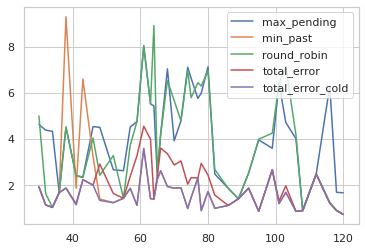

In [74]:
# importing package
import matplotlib.pyplot as plt
import numpy as np
  

  
# plot lines
for policy in ["max_pending", "min_past", "round_robin", "total_error", "total_error_cold"]:
    x = window_error[window_error["policy"] == policy].start_timestamp.tolist()
    y = window_error[window_error["policy"] == policy].error.tolist()
    plt.plot(x[10:50], y[10:50], label = policy)

plt.legend()
plt.show()

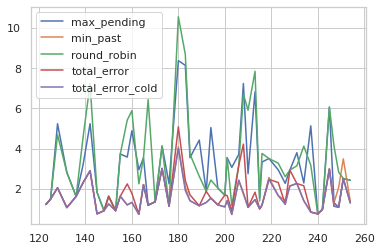

In [75]:
# importing package
import matplotlib.pyplot as plt
import numpy as np
  

  
# plot lines
for policy in ["max_pending", "min_past", "round_robin", "total_error", "total_error_cold"]:
    x = window_error[window_error["policy"] == policy].start_timestamp.tolist()
    y = window_error[window_error["policy"] == policy].error.tolist()
    plt.plot(x[50:], y[50:], label = policy)

plt.legend()
plt.show()

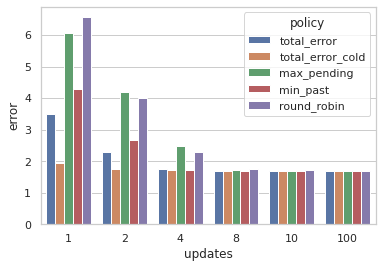

In [79]:
ax = sns.barplot(x="updates", y="error", hue="policy", data=results_df)

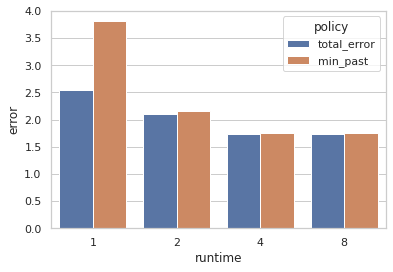

In [111]:
ax = sns.barplot(x="runtime", y="error", hue="policy", data=results_df[(results_df["policy"] == "total_error") | (results_df["policy"] == "min_past")])

In [84]:
import seaborn as sns
sns.set_theme(style="whitegrid")

[Text(0.5, 1.0, 'Distribution of Updates Across Keys'),
 Text(0.5, 0, 'Scheduled Updates per Key'),
 Text(0, 0.5, 'Number Keys')]

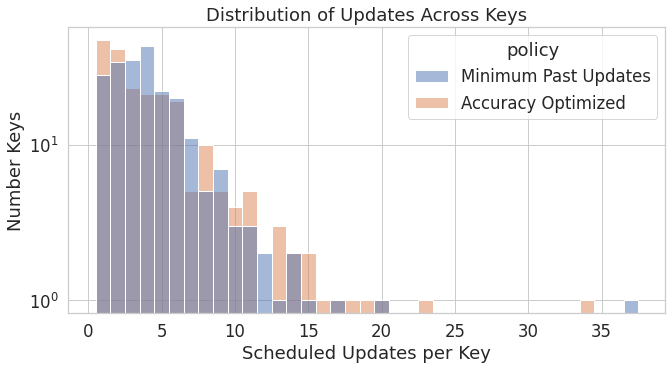

In [113]:
runtime = 1.0
sns.set(rc={'figure.figsize':(10.7,5.27)})
hist_df = updates_df[updates_df["runtime"] == runtime].groupby(by=["key", "policy"]).size()
hist_df = hist_df.to_frame(name="updates").reset_index()
hist_df["policy"] = hist_df.policy.map({'total_error': 'Accuracy Optimized', 'min_past': 'Minimum Past Updates'})

sns.set_theme(style="whitegrid", font_scale=1.5)
g = sns.histplot(data=hist_df, x="updates", hue="policy", log_scale=(False, True), discrete=True)
g.set(title="Distribution of Updates Across Keys", xlabel="Scheduled Updates per Key",  ylabel="Number Keys")

[Text(0.5, 1.0, 'Distribution of Updates Across Keys'),
 Text(0.5, 0, 'Scheduled Updates per Key'),
 Text(0, 0.5, 'Number Keys')]

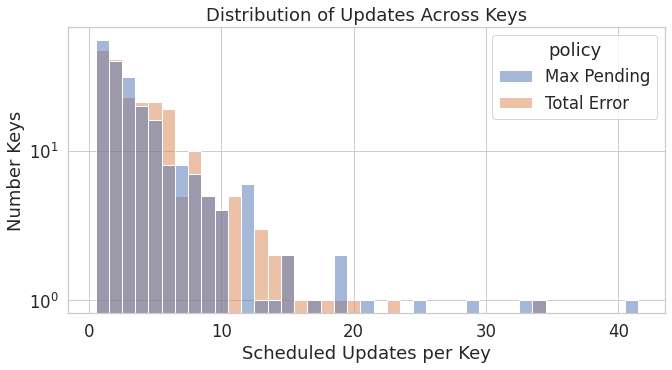

In [115]:
runtime = 1.0
sns.set(rc={'figure.figsize':(10.7,5.27)})
hist_df = updates_df[updates_df["runtime"] == runtime].groupby(by=["key", "policy"]).size()
hist_df = hist_df.to_frame(name="updates").reset_index()
hist_df["policy"] = hist_df.policy.map({'total_error': 'Total Error', 'max_pending': 'Max Pending'})

sns.set_theme(style="whitegrid", font_scale=1.5)
g = sns.histplot(data=hist_df, x="updates", hue="policy", log_scale=(False, True), discrete=True)
g.set(title="Distribution of Updates Across Keys", xlabel="Scheduled Updates per Key",  ylabel="Number Keys")

In [405]:
updates_df[(updates_df["policy"] == "total_error") & (updates_df["runtime"] == 1.0)]

,Unnamed: 0,policy,runtime,key,i,time
0,0,total_error,1.0,4226,0,0
1,1,total_error,1.0,4198,0,1
2,2,total_error,1.0,5689,0,2
3,3,total_error,1.0,4148,0,3
4,4,total_error,1.0,4130,0,4
...,...,...,...,...,...,...
5951,5951,total_error,1.0,5950,1,8108
5952,5952,total_error,1.0,5950,2,8109
5953,5953,total_error,1.0,5950,3,8113
5954,5954,total_error,1.0,5950,4,8114


In [406]:
updates_df[(updates_df["policy"] == "round_robin") & (updates_df["runtime"] == 1.0)]

,Unnamed: 0,policy,runtime,key,i,time
0,0,round_robin,1.0,4226,0,0
1,1,round_robin,1.0,4198,0,1
2,2,round_robin,1.0,5689,0,2
3,3,round_robin,1.0,4148,0,3
4,4,round_robin,1.0,4130,0,4
...,...,...,...,...,...,...
5951,5951,round_robin,1.0,5950,1,8108
5952,5952,round_robin,1.0,5950,2,8109
5953,5953,round_robin,1.0,5950,3,8113
5954,5954,round_robin,1.0,5950,4,8114
